# FORCE Learning in JAX

![FORCE](https://raw.githubusercontent.com/google-research/computation-thru-dynamics/master/images/FORCE_banner.png)

In [1]:
from __future__ import print_function, division
import matplotlib.pyplot as plt
import jax.numpy as np
from jax import grad, jit, vmap, value_and_grad
from jax import random
from jax.experimental import optimizers
import jax
import numpy as onp
import scipy
import tqdm

### Code for printing, running ESN and RLS

In [2]:
def keygen(key, nkeys):
  """Generate randomness that JAX can use by splitting the JAX keys.
  Args:
    key : the random.PRNGKey for JAX
    nkeys : how many keys in key generator
  Returns:

    2-tuple (new key for further generators, key generator)
  """
  keys = random.split(key, nkeys+1)
  return keys[0], (k for k in keys[1:])

In [3]:
def print_force(params, fparams, x_t, h_t, f_t, T):
  """Plot activations and outputs for the Echostate network run."""
  ntoplot = min(10, f_t.shape[1])
  plt.figure(figsize=(16,16))

  plt.subplot(321)
  plt.plot(time, f_t + 2*onp.arange(0, f_t.shape[1]), 'g')
#   plt.plot(time, z_t + 2*onp.arange(0, z_t.shape[1]), 'r');
  plt.xlim((0, T))
  plt.title('Target - f (green), Output - z (red)')
  plt.xlabel('Time')
  plt.ylabel('Dimension')

  plt.subplot(122)
  plt.imshow(h_t.T, interpolation=None)
  plt.title('Hidden activations of ESN')
  plt.xlabel('Time')
  plt.ylabel('Dimension')

  plt.subplot(323)
  plt.plot(time, h_t[:, 0:ntoplot] + 2*onp.arange(0, ntoplot), 'b')
  plt.xlim((0, T))
  plt.title('%d hidden activations of ESN'%(ntoplot))
  plt.xlabel('Time')
  plt.ylabel('Dimension')

  plt.subplot(325)
#   plt.plot(time, onp.sqrt(onp.square(z_t - f_t)), 'c')
  plt.xlim((0, T))
  plt.title('Error - mean absolute error')
  plt.xlabel('Time')
  plt.ylabel('Error')

def plot_params(params):
  """Plot some of the parameters associated with the ESN."""
  plt.figure(figsize=(16,10))
  plt.subplot(221)
  plt.imshow(params['wR'] + onp.dot(params['wF'], params['wO']), 
            interpolation=None); 
  plt.colorbar()
  plt.title('Effective matrix - wR + wF wO')

  plt.subplot(222)
  if params['wO'].shape[0] == 1:
    plt.stem(params['wO'][0,:])
  else:
    plt.imshow(params['wO'], interpolation=None)
    plt.colorbar()
  plt.title('Readout weights - wO');

  x_circ = onp.linspace(-1, 1, 1000)
  y_circ = onp.sqrt(1-x_circ**2)
  evals, _ = onp.linalg.eig(params['wR'])
  plt.subplot(223)
  plt.plot(onp.real(evals), onp.imag(evals), 'o')
  plt.plot(x_circ, y_circ, 'k')
  plt.plot(x_circ, -y_circ, 'k')
  plt.axis('equal')
  plt.title('Eigenvalues of wR')

  evals, _ = onp.linalg.eig(params['wR'] + onp.dot(params['wF'], params['wO']))
  plt.subplot(224)
  plt.plot(onp.real(evals), onp.imag(evals), 'o', color='orange')
  plt.plot(x_circ, y_circ, 'k')
  plt.plot(x_circ, -y_circ, 'k')
  plt.axis('equal');
  plt.title('Eigenvalues of wR + wF wO');

In [73]:
def random_esn_params(key, u, n, m, tau=1.0, dt=0.1, g=1.0, i=1.0):
  """Generate random RNN parameters
  
  Arguments: 
    u: dim of the input
    n: dim of the hidden state
    m: dim of the output
    tau: "neuronal" time constant
    dt: time between Euler integration updates
    g: scaling of the recurrent matrix in the reservoir

  Returns:
    A dictionary of parameters for the ESN.
  """
  key, skeys = keygen(key, 5)
  r_density = 0.3
  hscale = 0.5
  ifactor = i / np.sqrt(u)
  hfactor = g / np.sqrt(n)
  pfactor = 1.0 / np.sqrt(n)
  ffactor = 1.0 # Feedback factor, keep at 1 for now.
  #TODO sparsness
  return {'a0' : random.normal(next(skeys), (n,)) * hscale,
          'wI' : random.normal(next(skeys), (n,u)) * ifactor,
          'wR' : np.multiply(random.normal(next(skeys), (n,n)),
                             np.ones((n,n))) * hfactor,
#                              scipy.sparse.random(n, n, density=0.8, data_rvs=onp.ones).toarray()), # TODO seed
          'dt_over_tau' : dt / tau}

def esn(x, a, h, wI, wR, dtdivtau):
  """Run the continuous-time Echostate network one step.
  
    da/dt = -a + wI x + wR h + wF z

    Arguments:
      x: ndarray of input to ESN
      a: ndarray of activations (pre nonlinearity) from prev time step
      h: ndarray of hidden states from prev time step
      z: ndarray of output from prev time step
      wI: ndarray, input matrix, shape (n, u)
      wR: ndarray, recurrent matrix, shape (n, n)
      wF: ndarray, feedback matrix, shape (n, m)
      wO: ndarray, output matrix, shape (m, n)
      dtdivtau: dt / tau

    Returns: 
      The update to the ESN at this time step.
  """
  dadt = -a + np.dot(wI, x) + np.dot(wR, h)
  a = a + dtdivtau * dadt
  h = np.tanh(a)
  return a, h

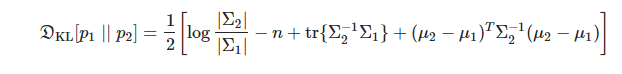

In [5]:
def multivariate_gaussian_D_kl(train_mean, train_cov, target_mean, target_cov):
    d_kl=0
    train_log_det = np.linalg.slogdet(train_cov) # [value, sign]
    target_log_det = np.linalg.slogdet(target_cov)
    inv_train_cov = np.linalg.inv(train_cov)
    d_kl += (train_log_det[0] * train_log_det[1]) - (target_log_det[0] * target_log_det[1])
    d_kl += -train_cov.shape[0]
    d_kl += np.trace(np.dot(inv_train_cov, target_cov))
    means_dif = train_mean - target_mean
    d_kl += np.dot(means_dif.T, np.dot(inv_train_cov, means_dif))
#     print("dkl-mu")
#     print(np.dot(means_dif.T, np.dot(inv_train_cov, means_dif)))
#     print("dkl-s1s2")
#     print(np.trace(np.dot(inv_train_cov, target_cov)))
#     print("inv_train_cov")
#     print(inv_train_cov)
#     print("train_cov")
#     print(train_cov)
    return 0.5 * d_kl

### Jax implementation of FORCE learning.

In [149]:
def propagate_rnn(start_time, steps, inputs, a, h, wI, _wR, _dtdivtau):
    samples = []
    h_t = []
    for t in range(start_time, min(start_time + steps, inputs.shape[0]-1)):
        a, h = esn(inputs[t], a, h, wI, _wR, _dtdivtau)
        h_t.append(h)
        if (t - start_time) % SAMPLE_TIMESTEP == 0:#TODO add delta to remove start bias. todo - sample with random probability
            samples.append(h) # TODO activations vs state?
    return np.array(samples), h_t, a, h
        
def loss_function_batches(_wR, start_time, inputs, a_samples, h_samples, wI, _dtdivtau, target_mean, target_cov):
    samples = []
    for i in range(BATCHES_PER_GRADIENT):
        s, h_t, a, h = propagate_rnn(start_time, BATCH_SAMPLES * SAMPLE_TIMESTEP, inputs, a_samples[i], h_samples[i], wI, _wR, _dtdivtau)
        samples += list(s)
    return multivariate_gaussian_D_kl(np.mean(np.array(samples), axis=0), np.cov(np.array(samples).T), target_mean, target_cov), (h_t, a, h)

def loss_function_single_start(_wR, start_time, inputs, a, h, wI, _dtdivtau, target_mean, target_cov):
    samples, h_t, a, h = propagate_rnn(start_time, TRAIN_TIMESTEP, inputs, a, h, wI, _wR, _dtdivtau)
    return multivariate_gaussian_D_kl(np.mean(samples, axis=0), np.cov(samples.T), target_mean, target_cov), (h_t, a, h)

def esn_run_and_train_jax(params, x_t, target_mean=None, target_cov=None, opt_state=None, opt_update=None, do_train=False):
  """Run the Echostate network forward a number of steps the length of x_t.
  
    This implementation uses JAX to build the outer time loop from basic
    Python for loop.

    Arguments: 
      params: dict of ESN params
      fparams: dict of RLS params
      x_t: ndarray of input time series, shape (t, u)
      f_t: ndarray of target time series, shape (t, m)
      do_train: Should the network be trained on this run? 
    
    Returns:
      4-tuple of params, fparams, h_t, z_t, after running ESN and potentially
        updating the readout vector.  
  """
  # per-example predictions
  a = params['a0']
  h = np.tanh(a)
  h_t = [h]
  loss = []

  wI = params['wI']
  wR = params['wR']
  dtdivtau = params['dt_over_tau']
  samples = []  
    
  j=0
  for t in tqdm.tqdm(range(0, x_t.shape[0] - 1, TRAIN_TIMESTEP)):
    if do_train:        
        if TRAIN_TYPE == "batch":
            h_samples = onp.random.multivariate_normal(target_mean,target_cov, BATCHES_PER_GRADIENT)
            while(np.abs(h).max()>=1):
                h = onp.random.multivariate_normal(target_mean,target_cov)
            a_samples = np.arctanh(h) # TODO - switch a's and h's
            loss_return_values , grads = value_and_grad(loss_function_batches, has_aux=True)(wR, t, x_t, a_samples, h_samples, wI, dtdivtau, target_mean, target_cov)
        else:
            loss_return_values , grads = value_and_grad(loss_function_single_start, has_aux=True)(wR, t, x_t, a, h, wI, dtdivtau, target_mean, target_cov)
        clipped_grads = optimizers.clip_grads(grads, np.square(wR.shape[0]))
        opt_state = opt_update(j, clipped_grads, opt_state)
        j+=1
        wR = get_params(opt_state)
#         print("wR")
#         print(wR)
#         print("loss")
#         print(loss_return_values[0])
#         print("grads")
#         print(grads)
#         print("clipped grads")
#         print(clipped_grads)
        h_t += list(loss_return_values[1][0])
#         a = loss_return_values[1][1]
#         h = loss_return_values[1][2]
        
        h = onp.random.multivariate_normal(target_mean,target_cov)
        while(np.abs(h).max()>=1):
            h = onp.random.multivariate_normal(target_mean,target_cov)
        a = np.arctanh(h)
        loss.append(loss_return_values[0])
    else:
        samples, h_t_new, a, h = propagate_rnn(t, TRAIN_TIMESTEP, x_t, a, h, wI, wR, dtdivtau)
        h_t += h_t_new
        
        
  params['wR'] = wR
  h_t = np.array(h_t)  
  
  return params, h_t, loss, opt_state

In [50]:

def esn_run_jax(params, x_t):
  """Run the echostate network forward.

    Arguments:
      params: dict of ESN params
      x_t: ndarray of input with shape (t,u)

    Returns: 
      2-tuple of ndarrays with first dim time, the hidden state and the outputs.
  """
  return esn_run_and_train_jax(params, x_t, None, None, None, None, do_train=False)

esn_run_jax_jit = jit(esn_run_jax)


def esn_train_jax(params, x_t, target_mean, target_cov, opt_state, opt_update):
  """Run the echostate network forward and also train it.

    Arguments:
      params: dict of ESN params
      fparams: dict of RLS params
      x_t: ndarray of inputs with shape (t,u)
      f_t: ndarray of targets with shape (t,m)

    Returns: 
      4-tuple of updated params, fparams, and also ndarrays with first dim 
        time, the hidden state and the outputs.
  """
  return esn_run_and_train_jax(params, x_t, target_mean, target_cov, opt_state, opt_update, do_train=True)
  
esn_train_jax_jit = jit(esn_train_jax)

# TODO: sample starting position from the distribution instead of contiuing

In [109]:
# Basic parameters of the Echostate networks
key = random.PRNGKey(0)   
    
T = 60              # total time
u = 1               # number of inputs (didn't bother to set up zero, just put in zeros)
n = 8             # size of the reservoir in the ESN
tau = 1.0           # neuron time constant
dt = tau / 10.0     # Euler integration step
time = np.arange(0, T, dt) # all time
ntime = time.shape[0]      # the number of time steps

x_t = np.zeros((ntime,u)) # Just a stand-in in folks want a real input later
x_t = np.ones((ntime,u)) # Just a stand-in in folks want a real input later

Note well, the first time jit'd functions run they take a LONG TIME because there is no jax scan function, so it's unrolling a huge graph proportional to the number of time steps!  Afterwards, it's blazingly fast.  A scan function is in the works.

  0%|          | 0/8 [00:00<?, ?it/s]

Data seed: 6815275


100%|██████████| 8/8 [00:02<00:00,  3.60it/s]


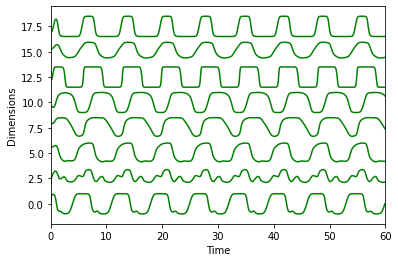

In [122]:
# Generate some target data by running an ESN, and just grabbing hidden 
# dimensions as the targets of the FORCE trained network.

g = 5.5  # Recurrent scaling of the data ESN, gives how wild the dynamics are.
m = n   # Number of targets, and thus outputs for trained ESN.
i=1

data_seed = onp.random.randint(0, 10000000)
# data_seed = 7437601 # 8, 6.5
# data_seed = 8180034 # 8, 6.5
# data_seed = 6815275 # 8, 6.5
# data_seed = 9586903 # 4, 4.5
# data_seed = 3339618 # 4, 4.5, 1

print("Data seed: %d" % (data_seed))
key = random.PRNGKey(data_seed)
data_params = random_esn_params(key, u, n, m, g=g, i=i)

# TODO https://github.com/google-research/computation-thru-dynamics/blob/master/notebooks/Integrator%20RNN%20Tutorial.ipynb for example

# h_t, z_t = esn_run_jax_jit(data_params, x_t)
_, h_t_target, _, _ = esn_run_jax(data_params, x_t)

f_t = h_t_target[:,0:m] # This will be the training data for the trained ESN
plt.plot(time, f_t + 2.5*onp.arange(0, m), 'g');
plt.xlim((0, T))
plt.ylabel('Dimensions')
plt.xlabel('Time');

In [146]:
TRAIN_TYPE = "batch"
BATCHES_PER_GRADIENT = 4
BATCH_SAMPLES = 20
SAMPLE_TIMESTEP = 1

if TRAIN_TYPE == "batch":
    TRAIN_TIMESTEP = BATCH_SAMPLES * SAMPLE_TIMESTEP * BATCHES_PER_GRADIENT
else:
    TRAIN_TIMESTEP = BATCH_SAMPLES * SAMPLE_TIMESTEP

target_h = h_t_target.copy()
target_mean = np.mean(target_h[::SAMPLE_TIMESTEP], axis=0)
target_cov = np.cov(target_h[::SAMPLE_TIMESTEP].T)
target_data_params = data_params.copy()
train_data_params = data_params.copy()



data_seed = onp.random.randint(0, 10000000) # 6782934
print("Data seed: %d" % (data_seed))
key = random.PRNGKey(data_seed)
key, skeys = keygen(key, 5)
train_data_params['wR'] = random.normal(next(skeys), (n,n))

Data seed: 307238


In [147]:
step_size = 1e-3# * np.square(n/4) # TODO - anneal with sgd
opt_init, opt_update, get_params = optimizers.sgd(step_size)
opt_state = opt_init(train_data_params['wR'])

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.48it/s]


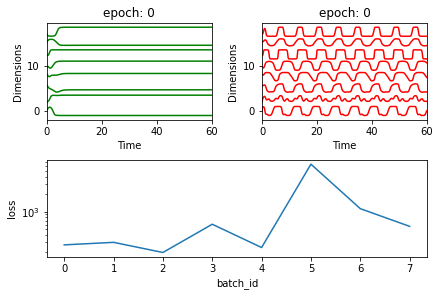

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


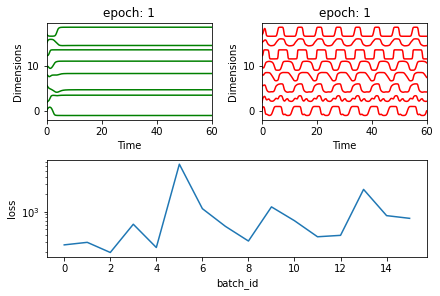

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.43it/s]


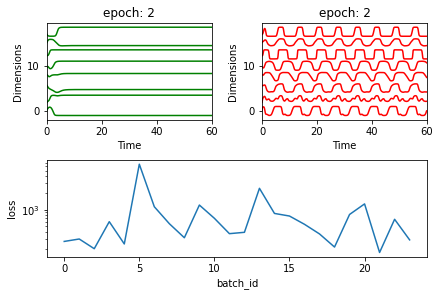

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.41it/s]


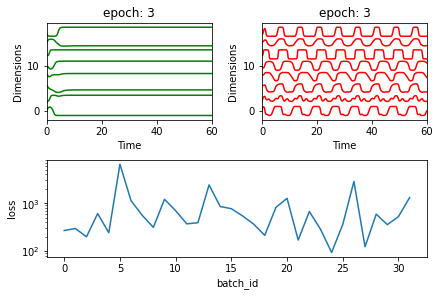

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


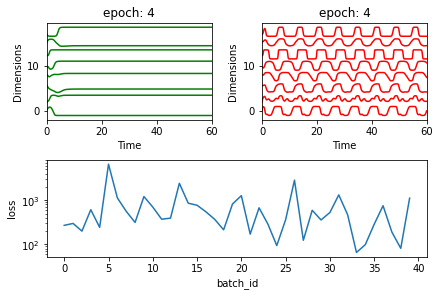

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.32it/s]


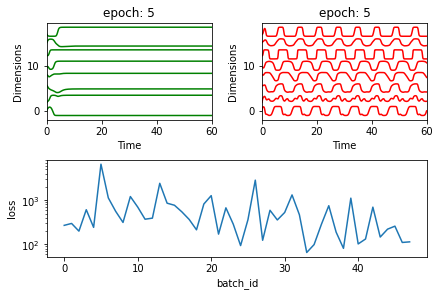

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


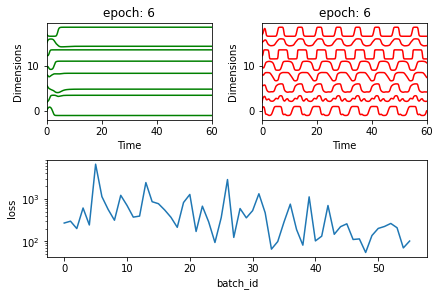

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


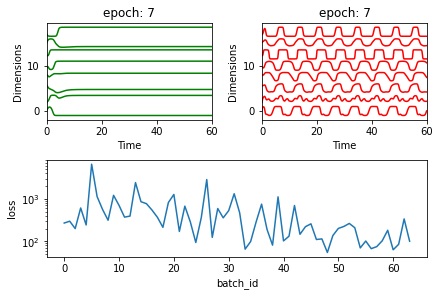

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


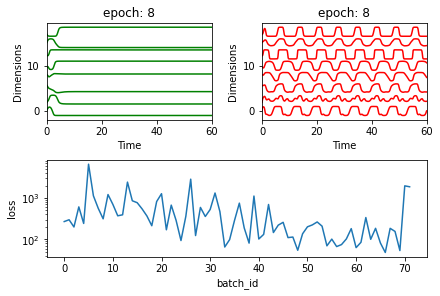

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


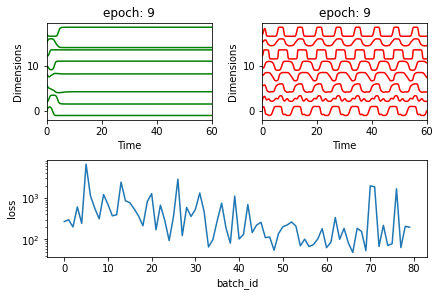

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


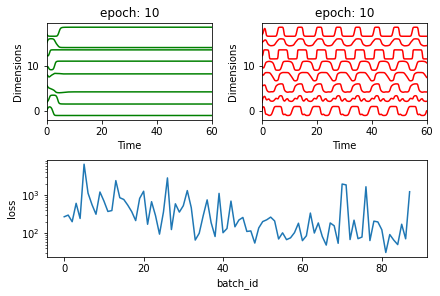

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


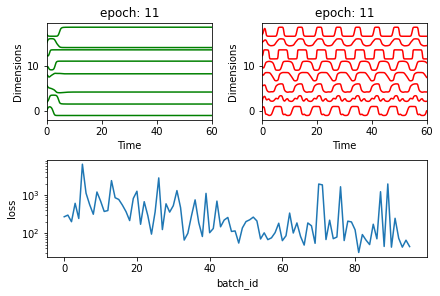

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


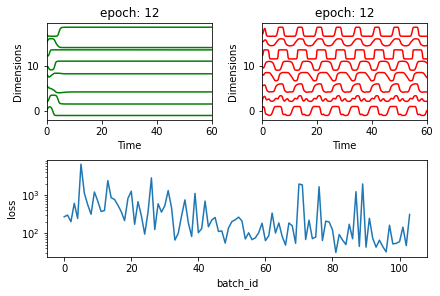

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


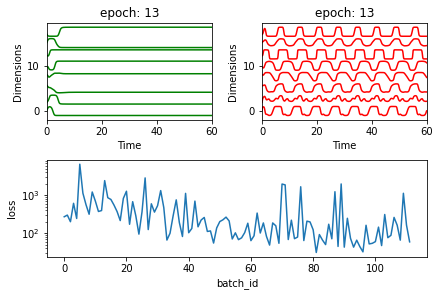

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


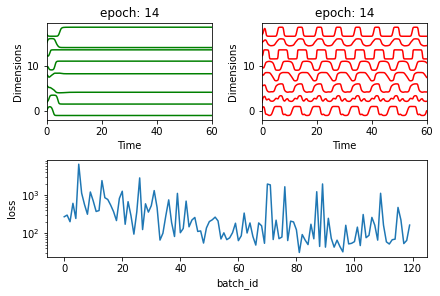

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


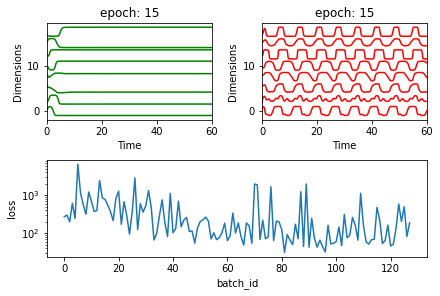

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.11it/s]


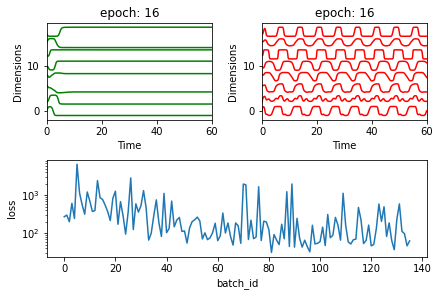

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


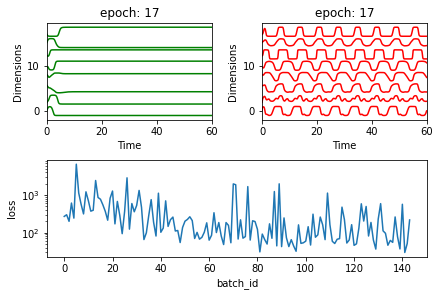

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


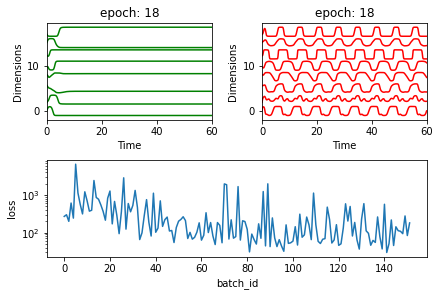

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  2.99it/s]


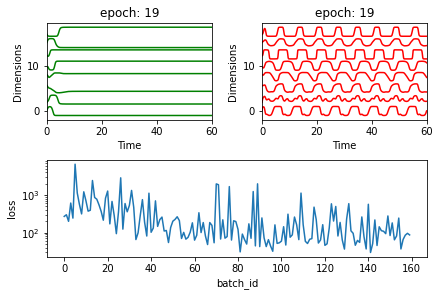

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


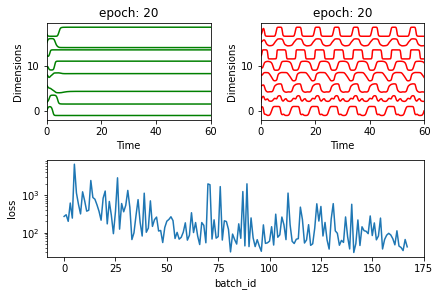

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


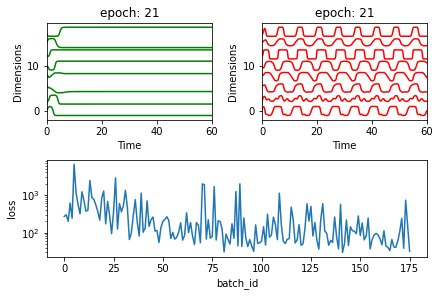

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


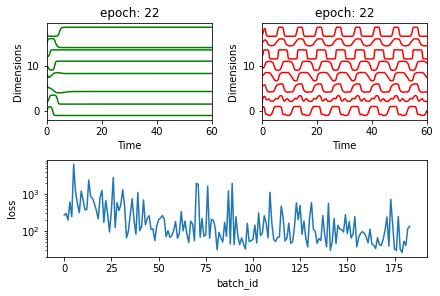

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.21it/s]


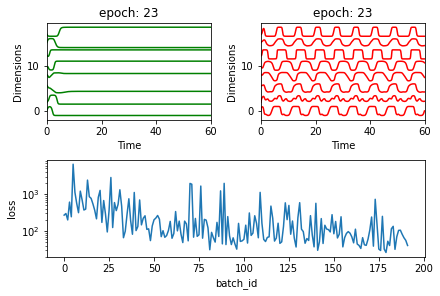

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


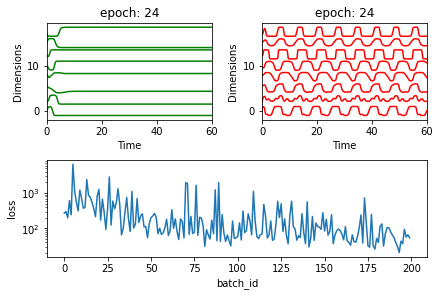

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


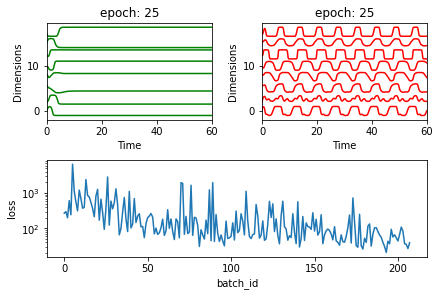

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


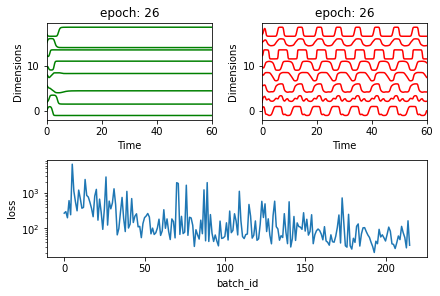

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


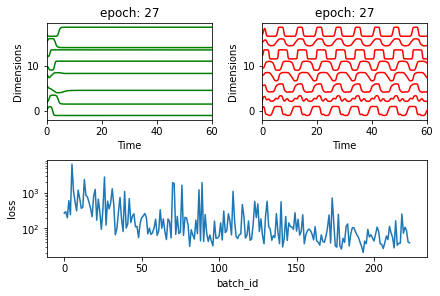

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


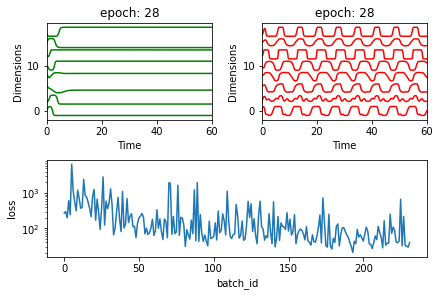

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


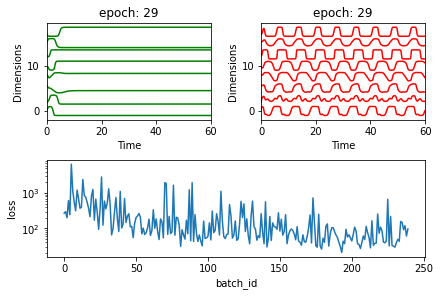

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


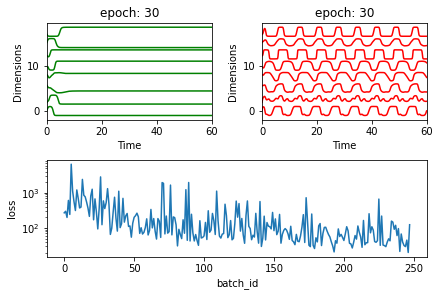

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


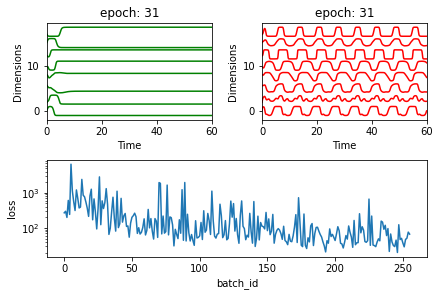

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


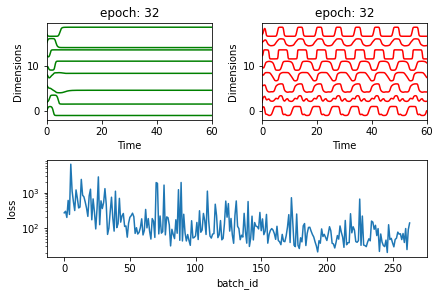

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


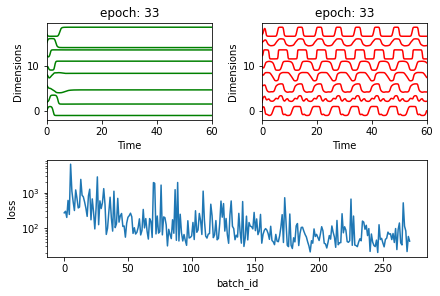

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


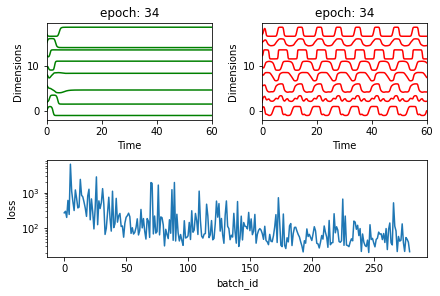

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.09it/s]


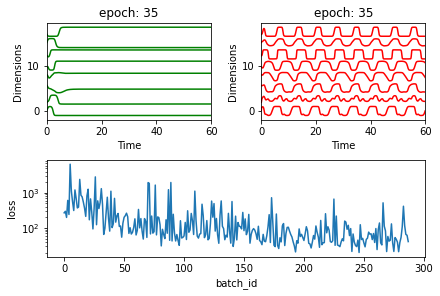

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


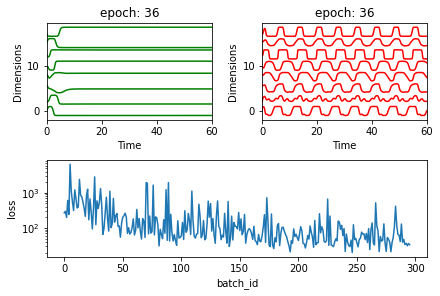

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


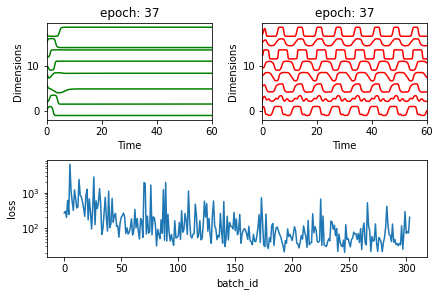

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


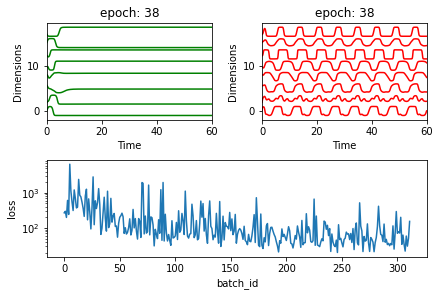

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


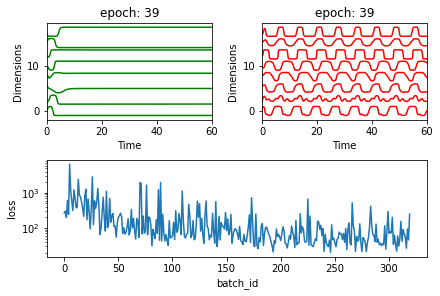

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


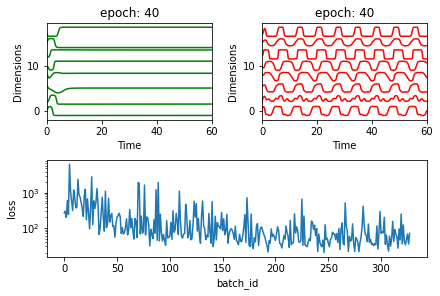

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


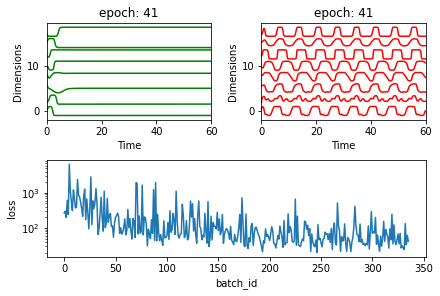

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  2.91it/s]


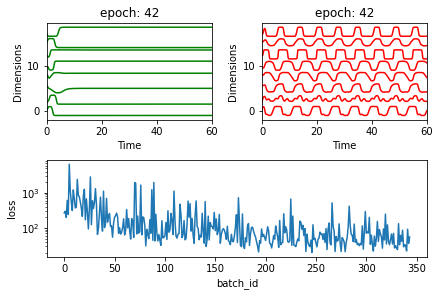

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.20it/s]


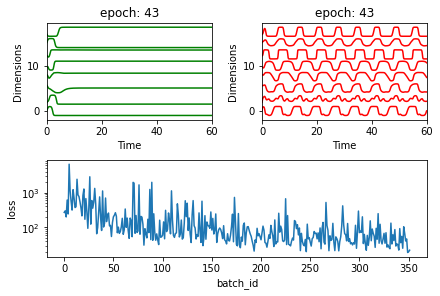

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


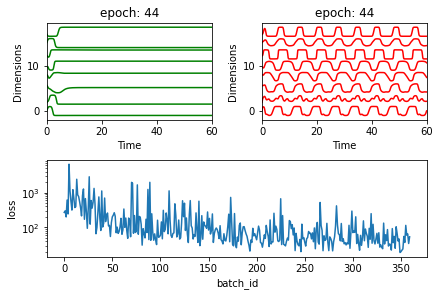

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.16it/s]


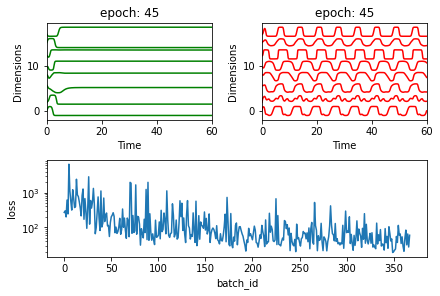

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.21it/s]


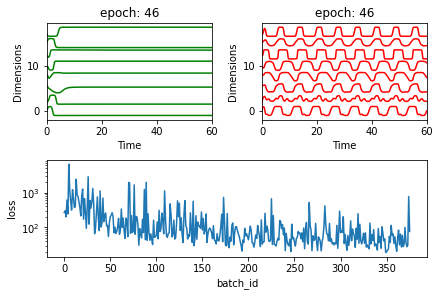

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.24it/s]


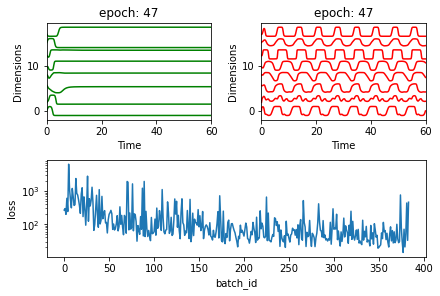

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.24it/s]


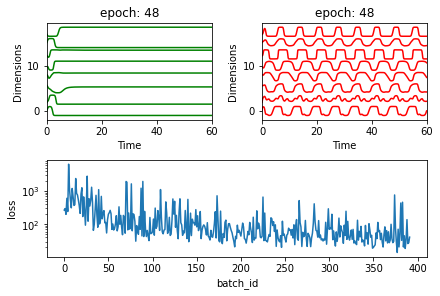

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


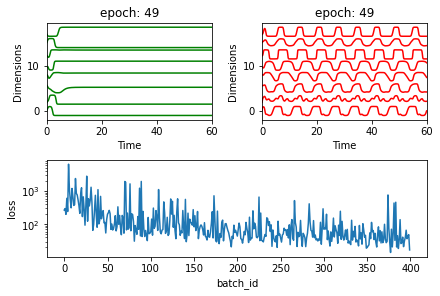

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


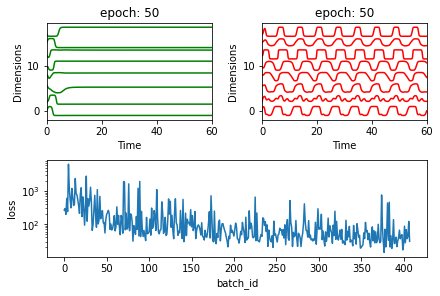

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


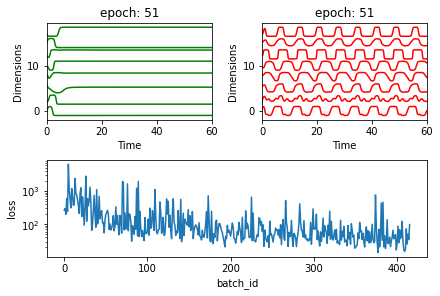

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


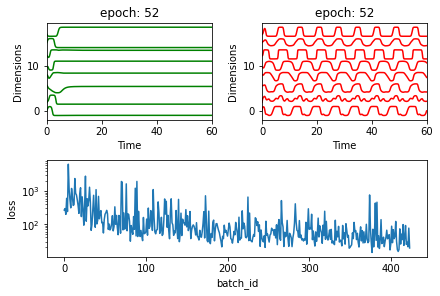

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


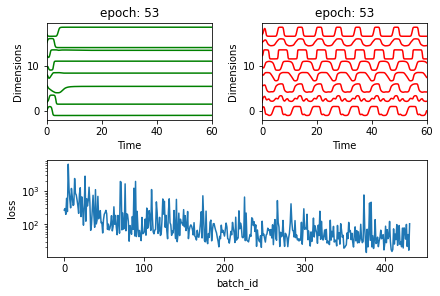

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


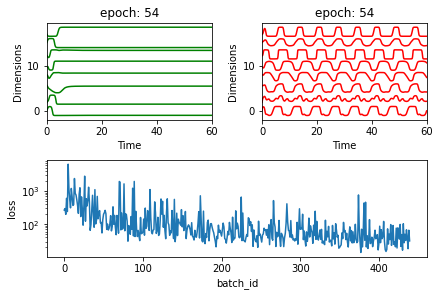

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


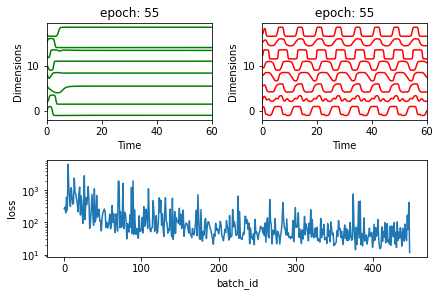

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


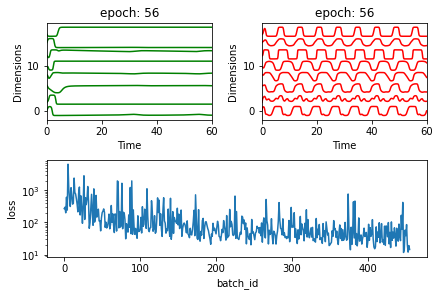

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


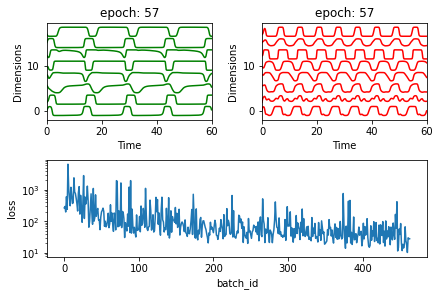

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


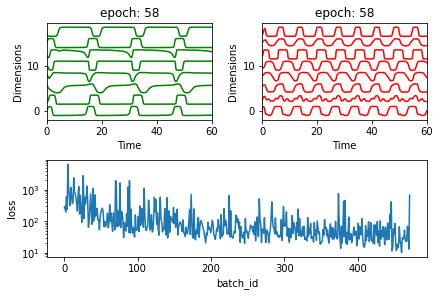

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:79: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


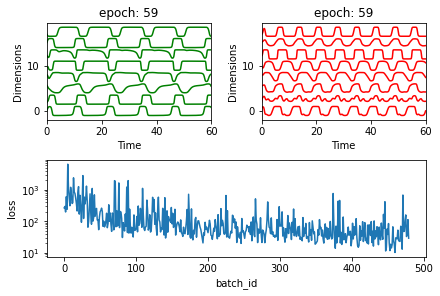

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:77: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


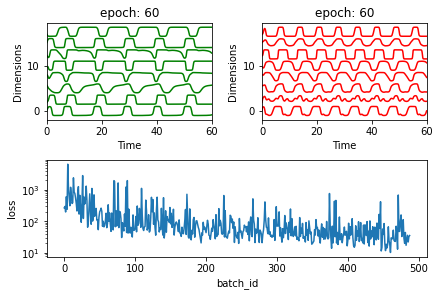

In [150]:
# Train the ESN, you can train all at once by setting ntraining to 
# about 15, or you can set it to 1 and watch it, by plotting in the 
# next cell.
from jax.config import config
config.update("jax_debug_nans", True)
config.update('jax_enable_x64', True)

# Again, the first time through, this takes a few minutes, afterwards
# a few tens of milliseconds.
tot_loss = []
ntraining = 60


# data_params = random_esn_params(key, u, n, m, g=g)
    
for train_idx in range(ntraining+1):
    if train_idx >= 0:
        train_data_params, h_t, loss, opt_state = esn_train_jax(train_data_params, x_t, target_mean, target_cov, opt_state, opt_update)
        tot_loss += loss

    _, h_t, _, _ = esn_run_jax(train_data_params, x_t)

    f_t = h_t[:,0:m] # This will be the training data for the trained ESN

    fig = plt.figure(constrained_layout=True)
    gs = fig.add_gridspec(2, 2)
    ax1 = fig.add_subplot(gs[0, 0])
    ax1.set_xlim((0, T))
    ax1.set_ylabel('Dimensions')
    ax1.set_xlabel('Time');
    ax1.set_title("epoch: %d" % (train_idx))
    ax1.plot(time, f_t + 2.5*onp.arange(0, m), 'g');

    ax2 = fig.add_subplot(gs[0, 1])
    ax2.set_xlim((0, T))
    ax2.set_ylabel('Dimensions')
    ax2.set_xlabel('Time');
    ax2.set_title("epoch: %d" % (train_idx))
    ax2.plot(time, target_h + 2.5*onp.arange(0, m), 'r');

    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(np.array(tot_loss));
    ax3.set_yscale("log")
    ax3.set_xlabel("batch_id")
    ax3.set_ylabel("loss")

    plt.show()
    plt.pause(0.1)

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.68383116 -0.4696755  -1.44720523  0.39567906  0.96424591 -0.17853794
  -0.8268817  -1.78163872]
 [-0.50042222 -0.16651521  0.23019758  1.19225235  0.65579448  1.12843741
   0.82964501  0.26092277]
 [ 1.04477429  0.4432912   0.51534431 -0.1176793  -0.7507023   0.84554975
   0.53209419  0.29187163]
 [ 1.26256718  0.14622023  0.36922225 -0.45897389 -0.8324865   0.06508634
   0.50658814  0.16044708]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:10,  1.45s/it]

[[ 0.89766412  0.34156144  0.13377574 -0.59457545 -0.8367558  -0.43626033
   0.0947408  -0.9296879 ]
 [-0.13939647 -0.3075591  -0.36124046  0.19029393  0.54609919 -0.42392592
  -0.17590879 -0.25069592]
 [-0.48355173 -0.13378575 -0.52635354  0.46386427  0.65682335 -0.6464074
  -0.36353687 -0.79653544]
 [-1.64095147 -0.43535674 -1.41250369  0.66012447  1.28419414 -0.96766637
  -1.02940533 -2.0418998 ]]


 25%|██▌       | 2/8 [00:02<00:07,  1.33s/it]

[[-0.61672752  0.18081663 -0.39269921  0.32146865  0.53758139 -0.15818187
  -0.28168835 -0.7396323 ]
 [-0.24774124  0.15698257  0.0347996   0.70645831  0.48639567  0.33054696
   0.10719431 -0.21978116]
 [-1.00841223 -0.1744771  -0.4858328   1.09225426  1.26884606  0.67928427
   0.14595782 -0.3649537 ]
 [ 2.01583923  0.15051459  0.33756726 -1.65232113 -1.59814592 -2.08509963
  -0.12671451 -0.89648329]]


 38%|███▊      | 3/8 [00:03<00:06,  1.27s/it]

[[ 0.66482162  0.60889202  1.05664296  0.07042644 -0.75052628  0.31758828
   0.85483471  0.92042687]
 [ 0.60843976 -0.47491482 -0.72613322 -1.27147445 -0.01785856 -1.79177906
  -0.57872088 -1.3949906 ]
 [-0.51279492  0.05062296  0.12918864  1.10449094  0.95494136  1.03994444
   0.54341913  0.10033405]
 [ 0.58584296  0.76480156  0.52765711  0.75778381 -0.31205582  0.39092973
   0.47622348  0.76802899]]


 50%|█████     | 4/8 [00:04<00:04,  1.16s/it]

[[-0.27078199 -0.12841397 -0.83049911  0.4214104   0.55026652 -0.94053697
  -0.63441064 -1.10131931]
 [-0.44727961 -0.02171362 -0.19169055  0.44626071  0.51464086 -0.27229925
  -0.09180305 -0.6493374 ]
 [ 1.13991119  0.61108106  0.96998549 -0.36178685 -0.91693789 -0.50761166
   0.41684944  0.67692665]
 [ 0.2305466   0.30805873 -0.17898569  0.43741531  0.06432877  0.25993084
   0.00347142 -0.11431043]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.14s/it]

[[-0.70344591 -0.40556256 -0.52830304  0.3823792   0.62941805 -0.22747743
  -0.25246408 -0.77172179]
 [-1.13288244  0.15422311  0.01359303  1.11140232  1.08485346  0.55929097
   0.3682294  -0.95887701]
 [-1.36798021 -0.21800779 -0.29984713  1.2108457   1.23728301  0.36085735
   0.14347714 -0.46506051]
 [-0.71038818 -0.03711463 -0.3651549   0.92166029  0.88023938  0.39088846
  -0.05318841 -0.00680145]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.09s/it]

[[-1.06635066 -0.36068366 -1.13309582  0.37282157  1.37947749 -0.85650754
  -0.94575066 -1.31838756]
 [ 0.22402908 -0.11422268 -0.24147396 -0.02333185  0.24737365 -0.46218124
  -0.10467533 -0.12086199]
 [ 0.29215885 -0.15036718  0.11706513 -0.20175177 -0.00956893 -1.44893015
   0.02923618 -0.004518  ]
 [ 0.41735296  0.39103465  0.38530128  0.14075029 -0.23340222 -0.25809806
   0.13571273 -0.35796918]]


 88%|████████▊ | 7/8 [00:08<00:01,  1.31s/it]

[[ 0.27475807 -0.20374075  0.30541033 -0.25780832  0.20599436 -1.2067784
   0.10299738 -0.09666148]
 [ 0.34916176  0.19230803 -0.10725708  0.01111777  0.02008267  0.16459143
   0.15549995 -1.03962853]
 [ 0.64748183  0.58880163  0.80282898  0.54510918 -0.15676925  0.62897961
   0.64724632  0.89213811]
 [ 0.15515897 -0.1100485  -0.103965    0.21497918  0.11395932 -0.26709782
   0.2283668  -0.06680628]]


100%|██████████| 8/8 [00:02<00:00,  2.69it/s]


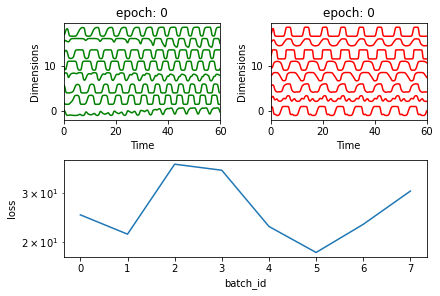

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.26772413  0.72578864  0.32779604  1.23769732  0.08913     1.31123291
   0.52285853  0.7683562 ]
 [-0.04562454 -0.23998253 -0.62385178  0.08881415  0.29415461 -0.42459974
  -0.20965408 -1.31113702]
 [ 0.44803654  0.20831583  0.74470266  0.22144511 -0.19944273  0.02733474
   0.85857247  0.65697587]
 [ 0.39880887 -0.26767626 -0.63333407 -0.45863726  0.08701965 -0.45935864
  -0.28593943 -1.57437101]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:11,  1.65s/it]

[[-0.32880352  0.39037209  0.41626653  1.23107545  0.55199905  2.01317684
   0.86275513  0.47839028]
 [ 2.58468028  0.96872209  2.20119595 -0.77202519 -2.17182554  0.88392261
   1.72752988  1.16439685]
 [ 0.1252246  -0.36523295 -1.02227018  0.22699661  0.39701128 -0.69251743
  -0.53376884 -1.11397784]
 [-0.11033506  0.09741815  0.50810423  0.36117003  0.044779    0.12746634
   0.50620877 -0.08744369]]


 25%|██▌       | 2/8 [00:03<00:09,  1.60s/it]

[[-1.44311925 -0.2515737  -0.17952536  1.64275678  1.41904148  0.68272658
   0.26301352 -0.03985457]
 [ 1.27459622  0.31619718 -0.01535268 -0.30455476 -0.84822171 -0.51626076
  -0.0517068  -0.30198505]
 [-0.39048546  0.23313413 -0.00613584  1.09756205  0.39661562  1.21760649
   0.44857655 -0.0829195 ]
 [ 0.41667536  0.499602    0.94193938  0.73363549 -0.06909542  1.45397425
   0.95957365  1.37751612]]


 38%|███▊      | 3/8 [00:04<00:07,  1.42s/it]

[[ 0.47455187  0.22206802 -0.32669958 -0.41564686 -0.27564975 -0.76905762
  -0.43040638 -1.09155721]
 [-0.4188534  -0.52531128 -1.03742108  0.13027897  0.87040014 -0.89951739
  -0.76031717 -1.70810737]
 [ 0.96561688  0.30634925 -0.65938496 -0.04668233 -0.40277699 -0.35881243
  -0.47628424 -0.58697698]
 [-1.268439   -0.50422033 -1.01780031  0.72692847  1.55609128 -0.69528272
  -0.58394233 -0.81392093]]


 50%|█████     | 4/8 [00:05<00:06,  1.51s/it]

[[ 0.4593724   0.77075119  1.30110392  0.2754395  -0.84176516  0.77591634
   1.02295799  0.93964327]
 [-1.68585442 -0.69278554 -1.47558593  0.89612695  1.84874    -1.28099618
  -1.04196965 -1.69365895]
 [-0.12365518 -0.12307308  0.09266995 -0.01306831  0.15893057 -0.2231017
   0.22360845 -0.39637877]
 [ 2.26264162  0.65495153  0.60177341 -0.90289802 -1.49926185 -0.36142608
   0.39057705  0.40231341]]


 62%|██████▎   | 5/8 [00:07<00:04,  1.66s/it]

[[-1.02698502 -0.61392302 -1.16793498  0.92245889  1.30710048 -0.51988874
  -0.57624489 -1.39609377]
 [-0.3149108   0.10506093 -0.42722255  0.17736888  0.35683957 -1.07506257
  -0.71498761 -0.76825146]
 [-1.66540077 -0.2043066  -0.52721815  1.52187148  1.50101823  1.38586687
   0.14934482 -0.50152914]
 [ 0.66408791  0.25686857  0.95779138  0.14944852 -0.39560948  0.19035723
   0.95556019  0.07023294]]


 75%|███████▌  | 6/8 [00:09<00:03,  1.73s/it]

[[-0.17093655 -0.2260086  -0.35431362  0.05077377 -0.0157448   0.04878711
  -0.09547797 -0.76167635]
 [ 0.87763363  0.89825594  1.28395339  0.68077728 -0.98355483  1.13199372
   1.20014122  1.20098311]
 [ 0.19716312  0.33349874  0.51038     0.56787711 -0.03719668  0.96088982
   0.64389671  0.42556049]
 [ 1.21633619  0.50820142  0.81575861  0.01578315 -0.95328762  0.62337253
   0.70391394  0.73036896]]


 88%|████████▊ | 7/8 [00:11<00:01,  1.71s/it]

[[ 1.53828459  0.43247554  0.18906369 -0.68638654 -0.99082684 -0.22835917
  -0.07961649 -0.52838821]
 [-0.63175499  0.06471626  0.81316741  1.4455084   0.60481908  0.89319985
   1.13261845  0.89127946]
 [-0.37883253  0.06896875  0.15812     0.60537505  0.42461815  0.28694295
   0.3713855   0.1008073 ]
 [ 0.90099695  0.58499908  0.5775989   0.32907405 -0.45371784  0.37407186
   0.58983532 -0.05217637]]


100%|██████████| 8/8 [00:03<00:00,  2.30it/s]


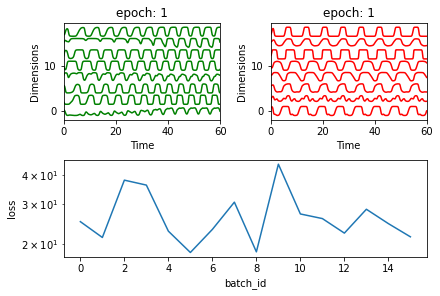

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.00283142  0.29032256 -0.01394659  0.41177479 -0.05526235 -0.88969361
  -0.31728838 -0.25156929]
 [ 0.4769197  -0.10440429 -0.58691684 -0.38502842  0.18231396 -1.17518205
  -0.62388581 -1.07973798]
 [-0.40914775 -0.11127289 -0.32956866  0.71638829  0.43832592  0.27260676
   0.10674621 -0.51979966]
 [ 0.868937    0.20094268  0.7420294  -0.47391415 -0.34678596 -0.26386461
   0.51017999  0.11769841]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.00it/s]

[[-0.51205069  0.13346554 -0.10334478  1.0714957   0.56022145  1.28593345
   0.21691435 -0.13904443]
 [-1.79327632 -0.01669331 -0.11355801  1.94252923  1.79270741  1.15137619
   0.33117605 -0.05559059]
 [ 1.03033188  0.49132472  0.65764619 -0.21246736 -0.98834394  0.04981546
   0.62004018  0.05505904]
 [ 0.22676998  0.41838202  0.54905378  0.21753924 -0.10663262 -0.08082421
   0.38851479  0.21830199]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.04s/it]

[[ 0.47247867  0.44125707  0.08798425  0.03163314 -0.1860483  -0.03428212
   0.06463414 -0.33009596]
 [-0.42405572  0.0867064   0.37837062  0.97597168  0.448368    0.34021038
   0.61660215  0.2390849 ]
 [-0.8585823  -0.30836139 -1.36679202  0.20825712  0.84248307 -1.35396063
  -1.18386621 -2.2588935 ]
 [-0.6245186  -0.3536724  -1.21646145  0.53380235  0.82656008 -0.97504996
  -0.86008129 -1.47369986]]


 38%|███▊      | 3/8 [00:03<00:05,  1.05s/it]

[[ 0.41523446  0.21815331 -0.4843964  -0.05734114  0.32315563  0.31221715
  -0.13862705 -0.29752084]
 [-0.13951629 -0.18397538 -0.16727219  0.05646179  0.55505309 -0.04955079
   0.12438214 -0.49503227]
 [-0.19845196 -0.00387674 -0.23854532  0.72877538  0.10607006  0.19000484
   0.16271336 -0.21119169]
 [ 0.6330141  -0.1238993   0.44102483 -0.77648685 -0.62396288 -1.26471291
   0.03504448 -0.48158029]]


 50%|█████     | 4/8 [00:04<00:04,  1.12s/it]

[[ 0.12365117  0.42815572 -0.11296002  0.83952008 -0.0254146   0.83264371
   0.13626036  0.40458911]
 [ 1.06787583  0.93943628  0.68728106 -0.0219475  -1.01216676 -0.06288089
   0.29903449  0.16108366]
 [-1.73349722  0.14667736 -0.78603672  2.07659034  1.69951232  0.41598502
  -0.40486308 -0.47960141]
 [-0.10293614  0.03993348 -0.21495034  0.41334742  0.15866371 -0.03828644
   0.00752734 -0.38858718]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.13s/it]

[[ 0.62179589  0.34618575  0.66410296  0.01174276 -0.20515628  0.14698469
   0.56199676  0.87609247]
 [ 0.84066524  1.13249408  0.63798025  0.46557791 -0.75388655  1.20543141
   0.51632877  0.32941358]
 [-1.15241303 -0.23084891 -0.50795455  0.83187328  1.22151093  0.70540189
  -0.01444574 -0.63276162]
 [ 0.21525316 -0.1786448   0.07128674 -0.08782636 -0.04512374 -0.73791001
   0.2066141  -0.7562526 ]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.14s/it]

[[ 2.00262178  0.71798822  1.63989837 -0.56626649 -1.41910573  1.35024855
   1.42023533  1.25463541]
 [-0.05934508  0.47319374 -0.52162975  0.54121889  0.65394684 -0.05707086
  -0.3718807  -0.48695414]
 [ 0.73302878  1.19290062  1.1756627   0.42188147 -0.88143531  1.29994869
   0.95375031  1.35659895]
 [ 0.19579161 -0.1862529  -0.18712231  0.21856018  0.13930356  0.11669694
   0.1415951  -0.92695518]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.15s/it]

[[ 0.60762086  0.41245797  0.71207228  0.47515112 -0.2484595   1.25810968
   0.79917157  0.67605997]
 [-0.97331185  0.15253514 -0.92663389  1.08093707  0.86075462 -0.26650369
  -0.65909367 -1.13912991]
 [ 0.8169899   0.42240934  0.2875748  -0.21431386 -0.42832506 -0.36953777
  -0.15904977  0.20458429]
 [ 0.43318772 -0.03059376 -0.6935453   0.08947786 -0.01924435 -1.02339361
  -0.51114187 -1.25481276]]


100%|██████████| 8/8 [00:02<00:00,  2.94it/s]


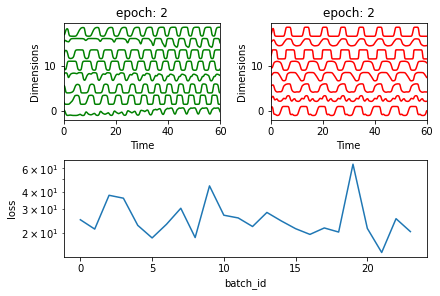

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.23923411  0.62969721  1.1991195  -0.23576485 -1.34361689 -0.38211829
   0.71761171  1.02922433]
 [-0.05791391 -0.00870781 -0.60156232  0.24756912  0.54639137 -0.03789384
  -0.24728485 -1.22334197]
 [ 0.67366528 -0.08322352  0.02518691 -0.20069223  0.20358346 -0.65728072
   0.10177668 -0.36498971]
 [ 1.24542059  0.46875869  0.50059879  0.16206189 -0.59662286  0.79080714
   0.70192251  0.25011417]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.13s/it]

[[ 0.21243219 -0.00608241 -0.50555571 -0.33673818 -0.05733377 -0.66579702
  -0.34910894 -1.70272658]
 [-1.16572336 -0.342285   -1.17762763  0.88717308  1.45256776 -0.29158259
  -0.68328218 -1.26726652]
 [-0.21355609  0.67020234  0.88706521  1.08576385 -0.02620235  0.81902947
   0.50743463  1.15708207]
 [ 0.32012708 -0.05478837 -0.67493032 -0.1680565   0.08850601 -0.66442671
  -0.54453169 -0.82188199]]


 25%|██▌       | 2/8 [00:02<00:06,  1.08s/it]

[[ 6.73951206e-01  7.71954517e-02 -3.50778489e-01 -5.30209318e-01
  -1.69640186e-01 -1.56439688e+00 -5.89707733e-01 -9.05366892e-01]
 [-5.41278511e-01 -4.58007291e-01 -7.00980189e-01  7.61497512e-01
   8.67514806e-01 -1.12363625e-03 -1.01213251e-01 -5.64173269e-01]
 [-6.20697735e-01  1.11997952e-01 -4.35762593e-01  9.97907716e-02
   5.04645424e-01 -8.72568090e-01 -5.41430674e-01 -8.50585722e-01]
 [-5.70824894e-02 -1.14846766e-01 -7.58468994e-01 -5.77797360e-01
   2.58987602e-01 -1.17042574e+00 -7.67302975e-01 -1.72121974e+00]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:03<00:05,  1.08s/it]

[[ 0.2859794   0.62350509  0.27801511  1.07052717 -0.11052323  1.63258669
   0.6244051   0.43515589]
 [ 0.39202383  0.88165053  1.44683234  0.77334811 -0.64520759  2.20127601
   1.46539645  1.24632929]
 [-0.61841764  0.16924433 -0.34186023  0.8363523   0.59138025  0.83814648
   0.02246413 -0.56096335]
 [-0.9331499   0.17379573 -0.12003047  1.14958624  0.94337306  1.31866587
   0.4323959  -0.12197922]]


 50%|█████     | 4/8 [00:04<00:04,  1.17s/it]

[[-0.28920808 -0.37222331 -1.20102281 -0.0025817   0.75387149 -1.16221289
  -0.83220815 -1.18291369]
 [-0.10629028  0.30291047  0.23779786  0.79924558  0.10840352  0.22773601
   0.13746179  0.31865883]
 [-0.12949579 -0.36170709 -0.67512682  0.05571932  0.58719832 -1.00944225
  -0.38894305 -1.31474364]
 [-0.01570452  0.0699366   0.77166849  0.24438017  0.07848345  0.45531917
   0.85413189  0.3552992 ]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.15s/it]

[[ 0.28738965  0.35190109  0.29637679 -0.03126856 -0.31000807  0.46172928
   0.2837926  -0.11978393]
 [ 0.87196085  0.62776445  0.94582077  0.16609486 -0.48848009 -0.53746582
   0.49675732  0.76644871]
 [ 1.8012026   0.48624941  0.81665139 -1.2010032  -1.37437855 -2.16021143
  -0.20919501  0.07910772]
 [ 0.54497145 -0.11962347  0.24162328 -0.39862334 -0.31118228 -0.51598295
   0.21846035 -0.01882169]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.12s/it]

[[-1.13681238 -0.25114852 -0.74479152  0.27601127  1.02451301 -1.12627117
  -0.59471864 -1.00119456]
 [ 0.57600862  0.30592756  0.57356285  0.28248256 -0.69299533  1.13294799
   0.87248025 -0.10608347]
 [-0.19440937 -0.525295   -0.32612571 -0.45512118  0.55205387 -1.42537336
  -0.32043394 -0.85808679]
 [ 0.66624617  0.31876671  0.89629317  0.26022403 -0.6831879   0.62492015
   1.09439595  0.83828967]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.17s/it]

[[ 0.78338933 -0.24067559 -0.53066954 -0.65471089 -0.02624702 -1.84411392
  -0.63772347 -0.84561517]
 [-0.41020927  0.06504049 -0.31103167  0.28996296  0.50200207 -0.27904066
  -0.1319057  -0.64740173]
 [ 0.4555252   0.54682065  0.58990922  0.29470636 -0.37429287  0.83644414
   0.77535491  0.34417577]
 [-0.3650014  -0.0728873  -0.8150486   0.64275754  0.57526186  0.68676623
  -0.18491897 -1.26701588]]


100%|██████████| 8/8 [00:03<00:00,  2.64it/s]


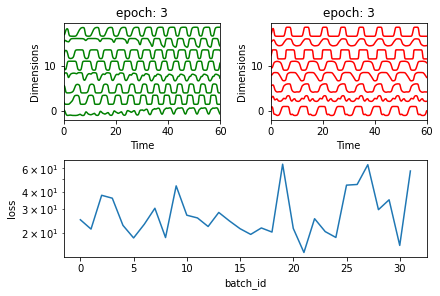

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.18822259  0.15965534 -0.37185128  0.18924884  0.24172882 -0.33935812
  -0.16782983 -1.01447884]
 [ 0.290258    0.24484947  0.24974674  0.31288995  0.00936159  0.80315067
   0.41890053 -0.5310655 ]
 [-0.15321173  0.30866434 -0.09730818  0.8558356   0.61759239  1.10579941
   0.36803969 -0.00562092]
 [-1.97053897 -0.10267808 -1.22405137  2.05273084  1.99680962  0.69724164
  -0.51102512 -0.95675965]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.01it/s]

[[ 0.58526927 -0.09900754 -0.38914925 -0.22714008  0.15992522 -1.37590807
  -0.45544178 -0.70463657]
 [-0.26134071 -0.1509208  -0.55239642  0.24266595  0.49718154 -1.00195555
  -0.42404406 -1.3676926 ]
 [ 1.5129852   1.31264008  2.21855601  1.08345008 -1.18131047  3.04197178
   2.25423509  2.5686854 ]
 [ 0.22128597  0.27022627  0.10152619  0.36135102 -0.00932924  0.54550495
   0.4051668  -0.47831506]]


 25%|██▌       | 2/8 [00:02<00:05,  1.00it/s]

[[ 0.31395701  0.18358121  0.51999646  0.24545264 -0.31185456  0.02375807
   0.60316936 -0.14062986]
 [ 0.56110443  1.19087694  1.89791437  1.62648864 -0.49611753  3.3279248
   2.12871965  2.48446203]
 [ 1.46993249  0.60674597  0.93441962 -0.29548229 -1.07060952  0.51052678
   0.79653919  0.53288801]
 [ 3.00094569  1.17301974  1.936232   -0.91103869 -2.48511719  0.4009364
   1.31937649  1.16940894]]


 38%|███▊      | 3/8 [00:03<00:05,  1.03s/it]

[[ 0.14235497  0.38335906 -0.36519271  0.09582621 -0.10697111 -0.27748165
  -0.44439616 -0.55472967]
 [ 0.68690709  0.39832209  0.35217628 -0.08707932 -0.30106879  0.03385398
   0.33792903  0.15570417]
 [-0.40674917 -0.24218401 -0.71523129  0.15862753  0.6060755  -1.4940228
  -0.72098345 -1.14062487]
 [ 0.76219109 -0.05298679 -0.17032549 -0.69442217 -0.30560404 -1.98477061
  -0.40604342 -0.61070529]]


 50%|█████     | 4/8 [00:04<00:04,  1.17s/it]

[[-1.20368079e+00  1.74742859e-01 -1.58681775e-01  1.54344918e+00
   9.88197860e-01  1.29315375e+00  4.95214258e-01 -2.41408409e-01]
 [-7.32562479e-01 -6.99912617e-04 -8.85488956e-01  7.34151227e-01
   9.31012278e-01 -1.96681781e-01 -5.12224739e-01 -1.35244518e+00]
 [-5.13175807e-01  4.39816259e-02 -4.10350419e-01  4.33836420e-01
   5.00424229e-01  4.50176855e-02 -1.12583534e-01 -1.12306320e+00]
 [-9.70926703e-01 -5.16022474e-02 -8.01914470e-02  1.43188302e+00
   1.05358039e+00  1.27378546e+00  5.84291361e-01  1.73782395e-01]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.16s/it]

[[-1.40412855 -0.38913934 -1.15268237  0.84430522  1.55727814 -0.15532866
  -0.48916709 -1.39415289]
 [-1.20305605  0.36168163 -0.2185769   1.16701652  0.77959352  0.06930828
  -0.14092286 -0.40496059]
 [ 0.63306238  0.23853702 -0.53783911 -0.61143765 -0.26980263 -1.42703227
  -0.78786617 -1.25231954]
 [-0.29693921  0.22125249 -0.10814783  1.05835169  0.54164597  1.31446284
   0.39224888 -0.02208058]]


 75%|███████▌  | 6/8 [00:07<00:02,  1.19s/it]

[[-0.10994058  0.13172409 -0.44891174  0.54271071  0.20734426  0.86489683
   0.18623865 -0.95654943]
 [-0.8301348  -0.03518338 -0.29385255  1.15568078  0.94530354  0.38748422
   0.11171182 -0.12504064]
 [-0.41697617  0.82667906  0.67180706  1.80518866  0.58982301  1.39645816
   0.7410662   1.42382852]
 [-0.62134464 -0.06183179  0.11363543  0.71924464  0.81685605 -0.01025455
   0.4339936   0.02713479]]


 88%|████████▊ | 7/8 [00:08<00:01,  1.18s/it]

[[ 1.73623301  0.72558087  0.49300715 -0.63385068 -1.36557233 -0.17468781
   0.13232963  0.07129585]
 [-0.57957173  0.03672799 -0.62679422  0.77745143  0.83147375  0.27580532
  -0.19077368 -1.11800218]
 [ 2.17630344  0.7556059   0.96421908 -0.7619594  -1.57270052 -0.70963698
   0.33307361  0.59748783]
 [ 1.40428738  0.775409    0.6211435  -0.32737907 -1.02750196 -0.31603441
   0.01707988 -0.14315647]]


100%|██████████| 8/8 [00:03<00:00,  2.45it/s]


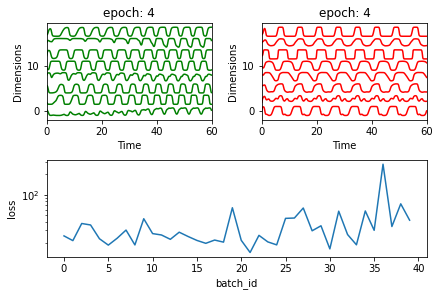

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.52738457 -0.54356088 -1.17994405  0.73050472  1.73904983  0.18515274
  -0.4607114  -1.4031742 ]
 [ 0.07116297  0.31216511  0.2880743   0.34200486 -0.10215179 -0.66542504
   0.03205872 -0.0173903 ]
 [-0.51180912  0.0226441  -0.29715199  0.36067705  0.11907028 -0.35775734
  -0.13023922 -1.30196952]
 [ 0.17241962  0.30978064  0.00946696  0.29219146  0.07869673 -0.57359971
  -0.28399447 -0.33443881]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.16s/it]

[[-1.17323844 -0.16281502 -0.41107712  1.48371656  1.26001041  0.5371467
   0.1901518  -0.5124155 ]
 [-0.88589869 -0.14094513 -0.53808173  0.95229538  1.15378549  1.02061313
   0.32100834 -0.43177243]
 [ 0.55546593  0.69408732  1.26955284  0.58533192 -0.45981385  1.01859389
   1.23532642  1.02938202]
 [-0.39309294 -0.33212444 -0.6298989   0.18699726  0.53425772  0.40056599
  -0.13075016 -1.48588677]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.12s/it]

[[-5.64690759e-01 -3.41040360e-01 -1.29040487e+00 -2.91306054e-02
   6.88546083e-01 -1.79999873e+00 -1.21264833e+00 -2.23989291e+00]
 [ 1.17486650e-01  1.24656686e-01 -7.37051727e-01  4.24269303e-01
   2.47584954e-01  1.45266306e-01 -3.31619545e-01 -6.28178624e-01]
 [-3.25007944e-02  3.84179039e-01  5.99359093e-01  6.26596822e-01
  -6.70856739e-04  2.30457677e-01  6.25496602e-01  6.11271626e-01]
 [ 4.49784281e-01  2.18791778e-01  7.92387418e-01 -3.15980065e-01
  -3.57239857e-01 -7.33596244e-01  4.96506504e-01  2.94930683e-01]]


 38%|███▊      | 3/8 [00:03<00:06,  1.25s/it]

[[-0.629785   -0.28246246 -0.45549755  0.36616174  0.72931071 -0.09751485
  -0.02224488 -0.64715142]
 [ 0.81283633  0.11664592  0.02876324 -0.1442375  -0.19600031  0.24383249
   0.18968297 -0.66156324]
 [-0.47249388 -0.57582493 -1.01743365 -0.25612768  0.60525296 -1.70137708
  -0.93602083 -1.60328426]
 [-1.0450797  -0.17690628 -0.79047497  0.87876876  1.28724492  0.36140651
  -0.23846972 -0.76201813]]


 50%|█████     | 4/8 [00:05<00:05,  1.28s/it]

[[ 1.71382351  0.43649365  0.0937347  -0.79512369 -0.98835606 -1.21279669
  -0.37457098 -0.36835193]
 [ 0.58438256  0.5689658   1.11968514  0.93018726 -0.45181043  1.3997062
   1.24941365  0.9482783 ]
 [-1.07796664 -0.10900117 -0.5904173   1.08229818  1.07932246  0.57536276
  -0.03347368 -0.60971733]
 [ 0.13893855  0.37602182  1.14572775  0.21501185 -0.46509685  0.45185346
   0.91769613  0.80734756]]


 62%|██████▎   | 5/8 [00:06<00:03,  1.20s/it]

[[ 1.05700041 -0.08870484  0.13666428 -0.82129207 -0.84335538 -0.24967302
   0.22071999 -0.99615456]
 [ 1.49223276  0.37607284  0.13369754 -0.80843375 -1.08408976 -0.59927431
  -0.10309897 -0.55802048]
 [ 0.07005057  0.23454311 -0.9896292   0.77839523  0.36025173 -0.05383979
  -0.62240229 -0.77717995]
 [-0.93837217 -0.05205753 -0.48323414  1.3959369   1.28199589  0.64122067
   0.12407224  0.08401291]]


 75%|███████▌  | 6/8 [00:07<00:02,  1.18s/it]

[[ 0.03704096 -0.18733096 -0.06656899  0.32327267  0.37597977 -0.13240533
   0.20553926  0.07220276]
 [-0.37328153  0.17797765 -0.0080322   1.27114023  0.63374582  1.41484392
   0.59592533  0.15243458]
 [ 0.97731167  0.15268641  0.86394434 -0.3827564  -0.9055896  -1.1099272
   0.57282697  0.03518953]
 [-0.72792875 -0.31362651 -0.88843829  0.38458304  0.81012233 -1.1402192
  -0.92329414 -1.26407839]]


 88%|████████▊ | 7/8 [00:08<00:01,  1.14s/it]

[[-1.06157937  0.09823065 -1.01258107  1.27701984  1.05031381 -0.2829947
  -0.72617809 -1.17064855]
 [-0.00702022  0.28848283  0.22122963  0.91940499  0.33753389  0.72479177
   0.38245367  0.20794552]
 [-0.23752847 -0.17286125 -1.13464144  0.10857184  0.67528232 -1.2406779
  -0.91339293 -1.41867202]
 [ 0.73511277  0.02379141  0.16050987 -0.57589559 -0.48736813 -1.6166593
  -0.16620057 -0.60318707]]


100%|██████████| 8/8 [00:02<00:00,  2.93it/s]


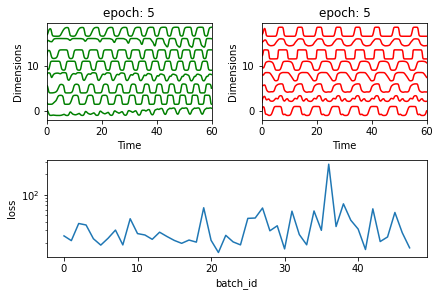

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.32388337 -0.44507952 -1.27087942  1.32840145  1.83597076  0.34422269
  -0.39336649 -1.17816517]
 [-0.24649814 -0.62291074 -1.47890766 -0.72406543  0.58841951 -2.27852701
  -1.44015635 -2.2990536 ]
 [ 1.55182737  0.22925557  0.52143627 -1.25870665 -1.38597485 -0.84408708
   0.30961921 -0.59934358]
 [-0.5466341  -0.52879691 -1.5647281   0.12880334  1.1467445  -1.19037896
  -1.026675   -2.08144955]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.01s/it]

[[ 5.60330827e-01  5.35614791e-01 -1.86008491e-04  6.35937456e-01
   5.20736842e-02  4.67757006e-01  2.22062475e-01 -4.03017511e-01]
 [-1.76089586e+00 -1.53612371e-01 -1.23016302e+00  1.41897671e+00
   1.76339225e+00 -2.71173276e-02 -7.56111932e-01 -1.09266060e+00]
 [ 1.18411308e+00  7.00794725e-01  1.30086112e+00 -6.74903051e-01
  -1.03378138e+00 -3.07040697e-01  6.67345869e-01  5.07387060e-01]
 [ 6.03831410e-02  3.25853480e-01 -3.60191415e-01  3.26295541e-01
   3.34995659e-01  3.44371393e-01 -2.52939755e-01 -5.82013470e-01]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.01s/it]

[[-0.7191855  -0.32152303 -0.62379598  0.58390312  1.03148066  0.38352841
  -0.06643103 -0.80599026]
 [ 0.91800334 -0.07856552 -1.07525628 -1.01753194 -0.53363666 -0.94494159
  -0.92019448 -2.22128811]
 [ 0.20875156  0.0204294  -0.04334307 -0.15428323  0.05397986 -1.11374816
  -0.01122201 -0.70181575]
 [ 0.71859288  0.56471679  1.46725895  0.36391211 -0.93679787  1.79623037
   1.5858332   1.18165218]]


 38%|███▊      | 3/8 [00:03<00:05,  1.04s/it]

[[ 0.28480176 -0.34175838 -0.31464827 -0.07078055  0.16247807 -0.51977863
  -0.03402277 -1.09480802]
 [-0.79635468 -0.12532914 -0.28767264  0.45811488  0.62393904 -0.79306657
  -0.1871757  -0.74366896]
 [ 0.82220298  0.25904822  0.51576771  0.19109214 -0.17728532  0.2941437
   0.58276923  0.80283448]
 [-0.01402249  0.05607413  0.6110755   0.0941008   0.14325926  0.23106079
   0.66567884  0.05079998]]


 50%|█████     | 4/8 [00:04<00:04,  1.01s/it]

[[-0.60735252 -1.03812661 -1.20039672  0.15271787  1.05070958 -1.71000587
  -0.69238496 -1.63991826]
 [-0.87651003  0.26905916 -0.06834807  1.3310163   0.83198172  0.78816925
   0.20361888  0.03938495]
 [ 1.53805432  0.87844106  1.12741447  0.23903096 -1.0054967   0.73342072
   0.97360013  1.07446506]
 [ 1.15993441  0.61851043  1.14679069  0.35332572 -0.90800003  0.52612327
   0.91241627  0.6370823 ]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.03s/it]

[[ 1.52926092  0.89911865  1.50117718  0.03561833 -1.49332372  0.88169408
   1.35781803  0.94352332]
 [-0.89924859  0.2995464  -0.35777955  1.21630141  0.64731042 -0.16103158
  -0.23507419 -1.16616927]
 [-0.06407901  0.13985796 -0.08169042  0.54165817  0.15917477  0.57280369
   0.24591001 -0.11190842]
 [ 1.24717114  0.09588445  0.37878464 -0.75493408 -0.73287816 -0.65671682
   0.26639792 -0.23218846]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.08s/it]

[[ 0.30154839  0.4237385   0.94671596  0.53883496 -0.41514916  1.22559456
   1.03810682  0.80996225]
 [-0.44299316 -0.04144188 -0.28257347  0.30978612  0.64726655 -0.14797389
   0.06123009 -0.64324815]
 [-1.22016433  0.38778187 -0.35621266  2.05166693  1.18364631  1.4954664
   0.23699255 -0.22941867]
 [-0.96392207  0.12903861 -0.29781758  1.00940001  0.75254607  0.3518019
   0.00440701 -0.54430333]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.09s/it]

[[-0.73217997 -0.08871969 -1.08523744  0.69120648  0.96202372 -0.26180302
  -0.77237466 -1.26458057]
 [-1.49359094 -0.61850944 -0.95900192  1.02128131  1.49259293  1.30472804
  -0.04374791 -1.3768291 ]
 [-1.84323049 -0.62150602 -0.92189812  1.294165    1.95475035  0.43069107
  -0.27482449 -1.08128775]
 [-0.13179684  0.402642   -0.12993859  0.07385837  0.25302087 -0.25285129
  -0.18649396 -0.53805825]]


100%|██████████| 8/8 [00:02<00:00,  2.95it/s]


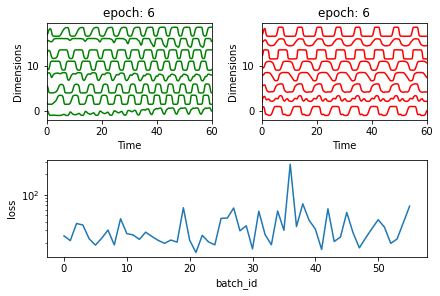

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.62558822  0.51775015  0.20253346  0.97154682  0.38491198  0.64044076
   0.13184718 -0.04502908]
 [ 1.33313846 -0.3648483  -0.3105076  -1.29551239 -0.74227445 -1.35627042
  -0.18858224 -1.68732167]
 [-0.45146001  0.25966233  0.27243942  0.89916784  0.30889051  1.32688589
   0.52915044  0.09322584]
 [ 0.71418643  0.91207153  1.49990228  0.77625398 -0.86890147  1.42165988
   1.52192545  1.10037276]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.00s/it]

[[-0.15552858  0.58302742  0.24983502  1.21045628  0.53113529  1.72110809
   0.63752669  0.49885479]
 [ 0.96922932  0.48936584  0.38679051 -0.02491078 -0.5029704  -0.31256768
   0.11714234 -0.43687075]
 [-1.32876727 -0.5203009  -1.80933334  1.05521043  1.85993856 -0.33207828
  -1.15643678 -1.69127229]
 [ 0.65333346  0.48137425  0.2331091   0.36089292 -0.56991715 -0.14042301
   0.16871005  0.56094621]]


 25%|██▌       | 2/8 [00:02<00:06,  1.04s/it]

[[-0.09258155  0.17698531  0.01937019  0.32464378  0.28115501  0.26377668
   0.11594823 -0.00975496]
 [ 0.74146603 -0.24604521 -0.88484334 -0.60770246 -0.00636571 -1.12786613
  -0.72414967 -1.41205289]
 [-0.021383    0.42032323  0.97571042  0.55327286 -0.20494169  0.48516564
   0.78454946  0.6645492 ]
 [-1.86806879 -0.61267943 -1.92049278  0.94175402  2.09688237 -1.29510179
  -1.31240995 -1.93597572]]


 38%|███▊      | 3/8 [00:03<00:06,  1.21s/it]

[[-0.13359094  0.17589357  0.15749449  0.31250709 -0.24581275 -0.16046262
   0.1833837  -0.18702541]
 [-0.2695282   0.48931504  0.18490592  0.8907719   0.62630446  1.25757791
   0.42048658 -0.13204075]
 [-1.04789991 -0.35801185 -0.73945318  0.57059147  1.11913765 -0.95841779
  -0.4669893  -1.53500325]
 [ 0.52889206  0.18683798  0.79137721 -0.06899467 -0.51053059 -0.1786647
   0.71773913  0.19194072]]


 50%|█████     | 4/8 [00:05<00:06,  1.52s/it]

[[ 1.27164293  0.27932511  0.31089225 -0.06410999 -0.49194519 -0.13294784
   0.23056913  0.25582191]
 [-0.17485111 -0.0261066  -0.2826833   0.31897345 -0.03674763  0.07987996
   0.09256036 -0.94873009]
 [ 0.45415964  0.81225334  0.50761947  0.7483933  -0.46969546  0.7121407
   0.30401165  0.27173132]
 [ 0.97817687  0.68622206  0.50865365  0.35900458 -0.55028594  0.13965686
   0.35151644  0.12124117]]


 62%|██████▎   | 5/8 [00:07<00:04,  1.64s/it]

[[ 0.30762117  0.37378216  0.39029616  0.37290674 -0.05949795 -0.33174587
   0.24489744  0.39366207]
 [ 1.25347262  0.41216994  1.29364573 -0.20792078 -0.97256101 -0.84105615
   0.81708334  0.95446614]
 [-0.4279608   0.22721776 -0.14889953  1.06182855  0.81394524  1.1741682
   0.33724454  0.31741118]
 [-1.07383388 -0.56604197 -1.2002738   0.81251744  1.48449039 -0.78574927
  -0.68989609 -1.45875451]]


 75%|███████▌  | 6/8 [00:09<00:03,  1.50s/it]

[[-0.32791957 -0.07257713 -0.92304542  0.61569298  0.80415699 -0.17462707
  -0.50140621 -1.07259841]
 [-0.17848718 -0.71151912 -1.56431792 -0.82619668  0.57912709 -2.63140639
  -1.20708765 -2.85357297]
 [-0.1263311   0.17124129 -0.18227378  0.66998999  0.44526804  0.61613444
   0.34126097 -0.945399  ]
 [ 0.71098937  0.05205753  0.36523062 -0.29007863 -0.64195021 -0.63041203
   0.16638499 -0.3338542 ]]


 88%|████████▊ | 7/8 [00:10<00:01,  1.48s/it]

[[-0.325647    0.39053048 -0.31567706  1.01978416  0.82574544  1.05989308
  -0.08997324 -0.70264771]
 [-0.02738362  0.55525886  0.35338154  1.30544328  0.28302977  1.05334287
   0.48733085  0.01378799]
 [-0.07561296 -0.26484171 -0.54493281  0.16009188  0.40936998  0.33929136
   0.14253328 -0.66200513]
 [-0.60425083  0.1501677   0.31201753  1.09902066  0.54792173  1.28473077
   0.60570169  0.47185423]]


100%|██████████| 8/8 [00:03<00:00,  2.63it/s]


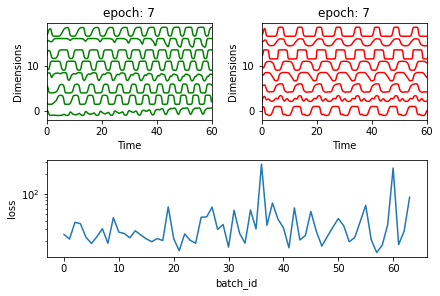

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.08638405 -0.18905431 -0.01496226 -0.24929225  0.32925405 -0.80729568
   0.09424049 -0.41772328]
 [ 0.43997718 -0.60751609 -0.13489316 -0.50875715  0.0328674  -0.31838327
   0.29662752 -1.1774846 ]
 [-0.81155099 -0.4978669  -1.00596569  0.08654911  0.98048136 -1.33897728
  -0.78300995 -1.75124792]
 [ 1.13833108  1.32677253  1.24431841  0.78092417 -1.1393726   1.95685396
   1.06990907  0.97063614]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.18s/it]

[[-1.64435801 -0.27643719 -1.16227943  0.91613496  1.39935432 -0.02229225
  -0.69334355 -1.41776673]
 [-0.17895998  0.73161262  0.61865699  1.53556806  0.18959317  1.45660825
   0.91227933 -0.00484838]
 [ 0.93989567  0.40467257  0.42251417 -0.52416054 -0.89090752 -0.28003987
   0.42957013 -0.16438805]
 [-1.93828552 -0.30363094 -0.92341605  1.60653202  2.06942342  0.00945552
  -0.29218471 -0.89149966]]


 25%|██▌       | 2/8 [00:02<00:07,  1.17s/it]

[[-0.35679172  0.15939092 -0.13053446  0.86591551  0.6272169   0.45278726
   0.16215823 -0.2393468 ]
 [ 0.37216101 -0.02839439 -0.55950966  0.02969563  0.13020749 -0.71155582
  -0.49731941 -0.47003992]
 [-0.11323518 -0.00345439  0.57975144  0.51819161  0.08260254  0.97028582
   0.8241729   0.11055828]
 [-1.17085284 -0.41451445 -1.63936692  0.86164379  1.41213301 -0.63037432
  -1.08592677 -1.94882601]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:03<00:05,  1.10s/it]

[[ 0.21517027  0.09217732  0.78324502 -0.09610454 -0.16469647 -0.42215171
   0.70093344  0.78183763]
 [-0.86737563  0.04512228 -1.05148456  0.95323397  0.99301735 -0.18004614
  -0.78637605 -1.13440576]
 [ 1.19356939  0.66821369  1.67333002  0.2589004  -0.9789009  -0.06855484
   1.25475409  1.2137085 ]
 [ 0.54498045  0.36721209  1.11400621  0.53268798 -0.44297126  0.22821586
   1.01883244  0.57149066]]


 50%|█████     | 4/8 [00:04<00:04,  1.06s/it]

[[ 1.24851433  0.4152941   0.27100745 -0.72894868 -1.06047855 -1.30843488
  -0.26504546 -0.86667383]
 [ 0.39165679  0.18212837  0.07440475  0.29269555 -0.34061255  0.13365449
   0.2106162  -0.43750589]
 [ 0.19800949 -0.13465512 -0.15413845 -0.51273326 -0.31547319 -1.15366764
  -0.19074973 -1.2886677 ]
 [-0.66193738 -0.34862047 -1.3804345   0.2761987   0.75180299 -1.04088463
  -1.08594666 -2.10250095]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.03s/it]

[[-0.27122449  0.12587745 -0.62305542  0.95439279  0.80505225  0.80485965
  -0.03277415 -0.5265829 ]
 [ 0.31648408  0.20001921  0.00372592  0.30378646  0.12107124  0.24530178
   0.10737251 -0.43586734]
 [ 1.69822251  1.00693123  1.88287351 -0.25321794 -1.74995114  1.0147708
   1.43934924  1.14008724]
 [-1.33936455 -0.28299303 -0.74647309  1.6503242   1.75077732  0.97194862
   0.01108284 -0.55696038]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.02s/it]

[[ 0.87157225  0.64277019  0.99335366  0.18359009 -0.45120916  0.79767656
   0.87907871  0.67714996]
 [-1.01421971 -0.29663853 -0.26469801  1.07864494  1.13355329  1.07472852
   0.53935008 -0.78955433]
 [ 0.82277798  0.15900709  0.29066146 -0.31565789 -0.64124884 -0.32750699
   0.22691979 -0.43601773]
 [ 1.5249012   0.16211804  0.33430962 -1.11314165 -1.08167078 -1.6793464
  -0.15885601 -0.69148512]]


 88%|████████▊ | 7/8 [00:07<00:00,  1.01it/s]

[[-0.58292446  0.6679221   0.26711934  1.4976722   0.51140163  1.50832928
   0.28022932  0.67592848]
 [-0.48219652 -0.07189223 -0.43699633  0.71874032  0.84299214 -0.35167271
  -0.07325152 -0.55783698]
 [ 0.39737694  0.30469176  0.42928629  0.66121701  0.2282953   0.466676
   0.57967883  0.74905524]
 [ 0.91220929  0.59395726  0.61050052 -0.41187581 -0.76856815 -0.61697505
   0.1830851   0.18335105]]


100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


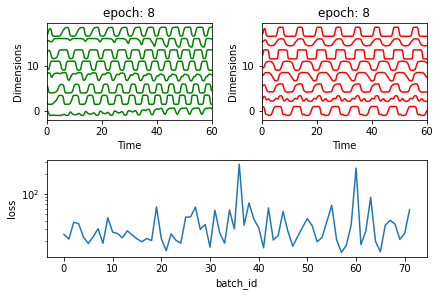

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.63831229  0.01070613 -0.55548083  1.04206343  0.83857054  0.50522643
  -0.0683127  -0.98825044]
 [ 0.51619997  0.79710862  0.7027734   0.80624549 -0.38966129  1.29161647
   0.80777685  0.42459516]
 [-0.04309792 -0.23873422 -0.41161458 -0.22540027  0.02893328 -1.11053106
  -0.35677225 -1.30950943]
 [-0.31041293  0.40732756  0.70251716  0.62021745  0.16465648  0.67587077
   0.84998821  0.16479462]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.05it/s]

[[ 1.86732775  0.30534841  0.98481117 -1.27416283 -1.59784518 -1.50965677
   0.40250545  0.53611703]
 [-0.54290727  0.12331511 -0.14295191  0.50839311  0.52314115  0.13345319
  -0.05182055 -0.03044374]
 [-0.45557861 -0.08345337 -0.78698942  0.75212454  0.72849413 -0.22851467
  -0.43746651 -1.05540101]
 [ 0.42661797  0.41476175  0.33842653  0.17548578  0.09973667  0.28850487
   0.17726425  0.14163745]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[-0.2025603  -0.19673983 -0.43622071  0.44587092  0.61316066 -0.35008547
  -0.00336274 -0.76634748]
 [ 0.82842294  0.26756873  0.58093471  0.27319428 -0.45157733  0.54345588
   0.64496168  0.3350808 ]
 [-0.36035156  0.18600066 -0.4558818   1.17305192  0.53613869  0.39405527
  -0.23708652 -0.60312453]
 [-0.99106404 -0.06839954 -0.41166845  1.08380743  1.01082337  0.22115891
  -0.11878415 -0.91820213]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[ 0.36500968  0.46774592  0.13364737  0.34151414 -0.24574222  0.13122867
   0.11732743 -0.34318386]
 [-1.09495626 -0.24560056 -0.78637512  1.07602298  1.17161172  0.89411057
  -0.06773967 -0.57420718]
 [ 1.3304317   0.36852714  0.62103489 -0.82259935 -1.14908285 -1.51973565
   0.08381699 -0.00981969]
 [ 0.17453441  0.43105565  0.0398769   0.46461556 -0.11667145  0.60023001
   0.19068036 -0.65848692]]


 50%|█████     | 4/8 [00:03<00:03,  1.04it/s]

[[-0.90647211  0.35971918  0.02052418  1.32648024  0.71916908  1.20989352
   0.51240129 -0.34709051]
 [-0.77456348 -0.1053168  -0.81645066  0.85081748  1.4462132   0.23866534
  -0.34463795 -0.69495335]
 [ 0.60010496 -0.03930715  0.21875985 -0.59348961 -0.23169522 -1.14486931
   0.04513321 -0.188333  ]
 [ 1.11727557  0.08627481  0.23551721 -0.73201612 -0.66190124 -0.9216102
   0.04950676 -0.51692295]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[-1.09990039 -0.30267085 -1.02835292  0.56937079  1.0340822  -0.83216327
  -0.69011344 -1.49041854]
 [-0.97181948  0.18149562  0.15239675  1.09956985  0.61900862  0.61183183
   0.34955212  0.15296396]
 [-0.07899028  0.29064539 -0.10503076  0.75779164  0.61188161 -0.11744084
   0.19756034 -0.19018295]
 [-1.08409245 -0.21536312 -0.63711403  1.44746055  1.48341978  1.23101615
   0.12773182 -0.85342501]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.02it/s]

[[ 1.37033267  0.98047502  1.40071222 -0.04431388 -1.18181729  0.10023069
   1.03906963  0.89710455]
 [-1.15045259 -0.253073   -0.1081943   1.11707734  1.26154403  1.12171812
   0.33356744 -0.14535122]
 [-0.58108617 -0.10386542 -0.52479918  0.54934262  0.83968098 -0.47818605
  -0.34528165 -0.80322111]
 [-0.0954472   0.18065715 -0.07159799  0.45456745  0.043542    0.87674376
   0.19865621 -0.41936668]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[ 0.01206858 -0.28238635 -0.23543268 -0.09036348  0.02137463 -0.96798598
  -0.21100882 -1.08246033]
 [ 1.19290171  0.66706922  1.21738144 -0.34311869 -1.1886552   0.30635025
   0.95889451  0.68723402]
 [-0.3280083   0.37369618  0.4716974   0.77759821  0.24474533  0.40058975
   0.48524518  0.48059949]
 [ 0.49985757  0.33630814  0.88145712  0.34402206 -0.57252578 -0.2528202
   0.78145457  0.33960577]]


100%|██████████| 8/8 [00:02<00:00,  3.23it/s]


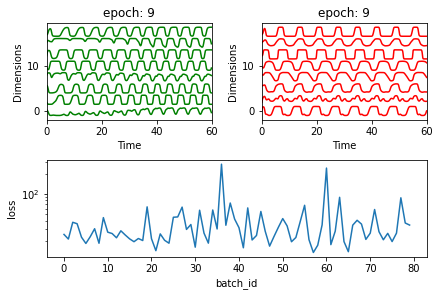

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.34829081 -0.06709492 -0.43222474  0.82507659  0.72342154  1.66420981
   0.33245445  0.25309618]
 [ 0.79453456  0.07547493 -0.72528635 -0.47966666 -0.27537557 -1.17978944
  -0.76804091 -1.1539202 ]
 [ 0.13238959  0.22469901 -0.09235864  0.34835603  0.20619887  0.23920194
   0.11492664 -0.38641791]
 [ 0.50744817  0.01455834  0.1495742  -0.63105042 -0.89222725 -0.97416906
   0.02135834 -0.79344761]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.08s/it]

[[-0.11626678  0.5759708   0.25695361  1.02666657  0.16161801  1.21278982
   0.53022682 -0.2580827 ]
 [-0.65263437  0.02629489 -0.28528382  1.00334809  0.79792962  0.55178553
   0.10829058 -0.8112436 ]
 [ 0.73329661  0.44649989  0.44436287 -0.71778805 -0.98120133 -1.46486858
  -0.18299606 -0.28131175]
 [-0.56449048 -0.2864368  -1.33673468  0.28566258  0.7293327  -1.53523746
  -1.12245684 -1.84776889]]


 25%|██▌       | 2/8 [00:01<00:06,  1.03s/it]

[[ 0.43884674  0.93359552  1.07883788  0.95623735 -0.405701    1.83313279
   1.14136211  0.73741552]
 [-0.53302163  0.54990303  0.24155767  1.16769383  0.5217782   0.96479015
   0.33018717  0.32583224]
 [-1.27941064 -0.49822191 -1.76709401  0.63867355  1.53638334 -1.91853475
  -1.48220012 -1.5995187 ]
 [-1.89885126 -0.86647633 -1.77958587  0.82826559  1.70512632 -0.92029764
  -0.96649691 -2.3062856 ]]


 38%|███▊      | 3/8 [00:02<00:04,  1.02it/s]

[[ 0.53689501  0.82883136  0.93328278  0.77721429 -0.51351099  2.31167122
   1.3015578   0.53170712]
 [-0.27144929 -0.41556384 -0.42772447 -0.22703783  0.36369686 -0.60329785
  -0.20996349 -0.84861126]
 [-1.39217536  0.00756453 -0.72061156  2.03929557  1.71660656  0.38829018
  -0.20455625 -0.11127586]
 [-1.06536352  0.03496527  0.12293218  1.32914827  0.97532783  0.69636635
   0.59453689  0.27232607]]


 50%|█████     | 4/8 [00:03<00:03,  1.04it/s]

[[-0.29243703 -0.30158184 -0.70278732 -0.27825856  0.56086694 -1.43815798
  -0.56342966 -1.79956198]
 [-0.53021945 -0.21529892 -0.72703418  0.24809367  0.69061276  0.08609351
  -0.17639318 -1.15135026]
 [ 1.56018971  0.82593419  1.32771764 -0.11480045 -1.51176677  1.52496453
   1.21511826  0.90240323]
 [-0.51661838  0.09695033 -0.2581163   0.768572    0.46324109  0.70044349
   0.1012641  -0.79798724]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.05it/s]

[[-2.03536482 -0.0106356  -0.54382232  2.24571568  2.02579346  1.51659977
   0.13716333 -0.01687522]
 [-0.57372231 -0.43307288 -0.527874    0.00962117  0.36515074 -1.09392836
  -0.37974589 -1.17451306]
 [-1.19271885 -0.17060386 -0.59099062  1.46307564  1.33552051  1.05233799
   0.03442379 -0.44038159]
 [ 0.42834238 -0.311882   -0.39094969 -1.0737771  -0.28732361 -1.41371139
  -0.48715663 -1.26070202]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[-0.66964267 -0.51978067 -1.2166193   0.32082403  1.06866706 -0.81472056
  -0.79810582 -1.3291094 ]
 [ 3.10728209  0.89364832  2.14728121 -1.30591409 -2.50510457 -0.61562276
   1.36965017  1.55584101]
 [ 0.14809729  0.66965594  0.41490168  0.60341548 -0.27914526  1.0790436
   0.4101411   0.2556549 ]
 [-1.09810913 -0.29879632 -0.26210554  0.74941033  1.10532715  0.64325605
   0.27244977 -0.68729131]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[ 0.80834118  0.62152478  0.89446284  0.24200228 -0.46452076  1.27728739
   1.18595002  0.95803937]
 [-0.32304178  1.00194222  1.44303535  2.28460635  0.22448945  2.63765539
   1.66674498  1.75496682]
 [-0.45040664  0.33058173 -0.76694718  1.47746135  0.88345712  0.30385601
  -0.32736632 -0.50895363]
 [ 0.31352432  0.42725514  1.04536737  0.9327715  -0.40200556  0.92555097
   1.18680087  1.04994803]]


100%|██████████| 8/8 [00:02<00:00,  3.19it/s]


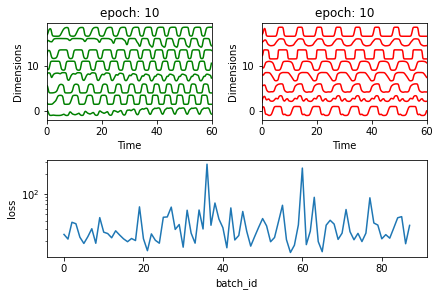

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.43868113  0.01916294 -0.71218567  1.52826895  1.3760212   0.41315809
  -0.14734978 -0.75661974]
 [-0.70638641 -0.14869679 -0.48556247  0.81211044  0.83660562  0.30721716
   0.02057304 -0.82376591]
 [-0.47694683  0.02325487  0.16127834  0.40475758  0.31686211  0.85452415
   0.57802273 -0.93875771]
 [-1.07411411  0.22802503 -0.85128783  1.50668556  1.47472126  1.19022986
  -0.22380166 -0.25946239]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[-0.93916357 -0.5615375  -0.95670227  0.59068522  1.28826478  0.13640932
  -0.2005243  -0.84022888]
 [-0.52024807 -0.04964681 -0.44786984  0.42299235  0.63748133 -0.78437066
  -0.44221743 -0.67489635]
 [ 0.69080772  0.0875582  -0.24289495 -0.15368018 -0.29555051 -0.57670766
  -0.23268822 -0.79699972]
 [ 0.90634801 -0.00588629  0.26549189 -0.71632506 -0.71917644 -1.45805296
   0.06609808 -0.66444975]]


 25%|██▌       | 2/8 [00:01<00:05,  1.10it/s]

[[-0.81123702  0.03931635 -0.53773383  1.15056791  0.69740963  0.69044908
  -0.09100012 -0.56375249]
 [-0.31336031 -0.15994839 -0.27341476  0.86745997  0.66298618  0.76733234
   0.3463721  -0.26123209]
 [-2.21076817 -0.52402123 -1.3701036   1.622164    2.48945902  0.72337138
  -0.57205073 -1.06381   ]
 [ 0.05991532 -0.06788109 -0.30241     0.32356475  0.41122515 -0.10822611
  -0.02489995 -0.83413471]]


 38%|███▊      | 3/8 [00:02<00:04,  1.10it/s]

[[-0.54055195 -0.84764054 -1.15327806 -0.76778223  0.88588898 -1.91414968
  -1.04256478 -1.91334128]
 [ 0.50282613  0.87139533  0.67294365  0.6050449  -0.5486158   0.23004555
   0.44086566  0.27780771]
 [-1.75649828 -0.5785713  -1.40759947  0.97685951  1.67692985 -0.47292501
  -0.85317408 -1.62425754]
 [-0.91263315 -0.17188392 -0.56631262  0.97452464  1.25282436  0.4186252
  -0.11990872 -0.49870028]]


 50%|█████     | 4/8 [00:03<00:03,  1.06it/s]

[[ 0.88983104  0.45595101  0.06448968  0.01548676 -0.31074645 -0.18910752
  -0.06365348 -0.3727938 ]
 [-0.09916298  0.07252633 -0.19980741 -0.03651194  0.20620986 -0.36588866
  -0.03052158 -0.94264699]
 [-0.28804514 -0.53864836 -0.65357477 -0.19235404  0.32065225 -1.40213416
  -0.35443192 -2.03812596]
 [-0.73345686 -0.19158672 -0.4630571   0.69020705  0.72868679 -0.59619056
  -0.35480927 -0.57470129]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[ 0.26243306  0.47674034  0.91306939  0.63681648 -0.27156752  0.36669004
   0.8216346   0.6136906 ]
 [-0.41038038 -0.1357416  -0.50755562  0.39225203  0.55068727 -0.73680721
  -0.39175787 -0.69064318]
 [-0.68541188  0.2129457   0.0383968   1.07080074  0.34234794  0.30922815
   0.03089258  0.14139101]
 [ 0.73811005  0.104319   -0.44245892 -0.54275253 -0.29511888 -1.38047754
  -0.64416483 -0.96971216]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[ 0.09253433  0.46509202  0.05746232  0.7471412  -0.09951535  0.93276031
   0.09532292 -0.36756659]
 [-1.54906035  0.2905052  -0.61517049  2.08488333  1.31899801  0.85934969
  -0.14848157  0.24060144]
 [ 0.63519045 -0.04602974 -0.0844232  -0.18713832  0.04590053  0.0716711
   0.31312783 -0.2818463 ]
 [ 0.80437456  0.16362489  0.41558667 -0.26795073 -0.50433619 -0.88529068
   0.20105926 -0.34951343]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-0.90198106 -0.45842303 -0.55046818  0.77967617  0.96931186 -0.10967403
   0.13668837 -0.44519402]
 [-0.5557171  -0.19115794 -0.28025786  0.62811528  0.82176623 -1.10032458
  -0.32105302 -0.0090797 ]
 [-0.09604046  0.0525898  -0.14463703  0.8666631   0.53647909  0.58034319
   0.32049757 -0.09506305]
 [-0.53808124 -0.66855916 -1.78149585 -0.32404091  1.12286733 -1.52875638
  -1.12674887 -1.76239513]]


100%|██████████| 8/8 [00:02<00:00,  3.22it/s]


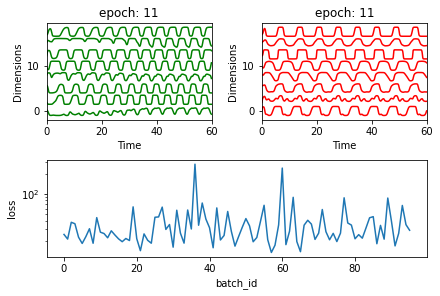

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.36670566 -0.10483764  0.08417286  0.03089126 -0.04957943 -0.2817944
   0.31321113 -0.26852494]
 [ 0.42926829  0.14160332  0.52025343  0.14109587 -0.15317407 -0.20786589
   0.5072285   0.09371368]
 [ 1.32931948  0.64705145  1.49028015  0.19915839 -1.0073165   1.38532665
   1.55766178  1.21624818]
 [-0.10435546 -0.15442071 -0.14359738  0.40407767  0.27331074  0.57003319
   0.32489478 -0.66462883]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.05s/it]

[[-1.03450103 -0.49062214 -0.6064394   0.85425181  1.10999634  0.07726446
  -0.12749868 -1.01574838]
 [-0.53626269 -0.24938978 -1.43763965  0.12283316  0.65721058 -1.71873722
  -1.43496139 -2.12835109]
 [ 0.60596304  0.18947207  0.56330661  0.03241581 -0.21940999 -0.54720871
   0.42463798 -0.04496769]
 [ 0.25767747  0.68453962  0.60246591  0.52883207 -0.26803526  1.25858318
   0.69906592  0.42149054]]


 25%|██▌       | 2/8 [00:02<00:06,  1.04s/it]

[[-0.14192973  0.16721443  0.05563112  0.39384817  0.25380791  0.35308187
   0.23058656 -0.50407261]
 [-0.33499085 -0.30136522 -0.36719129 -0.16088702  0.37349631 -0.85142728
  -0.23362797 -0.58691533]
 [-0.44888047  0.1397445   0.22344253  0.9808574   0.65750146  0.34665623
   0.61218178  0.21194036]
 [ 0.88976693  0.76454799  1.37278288  0.23799744 -0.74576451 -0.02618346
   0.82765403  1.29935729]]


 38%|███▊      | 3/8 [00:02<00:05,  1.01s/it]

[[ 0.40406988  0.26109177  0.65103418 -0.04158726 -0.30822248 -0.14197625
   0.526944   -0.08135623]
 [-1.23215588 -0.54244942 -1.82238721  0.88729082  1.20945176 -0.23641227
  -1.22100112 -2.72273885]
 [ 0.23896837 -0.06186249 -0.22758041 -0.50137773  0.04337612 -1.36080232
  -0.5176521  -0.73608868]
 [ 0.8743718   0.29841342  0.02574993 -0.26624798 -0.30300223 -0.3430808
  -0.16323494 -0.23690266]]


 50%|█████     | 4/8 [00:03<00:03,  1.03it/s]

[[ 0.30935296  0.55601424 -0.17857387  0.3972321  -0.21313589 -0.1484632
  -0.27308103 -0.72394722]
 [-0.05850072 -0.08255266 -0.28906662  0.09692284  0.26942279 -0.75078602
  -0.14831866 -1.20188223]
 [-0.8229734   0.00638363 -0.42864084  0.91838852  0.95423688  0.24867974
  -0.03453414 -0.53879722]
 [ 0.04670618 -0.28667403 -0.4796074  -0.22905453  0.32854039 -1.19488025
  -0.35175552 -1.070412  ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[-0.06063812  0.0072153  -0.25006675  0.01439762  0.12620224  0.19638526
  -0.04473209 -0.30014304]
 [-0.23193333 -0.39335247 -1.36778094  0.02715477  0.97603531 -1.21703341
  -1.14026944 -1.44339403]
 [ 0.18500689  0.7421228   1.341749    1.22839358 -0.16808746  0.42615744
   1.03249445  1.02189986]
 [ 0.00549307  0.18224959  0.03980586  0.64424268  0.43987241 -0.27031566
  -0.09172912 -0.26572628]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.02it/s]

[[-0.36476476 -0.20126786  0.0589121   0.4419736   0.71479439  0.75161545
   0.56810876 -0.20297133]
 [-0.94918845  0.01131836 -0.4956511   0.75149164  1.18105876 -0.24313906
  -0.38161045 -1.04874451]
 [ 1.53703811  0.9394259   1.24288422 -0.12680623 -1.15821162  0.05106093
   0.77932294  0.97890586]
 [-0.70328152 -0.70272623 -1.49574982 -0.74788871  0.76916986 -2.46450076
  -1.37641493 -2.4594233 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.05it/s]

[[ 1.57524141  0.42959118  0.8486265  -0.36996432 -0.99046601  0.07692084
   0.66835485  0.70504632]
 [-0.61783306 -0.45745439 -1.31487689  0.01696292  0.90940481 -1.38800063
  -1.09313727 -1.73106587]
 [ 0.18056281  0.21492671  0.78934909  0.49795622 -0.14457561 -0.82168045
   0.43487922  0.95356162]
 [ 0.24190018  0.37799307  0.46822499  0.40228312  0.27450643  0.09402579
   0.53016603  0.35360715]]


100%|██████████| 8/8 [00:02<00:00,  3.16it/s]


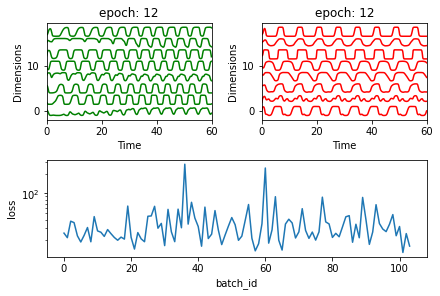

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.14328605 -0.27792808 -0.1624825  -0.44070069 -0.04363821 -1.02808142
  -0.13857575 -0.56550736]
 [-0.15420947 -0.18601433  0.08496835 -0.08992943  0.45875214 -0.57790603
   0.1777891  -0.69359161]
 [-0.25972279  0.24786206  0.5905474   1.02816389  0.37502353  1.3056299
   1.00873083  1.01545758]
 [ 0.0306096  -0.51261592 -1.07137394 -0.84794754 -0.09545515 -1.58041808
  -0.91752594 -1.94529467]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.00s/it]

[[ 1.67541788  0.34812995  1.30744982 -0.6621077  -1.2113215   0.28616842
   1.03880978  0.45095595]
 [-0.18149391  0.34864033  0.74554619  0.40066107 -0.17822602  1.12238845
   0.76980821  0.39484072]
 [ 0.14615135  0.4592217   0.56282677  0.46043312 -0.28867851  1.68020851
   0.71290533  0.6240496 ]
 [ 1.3431159   0.43716787  0.26132982 -0.77229487 -0.98101528 -0.59547477
   0.1859935  -0.39911361]]


 25%|██▌       | 2/8 [00:02<00:06,  1.04s/it]

[[-1.71666158  0.00978042 -0.90527626  2.20330804  1.95656612  2.29433285
   0.02973208 -0.5227456 ]
 [ 0.60426739  0.06898991  0.42213495 -0.43089592 -0.60503455 -0.8816435
   0.1691402  -0.86152997]
 [ 0.28245566 -0.20913991 -0.7726368  -0.43610001 -0.33561793 -0.53620774
  -0.43950673 -1.5577976 ]
 [ 1.09071544  0.81966166  1.11141765  0.28894513 -1.05037871  0.92917313
   0.97085454  1.21384778]]


 38%|███▊      | 3/8 [00:03<00:05,  1.05s/it]

[[ 1.91066723  0.27349924  0.63140432 -1.72709109 -1.78279433 -1.2154208
   0.05422778 -0.50674549]
 [-1.28250991 -0.29312952 -0.76965604  0.98663501  1.25094687  0.06524902
  -0.33962322 -1.05140431]
 [-1.99244129 -0.77910182 -1.52126235  0.69789242  1.83670425  0.20110136
  -0.53744422 -2.42976134]
 [ 1.8444205   0.17813927  0.45321325 -1.5473314  -1.39594725 -2.29362842
  -0.19800818 -0.3224012 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 50%|█████     | 4/8 [00:04<00:04,  1.05s/it]

[[ 1.22912582 -0.17203293 -0.23996312 -1.42766111 -0.71479323 -2.21745547
  -0.55984827 -1.50081091]
 [ 0.2868373   0.22684138 -0.13712681 -0.18919396 -0.46638621 -1.77202366
  -0.60083632 -0.76835408]
 [ 0.07098773  0.38903178  0.09563324  0.84787878  0.018528   -0.46048941
   0.07308795 -0.33060003]
 [-0.323818    0.09610839 -0.20931617  0.75106195  0.34307259 -0.13247423
  -0.09957285 -0.49527818]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.03s/it]

[[ 0.36991125  0.28514812  0.21799768  0.24143967  0.04347308  0.75671607
   0.53821374 -0.04412914]
 [ 0.47042222  0.88151139  1.61371355  0.6610492  -0.51270929  2.08240846
   1.59557948  1.3083384 ]
 [ 0.54806018  0.60097474  0.56558233  0.44029137 -0.53521665  0.1692187
   0.55800732 -0.18607691]
 [ 0.37030974  0.02117597 -0.02112344  0.01654303 -0.14439188 -0.0931828
   0.11451245 -0.098455  ]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.00s/it]

[[-0.22397553  0.08900129 -0.11771088  0.44906294  0.3546159   0.06926911
   0.08990544 -0.94519014]
 [-0.66322626 -0.74093917 -1.17344012  0.09417173  0.88015821 -0.82248041
  -0.7778678  -1.57818842]
 [-0.25720175  0.14137576 -0.05639585  0.8385842   0.6777739   0.38732958
   0.24459771  0.07906678]
 [ 0.93896144  0.75305014  0.73842817  0.20809784 -0.89495728  0.18230845
   0.51412863  0.77714112]]


 88%|████████▊ | 7/8 [00:07<00:00,  1.00it/s]

[[-0.53931844  0.48440015  0.03586167  1.41655438  0.44155543 -0.2806336
  -0.21348447  0.41564448]
 [ 1.44262597  0.87087342  1.22594041 -0.51960213 -1.2884336  -0.9538923
   0.4904961   0.57715165]
 [ 1.51273721  0.71992066  0.69219399 -0.20337221 -1.16793329 -1.57023647
   0.06173801  0.41446683]
 [-0.83529066 -0.71019075 -1.43829175  0.14944177  1.44970688 -1.77216572
  -0.97452604 -1.81557121]]


100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


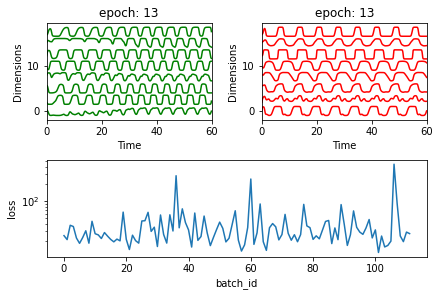

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.76098451 -0.73793406 -1.57346208  1.07554583  2.0238922  -0.58519409
  -0.92054974 -1.34456561]
 [-0.53078751 -0.13343315 -0.70499316  0.42638193  0.71805851  0.12111608
  -0.26374689 -0.86148903]
 [-1.06173755 -0.81658276 -1.18662054 -0.08574167  1.2009169  -1.14232744
  -0.81141188 -1.42616839]
 [ 0.21379876 -0.22631338 -0.39647618 -0.38030101  0.20304729 -0.5659534
  -0.17547367 -0.7145228 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.01s/it]

[[ 0.94232684 -0.10222599 -0.09265058 -1.23024797 -0.84470191 -2.19965728
  -0.4933585  -0.71214352]
 [ 0.62335168  0.47595554  0.31556701  0.11298824 -0.71756449 -0.05245022
   0.15813665 -0.28818555]
 [ 0.1011741  -0.27634245  0.6327793  -0.43893222 -0.33301094 -1.33509217
   0.47546404  0.32547404]
 [ 0.48979926  0.37902277  0.68728939  0.33326311 -0.42158694  1.00128747
   0.93303054  0.31836307]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.03it/s]

[[-0.05992481  0.39705641  0.79640065  0.54181774  0.11911495  0.86476388
   0.8383706   0.57541684]
 [ 0.38693785  0.48412885  0.15077351  0.24474729 -0.59786988  0.78603111
   0.14666762  0.13380302]
 [-0.94735072  0.19843834 -0.34260089  1.18383756  0.89698977  0.16405762
   0.01713363 -0.39595785]
 [-0.7145739  -0.20740651 -0.58611838  0.59008445  1.0657454   0.53084739
   0.02715144 -0.71309314]]


 38%|███▊      | 3/8 [00:02<00:04,  1.06it/s]

[[-1.09280834 -0.43656898 -1.06876795  0.50641853  1.14676837 -0.71381322
  -0.74375904 -1.48291408]
 [-0.64763661 -0.72167398 -1.32978801 -0.30724763  0.96363396 -2.90019809
  -1.35308093 -1.86157763]
 [-0.23698274 -0.27556769 -0.17127656  0.16382632  0.63915876 -0.71465799
   0.08268434 -0.63609457]
 [-1.091569   -0.1658873  -0.83864623  0.97483983  1.26191787 -0.68668353
  -0.58164169 -1.09741231]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[-0.73293313 -0.1749727   0.177386    0.84735711  0.54326973  0.70112707
   0.71027527 -0.45383795]
 [-0.49179285  0.0867435   0.51590696  1.02828187  0.74447852  1.14407317
   0.94967625  0.63769229]
 [ 1.41185669  0.61460598  1.0838601  -0.68949285 -1.30279568 -0.73782067
   0.47163635  0.52097945]
 [ 0.51860414  0.34895579  0.67075245  0.24109857 -0.45844786 -0.2891323
   0.51490049  0.44918347]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[ 0.66541143  0.19058345  0.73123952 -0.26811647 -0.54877375  0.554517
   0.74954376  0.05887277]
 [-0.25414136 -0.06040412  0.29356541  0.70933315  0.46064402  0.69630015
   0.64675201  0.18684097]
 [ 0.98843649  0.39371014  0.62395449 -0.43446401 -1.0005219  -0.28392374
   0.35792542  0.49426696]
 [-0.01032822 -0.89492058 -0.86966031 -1.23125972  0.47401866 -2.98534158
  -1.06732057 -1.97644078]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[ 0.89699477  0.44819597  0.50500058 -0.16187986 -0.98157929 -0.46976936
   0.2297105  -0.52285734]
 [-0.679903    0.30374498  0.27981122  0.91805938  0.52735507  0.42724239
   0.35840947  0.40609983]
 [-0.29706808  0.06965779 -0.07526399  0.44270924  0.26228447 -0.29733219
  -0.11023192 -0.54953426]
 [ 0.68544086  0.22276976  0.45675114 -0.05503887 -0.55294982 -0.39712878
   0.31687992  0.00377025]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[-1.59818745 -0.2650149  -1.19483795  1.38792301  1.66838772 -0.45220928
  -0.72392296 -1.13468606]
 [-0.95175521 -0.44337403 -1.0915043   1.13454514  1.47324501 -0.39450046
  -0.52560999 -0.72638864]
 [-0.48314308  0.26218235 -0.3379557   1.01383047  0.85967119  1.02027521
   0.17793383 -0.46294548]
 [-1.12742791  0.159104    0.22844561  1.73314768  0.95648486  0.7217014
   0.31432329  0.83330066]]


100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


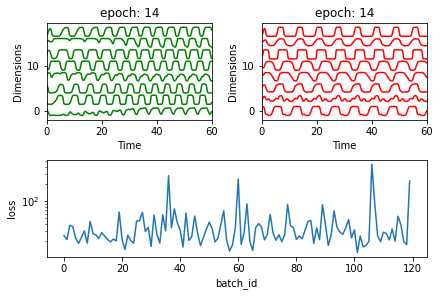

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.1728106  -0.12198926  0.06821705 -0.42181772  0.05004137 -0.47022758
   0.09289355 -0.17911021]
 [-0.57714016  0.10945422 -0.64122363  1.06836252  0.85540161  0.73846864
  -0.07738099 -0.46826848]
 [ 0.26728441  0.26088717  0.3432264   0.41788687  0.07579079  0.81385812
   0.56110984  0.02721499]
 [-1.3971376  -0.05425429 -0.68624548  1.6266116   1.47389482  1.30098082
   0.00709817 -0.06902233]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[ 0.76932207 -0.11625806  0.06314021 -0.63575884 -0.62917407 -0.31600672
   0.11280556 -0.34562156]
 [ 1.35825838 -0.01518932 -0.07172692 -1.47915108 -0.88468125 -1.97821895
  -0.4992927  -1.04144405]
 [-0.33384481  0.28834175  0.31935706  1.52716373  0.38248388  1.50550537
   0.80404227  0.84824879]
 [-0.2133854   0.01287983 -0.47120359  0.67350457  0.48249759 -0.03945484
  -0.16218396 -0.61391693]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[-0.06734377  0.31867398  0.24437646  0.68584271  0.23694746  1.03352563
   0.6081773  -0.56125435]
 [-0.33268936  0.35622903  0.04013187  0.92569254  0.51593375 -0.22518965
   0.08257171 -0.09930651]
 [-0.02985698 -0.26996498 -0.7190959  -0.05424652  0.61646108 -0.86556951
  -0.47041457 -0.71849673]
 [ 0.4931831  -0.04709861  0.2966805  -0.33192715 -0.41328026  0.0682768
   0.42759513 -0.50673506]]


 38%|███▊      | 3/8 [00:02<00:04,  1.08it/s]

[[ 0.68976213  0.56332066  0.49778482  0.34314396 -0.52193767 -0.58207337
   0.06494336  0.31036609]
 [ 0.87788086  0.34083034  0.26512447 -0.07674367 -0.66893257 -0.01596333
   0.18772761 -0.36563614]
 [-0.15602281  0.00740933 -0.25368742  0.03438402  0.24457188 -0.67971961
  -0.26085612 -0.78520501]
 [ 1.46805448  0.70257168  1.56784954 -0.07961891 -1.39430301  0.49094005
   1.26933824  1.15893159]]


 50%|█████     | 4/8 [00:03<00:03,  1.10it/s]

[[-0.58180255 -0.14651753 -0.25231164  0.9614755   1.15500346  0.41350847
   0.1901018  -0.04168423]
 [-0.69729533 -0.14563604 -0.47471704  0.41036611  0.73112224  0.68295509
   0.09436758 -1.05135206]
 [ 1.4690639   1.05028539  1.42989727  0.56714408 -1.16284679  1.61970073
   1.45865867  1.15312657]
 [-0.00410877  0.43809832 -0.60308411  0.59889024  0.35077637  0.40865962
  -0.45701823 -0.5204469 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.10it/s]

[[-0.54400411 -0.40838573  0.13350276  0.64695256  0.89750473 -0.20672668
   0.40822631 -0.19737004]
 [-0.23881489  0.01237312  0.16329308  0.74501545  0.69039267  0.033353
   0.33533807 -0.30304612]
 [ 1.58457806  0.18883969  0.46558359 -1.18981477 -1.59914076 -0.21648783
   0.24995404 -0.47468442]
 [-1.50344132 -0.03165428 -0.37417788  1.7390586   1.45950574  0.75318271
   0.06576135 -0.44252761]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[ 0.03376295  0.38254362 -0.16531028  1.14300852  0.40783512  0.98919049
   0.16098118 -0.68559354]
 [-0.61058902  0.04896384  0.42211711  0.90115757  0.32478343  1.02923044
   0.76411541  0.64944893]
 [-1.20489584 -0.42614983 -1.65699149  0.73288215  1.21853719  0.48695694
  -0.80244991 -2.11155087]
 [ 0.21626165  0.57589647  0.23572425  0.87789632  0.09233386  1.01982656
   0.42149734  0.09468244]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.03it/s]

[[-1.6400293  -0.20649988 -1.33914328  1.23304533  1.57186557 -0.11177137
  -0.7449416  -1.41725471]
 [-0.25842861  0.19444052  0.12586622  1.05883181  0.5392638   1.09721598
   0.58821542  0.17446741]
 [-0.16499726  0.64641726  0.70184588  1.16552675  0.17590675  0.71958982
   0.6771805   0.78084987]
 [-0.8045919  -0.24124887 -0.97532718  0.56083584  0.63389547 -0.45054233
  -0.60694522 -1.76475043]]


100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


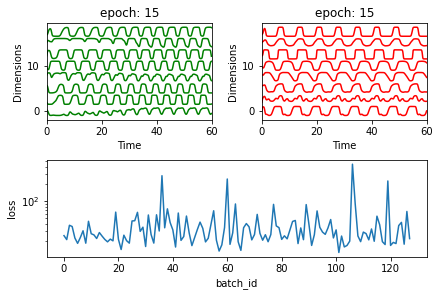

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.79319111 -0.15043866 -0.74831524 -0.73157795 -0.6219553  -1.18253303
  -0.66897515 -1.89874518]
 [-0.19353513  0.2103747   0.32039942  1.09314896  0.64786421  0.89619773
   0.65592689  0.57384504]
 [ 0.60103079 -0.13993238 -0.68077673 -0.72210282 -0.25974406 -0.77982083
  -0.48664966 -1.38966115]
 [-0.31598473 -0.43146866 -0.14233626  0.34403937  0.64188471 -0.08536016
   0.37409174 -0.54492895]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[ 0.67140469 -0.08334295  0.73215985 -1.00954657 -0.66307719 -1.36377717
   0.39452363 -0.13261384]
 [ 0.39460835 -0.03402887 -0.21645145 -0.28829809  0.13122422 -0.29579134
   0.04528278 -0.80990402]
 [ 1.09535865  0.43604675  0.99747481  0.27486462 -0.69306303  0.70480116
   1.00103332  0.73747859]
 [ 1.31859833  0.69434164  0.65838747 -0.92074222 -1.29290243 -1.1233853
  -0.04881006 -0.02421032]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[-0.65435401  0.06968294 -0.86813415  0.73967568  0.93385093  0.21634992
  -0.44671395 -0.67991164]
 [ 1.31590854 -0.04583166  0.02506713 -1.29852878 -1.10596616 -2.59656594
  -0.42825278 -1.30773023]
 [ 0.93259687  0.43053897  0.70922868 -0.08886577 -0.85798564  0.86713631
   0.6135303   0.40259223]
 [-0.06954181  0.56571501  0.22817388  0.91392789  0.06129059  0.55537577
   0.40582186  0.27463135]]


 38%|███▊      | 3/8 [00:02<00:04,  1.11it/s]

[[ 1.96990879  0.59255328  1.43515011 -0.61695875 -1.76402619  0.48743295
   1.20952101  1.31040707]
 [-0.01853738 -0.23087829 -0.7684924   0.22534589  0.3970834  -0.70319109
  -0.45135943 -1.21829897]
 [-1.24752155 -0.17006328 -0.78154321  0.99950192  1.43529207  0.05566306
  -0.43826852 -0.19700513]
 [ 1.55975899  0.96446849  2.0009951   0.1747126  -1.53883042  0.87563972
   1.66888009  1.56977644]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-1.07580067 -0.32209554 -0.45610485  0.53887927  0.96632418 -0.26079181
  -0.2852908  -0.8408328 ]
 [-0.18038034 -0.09945822 -0.25738681  0.19608573  0.36551322 -0.96936408
  -0.29106891 -0.4300438 ]
 [-0.94912462 -0.84278979 -1.90568148 -0.02240362  1.15732468 -2.61138264
  -1.70259435 -2.62829049]
 [ 0.35884983  0.48760002  0.74843118  0.43380005 -0.28217009  0.89976061
   0.7969435   0.50392957]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[-0.13144888 -0.01316711 -0.18199448  0.28724292  0.1606303   0.62204212
   0.15418996 -0.3153054 ]
 [-0.13131867 -0.11284385 -0.31465359  0.28662938  0.31739685 -0.56458098
  -0.17513437 -0.86482875]
 [-1.26195984  0.00813928 -0.85440203  1.4547317   1.116247    0.82525315
  -0.1663312  -0.83915095]
 [ 0.54540512  0.21322378  0.5551138  -0.23821117 -0.2682281   0.06298923
   0.50148992 -0.14163703]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[ 0.05894862 -0.14615004 -0.17717445  0.76843459  0.57104865  0.12139899
   0.19454462  0.38859621]
 [-1.80074569 -0.80735038 -1.86357741  0.45275652  1.72307563 -1.80323379
  -1.28476816 -3.25347251]
 [-0.4007333   0.38591354 -0.57200111  0.97254433  0.94544622  0.68821394
  -0.2934163  -0.35852915]
 [-0.46246597  0.4485175  -0.42160425  0.70708527  0.49250306  0.19332001
  -0.29982244 -0.74901646]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[ 0.18168921  0.12769388 -0.25760153  0.08056175 -0.1288237  -1.22458379
  -0.49576538 -0.6083141 ]
 [-0.99489864 -0.06156004 -0.31967204  1.37305157  1.23017508  0.29701819
   0.29846554 -0.42707551]
 [-0.59205414  0.02372742  0.5680577   0.83622451  0.50292988  0.85944918
   0.74016227  0.57830103]
 [-0.07991438 -0.06909342 -0.3900998   0.10733579  0.21843456  0.34803036
  -0.03862355 -0.5845723 ]]


100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


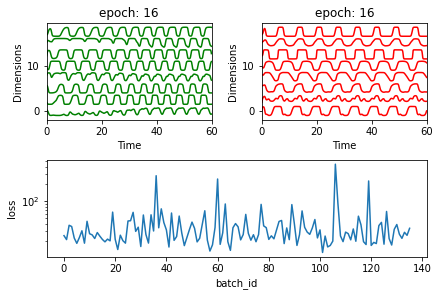

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.84965832  0.25417645  0.45833606 -0.19692125 -0.74298214 -0.51573174
   0.28011273  0.40543197]
 [-0.11755632  0.18199231  0.34121378  0.08012826  0.15851994  1.02315036
   0.68925926 -0.11242831]
 [-0.42275437  0.35386578  0.06588948  0.83056057  0.24608344 -0.07152116
  -0.10545139  0.19780786]
 [-0.76939302 -0.46317763  0.11183914  0.21829922  0.57198489 -1.18702909
   0.1793324  -0.82551894]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.02s/it]

[[-0.00857728 -0.29211912 -0.83299867  0.3187099   0.38511857 -0.0456231
  -0.29281635 -1.41822187]
 [ 0.3296216  -0.23670238  0.13889536 -0.18051664 -0.3959443   0.01038775
   0.42310217 -0.19783058]
 [ 0.45011102  0.24072133 -0.38479599  0.00674809 -0.16507663 -0.7735651
  -0.4006773  -0.98744517]
 [ 0.11434772  0.4200568   0.00176386  0.50491481 -0.20698176  0.07514774
  -0.0603049  -0.67554329]]


 25%|██▌       | 2/8 [00:01<00:05,  1.02it/s]

[[-1.04167135 -0.22398822 -0.47703705  1.55355159  1.38573417  1.54486038
   0.42984622  0.0342908 ]
 [-0.01215469  0.11516618  0.36879696  0.1997687   0.10240799 -0.12117094
   0.40648401 -0.16096911]
 [-0.14075321 -0.06381448 -0.44412206  0.01654159  0.38877254 -0.35221975
  -0.42086561 -1.21213179]
 [ 1.10472239  0.26427195  0.56214798 -0.55105109 -0.59074256 -0.24648922
   0.36968467  0.20011955]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[ 0.59764094  0.54191031  0.40828298  0.45181791 -0.156745    0.72061811
   0.50574519  0.40193764]
 [-0.21872738 -0.21183468 -0.4908412  -0.43937138  0.58857849 -1.54172561
  -0.5617376  -1.60641387]
 [-0.06299217 -0.42483699 -0.73930122  0.07436718  0.59775891 -0.62991759
  -0.21349065 -1.15498189]
 [-1.11346691 -0.19444052 -0.92928209  1.15083306  1.46132388  0.24966588
  -0.33812038 -1.55808522]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[ 0.38790741  0.42297377  0.46649533  0.43263917 -0.22258075 -0.69327343
   0.09168785 -0.07137643]
 [-0.10823588 -0.23741866 -0.82395984  0.2071793   0.63974049 -0.26214261
  -0.35306616 -1.20171502]
 [-0.36090857  0.86874869  0.6943729   1.82261378  0.3385345   2.77707863
   1.03200259  0.98381115]
 [ 2.07396854  0.46954281  1.69344367 -0.55595489 -1.54008997  0.32167526
   1.60074248  1.45610336]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[-0.82369235 -0.1563975  -0.73667388  0.96004462  1.25610408 -0.13917021
  -0.39057496 -0.54270467]
 [ 0.14467397 -0.17197921 -0.65427122 -0.60804776  0.05603793 -1.11742092
  -0.65082845 -1.81391205]
 [-0.36064575 -0.01910345 -0.96899161  0.42604264  0.69518077  0.06603964
  -0.51638141 -1.2050563 ]
 [ 0.16077105  0.39249877  0.15434314  0.81448626  0.24995078  0.77014744
   0.2898354   0.55190034]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[-0.78063815  0.38561155 -0.07905878  1.12326456  1.00366484  1.27872398
   0.32260464  0.35109346]
 [-0.56710186 -0.1121803  -1.41327755  0.81596     1.21089923 -0.19461306
  -0.78402829 -1.41725857]
 [-0.08815329 -0.12971397 -1.25599005  0.30649754  0.63579043  0.29217414
  -0.74124763 -0.98563749]
 [ 1.25045666  0.68761105  0.9641688   0.18723963 -1.10272088  0.06720528
   0.63354183  0.6067479 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[-0.71164117 -0.22392315 -0.12059902  1.13895541  0.98874416  0.83698883
   0.38848806  0.40323818]
 [ 0.24605792  0.30992329  0.08507152  0.33749638  0.01248544  1.45300507
   0.53016242 -0.53184961]
 [ 0.78337166  0.24397456  0.71719921  0.01749915 -0.72914226  0.43242404
   0.92203696  0.15963405]
 [-0.76977147 -0.18785318 -1.4620066   0.72558693  1.21854623 -0.37818261
  -0.8657024  -2.10922453]]


100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


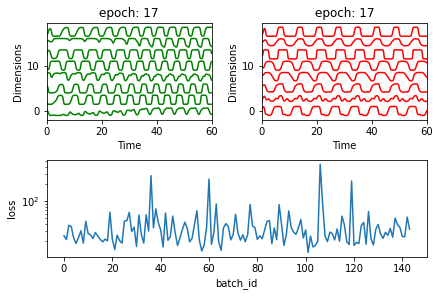

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.7054183   0.27334365  0.20114123  0.18228107  0.06490737 -0.45404804
  -0.02155461  0.05037345]
 [-1.33850992  0.24600001 -0.31473395  1.54089523  1.27392172 -0.0414165
  -0.37468978 -0.16501242]
 [ 0.44516887  0.35667078  0.14381544  0.73049674 -0.05331066  1.46674585
   0.62954241  0.10593971]
 [ 1.66026464  0.34736838  0.5024451  -0.91432645 -1.35767044 -1.59352755
  -0.07902804 -0.34661143]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.05it/s]

[[-0.93457308 -0.21828628 -0.51116014  1.2403306   1.13688116  1.2788832
   0.15200978 -0.26782127]
 [ 2.37898891  0.61560012  1.76761624 -1.25566577 -2.11282329  0.25763786
   1.31071211  1.32533874]
 [-1.11536995  0.29327819 -0.16509395  2.20106308  1.40293891  2.30197919
   0.80202447 -0.025928  ]
 [-0.09036608 -0.09862689 -0.26240135  0.16798988  0.13929359 -0.70820465
  -0.30189321 -0.87756861]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[-0.27674571 -0.19895878 -0.44620321  0.18353416  0.44041025 -0.18838024
  -0.22513308 -1.19990519]
 [-0.08941088  0.00815033  0.44215384  0.08222101  0.1423918   0.24698845
   0.49385714 -0.02743485]
 [-0.33525165 -0.07701176  0.34141077  1.14364808  0.85777977  1.16958709
   1.097305    0.26006039]
 [-1.37796592 -0.07493918 -0.26254864  1.81504558  1.49671724  1.58375598
   0.35922079  0.21775466]]


 38%|███▊      | 3/8 [00:02<00:04,  1.09it/s]

[[ 0.2035256   0.44697987  0.7119177   0.79113831 -0.2683806   0.41408616
   0.59091347  0.36064569]
 [-0.31183726  0.19931999  0.83942489  0.97424081  0.41167375  1.39686675
   1.12564769  0.73611287]
 [-1.30478164 -0.59767352 -1.32319891  0.7499237   1.52355073  0.0987543
  -0.69216126 -1.50593999]
 [-0.36624042 -0.24128753 -1.3041602   0.15840905  0.79571114 -1.1613375
  -1.179551   -1.24950358]]


 50%|█████     | 4/8 [00:03<00:03,  1.05it/s]

[[-1.24419903  0.03038735  0.0500061   0.87949807  0.8346741   0.18552979
   0.1999622  -0.40335793]
 [-1.35068903 -0.73018874 -1.03410595  0.81608036  1.58549674 -0.22022476
  -0.39392962 -1.01448288]
 [ 1.85466332  0.39202387  1.32724613 -1.02115707 -1.68544131 -0.22951935
   0.91475594  0.88320458]
 [-0.46865651  0.35553495  0.44721991  1.21952668  0.65634286  0.32346427
   0.43606648  0.76276505]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[-0.04216996 -0.31522568 -0.46301676 -0.06832922  0.23929722  0.30601316
   0.27172665 -1.31048502]
 [-0.93427654 -0.37292305 -1.19756214  0.56409869  1.22197134 -0.55657986
  -0.51906217 -1.94780577]
 [ 0.27310094 -0.05950504 -0.22974964 -0.53433864 -0.12143193 -0.65518808
  -0.11398221 -1.58904904]
 [-0.017227   -0.00582326 -0.10449415  0.60812048  0.02255344  0.34929321
   0.24576022 -0.12253652]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.07it/s]

[[-2.48286786e-01  3.12892049e-01  2.23035278e-01  6.07743986e-01
   2.86551725e-03  5.94129057e-01  3.09105703e-01 -2.04271631e-01]
 [-3.23749766e-01  5.85047527e-01  1.18853071e+00  1.07599974e+00
   2.52455761e-01  4.71496576e-01  9.74902453e-01  9.51675601e-01]
 [-7.11142034e-01 -5.73399648e-01 -1.30285879e+00  2.54260878e-01
   1.24312673e+00 -2.17190620e+00 -1.09158244e+00 -1.73818729e+00]
 [ 1.46047419e+00  9.80857906e-01  8.75585950e-01 -1.31573609e-03
  -1.11461792e+00  1.52015682e+00  9.57995026e-01  6.92740410e-01]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-1.9908883   0.00425558 -0.95607984  2.19769189  1.98670911  0.288676
  -0.53535759 -1.00572903]
 [ 1.42181385  0.32578544  1.07460626 -1.28602911 -1.54324583 -0.75265043
   0.55976808 -0.21535775]
 [ 0.28372956  0.45963318  0.45841947  0.73256886 -0.07079492  1.14893306
   0.68623701  0.56940531]
 [ 0.40958423  0.46249597  0.67355043  0.2667942  -0.39719059  0.86030094
   0.66580767  0.35285128]]


100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


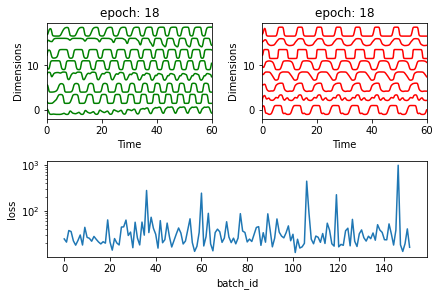

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.24956999 -0.24059385 -0.25508897 -0.35536868 -0.22205285 -0.33248066
  -0.04493074 -0.9119288 ]
 [-0.39703711 -0.15581742 -0.98405489 -0.37941331  0.31845596 -1.31194369
  -0.78669853 -1.63568927]
 [ 0.04463836  0.36240247 -0.53776578  0.5963339   0.1741829  -0.15869502
  -0.45960238 -0.72118608]
 [-0.68104213  0.18752283 -0.47596756  0.75963402  0.65381185  0.68076171
  -0.00724682 -0.81088582]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.04s/it]

[[ 0.10078887  0.73215538  0.75055579  0.89990448 -0.32102108  0.64539114
   0.68290256  0.2218884 ]
 [-1.05535006 -0.0225275   0.179692    1.32089756  1.15882274 -0.14209189
   0.34055789  0.43145206]
 [ 0.39422314  0.23809588  0.34316776 -0.07794913 -0.13204654  0.18919129
   0.33136931  0.08713255]
 [ 0.81116926  0.72024914  0.8053073   0.63950175 -0.43390614  1.88947129
   1.0584628   0.57252914]]


 25%|██▌       | 2/8 [00:01<00:06,  1.01s/it]

[[ 0.14115012  0.28216928  0.59547973  0.402329    0.00362395  0.01472185
   0.61235668  0.22030301]
 [ 0.12586963  0.1503622   0.05953676  0.53300467  0.13582762  0.25085032
   0.28663574  0.15300036]
 [ 0.0173214   0.61201652  0.72218538  0.6866255  -0.07334453  0.67400745
   0.77403242  0.19654094]
 [ 0.63744584  0.23528178  0.77772537  0.23806716 -0.18794652  0.59921749
   0.87256239  0.95597349]]


 38%|███▊      | 3/8 [00:02<00:04,  1.03it/s]

[[ 0.41965869  0.14793184  0.35887422 -0.05979378 -0.33211157  0.26997484
   0.40989856 -0.39825264]
 [-0.02378179  0.25693692  0.11153061  0.16091551  0.14351528 -0.02407483
   0.13525479  0.03390381]
 [-0.47569025 -0.11195224 -0.22190745  0.63060854  0.81852693  0.8472898
   0.19053247 -0.62174921]
 [-1.69961774 -0.58071534 -1.54919536  1.15724701  1.91392815  0.07068849
  -0.64095148 -1.46229522]]


 50%|█████     | 4/8 [00:03<00:03,  1.06it/s]

[[ 0.43992287  0.46978256  0.99891153  0.85196049 -0.03292888  1.04896202
   1.15773998  1.28333419]
 [-0.41701904 -0.33485643 -0.30712285 -0.05576792  0.76771243 -1.21536552
  -0.15556302 -0.91269105]
 [-0.63624588 -0.43288608 -0.30517334  0.36001542  0.97788473 -0.01663175
   0.04061942 -0.42524216]
 [ 0.21175525  0.30941856  0.31493297  0.3569345  -0.00501958  0.31946323
   0.21277612 -0.00451801]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[ 1.12260609e+00  3.04033469e-01  8.46873337e-01 -5.86587521e-01
  -9.79699048e-01 -1.74323610e+00  2.54373322e-01 -9.15964781e-02]
 [ 4.88318825e-01  8.91387311e-01  7.25287049e-01  4.67847743e-01
  -3.94676838e-01 -1.24556880e-03  2.54313808e-01  1.95806829e-01]
 [ 1.59417125e+00  4.42254413e-01  5.97674240e-01 -1.26760385e+00
  -1.51157975e+00 -1.51921853e+00  1.58846264e-03 -4.35380583e-01]
 [-4.41067312e-01 -2.05297771e-01 -2.12146501e-01  3.53698330e-01
   5.67572580e-01 -4.09858080e-01 -5.48501901e-02 -7.82331845e-01]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[ 1.92519683  0.75368438  1.37966811 -0.792973   -1.66179888  0.67519719
   1.17845155  0.7650384 ]
 [ 0.9167802   0.15152569 -0.39608415 -0.67419547 -0.62924293 -1.51213592
  -0.6289479  -1.32477465]
 [ 0.4423395  -0.08969049  0.46994483 -0.13087483 -0.02063889  0.12127287
   0.45781489  0.37206769]
 [ 0.23908385  0.64642649  0.76865217  0.7432531   0.16277866  1.50209359
   0.92678312  0.34945545]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[ 0.74545733  0.53266432  0.88942913  0.47222135 -0.58514388  0.23982393
   0.72770034  0.45496419]
 [ 1.0340227   0.43912975  0.93070092 -0.1070152  -1.10148649  0.63137135
   0.86201183  0.05656162]
 [-0.93656875  0.11224907 -1.1213047   0.65437198  0.85159684 -0.52409237
  -1.01750908 -1.69169577]
 [-0.54940654 -0.62334622 -1.58487477 -0.03682926  1.29879877 -1.08936499
  -1.20717462 -1.80152364]]


100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


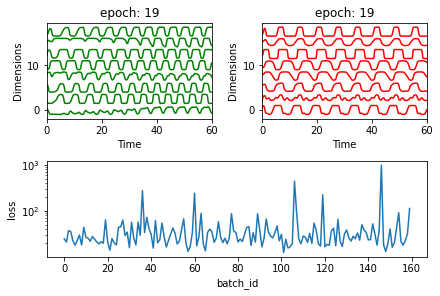

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.36472033  0.25828213  0.99746509  0.76192462 -0.02897601  0.84000971
   1.21183553  1.19950267]
 [-1.04847362 -0.52234329 -1.10852609  1.18428407  1.74833861  0.00648262
  -0.26345945 -0.96877728]
 [-0.47245809  0.51555373  0.21200012  1.03136157  0.19557235  0.78859228
   0.44203694 -0.10509492]
 [ 0.96993779 -0.03264307  0.15603241 -0.91360898 -0.58875982 -0.88396408
   0.02995252 -0.65594085]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.10it/s]

[[-1.63041589 -0.89271751 -2.08456664  0.6569805   2.20518895 -0.74160865
  -1.27639079 -2.21323414]
 [ 0.98682025  0.505217    0.96507241 -0.23309716 -0.62653081  0.2145458
   0.74528991  0.69652678]
 [ 0.35585034  0.54700351  0.98986533  0.54593846 -0.51889431  0.64103735
   1.00231122  1.10099536]
 [ 0.20696418  0.42482555  0.26656962  0.39323306 -0.0238348   1.0746787
   0.40531649  0.13770534]]


 25%|██▌       | 2/8 [00:01<00:05,  1.11it/s]

[[-0.53378838 -0.26180317 -0.57589002  0.38040499  0.76358509 -0.58617162
  -0.20727503 -1.05285526]
 [-0.37969258 -0.08892053 -0.85765655  0.45242416  0.58905382 -0.6464389
  -0.63351188 -1.11707607]
 [-0.38195174  0.06957474  0.05822865  0.45101715  0.32138259 -0.43768534
   0.01433212 -0.57548465]
 [ 0.52997848 -0.33672377  0.02110451  0.08328735 -0.08045121 -0.10283995
   0.40997096 -0.07705713]]


 38%|███▊      | 3/8 [00:02<00:04,  1.08it/s]

[[ 0.91928826  0.37072861  0.65231137 -0.08989658 -0.35755583 -0.57833339
   0.32791757  0.56511226]
 [ 1.07546896  0.24107818 -0.00662244 -0.62805772 -0.69836244 -1.31893033
  -0.30634705 -0.88647239]
 [-0.92829688 -0.86169522 -1.38103973  0.30457443  1.36555368 -1.72921958
  -0.94513355 -1.46878549]
 [-1.50307888 -0.21090943 -0.70163517  1.32520769  1.46577358  1.17988652
  -0.01661316 -0.81306413]]


 50%|█████     | 4/8 [00:03<00:03,  1.10it/s]

[[-0.30339318 -0.20080845 -0.50907258  0.5281573   0.69250164  0.50003479
   0.09761924 -1.08577779]
 [-0.34207377  0.13962714 -0.60978883  0.26953361  0.49547147 -0.17104673
  -0.44764545 -0.92704923]
 [ 0.58176566  0.83014929  0.57730484  0.5597459  -0.59019539  1.58165568
   0.73832432  0.06797662]
 [ 0.46788676  0.04699031 -0.04135031 -0.11659119 -0.25965048 -0.34779901
   0.00218874 -0.49447319]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.11it/s]

[[-0.14376942  0.37900594 -0.16873698  0.64309406  0.15978576  0.37843197
  -0.13162544 -0.78433817]
 [-0.36260089  0.06774679 -0.48439231  0.383614    0.59748486  0.39383766
  -0.12390636 -1.15852236]
 [ 0.07680646  0.05774139 -0.48722731  0.57652377  0.20298654  0.20136851
  -0.19163931 -0.94253671]
 [-0.42303061  0.18648059 -0.05507686  1.12156067  0.92649997  0.73337852
   0.38379857  0.21627122]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.12it/s]

[[-0.45829744 -0.76735171 -0.77063455 -0.22426014  0.78838383 -1.32704282
  -0.40117525 -1.73565929]
 [ 0.11067151  0.03732369  0.26288274  0.48841924  0.33609004  0.45915668
   0.61565266 -0.05568268]
 [-0.09076137 -0.10597319 -0.00802754  0.02045541  0.19997346 -1.25261542
  -0.13773664 -0.57037644]
 [ 0.62519042 -0.19325327 -0.55183374 -1.13749571 -0.22349978 -2.39764017
  -0.83360928 -1.2000715 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.10it/s]

[[-0.56912462  0.47570017  0.53732863  1.09706093  0.5152782   1.16007827
   0.72956449  0.14668278]
 [ 0.75767222  0.31034073  0.39566407 -0.26438562 -0.63480239 -0.12546043
   0.32749288 -0.48245356]
 [ 1.57768558  0.92143446  1.70379604 -0.25698605 -1.64193313  0.46402971
   1.24436925  0.95448591]
 [ 1.04836462  0.34581763  0.41162378 -0.50435091 -0.87509735 -0.43316606
   0.2456866  -0.35307871]]


100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


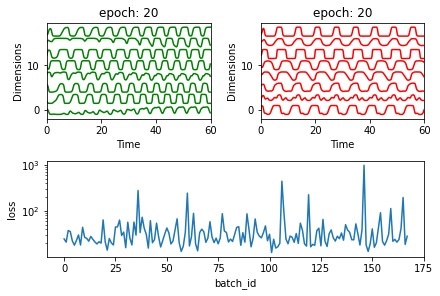

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.24130535  0.29400433  0.10201714  1.6912495   1.02518627  1.65156618
   0.73346866 -0.16070874]
 [ 0.62085394 -0.19354005 -0.77071501 -1.28995939 -0.19488412 -2.45629407
  -0.94990447 -1.55067434]
 [-0.92468255  0.06510446 -0.30644128  1.41035347  1.01182701  0.2710909
  -0.05266626  0.1137626 ]
 [-0.40026938  0.22011589  0.50761279  0.59006368  0.24163279 -0.04817894
   0.48238905  0.22027522]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[-1.17524333 -0.04562059 -0.15807145  1.39114951  1.16763665  0.72827197
   0.3493232  -0.43248835]
 [ 0.71471961  0.56332489  0.46623569  0.31535343 -0.24655461  0.36019469
   0.21718388 -0.03667104]
 [-1.47576289 -0.32578252 -1.26363554  1.10200055  1.74904758  0.0554495
  -0.60083166 -1.77141611]
 [-0.52247512  0.21563952  0.13828711  1.4436955   0.67444128  1.59664022
   0.73915397  0.30461002]]


 25%|██▌       | 2/8 [00:01<00:05,  1.10it/s]

[[-1.42825768e-01  1.86756364e-01  4.22040361e-01  6.38203725e-02
  -4.16619756e-04 -1.48570712e+00 -7.62549233e-02 -2.86306056e-01]
 [-4.60660022e-01  1.41595490e-01  3.88695958e-01  6.49420193e-01
   3.92366570e-01 -1.74290087e-01  3.46863258e-01 -2.67650496e-02]
 [-1.58862834e+00 -2.66162806e-01 -7.74137671e-01  1.27896845e+00
   1.71689023e+00  1.14345015e-01 -3.09456184e-01 -9.11584222e-01]
 [ 9.91150226e-01  2.19939191e-01  1.08489846e-01 -7.02184702e-02
  -4.81497669e-01 -4.58941619e-01  1.51739567e-01 -5.32594837e-01]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:02<00:04,  1.11it/s]

[[ 0.6603829   0.48107956  0.4535151   0.09110405 -0.68565558  0.63848404
   0.24956994  0.01473687]
 [-0.20243765  0.3913709  -0.37093849  0.56606081  0.18880456 -0.4870489
  -0.51510747 -0.57726427]
 [ 0.9848506   0.6450053   1.07511742  0.1402477  -0.53662412  1.01145226
   1.06327991  0.79142166]
 [-0.4064131   0.2232646   0.05235183  0.75738902  0.36748329 -0.09176029
   0.08446059 -0.58471883]]


 50%|█████     | 4/8 [00:03<00:03,  1.12it/s]

[[ 0.44178896  0.03860411  0.45763965  0.15756328 -0.05609361  0.12729535
   0.45192874  0.16544154]
 [ 0.68783096 -0.29924858  0.65818773 -1.33138812 -0.7413775  -1.75472157
   0.27718231 -0.64257778]
 [ 0.85703     0.53505154  0.9456953  -0.07987387 -0.99064393 -0.34646485
   0.43558827  0.72338745]
 [ 1.13030376  0.40974637  0.19821752 -0.15557591 -0.59143423 -0.32017875
   0.20005196 -0.38505503]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.12it/s]

[[ 1.74151189  0.84279355  1.91396041 -0.50344177 -1.90511987 -0.13200019
   1.2277365   0.99625885]
 [-0.82227251 -0.53001852 -1.49840457  0.48543842  1.14193927 -0.98925846
  -0.99199189 -2.01502902]
 [-1.29385134 -0.60427889 -1.27962972  0.49736275  1.3046071  -0.91449825
  -0.80764672 -1.47846789]
 [-1.32157871 -0.58946569 -1.13653321  0.8722324   1.64333561 -1.19866467
  -0.76776535 -1.01948376]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[ 1.00858123  0.6216843   0.49575043 -0.21407313 -0.84041397  0.38970114
   0.26216039  0.17028758]
 [ 0.25158245 -0.00238876 -0.31302073 -0.05772742  0.18578831 -1.2477643
  -0.35096685 -0.74094582]
 [ 0.54829842  0.21305426  0.38123847  0.20238046 -0.20651996  0.38222839
   0.41618827  0.05852776]
 [-1.35843944  0.18479702  0.16450401  1.76080115  1.68185589  1.09873945
   0.43961345  0.55171956]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-1.31483922 -0.62944232 -1.79335255  0.65133224  1.49800502 -0.58289493
  -1.02613852 -2.01331407]
 [-0.33840364  0.11822777  0.21212615  0.97479963  0.38830619  0.23931626
   0.34648101 -0.00815851]
 [ 1.46805001 -0.12043386  0.30119876 -1.01773293 -0.82999421 -1.31745638
   0.09433743 -0.18916737]
 [ 0.21102898 -0.20190264 -0.61361274 -0.2228456   0.26062237 -1.53513372
  -0.47216916 -1.34503035]]


100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


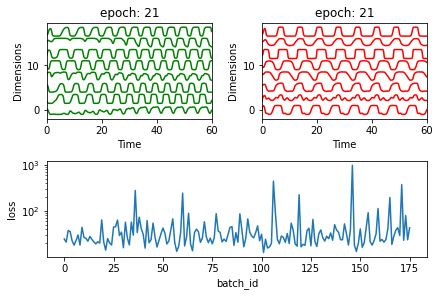

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.92086203  0.11486613 -0.30962299 -0.61383821 -0.50650789 -2.01960114
  -0.69297021 -1.51155941]
 [-0.03626531  0.20719647  0.1775276   0.84975135  0.58143231  0.88038543
   0.57751389 -0.07492656]
 [ 0.71712567 -0.15138331 -0.39988178 -0.5198915  -0.46772115 -1.10303179
  -0.27422487 -0.79197582]
 [-0.8140619   0.27148224 -0.47817027  1.20372363  1.02946879  0.90335173
  -0.02603116 -0.14954886]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.10it/s]

[[ 0.54435479  0.20547089  0.08641641 -0.15433273 -0.2095948  -0.18365612
  -0.04445103 -0.20384478]
 [-1.2338238  -0.50967898 -1.7363363   0.82596224  1.53609968 -0.74753238
  -1.20665575 -1.73171538]
 [-0.37124644 -0.35503111 -0.12563913  0.05716785  0.3181349  -0.70450156
   0.09382203 -0.55977942]
 [ 0.45990331  0.66196543  0.35569134  0.18813747 -0.28677637  0.5747002
   0.23317808  0.0057247 ]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[-0.8258669  -0.34844925 -0.67544733  0.67222728  0.78885388 -1.39213916
  -0.48773895 -1.37771035]
 [-0.25263975 -0.04241998 -0.25490885 -0.0364077   0.23484831 -0.40933107
  -0.16438501 -0.63903462]
 [-1.36324368 -0.21798373 -0.5303825   0.86399901  1.19449104  0.27039625
  -0.08456684 -0.69814859]
 [-0.50600364  0.25539759 -0.38141359  1.16889258  0.82764401  0.32622298
  -0.01121574  0.26013272]]


 38%|███▊      | 3/8 [00:02<00:04,  1.08it/s]

[[-1.77229624e-04  5.78025839e-02  3.35452635e-01  1.64094413e-01
   2.50428875e-02  1.35913653e-01  4.87229782e-01  4.78152559e-02]
 [ 1.24425234e+00  8.72456036e-02  2.33604954e-01 -5.98281912e-01
  -1.19520946e+00 -1.38309240e-01  4.66571914e-01 -7.68100428e-01]
 [ 5.22981922e-01  4.48732842e-01  5.90552903e-01  4.50266804e-02
  -6.13434006e-01 -1.18614164e+00  2.28197688e-01 -3.78465374e-01]
 [ 6.03904150e-01  1.54699612e-01 -7.82325975e-02 -9.10318936e-02
  -6.19450758e-02  6.64157843e-03 -4.10836241e-02 -8.37764355e-01]]


 50%|█████     | 4/8 [00:03<00:03,  1.09it/s]

[[-0.32469967  0.00935792 -0.4665828   0.49726685  0.43059065  0.98570288
  -0.07878378 -0.78098545]
 [ 0.62277508  0.39503997  0.26670256  0.2058429  -0.30337118  0.58897788
   0.40986427 -0.40339914]
 [-0.52217396 -0.46309359 -0.98309253  0.70286606  1.0426866   0.08653809
  -0.27425521 -1.33189961]
 [-0.21150507 -0.13751609 -0.35597478  0.4237166   0.68572619  0.15341958
   0.17853277 -0.79042869]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.10it/s]

[[ 1.22942385  1.19254728  1.76575782  0.29411041 -1.26537629  1.1625625
   1.35314644  1.30781938]
 [ 0.71395804  0.1461143   0.39263201 -0.53277379 -0.65931237 -1.38028848
   0.02520419 -0.37681372]
 [-0.96159879 -0.31304565 -0.35471721  0.19307815  1.07261711 -1.123986
  -0.4147602  -0.82214001]
 [ 0.09812232 -0.05962452  0.04580605  0.30270987  0.12251358  0.62867903
   0.41887132  0.12148466]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.11it/s]

[[-0.12650431  0.39015931  1.15181168  0.68262382 -0.13827217  1.58760865
   1.3301392   1.14549077]
 [ 0.96975516  0.72805773  0.780036    0.11146767 -0.61084698 -0.51410763
   0.36275972  0.34924872]
 [ 0.55587919  0.19681525  0.02404213 -0.23860791 -0.18647598 -0.6361957
  -0.08860034 -0.30664433]
 [-0.23983747  0.10416046 -0.22446704  0.71460826  0.56712907 -0.03071545
   0.14219187  0.40700179]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.11it/s]

[[ 0.46252128  0.31173854  0.86605326  0.21289651 -0.27117985 -0.30628179
   0.64177711  0.57999052]
 [ 1.9823788   0.58532585  1.93000945 -0.62010662 -1.82212893 -0.0848715
   1.55208328  1.10957516]
 [-0.96901242 -0.98389164 -1.75013545 -0.41557272  1.41789455 -2.6697743
  -1.37508244 -2.66804884]
 [-0.0871112   0.420663    0.19940624  0.46939722  0.01808398  0.39731557
   0.17398275 -0.08862294]]


100%|██████████| 8/8 [00:02<00:00,  3.41it/s]


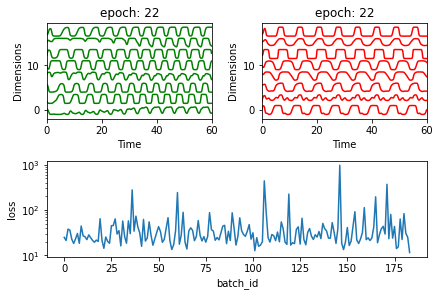

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.37820376e+00  1.20203199e-01  1.96463269e-01  1.90376742e+00
   1.24093160e+00  2.16689603e+00  7.96823378e-01  2.85580619e-01]
 [-8.69557508e-01 -5.34631941e-01 -1.20139370e+00  3.85968294e-01
   1.35753394e+00 -1.23923903e+00 -7.99609777e-01 -1.13062336e+00]
 [-5.93992293e-02  1.08163078e-03 -2.01923514e-01  7.37793390e-01
   7.65687156e-01  4.43301619e-01  5.88384798e-02 -2.75731629e-02]
 [-1.57766309e+00  1.59690566e-01 -8.29740777e-01  2.05639185e+00
   1.50999914e+00  9.52337546e-01 -1.80911103e-01 -4.25676381e-01]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.06it/s]

[[ 0.95689481  0.56358074  0.2445914   0.3531377  -0.43947831  1.14975717
   0.38148954  0.25519273]
 [ 0.13833179  0.21190736  0.55738248  0.32059909 -0.03637784  0.83611829
   0.63058268  0.691752  ]
 [-0.6208632   0.28458787  0.33755161  0.90247781  0.32977757  1.54275661
   0.68387862 -0.38851835]
 [ 1.8296631   0.51931497  0.41484941 -1.01815118 -1.58619325 -1.22230354
  -0.00829012 -0.37101351]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[ 0.4367714   0.05294854  0.42599357 -0.03517464 -0.09139026 -0.14388137
   0.42969023 -0.06456562]
 [ 0.62110569  0.64055792  0.82965168  0.06608335 -0.33776227  0.50657416
   0.6308366   0.18845794]
 [-0.95545396 -0.15900578 -1.42270853  0.67459371  1.41907927 -0.29336555
  -1.06118095 -2.01063594]
 [-0.62202692 -0.70084023 -1.25730508 -0.71925703  0.88509989 -2.16102472
  -1.26418576 -2.09310981]]


 38%|███▊      | 3/8 [00:02<00:04,  1.08it/s]

[[ 1.30130094  0.9363687   1.53514675  0.14745478 -0.77839924  0.54712664
   1.16114877  1.37156436]
 [-0.26874604  0.56734606  0.41009048  0.63154875 -0.04017011  0.98655077
   0.44204256 -0.35040581]
 [ 1.2803359   0.69009021  0.82256725 -0.06826865 -0.91664767  0.20784053
   0.60940872  0.40525159]
 [-0.81621639  0.18366585 -0.3819231   1.23087869  1.08081829  0.7618406
  -0.01432418 -0.24192321]]


 50%|█████     | 4/8 [00:03<00:03,  1.05it/s]

[[ 1.05025772  1.07564266  1.50997405  0.59256835 -0.92861095  1.53331816
   1.24042785  1.50533161]
 [ 0.6965776   0.91035234  0.85326736  0.71810624 -0.66335177  1.08297171
   0.76398247  0.81423461]
 [-0.20331755 -0.1422911  -0.61445476  0.64716779  0.58975063 -0.20839108
  -0.20309678 -0.57536573]
 [ 0.67549584  0.73613518  1.01811593  0.59814615 -0.78276234  0.84925739
   0.83807172  0.92728882]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[ 0.12945715  0.52951517  0.62638366  0.52628636 -0.04824719  0.2975024
   0.52937009  0.79405377]
 [-0.51186264 -0.11963747 -0.92813977  0.40680692  0.65673836 -1.37742137
  -0.87128238 -1.08079755]
 [ 0.12569316  0.25615207  0.86456255  0.79164111 -0.04078218  1.16830891
   1.18822305  0.63632991]
 [-0.87513044 -0.05283273 -0.83703218  0.98466782  1.0319952  -0.15206682
  -0.40496808 -1.00260605]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[ 0.08313632  0.37273034  0.85345936  1.32208708 -0.12249784  1.9388182
   1.32777854  0.76206427]
 [ 0.14550319  0.22068927 -0.0471653   0.12024268  0.06124306 -0.05193287
  -0.01012402 -0.8908483 ]
 [ 0.38295315  0.6527921   0.55548714  0.31023038 -0.36875734  0.20778474
   0.37243038  0.25485074]
 [ 0.28500801 -0.11279176 -0.14850696 -0.48920963 -0.24487876 -1.68638409
  -0.30323155 -1.15490826]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[ 1.05822667  0.80631921  1.13305952  0.16610675 -0.98629642  0.31702574
   0.84182345  0.97537263]
 [-1.06192578 -0.05128045 -1.04700873  1.02947713  1.29095674  0.51374984
  -0.43438263 -1.05022883]
 [ 1.2546372   0.57978134  0.81342671 -0.31120653 -1.18533561 -1.14694171
   0.05941288  0.23151311]
 [ 1.01359083  0.55928637  1.83352096 -0.06908403 -1.05941444  0.34460639
   1.52251979  1.2297772 ]]


100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


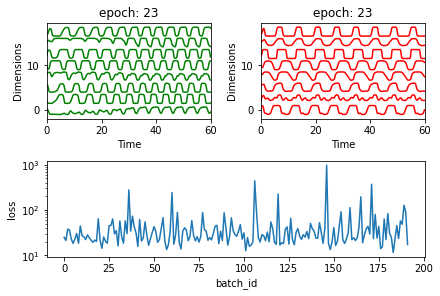

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.05988359 -0.23074539 -0.50777385  1.11415308  1.24907899  0.2330758
   0.02697635 -0.88055969]
 [-0.45996072 -0.2681282  -1.19127031  0.47927241  1.03843883  0.16305757
  -0.49609604 -1.71352266]
 [-0.12902927  0.07295568 -0.06080456  0.24225875  0.17402628  0.64096007
   0.23825543 -0.97391546]
 [ 0.39936528  0.24148869 -0.51633937 -0.54803767 -0.59944551 -1.02227179
  -0.69133461 -1.40902801]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.04s/it]

[[-0.3773576  -0.59294174 -1.27968593 -0.03120715  0.67801322 -0.34319465
  -0.65449506 -1.68129757]
 [-0.71376008  0.12391055 -0.17649325  0.54004742  0.4395376   0.30107521
   0.02863243 -0.80222071]
 [ 0.4240623   0.19496149  0.82589346  0.01123908 -0.32779377  0.25969386
   0.9929026   0.46743867]
 [ 1.13418448  0.17489463  0.32651807 -0.88223908 -0.88885952 -0.83772333
   0.08680063 -0.53100861]]


 25%|██▌       | 2/8 [00:01<00:05,  1.01it/s]

[[ 0.72097728 -0.04745483  0.68045205 -0.33237226 -0.11798734  0.11783355
   0.86896756  0.37629567]
 [ 0.2619578   0.30728099 -0.05285908 -0.04196829 -0.03092433 -1.10811797
  -0.35828891 -0.70935311]
 [ 1.16166671  0.87151635  1.04538205  0.34651373 -0.95520865  0.90826057
   0.92065162  0.90290293]
 [ 0.25043154  0.31152181  0.79802601  0.34118484 -0.37211946  1.08335949
   1.07160973 -0.01496091]]


 38%|███▊      | 3/8 [00:02<00:05,  1.01s/it]

[[ 1.10627484  0.32957943  1.1200885  -0.26836277 -1.01557492  0.14710968
   0.78069629  0.9942037 ]
 [-0.51136602  0.20153552  0.12428056  1.51760559  0.6590962   1.39149559
   0.53039337  0.74850896]
 [ 0.37942918  0.59015194  1.16699521  0.64910723 -0.64764644  0.78707419
   1.1504489   0.86483946]
 [ 0.96467955 -0.0646205  -0.0464444  -1.10309322 -0.60737613 -1.92303681
  -0.2719793  -0.80964846]]


 50%|█████     | 4/8 [00:04<00:04,  1.06s/it]

[[-0.19155927  1.00533398  0.46708498  1.50249467  0.01731647  2.15842279
   0.69160777  0.90126167]
 [-1.47296379  0.09731587 -0.03969539  1.77111635  1.37327375  1.47053398
   0.51849953  0.04172453]
 [-0.08522186  0.42414886  0.25810692  0.24013549 -0.35813166 -0.4757695
   0.01805958 -0.47549273]
 [ 0.04288042 -0.35608154 -0.45507089 -0.13408881  0.52782123 -0.94030277
  -0.37224293 -0.37731795]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.04s/it]

[[-0.12248491 -0.08715585 -0.28621651  0.51303785  0.62934417 -0.439021
   0.01528133 -0.41657784]
 [-1.05651059 -0.06562176 -0.91550648  0.74770854  0.97469673 -0.75214643
  -0.54110275 -1.25309909]
 [ 0.88190126  0.44902353  0.60066941 -0.04385051 -0.72764668 -0.01238946
   0.5317924   0.30438986]
 [-2.18332497 -0.12421694 -1.26724852  2.50950926  2.53587201  1.3863106
  -0.26806794 -0.38911204]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.04s/it]

[[-0.03622764 -0.14892945 -0.80499745  0.06432492  0.42120472  0.18959695
  -0.39535658 -1.494025  ]
 [ 0.90208894  0.36374471  0.41832962  0.0332234  -0.61908891  0.77076737
   0.47890867  0.02514763]
 [-0.58936161 -0.54387498 -0.82259344  0.01502671  1.13478765 -1.91011245
  -0.70603181 -0.59533318]
 [-1.60764409 -0.37204252 -0.71769731  1.31303333  1.79355754 -0.40831042
  -0.23613118 -0.64108037]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.09s/it]

[[-0.17415372 -0.4428443  -0.66949959  0.1062498   0.70929836 -1.80526735
  -0.55649294 -1.05340728]
 [ 1.0049449   0.38029835  0.23112677 -0.21851134 -0.63703382  0.19448817
   0.32098608 -0.22162482]
 [-0.59563377 -0.13691333 -0.80685112  0.6188692   0.90668385 -0.36340739
  -0.60816911 -0.33744697]
 [-0.3314693   0.29337592 -0.18853413  0.78942064  0.49057472  0.48718162
  -0.09291969  0.19094734]]


100%|██████████| 8/8 [00:02<00:00,  2.87it/s]


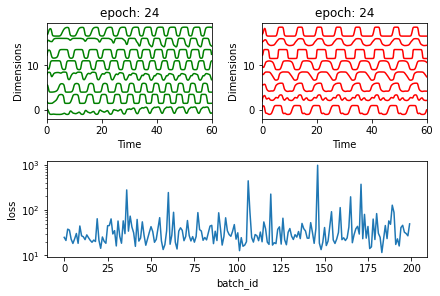

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.14568697  0.29700736  0.47208199  0.35117283 -0.17573397  0.59435811
   0.60485258 -0.03125657]
 [-1.5402372  -0.01970926 -0.81031836  1.64340032  1.62414602  0.17831988
  -0.49640038 -1.23926537]
 [-0.44109602 -0.4231703  -0.93961013  0.11271208  0.84969051  0.10815474
  -0.4309905  -1.44106915]
 [ 0.0826108   0.31544771  0.17447566  0.40203689 -0.06216918  0.1541503
   0.26731499  0.14399376]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.04it/s]

[[ 0.10189928 -0.68254458 -0.73186929 -0.61042828  0.42720681 -1.26957108
  -0.4806781  -1.31019783]
 [ 0.23150605  0.54693016  0.6664949   0.31883569 -0.25917075  0.43134017
   0.54397444  0.58690764]
 [ 0.0874651  -0.18686748 -0.34231311  0.42883756  0.41847529  0.15747865
   0.13157848 -0.34626818]
 [ 0.34383268  1.08833141  1.01312119  0.7692681  -0.41162425  0.75447011
   0.62893725  1.1642072 ]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[-0.13203621 -0.17312881  0.55901464  0.0357486   0.06859263 -1.14483176
   0.32502377 -0.06672158]
 [-1.36640972 -0.58021707 -1.27998689  0.66584592  1.75053857 -0.65632444
  -0.61442339 -1.9534583 ]
 [-0.75541606  0.25326656 -0.19878942  1.45317714  0.83518225  1.86707449
   0.40116582  0.31670174]
 [-0.13222794  0.32304214  0.3017149   1.01177086  0.21399263  1.28915879
   0.76476365  0.35528729]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[ 5.57879845e-01  2.02917063e-01  3.32415381e-01 -4.24989399e-01
  -3.72588472e-01  8.88654574e-04  2.39344698e-01 -3.94514115e-01]
 [ 6.57459030e-02 -1.24241507e-01 -5.53821245e-01 -6.11712694e-02
   1.74266497e-01 -7.30962646e-01 -5.18194996e-01 -6.70264878e-01]
 [ 5.17446204e-01 -5.12937360e-01 -4.05941870e-01 -7.92222579e-01
  -1.77920772e-01 -1.81092017e+00 -1.96811414e-01 -1.46021283e+00]
 [-6.28787992e-01 -2.11797064e-01  1.93920643e-01  7.14211574e-01
   8.80328455e-01  1.49235348e-03  5.48486797e-01  3.58407245e-02]]


 50%|█████     | 4/8 [00:03<00:03,  1.04it/s]

[[-0.37775209  0.13780249 -0.43791319  0.29508745  0.17825112 -0.47584349
  -0.25636053 -0.80465217]
 [-0.44744252  0.68736433  0.04513699  1.35263452  0.7726017   1.99944695
   0.49465255  0.27482896]
 [ 0.02604411  0.48468938  0.92653293  0.94222204 -0.1795983   1.42436784
   1.14618265  0.60924383]
 [-1.0642086   0.03495066 -0.53656446  1.25871392  1.22294399  0.07994086
  -0.238001   -0.27418655]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[ 0.09490076  0.10130765  0.07497067  0.17369513 -0.16620086  0.166139
   0.01512429 -0.16230546]
 [-0.78571708 -0.26897912 -1.1243815   0.61552202  1.24007227  0.05146141
  -0.49380817 -1.23267308]
 [-0.34957358  0.24827527  0.01660209  0.86442219  0.40147837  0.70187067
   0.31622033 -0.38739103]
 [-1.2165151   0.14803952 -0.94710286  1.39808834  1.4746763   0.38871746
  -0.68107119  0.1257209 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[-0.26047168  0.21012721  0.72376991  0.61375944  0.33308288  1.0849775
   0.91237046  0.23466301]
 [-0.58324081 -0.3209357  -0.77249873  0.41376006  0.85952622 -0.16785179
  -0.2382473  -0.99436023]
 [ 0.22175066 -0.38911295  0.09933421 -0.4762289  -0.07376882 -0.89350116
   0.09333068 -0.88551459]
 [-0.34326446 -0.1260289  -0.58681261  0.52062601  0.77630122  0.13357311
  -0.11564172 -0.70626837]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.10it/s]

[[ 0.12156109  0.32341823  0.81623872  0.55903261  0.034994    0.97713449
   1.12054994  1.08205481]
 [ 2.17608147  0.66089607  0.71807543 -0.68674739 -1.42369013 -0.24156653
   0.5413392   0.24538584]
 [-0.30252978 -0.45020503 -0.67391064 -0.0786411   0.78755234 -0.33305453
  -0.25400321 -1.13956241]
 [ 1.37069398  0.30068586  0.20290512 -0.99131374 -1.00563925 -0.65190395
   0.02955686 -0.3812169 ]]


100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


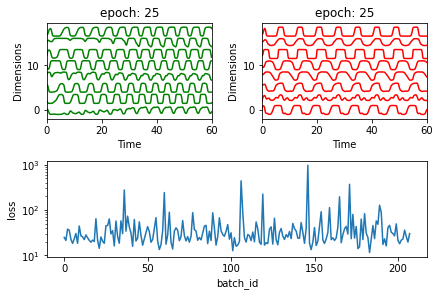

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.63645296 -0.17201433 -0.73451897  1.05092385  1.53834948 -0.12366495
  -0.50903517 -0.67379445]
 [-0.35393432  0.30791943  0.72301383  0.8296379   0.19732724  0.48349683
   0.82518632  0.67451039]
 [-0.61626733 -0.06410175 -0.58322106  0.73515887  0.99553767 -0.34714818
  -0.16474766 -0.52889823]
 [-1.00430625  0.18664617 -0.53644805  1.10541239  1.0274358   1.11575979
   0.01400342 -0.58006151]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.01s/it]

[[ 9.22991697e-01  8.23855638e-01  9.63031535e-01  6.24795661e-01
  -6.18877321e-01  1.39295957e+00  1.03553205e+00  1.00935528e+00]
 [-3.16624098e-02  1.34276227e-03 -2.15029464e-01  1.32154167e-01
   5.16414882e-04 -3.84923018e-01 -8.17269158e-02 -5.76650298e-01]
 [-9.54583756e-01 -4.98041166e-01 -6.68603387e-01  2.86862341e-01
   1.17285370e+00 -1.62567584e+00 -4.43978774e-01 -1.00903958e+00]
 [ 2.00923780e+00  6.29103713e-01  1.05005503e+00 -1.20356099e+00
  -1.67955316e+00 -8.49304173e-01  5.01220327e-01  4.06504146e-01]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.02it/s]

[[ 0.84922435  0.26268618  0.20816693 -0.50956308 -0.56653629 -0.52675851
   0.00699514 -0.60616128]
 [ 0.63001413  0.71237488  1.21535182  0.63815469 -0.48832517  1.04767366
   0.95315529  1.37008785]
 [-0.35806616  0.2248668   0.46002803  0.97942014  0.3543209   1.04453647
   0.75355452  0.47782519]
 [ 0.25322267  0.22276913 -0.29497467  0.53892731  0.51846598 -0.26326984
  -0.299634    0.01584535]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[-1.64980756 -0.62200023 -1.19879072  0.61869967  1.5593425  -1.40768769
  -0.8902674  -1.52121657]
 [ 0.22845741 -0.10499175 -0.77547106 -0.30896384  0.19444916 -0.90255037
  -0.66103621 -1.84499764]
 [ 0.4495834   0.50227465  0.7873623   0.46169524 -0.4664899   0.5311499
   0.83378258  0.38570498]
 [-0.50750766 -0.27596182 -0.07753161  0.24822752  0.67558257  0.19606422
   0.1944826  -0.20039311]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[-1.19951962 -0.77301255 -1.22982732  0.05158455  1.26073809 -1.13130919
  -0.75881544 -1.36983693]
 [ 2.35572757  0.73472046  1.67586759 -0.64624642 -1.83333107  0.21077153
   1.19690579  1.26092713]
 [-1.81535495 -0.50080951 -1.0681956   1.32278847  2.12572738  0.59438242
  -0.47688504 -0.90788492]
 [-0.06779353 -0.2632674  -0.27131731  0.20324005  0.5518184  -0.44426119
  -0.02348292 -0.84429593]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[ 0.33901301  0.14030919 -0.19880172  0.47614336  0.09110372  0.11323851
   0.08467637 -0.36648782]
 [ 0.94027179  0.75416601  1.5330362   0.59050621 -1.0196061   1.27905286
   1.35329259  1.43659245]
 [ 0.81345622  0.08709368  0.49010848 -0.36236624 -0.54396515 -0.49754231
   0.39045538  0.10940402]
 [ 0.92950874  0.32727809  0.61669536 -0.640615   -0.83495016 -0.8552723
   0.29412308 -0.1416345 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.02it/s]

[[ 9.65429265e-04  2.45064509e-02  4.36830862e-02  5.59375654e-01
   2.33691546e-01  1.16194872e+00  5.43700651e-01 -2.50247430e-01]
 [-1.33814772e+00 -3.21043721e-01 -1.82129394e+00  1.07257539e+00
   1.55170307e+00  2.65960318e-01 -8.78768826e-01 -2.40901943e+00]
 [-1.40012711e+00 -2.77940755e-01 -1.42293612e+00  1.31403316e+00
   1.55156149e+00 -1.31572440e+00 -9.98218478e-01 -1.41484341e+00]
 [ 2.04691717e+00  9.74706697e-01  1.85015406e+00 -1.84011191e-01
  -1.98157742e+00  6.28584898e-01  1.45570998e+00  1.45597446e+00]]


 88%|████████▊ | 7/8 [00:06<00:01,  1.04s/it]

[[-1.21681515  0.12216826  0.14132504  0.92666785  0.98786986  0.92277345
   0.40673323 -0.07418195]
 [-0.13543728  0.50037997  1.04777545  1.23174277  0.28808177  1.98162843
   1.32159974  1.48816765]
 [-0.31756865 -0.22243542 -0.50032048 -0.04633332  0.47540038 -1.32718826
  -0.43718035 -0.91895924]
 [ 0.55449605  0.18675742 -0.03679569 -0.37557561 -0.47629605 -0.38928735
  -0.04417851 -0.94384698]]


100%|██████████| 8/8 [00:02<00:00,  3.16it/s]


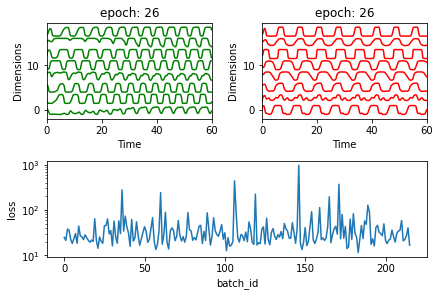

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 8.47163767e-01 -1.75759220e-01 -1.47107335e-01 -9.06124798e-01
  -6.38040956e-01 -1.24726733e+00 -9.87748058e-02 -8.84718824e-01]
 [ 1.60118360e+00  1.70134956e-01  9.14838438e-01 -1.15526165e+00
  -1.14744260e+00 -1.20559312e+00  6.53873367e-01 -2.16326191e-01]
 [ 2.73185691e-01 -1.07065837e-01 -3.67246484e-01 -1.70535860e-01
  -8.40674445e-02 -8.73538063e-01 -3.88697209e-01 -6.97287718e-01]
 [ 4.43934124e-01  7.56191980e-01  6.41759586e-01  1.92848815e-01
  -5.00023034e-01 -1.22220051e-03  2.16961438e-01  3.59277131e-01]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.06it/s]

[[-0.72717219 -0.05250622  0.17988876  1.15568699  0.7260672   1.14895362
   0.58840422  0.69108547]
 [ 0.97219432  0.11976774 -0.06440051 -0.53065413 -0.6516662   0.42420818
   0.17317703 -0.85738529]
 [-0.51176574 -0.04594461 -0.34628701  0.53770835  0.41179141 -0.91288239
  -0.34278826 -0.31071747]
 [ 0.31053183 -0.29766127 -0.59683574 -0.60218105  0.28402104 -1.21136542
  -0.46685148 -1.22269398]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[ 0.02898517  0.38944131  0.43863311  0.66562016 -0.13936474  1.0707221
   0.73667532 -0.00197836]
 [ 0.56229593  0.67051473  0.90305239  0.69151398 -0.18564762  0.30953963
   0.6958611   0.91198794]
 [ 1.20493768 -0.09442917  0.13626356 -1.07162377 -0.7627816  -1.85234151
  -0.0853064  -0.6039081 ]
 [ 0.10185572 -0.47567654 -0.46496833 -0.55527909  0.47419567 -0.82695815
  -0.20653775 -0.86950239]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[-0.56506345  0.26929105 -0.65598885  1.16010913  0.8961848   0.92403664
  -0.18769895 -0.7562266 ]
 [ 1.44809251  0.23347286  0.62083941 -0.73953603 -0.76632503 -0.14066489
   0.40393032  0.32989857]
 [ 0.17209675  0.49654275  0.59367594  0.77647178  0.27500467  0.55316461
   0.67581669  0.30648231]
 [ 0.60770189 -0.34086706 -0.53534282 -0.78346307 -0.11892833 -1.2604973
  -0.267238   -0.86434928]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-0.55370642 -0.13447394 -0.2982174   0.74006959  0.59525693  0.48706655
   0.1666705  -0.51584456]
 [-0.83081584 -0.02281211 -0.31977327  1.30910369  1.07993072  0.79497302
   0.31852039 -0.27811741]
 [-1.15119194 -0.41828561 -1.20249778  0.61981745  1.30377094 -0.87788569
  -0.7754629  -1.60409203]
 [-0.18029363  0.06863486 -0.54570478  0.3469566   0.58691813 -0.59619599
  -0.38186683 -0.42560228]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[-0.61507795 -0.03916689  0.3074543   0.50636662  0.64379138  0.39522363
   0.50738133 -0.08956774]
 [-0.94289714  0.33396119 -0.26426598  1.6571044   1.28715992  1.31968807
   0.2089441  -0.0284928 ]
 [ 0.65816363  0.33805217  0.62934293  0.21272329 -0.4976758   0.36769159
   0.59151442  0.17161196]
 [ 0.31995829  0.23610098  0.60531686  0.44355154  0.13887298  0.73048725
   0.66550833  0.66741408]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[-0.06409392 -0.14770644 -0.34151205 -0.18472631  0.09207841 -0.84613333
  -0.24334354 -0.78665871]
 [-0.2538069   0.02830651 -0.47242509  0.80462018  0.6743478   0.58640698
   0.0327065  -0.07412771]
 [-0.83808782 -0.22074236 -0.4047174   0.42294317  0.78111369 -0.55434678
  -0.29059341 -0.95593628]
 [-0.26406814 -0.12552235 -0.43599705  0.17926914  0.39909846 -0.84039851
  -0.30754805 -0.69090078]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[ 1.17341386 -0.32798752  0.18147134 -1.18986507 -0.73670092 -1.72242335
   0.05569802 -0.78399774]
 [ 0.52173703  0.14329208 -0.11575257 -0.08534189 -0.08522784  0.0956038
  -0.08650246 -0.29768837]
 [-0.22222237  0.21694457 -0.35723846  0.44801147  0.18554534 -0.38743801
  -0.38860414 -0.74772209]
 [ 0.10288795  0.81170434  1.18957985  1.11864788  0.05495772  1.14973061
   1.03239444  1.64667593]]


100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


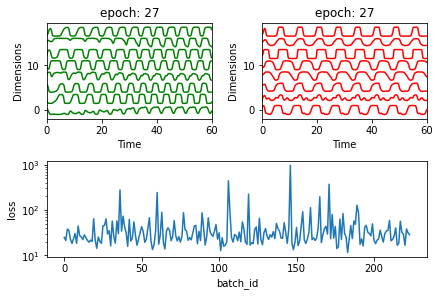

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.73931749 -0.30262828 -0.78182488  0.95220688  1.2245537   0.41440586
  -0.00629105 -0.86979912]
 [-0.8256686  -0.2597848  -0.34233536  0.61007988  0.98913661  0.33830151
   0.17876241 -0.37522461]
 [ 1.00144602  0.43718618  0.8135791   0.0676971  -0.50678241 -0.12514567
   0.72527884  0.69148341]
 [ 0.26303208  0.37384554  0.31746814  0.39967845 -0.09843367  0.57428716
   0.54949014  0.28173757]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[-0.74025319 -0.28069259 -0.13550151  0.46087839  0.66157061 -0.32794985
   0.19798178 -0.5924943 ]
 [-1.60670783 -0.9050867  -1.73478018  0.31528498  1.99583121 -1.36251996
  -1.22470421 -2.38521026]
 [-0.08420697 -0.59240458 -1.05793223 -0.50823304  0.57723955 -2.53963732
  -1.03181434 -1.70644761]
 [-0.75408748 -0.01881658 -0.4467124   0.76656746  0.79846176 -0.89527789
  -0.52870204 -0.7272977 ]]


 25%|██▌       | 2/8 [00:01<00:05,  1.09it/s]

[[ 1.40967092  0.73038999  1.20455602 -0.08105099 -1.08016089  1.22224196
   1.1230094   0.89475375]
 [ 0.15216652 -0.1302452  -0.0884192   0.13574231  0.28358249 -1.38661098
  -0.27404327 -0.81235575]
 [ 0.14037457 -0.29901228  0.12305609 -0.21297177  0.28370752 -1.00786103
   0.13441471  0.10854286]
 [ 0.32364824  0.80865998  1.44935405  0.98282268 -0.34284286  1.0136124
   1.36262712  1.3111325 ]]


 38%|███▊      | 3/8 [00:02<00:04,  1.09it/s]

[[ 1.68910382  0.81552276  2.01698076 -0.40950617 -1.64771246  0.02334468
   1.33440636  1.74343247]
 [ 0.77991408  1.25718033  1.57499696  1.01610474 -0.88563311  0.77750118
   1.08657494  1.24961614]
 [-0.99072318 -0.53284347 -0.40540032  0.33176309  1.04307667 -0.6943326
  -0.05830873 -1.19807   ]
 [ 0.4398094   0.59428738  0.81220151  0.5961343  -0.33843875  1.24546813
   0.92206107  0.66278775]]


 50%|█████     | 4/8 [00:03<00:03,  1.10it/s]

[[-0.54256757 -0.6687853  -1.33112512 -0.28729427  1.16461512 -1.99141121
  -1.25398687 -1.53793018]
 [ 0.51738295  0.43297391  0.71890605  0.70137209 -0.1237215   0.58274226
   0.70405975  0.80021172]
 [-0.11442065  0.42567084 -0.20026785  0.76192181  0.51295982 -0.30376469
  -0.22241344 -0.46624246]
 [ 0.90993884 -0.13148682 -0.35280697 -0.74029519 -0.49587891 -1.44758118
  -0.45096593 -1.23933696]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.11it/s]

[[-0.42695217  0.72959862  0.23774723  1.2336598   0.09032532  0.67531004
   0.18032017  0.19125647]
 [ 0.19898978  0.43133069  0.73349137  0.22536792 -0.30216807  0.28612497
   0.55974835  0.04185902]
 [ 0.87843438 -0.04211879 -0.72179487 -0.32653123 -0.08371151 -0.18478154
  -0.22283059 -1.0496216 ]
 [-0.2091689   0.35514165 -0.49263417  0.8753073   0.51390666  0.9091963
  -0.18763715 -0.07194301]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.07it/s]

[[-7.48118409e-01 -1.57187831e-01 -2.71088646e-01  9.96141829e-01
   8.20623849e-01  8.51135799e-01  1.84108769e-01  1.62150894e-01]
 [ 1.01246433e+00 -1.21169891e-01 -1.54168313e-02 -8.64690244e-01
  -6.52223358e-01 -6.69644009e-01 -2.53005302e-04 -7.81448910e-01]
 [-1.71823638e-02 -2.26007502e-01 -2.67752922e-01  4.49938907e-02
   3.48030180e-01 -8.13118772e-01 -1.78087480e-01 -6.48435547e-01]
 [ 5.58673659e-01  1.43551960e-01  1.71199761e-01 -5.24556282e-01
  -3.73069260e-01 -5.26664939e-01  1.03256787e-01 -5.54219011e-01]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-0.69340306 -0.07740047 -0.31157747  0.68071369  0.70723778 -0.64562813
  -0.1695836  -0.54307415]
 [ 1.62578591  0.63166847  1.0302616  -0.0452388  -1.11780724  0.36290079
   0.85002906  0.48644468]
 [ 0.39236628  0.22157713 -0.00240179 -0.10912921 -0.11085015 -0.69888474
  -0.01646949 -0.59526943]
 [ 1.95735789  0.54642974  0.62860233 -0.5729745  -1.26287151 -0.06084091
   0.38508608  0.15555579]]


100%|██████████| 8/8 [00:02<00:00,  3.32it/s]


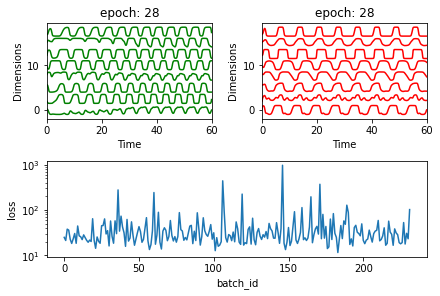

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.54429943  0.25006213  0.23290598  1.01327443  0.44119161  1.83598123
   0.68758332 -0.62815646]
 [-0.19889575  0.14499019 -0.32405918  0.75419277  0.50609165  0.24218133
  -0.21087681  0.22727373]
 [-0.8552552  -0.21139129 -1.28540807  0.60786868  0.87807674  0.05804142
  -0.76094899 -1.99295841]
 [-0.05551729  0.21326231 -0.09696979  1.0941236   0.60402574  1.1705635
   0.41959894  0.43898143]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[-0.13733756 -0.09173557 -0.1043934  -0.35824419  0.09587743 -0.59091598
  -0.08843666 -0.70114744]
 [ 0.73462712  0.46541228  1.14787411  0.55551397 -0.45247772  1.19223893
   1.14379424  0.86640646]
 [-0.25983521 -0.01954889 -0.18709686  0.25634264  0.17213591  0.38223602
   0.15398422 -0.69421232]
 [ 0.09291406  0.07256284  0.59581504  0.2163556   0.21745285  0.19903303
   0.73815677  0.59540305]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[ 0.52582274  0.11745004 -0.05849886  0.07467089 -0.2212499  -0.73097733
  -0.01464495 -0.53924766]
 [-2.27681656 -0.61382046 -1.41504298  1.40686506  2.42782185 -0.28607625
  -0.75611091 -1.57915928]
 [ 0.61122134  0.4594434   0.21707519  0.54012255 -0.05728431  0.16056192
   0.33415929  0.04438388]
 [ 0.31011478  0.70377979  0.50505792  0.78381442 -0.16576841  1.23927483
   0.456783    0.79303958]]


 38%|███▊      | 3/8 [00:02<00:04,  1.08it/s]

[[-0.03781114  0.27880804 -0.24027828  0.29569461  0.07660709 -0.35600374
  -0.18370565 -0.8659201 ]
 [ 1.59296893  0.8563025   0.94005172 -0.43638447 -1.3553845   0.46991674
   0.73934231  0.27256919]
 [-0.08911624  0.08963647 -0.57564348  0.46200321  0.6332852   0.25762168
  -0.1979201  -0.75462021]
 [ 2.29121309  0.92572121  0.66554198 -0.80580181 -1.75723332 -0.69846075
   0.11431874  0.22164347]]


 50%|█████     | 4/8 [00:03<00:03,  1.09it/s]

[[-0.65147685  0.41078296  0.02523474  1.23491382  0.66060772  0.74791808
   0.29196417  0.47265679]
 [ 0.10038624  0.31547323  0.29671189  0.82150128  0.24195799  1.22033896
   0.68636246 -0.13893614]
 [ 0.88381263  0.05354196  0.05271303 -0.11967137 -0.25572797 -0.22879977
   0.27503435 -0.68582244]
 [ 0.63384145  0.6276465  -0.01459786  0.72402773 -0.094058    0.620343
   0.13135803 -0.40012263]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.10it/s]

[[ 0.26282053  0.13493788 -0.26544926  0.28555796  0.04988391 -0.52072178
  -0.08685285 -0.38915077]
 [ 0.48980597  0.5625428   0.82171759  0.43967941 -0.0966019   0.6340998
   0.62488261  0.82441503]
 [-0.24804129  0.5080158   0.00304482  1.52241875  0.62015344  1.43360506
   0.37442886  0.68643627]
 [ 1.18517979 -0.1867121  -0.55056526 -1.41149889 -0.91646291 -2.28047691
  -0.83342749 -1.2738789 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.10it/s]

[[-0.49936403  0.25652753  0.3722944   0.6895021   0.35418095  0.27086589
   0.30669242  0.07034306]
 [ 0.43880728  0.27776805  0.62484362  0.39020183 -0.32672248  0.55307998
   0.63003332  0.04662121]
 [-0.04785328  0.67476052  0.33517477  1.11244449  0.02317215  0.67177577
   0.34147275  0.32732931]
 [ 0.50676006  0.77458039  1.15108506  0.95837665 -0.64463218  0.85940997
   1.11840055  0.96435477]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.11it/s]

[[-0.22913171 -0.09643768 -0.74854796  0.06503561  0.39319858 -0.68302634
  -0.66182131 -0.96252123]
 [-0.44630511  0.47834191 -0.11009351  1.0582877   0.58392857  0.37943179
  -0.05350497 -0.09293573]
 [ 2.07740999  0.5350848   1.40175799 -0.88524889 -1.63352397 -0.29239589
   0.91678247  0.97564503]
 [ 0.29267674  0.0975282   0.53567555  0.0173754  -0.34022892  0.5270979
   0.58312261  0.07355952]]


100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


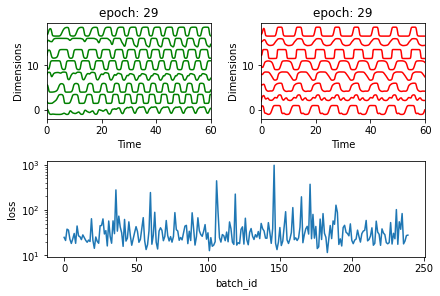

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.15810818 -0.56991777 -0.83852108 -0.36021237  0.46909201 -0.88464365
  -0.43705749 -1.90691163]
 [-0.03722134 -0.27064556 -0.71370387 -0.45546121  0.15409299 -2.14480717
  -0.96359933 -1.37250322]
 [ 0.74052811  0.23827768  0.39444745 -0.52136503 -0.71735189 -0.92172101
   0.14491295 -0.18112285]
 [ 0.15374527  0.34179996  0.60667358  0.67812461 -0.16383649  1.11022911
   0.94169852  0.42031445]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.03it/s]

[[ 1.01122133  0.68674449  0.93433357  0.31805345 -0.52219483  0.45366931
   0.65969639  0.81470785]
 [ 0.35868636  0.65000436  0.44577826  0.44856551 -0.24283735  0.84051115
   0.44860854  0.19126454]
 [ 0.00295726  0.48884036 -0.03344668  0.61735845 -0.0321747   0.39051296
   0.13155983 -0.53143315]
 [-0.44873262  0.32366118 -0.41781744  1.17761791  0.8188999   0.66573095
  -0.1778948  -0.58373156]]


 25%|██▌       | 2/8 [00:02<00:05,  1.01it/s]

[[-1.112552    0.1010011  -1.11306287  1.12758762  1.3249438  -0.09735539
  -0.79800318 -0.9997522 ]
 [ 0.51363046  0.25661285  0.22349907 -0.1171718  -0.13942513 -0.68106102
   0.11350671 -0.30286795]
 [-0.87584271 -0.10612008 -0.39021693  0.75167118  1.03943165 -0.97467253
  -0.32425605 -0.76596256]
 [-0.42633202 -0.19196764  0.10694033  0.01864386  0.46637248 -1.00690296
  -0.028667   -0.45532081]]


 38%|███▊      | 3/8 [00:02<00:04,  1.03it/s]

[[ 0.22288849 -0.12061177 -0.33234718 -0.44736245 -0.09098669 -1.13208879
  -0.28936138 -1.06053935]
 [ 0.1268584   0.31527035 -0.0027129   0.42891983  0.0744687   0.7334031
   0.09829253 -0.11417768]
 [-0.78667734 -0.50659199 -1.22060302  0.56384221  1.00115923 -1.66661777
  -1.01018837 -0.8647071 ]
 [-0.64169073  0.0109832  -0.24511405  0.78603489  0.64575073  0.4825296
   0.18768807 -0.57187388]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 0.32426693  0.42894669  0.53426802  0.80781309 -0.07933284  1.54472316
   0.85314294  0.84024581]
 [ 0.18785346  0.32786062  0.22269884  0.13232718 -0.09555831  0.05606954
   0.45199768 -0.25089343]
 [ 0.06308728  0.03357687  0.43966771  0.18923445  0.17602656 -0.49767874
   0.47659709  0.12127427]
 [ 1.07494726  0.27839681  1.66553697 -0.30604499 -1.10298888  0.48794384
   1.42932787  0.73910288]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[ 0.05789024  0.32887784  0.27985207  0.55368047  0.14842784  0.42825706
   0.21199332  0.27278075]
 [-0.60671348 -0.09978219  0.00663119  0.8183471   0.84996868 -0.1927886
   0.17480911  0.2137431 ]
 [ 0.01192207 -0.10491025 -0.44016211  0.26078659  0.61742077 -0.09230699
  -0.1276042  -0.4741877 ]
 [ 0.30164288 -0.37830877 -0.65451861 -0.76548964 -0.11211647 -1.21843528
  -0.40673649 -1.53262062]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[-0.57573529  0.15171216 -0.26876893  0.85877308  0.4238343  -0.08851367
   0.063712   -0.07592657]
 [ 0.73357313  0.85767936  0.61843063  0.49518735 -0.70136344 -0.32519948
   0.08017189  0.31454563]
 [ 0.7761182   0.01423607 -0.11859989 -0.65010573 -0.67463079 -1.45329125
  -0.16686851 -0.99921881]
 [-1.16980093 -0.28570811 -1.62630872  0.25268296  1.21715534 -1.79536391
  -1.49640055 -2.19833344]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[-0.09051652  0.45750377  0.3963515   0.84569413  0.19610987  1.00539161
   0.59263894  0.36959677]
 [-1.08252672  0.15225408 -0.84277328  1.54498351  1.38673883  1.01881141
  -0.33460474 -0.29322978]
 [ 1.853449    0.84321238  1.95170651 -0.13666741 -1.54531357  1.57414821
   1.80206535  1.91803541]
 [ 1.49857782  0.43453554  1.01950156 -0.40077808 -1.15043366  0.50233154
   1.06820138  0.29114515]]


100%|██████████| 8/8 [00:02<00:00,  3.15it/s]


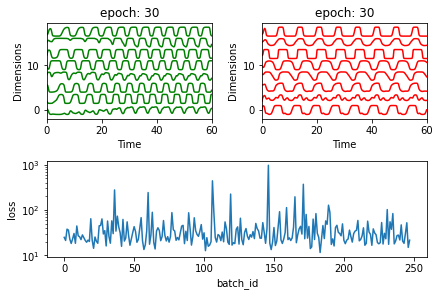

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.585113    0.37421792  0.09154016  1.51942955  0.97157305  1.76663829
   0.66657763  0.39936829]
 [-0.98037924 -0.12753067 -0.54167455  0.6596371   0.78114955  0.03004241
  -0.34897468 -1.04414392]
 [ 0.48917124 -0.0238131  -0.18663008 -0.04793784  0.06910162 -0.63260766
  -0.06419664 -0.23468078]
 [-1.6473947  -0.31461215 -0.79902782  1.49233373  1.80622104  0.93190776
  -0.07995952 -0.83780035]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.02s/it]

[[ 0.96696586  0.14411482  0.57822424 -0.16712978 -0.19126844 -0.15298534
   0.71831966  0.31637609]
 [-0.4649718   0.29776712  0.39342622  1.30333523  0.55642745  1.61265596
   0.81618725  0.68738146]
 [-0.0914489  -0.14996724 -0.1140306  -0.15551692  0.06560859 -1.22202957
  -0.22873947 -0.69374136]
 [ 1.03903648  0.01287877  0.21631874 -0.90876128 -0.2990868  -0.97288716
  -0.17071833 -0.46548424]]


 25%|██▌       | 2/8 [00:01<00:05,  1.02it/s]

[[-1.07707019  0.02657685 -0.34416368  1.18704827  1.30522656  0.41466051
  -0.01829492  0.02152598]
 [-0.9872854  -0.03878307 -0.44280165  1.0417804   1.13524728  0.36770152
  -0.0924306  -0.57540001]
 [-0.87901349  0.07001223  0.15288734  1.21567288  0.61136021  0.94469513
   0.37734412  0.30902646]
 [ 0.87968281  0.76362179  0.92196963 -0.15299072 -0.91737005  0.90021395
   0.7874438  -0.21732267]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[ 0.64824525  0.56767686  1.09539183  0.44987152 -0.82392252  0.38956997
   0.98616696  0.93854617]
 [ 1.73324797 -0.00905031  0.67242964 -1.35581806 -1.26555159 -1.87892916
   0.15957767 -0.15501512]
 [ 1.04106846  0.02152234  0.16704973 -0.64533248 -0.68153363 -1.33374274
   0.02195116 -0.71931302]
 [ 0.34763782 -0.22753717 -1.1715581  -0.48870399  0.24759918 -1.76716024
  -1.13250045 -1.88616875]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[ 0.83560621  1.09082026  1.76702365  0.80641238 -0.83471679  2.10346442
   1.7760979   2.1438025 ]
 [ 0.40083511  0.51910141  0.76069224  0.47966715 -0.26287036  0.47189689
   0.62739262  0.31028809]
 [ 0.75206419  0.33292934  0.63777875  0.04702945 -0.07861066  0.66346045
   0.64802482  0.42519739]
 [ 0.20560361  0.04951862 -0.04744444 -0.26128201 -0.07068656 -1.29982119
  -0.29518201 -0.33645207]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[ 0.94041883 -0.60106647 -0.08699991 -1.56078456 -0.51563817 -2.06822366
   0.0080023  -1.53724837]
 [ 0.04723574  0.40021372  0.15786227  0.41641395 -0.50881509  0.11465183
   0.20043352 -0.94384705]
 [-0.1503442  -0.12622699  0.18104264  0.54180187  0.56164285  0.1406438
   0.46560419  0.23055352]
 [-0.19321893 -0.04578419 -0.90036535  0.59732707  0.66482595 -0.39902173
  -0.46283621 -1.13172196]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.07it/s]

[[-0.40620185 -0.42324336 -0.86116496  0.69322676  0.70837907  0.74175651
   0.08728888 -1.04520053]
 [-0.50797455 -0.44606483 -1.32157662  0.55386029  1.16314415  0.05417212
  -0.53461383 -1.22485896]
 [-0.81872718 -0.16066675 -0.49290116  0.79267767  0.90068099 -0.58093418
  -0.27563071 -0.65409423]
 [ 0.70888918  0.22302806  0.05014103  0.07308113 -0.35522529  0.02103941
   0.14568352 -0.45960164]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[ 0.26379178  0.34381956  0.39910034  0.221771   -0.333617    0.06037822
   0.26188016 -0.21392682]
 [-0.00665633  0.43058176  0.35833856  0.77487985  0.06039868  0.48261901
   0.41360249  0.04574662]
 [ 0.74743932  0.43647544  0.78180541  0.11416391 -0.50085745 -0.94475452
   0.16809702  0.7588864 ]
 [-0.60317469 -0.02421589 -0.45210404  1.22163801  0.9526608   1.70637529
   0.31476994 -0.88490262]]


100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


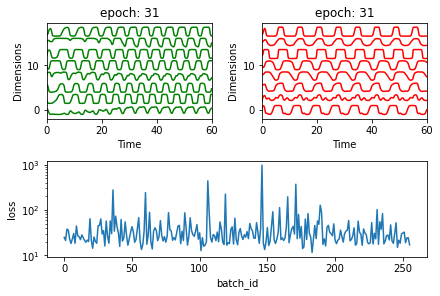

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.24174873  0.42250662 -0.03647894  0.08592043 -0.25443928  0.17864314
   0.07543074 -0.58677503]
 [-1.32570683  0.11540077 -0.35255603  1.80030031  1.1255592   1.25696586
   0.25818774 -0.24105549]
 [-0.01309701 -0.09182041  0.39081529 -0.12253498  0.2578017  -0.1376791
   0.49503154 -0.12948511]
 [ 0.31866558  0.75866368  0.42824345  0.81629459 -0.14922196  1.7091834
   0.63583686  0.78933032]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.07it/s]

[[-0.1991028   0.04317473 -0.54602119  0.69743149  0.79441787  0.02378001
  -0.11736079 -0.33947178]
 [ 0.92699685 -0.29644089 -0.38365457 -1.34716201 -0.79210556 -1.39095667
  -0.37453297 -1.34762033]
 [-1.00070321 -0.15364044 -0.26257711  1.1382418   1.02598395  0.64722333
   0.36982914 -0.25684565]
 [-1.45243133  0.03245712 -0.799035    1.91233472  1.50505481  1.09550485
  -0.03272753 -0.28381844]]


 25%|██▌       | 2/8 [00:01<00:05,  1.09it/s]

[[-0.46896932  0.30422362  0.01238123  0.84045329  0.51730323  0.36524001
   0.12473223 -0.02163518]
 [-0.60130815  0.61318581 -0.01627115  1.46413527  0.53259111  1.79045487
   0.43290442  0.24381528]
 [-0.65044359 -0.3130889  -0.38707237  0.24581002  0.79484115  0.04630149
   0.00916097 -0.91803636]
 [ 0.76425198  0.62510899  0.7062918   0.95909999 -0.18115142  1.33470135
   0.92611506  0.78774862]]


 38%|███▊      | 3/8 [00:02<00:04,  1.10it/s]

[[ 0.87272465  0.35640965  0.75232165  0.16801102 -0.3888414   0.59087243
   0.92770702  0.53406119]
 [-0.7936497  -0.16234825 -0.4146183   0.76372301  0.92564912 -0.25857609
  -0.24817028 -0.59972808]
 [ 1.05903081  0.30494552  1.25241389 -0.07514953 -1.02007211  0.60952603
   1.12395401  1.00338132]
 [-0.5633179  -0.27308786 -0.0434907   0.37206476  0.87133335  0.85388577
   0.60210512 -0.33857511]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-1.42644231  0.02505993 -0.63910359  1.82988472  1.4382137   1.20344422
  -0.01506573 -0.15247706]
 [ 0.1234914   0.02514853 -0.22005898  0.76378895  0.49233159 -0.10770832
   0.01246348 -0.13354063]
 [-0.13894745  0.22085235  0.00873826  0.16621377 -0.10364117 -0.06488928
  -0.01490867 -1.28849922]
 [-1.31468705 -0.53810673 -1.00442108  0.66323364  1.35040691 -0.88335375
  -0.55254056 -1.49094408]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[ 0.73016276  0.40800686  0.31174145  0.26420657 -0.45392749  0.41422847
   0.2826403  -0.16451929]
 [ 0.14344084 -0.04974349  0.1209446  -0.13190929 -0.09641978 -0.88303427
  -0.08268997 -0.6554673 ]
 [ 1.45635713  0.1638569   0.89100468 -0.34338954 -0.9920455   0.22179912
   0.88131064  0.66813622]
 [-0.39159071 -0.01179067  0.31290079  0.00379727  0.26595543 -0.79215096
   0.10755482 -0.59144223]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[-1.07849235 -0.27035603 -0.36228767  0.97217234  1.22312003  0.76911027
   0.19561818 -1.04960204]
 [-0.95374561 -0.57026825 -0.86895494  0.08489497  0.89679182 -2.3463931
  -0.88607583 -1.37923014]
 [-1.38535759 -0.53677026 -0.02502939  0.72878682  1.18735722 -0.55293206
   0.26869183 -0.50373251]
 [ 1.55946099  0.72290149  1.31730166  0.01020196 -1.08666161  0.1609299
   1.01456413  0.89024771]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-1.12320172 -0.67345555 -1.31516353  0.38231648  1.117262   -1.86499865
  -1.09833973 -1.26756684]
 [ 0.14317015  0.24307212  0.38276384  0.41252919  0.13870658 -0.02245232
   0.44337558  0.06023359]
 [-1.10010116 -0.30568217 -0.26394877  0.6156149   0.91151449 -0.04810571
   0.01343892 -0.44534492]
 [-0.76894972 -0.11049922 -0.53769802  0.56292178  0.91939371 -0.06690894
  -0.30760284 -0.86950239]]


100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


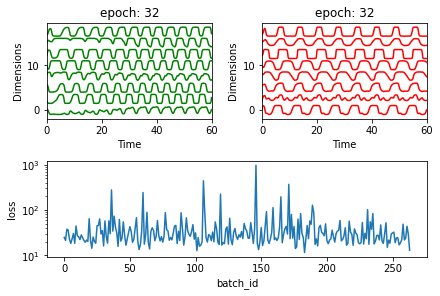

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.39559956  0.07558216  0.00384238  0.34464709  0.00435278  0.11482022
   0.34168882 -0.41870077]
 [ 1.00660654  0.37839421  0.60331426 -0.03857675 -0.56945359  0.09868388
   0.54644175  0.61795382]
 [ 0.22093058  0.46080539 -0.38751114  0.56232913  0.23499008 -0.3110823
  -0.4440928  -0.21568385]
 [ 1.69438864  0.27611096  0.44351492 -1.11110382 -1.73500376 -2.97435738
  -0.37745275 -0.32021405]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.03s/it]

[[-0.15610944 -0.48422344 -0.77674494 -0.27210239  0.53955201 -0.84365428
  -0.49568024 -1.95422601]
 [ 1.38972288  0.10846659  0.56792179 -0.95543086 -0.80237698 -0.54593812
   0.42096644 -0.20137355]
 [ 0.74462402  0.28622593  0.64862232 -0.03234113 -0.72138027  1.07000559
   0.95880505 -0.08567752]
 [ 0.47446696  0.60805062  0.79549947  0.9523555  -0.42358338  1.39944007
   1.06484382  0.66372461]]


 25%|██▌       | 2/8 [00:01<00:05,  1.01it/s]

[[ 0.4165296   0.80912363  1.27243856  0.39510094 -0.5701828   0.84017009
   0.84504433  0.75866066]
 [-2.32753898 -0.43726231 -1.34907973  1.58494861  2.39892629  0.53093488
  -0.65608705 -1.14224891]
 [-0.40596989  0.22181767 -0.25761624  0.58345504  0.61562885 -0.16999816
  -0.11259142 -0.57363539]
 [ 0.72895484  0.81784013  1.25340362  0.45817417 -0.93023052  0.59584108
   1.04518527  0.82864116]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[-0.63480511 -0.19837122 -0.41960099 -0.03336301  0.49782704 -1.0246247
  -0.2888897  -1.10334201]
 [-0.43338926 -0.38213055 -0.73307007  0.7359519   1.08110159  0.21203367
  -0.02991923 -0.50194325]
 [ 1.67804871  0.93026197  1.55850371  0.02800279 -1.72267576  1.69075317
   1.34869773  1.57159157]
 [-1.80991071 -0.43455398 -1.13205525  1.3392575   1.90564799 -0.16247306
  -0.49539399 -0.9669353 ]]


 50%|█████     | 4/8 [00:03<00:03,  1.06it/s]

[[-1.3260523  -0.98199239 -1.90304858  0.21353766  1.53273706 -1.90113241
  -1.32268868 -2.44050414]
 [ 1.28202845  0.29565921  0.39863947 -0.10691935 -0.49356339  0.20003175
   0.50132556  0.19941332]
 [-1.93094155 -0.60065328 -1.11585825  1.54847718  2.09790706 -0.00472143
  -0.29974462 -0.97055822]
 [-0.49367783 -0.58003596 -1.58080554  0.06894705  1.00098431 -1.94814118
  -1.22441111 -2.29990904]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[ 0.10315244 -0.32976775 -0.89976441 -0.78710349  0.22789402 -2.62370013
  -1.11944555 -1.9974095 ]
 [-0.86484741  0.24761673  0.71102331  1.08389503  0.60256856  0.26096007
   0.58718858  0.70945378]
 [ 1.00349385 -0.10499823  0.08074501 -1.15004081 -0.46483194 -1.34942598
  -0.20764968 -0.52372936]
 [-0.43883925  0.25576217 -0.35803296  0.51405097  0.30815958 -0.01442361
  -0.26746406 -0.7226198 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.03it/s]

[[-0.48276073  0.03024643 -0.26548963  0.36554462  0.35525886 -0.75422161
  -0.16622879 -1.16775968]
 [ 0.87687712  0.22051684  1.20419609 -0.05376661 -0.80136645 -0.11940952
   1.00035307  0.08605396]
 [ 0.05263019  0.74565919  0.38245945  0.89325392 -0.3507461   0.99540189
   0.40287785  0.4306736 ]
 [-1.18259322 -0.61857036 -1.53287432  0.40179404  1.18552164 -1.33988133
  -1.13810617 -1.76625352]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[-0.70312083  0.4386271  -0.13070071  1.33310519  0.6965463   1.54343282
   0.40030916 -0.08253201]
 [-0.48652092 -0.35493334 -0.64269621  0.21446313  0.62244025 -0.53916324
  -0.3517201  -0.6494578 ]
 [-1.33213239 -0.31788342  0.23830549  1.34261946  1.25174492  1.64793982
   1.08681194 -0.2707863 ]
 [-0.27653303  0.53675784 -0.01984737  1.54494752  0.7029549   0.68955597
   0.09389416  0.50540329]]


100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


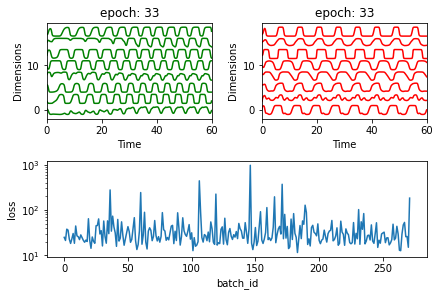

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.03274651 -0.12050802  0.17485022  0.16093912  0.28500999 -0.04079072
   0.4679914  -0.25421276]
 [ 0.28427968  0.83876592  1.40496009  0.84696099 -0.53643357  1.30046857
   1.15154461  1.66375084]
 [-1.10312205 -0.27556953 -0.33259677  0.85238488  0.90336131  1.02133217
   0.41474619 -0.81110227]
 [ 0.84692808  0.2618162  -0.51574609  0.18045418 -0.37992793 -0.13108308
  -0.3634952  -0.67677031]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.10it/s]

[[-0.33636897  0.1809573  -0.09221544  0.85381143  0.72137412  1.04993433
   0.30198595 -0.09078589]
 [-0.12885253 -0.0214069   0.08587931  0.85862777  0.60161194  0.29407439
   0.2807766   0.18286338]
 [ 0.11509055  0.45033353  0.84243425  0.64462333  0.07859676  0.9312017
   0.81411429  1.0063789 ]
 [-0.43773727 -0.53035712 -1.14023691 -0.43997793  0.4189212  -1.75175318
  -0.87677543 -2.28646364]]


 25%|██▌       | 2/8 [00:01<00:05,  1.11it/s]

[[ 1.66638388e+00  6.40231124e-01  1.30120901e+00 -9.69372206e-01
  -1.81321913e+00 -8.08542033e-01  7.18971758e-01  5.28829350e-01]
 [ 1.11488275e-02  1.32922318e-01  1.44887900e-01  3.52532286e-01
   3.08473774e-01 -5.06233423e-01 -8.42184151e-04 -1.56121837e-01]
 [ 9.35938825e-01  6.37387593e-01  9.54186628e-02 -2.78920818e-01
  -6.36351057e-01  5.68497698e-01  1.84423712e-01 -3.22399083e-01]
 [ 2.92111285e-01 -1.90329328e-01 -5.79136422e-01 -4.55302221e-01
  -3.87016363e-02 -1.14511193e+00 -5.28138374e-01 -1.34908495e+00]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[ 0.48720658 -0.43478583 -0.48272375 -0.95182811 -0.29581745 -1.47339296
  -0.45360821 -1.58651455]
 [-0.16263836  0.29755015  0.06256868  0.67597544  0.1684961   0.10903105
   0.27516668 -0.11633823]
 [-0.52043218  0.23898423  0.38988436  1.38771008  0.74222232  1.20545092
   0.69901114  0.36794055]
 [ 0.3098744  -0.19930777 -0.38686758  0.06095261  0.13609988 -0.80993936
  -0.20127187 -0.34910577]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[ 0.00714752  0.52365295  0.53817719  1.08157383  0.25216795  1.65138508
   0.96700886  0.53135282]
 [-0.20795198 -0.13358334 -0.28810183  0.43871402  0.49853204 -0.36300316
  -0.03082272 -0.75742168]
 [-0.62906675  0.38286439 -0.0735618   1.32165063  0.78858035  1.0822533
   0.25818581 -0.33891248]
 [-0.19092133  0.42851759  0.29627034  0.73239191  0.29524908  1.11908598
   0.72933576 -0.5264279 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[-1.83847205 -0.45182087 -1.28353413  1.57287889  1.70018205 -0.64553306
  -0.71260293 -1.23287568]
 [ 0.69995721  0.42633639  0.2217818   0.32542923 -0.43780421 -0.31194052
   0.17705611 -0.27003434]
 [ 0.01728057 -0.26588272 -0.71806412 -0.11291187  0.20336221 -2.2053726
  -0.72863825 -1.29388086]
 [-0.27050148 -0.2015722  -0.88217732  0.55965316  0.73411221 -0.423361
  -0.51289371 -1.11920515]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[ 0.19046749 -0.11780852 -0.76759061 -0.13126987  0.24318493 -0.26034522
  -0.66063856 -0.94680079]
 [-0.01920916  0.18867563 -0.25861914  0.31074456  0.07285615 -0.62386219
  -0.18444345 -0.88808529]
 [-0.58812315 -0.385131   -0.96654737  0.62184671  0.80288562 -0.14767615
  -0.46917104 -1.60661039]
 [ 0.13893449  0.34020736  0.20381642  0.43894345 -0.12474799  0.48664513
   0.29863388 -0.01757144]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[-1.14082129 -0.33480597 -0.50195719  0.72029107  1.17706865  0.34527399
   0.05592016 -1.10855168]
 [-1.04054452  0.35174964 -0.02489276  1.48115067  0.89096056  1.06284725
   0.23624426  0.19835872]
 [-1.28283381 -0.4009904  -1.16963666  0.99712412  1.46550434  0.54574266
  -0.50884546 -1.71488869]
 [ 0.81269841  0.18282165 -0.28340411 -0.4671092  -0.25217038 -1.03096223
  -0.33389966 -0.9716175 ]]


100%|██████████| 8/8 [00:02<00:00,  3.32it/s]


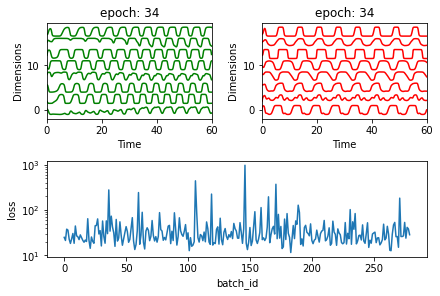

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.85226866 -0.09412315 -0.63115018  0.69517936  0.69157636  0.02412756
  -0.17827037 -0.95348252]
 [-0.61140318 -0.07844951  0.35734025  0.56175625  1.05541679 -0.51215355
   0.38303912  0.18023348]
 [-1.81128183 -0.66208835 -1.66312915  0.6999648   1.87869532 -0.61503479
  -1.0386756  -1.86267745]
 [-0.71471007 -0.14412843 -1.06719081  0.47633931  0.93843359 -1.28327246
  -0.97370269 -1.29880471]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.11it/s]

[[ 0.79363115  0.42931969 -0.2349646  -0.02506954 -0.40452226  0.22318198
  -0.17844713 -0.42957005]
 [-0.11211379 -0.1708896  -0.63923343 -0.21991399  0.24892116 -1.36858993
  -0.56061227 -1.01995178]
 [-1.11404498  0.24145005 -0.48730712  1.739278    1.26888492  1.81729204
   0.0926519  -0.19216973]
 [ 0.65835579  0.05163359  0.66019705 -0.32469231 -0.12835366 -0.7496342
   0.52312619 -0.28207546]]


 25%|██▌       | 2/8 [00:01<00:05,  1.11it/s]

[[ 0.18916073  0.32736292  0.28189608  0.47210936  0.25860067 -0.05990853
   0.28888402  0.23958251]
 [ 0.31878868  0.63365877  0.6674678   0.72190814 -0.05726209  2.21473705
   1.13072942  0.41356774]
 [ 0.87129408  0.3189667   0.35558551 -0.57819961 -0.65582729 -0.47239143
   0.19728058 -0.00818678]
 [-1.21746497 -0.02004391 -0.55155104  1.16203496  1.19224028  0.49602389
  -0.23721691 -0.56105734]]


 38%|███▊      | 3/8 [00:02<00:04,  1.10it/s]

[[-0.25223129 -0.06919627 -0.08116943  0.24944052  0.37257975  0.24934512
   0.15937519 -0.36849958]
 [ 1.20169995  0.62616509  0.81978087 -0.17266672 -0.97212858  0.67099744
   0.72811519  0.27085815]
 [ 0.01696504  0.07020713 -0.38234071 -0.34480055  0.05270906 -1.41042547
  -0.81109536 -1.37945583]
 [-0.19776357 -0.18140582 -0.32778402  0.34452601  0.43545338  0.33408535
   0.08752313 -0.50177498]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 50%|█████     | 4/8 [00:03<00:03,  1.10it/s]

[[ 0.93752981  0.36183473  0.89217046  0.54979109 -0.48544054  0.67647542
   0.95894384  0.40141712]
 [-0.36610985  0.04248863  0.16593804  0.69051263  0.22943537 -0.17741482
   0.34269191  0.30000059]
 [ 0.99068653  0.28667133  0.70691631 -0.38966628 -0.90709253 -0.68985553
   0.50411308  0.05709207]
 [ 0.57624021  0.50323957  0.32377475  0.27184371 -0.45908407  0.73651637
   0.45767721 -0.21500859]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.10it/s]

[[-0.63158797 -0.28617775 -0.37963928  0.46107294  0.84310524  0.23907788
   0.21825207 -0.51496966]
 [ 1.26318863  0.73213316  0.60027476 -0.19841831 -0.92910327 -0.42192507
   0.28667608 -0.13279161]
 [-0.64079221  0.23086257  0.27772068  1.23190901  0.40981142  0.23910231
   0.43957    -0.22160335]
 [-1.01015939  0.08998053  0.64433156  1.53659682  0.96181024  1.6808359
   1.21106194  1.16822437]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.07it/s]

[[-0.68171101  0.28753536  0.54826097  1.29959243  0.88019566  0.68535334
   0.72317193  0.25535738]
 [ 0.18619643  0.16442804  0.71726605  0.1527516  -0.21129902  0.4244677
   0.61614112  0.51493481]
 [-0.83171542 -0.3501045  -0.96312808  0.85214466  0.83581449 -0.08175745
  -0.415192   -1.63597616]
 [ 0.2255322   0.15421581  0.39742675 -0.12084303 -0.27033632 -0.34756688
   0.29013218 -0.48402056]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[ 0.38459772  0.58685019  0.09078674  0.34287259 -0.10826865  0.94985555
   0.2166005  -0.14088413]
 [ 1.05769761  0.33873951  0.37461408 -0.1873881  -0.56944941  0.00213951
   0.26397785  0.12077832]
 [ 1.18818844  0.2295409   0.63794525 -0.53801048 -0.5916473  -0.37986794
   0.42682048 -0.14614562]
 [-0.25371419  0.33656275  0.10130062  1.4268101   0.53028861  1.33365654
   0.49549255  0.26229377]]


100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


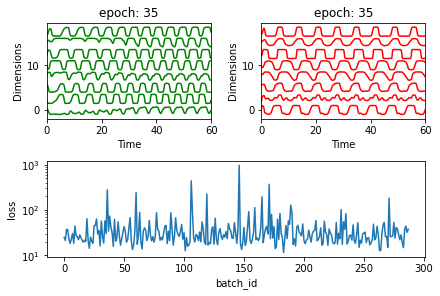

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.73581486  0.07616875 -0.62058543  0.88893583  0.94964918 -0.19960864
  -0.50117126 -0.58457296]
 [ 0.70061302 -0.04298923 -0.47978993 -0.62451696 -0.29899312 -1.69304972
  -0.69081437 -1.14968756]
 [ 1.15035708  0.35811568  0.86734946 -0.46695444 -1.14911607 -1.04994692
   0.4239118  -0.10433458]
 [-0.59684754 -0.62563834 -0.82346588 -0.06527798  0.95087124 -1.36555296
  -0.55318527 -1.47510178]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[-0.58344056 -0.0264389  -0.35883248  0.88048626  0.8641779   0.83977225
   0.27134019 -1.25796058]
 [ 0.39057706  0.11789734 -0.12730384  0.02010156  0.15040855 -0.02389514
  -0.02207832 -0.30714813]
 [-0.19779231  0.020158    0.01806238  0.19726438 -0.03265817  0.13009663
   0.1977333  -0.80598054]
 [-0.13400834  0.22123892 -0.02035726  0.45925413  0.18993918  0.18003953
   0.15639339  0.21756022]]


 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[ 0.13094205 -0.11437972 -0.20951722 -0.02535543  0.45152549 -1.31637962
  -0.25737427 -0.71511974]
 [-0.50330236  0.15820482  0.31771676  0.70532844  0.4806337   0.06872044
   0.362829   -0.3996887 ]
 [ 0.55974767 -0.01650189 -0.27254759 -0.63749404 -0.07141481 -1.21459242
  -0.43596136 -0.58878892]
 [ 0.41288657 -0.08428566  0.07266548 -0.71332117 -0.24870703 -1.48244976
  -0.37261977 -0.61731795]]


 38%|███▊      | 3/8 [00:02<00:04,  1.04it/s]

[[ 0.48845204 -0.34815097  0.3354069  -0.68890336 -0.32710738 -0.87688985
   0.35599729 -0.5278058 ]
 [ 0.26215076  0.16389649  0.08236519 -0.06807365 -0.09296753  0.18571629
   0.13801128 -0.46879449]
 [-0.56456835  0.10996752 -0.10563886  0.4413005   0.54739593 -0.18570003
  -0.07164186 -0.69818304]
 [-0.6523036   0.1853514  -0.31872336  0.27269181  0.45926751 -1.06086067
  -0.6252958  -0.60082313]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-0.18422515  0.40976503 -0.11621506  0.96182242  0.43118267  1.04690657
   0.05125954 -0.01625266]
 [-0.09978622 -0.08398483 -0.21389961  0.16632976  0.10727496  0.00175744
  -0.0359923  -0.80480958]
 [ 1.0165337  -0.36388913 -0.18473267 -0.75399191 -0.33399339 -0.90520125
  -0.02588068 -0.49878885]
 [ 1.1944379   0.30606664  0.35927395 -0.27387708 -0.50671847  0.45901615
   0.43113052  0.54799224]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[-1.80757392 -0.21826522 -0.3175226   2.24454586  1.77757153  2.35254269
   0.74941402  0.02674123]
 [-1.08165543 -1.20193242 -1.87081991 -0.24559269  1.32386082 -2.01606173
  -1.22811882 -2.86240302]
 [ 1.54812584  0.30467724  0.93968764 -0.81560112 -1.29598177 -0.53483709
   0.72481456  0.03264684]
 [ 0.03074526 -0.43273413 -0.19590767 -0.54736571 -0.05659531 -1.07221366
  -0.00560124 -0.72615547]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.10it/s]

[[ 0.1029282  -0.02054161 -0.5450177  -0.35929028 -0.07407166 -1.17345621
  -0.70476093 -1.18057453]
 [ 1.0551053   0.79503863  0.53828353  0.07408879 -0.78727176  1.21078194
   0.70434739  0.23183319]
 [-0.27579589 -0.42865754 -1.59555207  0.08408753  0.79193114 -1.40252738
  -1.26451258 -2.00908385]
 [ 0.68482036  0.43496865  0.84077047  0.35169666 -0.54015516  0.29214572
   0.77077242  0.46625226]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.11it/s]

[[ 0.6660197   0.20841675  0.00543648  0.26057204 -0.07747103 -0.93611053
  -0.15266753  0.01242807]
 [-0.58658474 -0.07954452 -0.52666385  0.81229662  0.72089805 -0.52077247
  -0.2088082  -0.97017814]
 [ 0.14948531 -0.29881021 -0.97595653 -0.41509352  0.31101791 -1.47889983
  -0.68438526 -1.71893349]
 [-0.33375867  0.86135262  0.35082424  1.75193785  0.513244    1.25583378
   0.48511367  0.77143187]]


100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


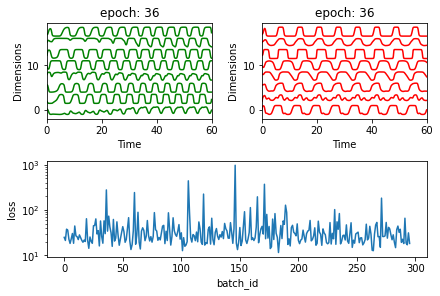

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.15395765  0.23455416  0.00494929 -0.04624442 -0.23318321 -0.16605721
  -0.02041388 -0.89801591]
 [-0.21655588  0.58916098  0.18639227  1.24901678  0.24888815  0.90987339
   0.42089698  0.32270621]
 [-0.89046326 -0.10901489 -0.54586052  0.54852345  0.90523606 -0.09124919
  -0.08197417 -1.37338511]
 [-1.51160467 -0.03026259 -0.34818398  1.77161342  1.51653704  1.49636318
   0.23203559 -0.36798331]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.06it/s]

[[ 0.5112797   0.26866592  1.08030517  0.04737269 -0.01946065 -0.11882346
   0.8917509   1.17963768]
 [-1.07300628  0.04439941 -0.16272366  1.54484182  1.15963506  0.11982495
   0.10817084 -0.25283707]
 [-0.36874943  0.58189338  0.23246518  1.16765461  0.135785    0.33381169
   0.03928928  0.30248092]
 [-0.69053751 -0.13254311 -0.61416863  0.93818985  1.09805746  0.75907537
  -0.03055792 -0.60343349]]


 25%|██▌       | 2/8 [00:01<00:05,  1.07it/s]

[[-0.67057469 -0.31858094 -1.0897048  -0.03020277  0.9516306  -2.16509611
  -1.1318038  -2.00632537]
 [-0.93544629 -0.12232898 -1.08243684  0.8801501   1.03302853 -0.22281031
  -0.70067697 -1.34772096]
 [ 1.66261889  0.50413203  0.897124   -0.46779665 -1.35203412 -0.37237517
   0.69387201  0.83420346]
 [-0.95766964  0.32464925  0.3131425   1.65129545  0.88921948  0.91583752
   0.48965748  0.51702126]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[ 0.39117064  0.13739604  0.64990848 -0.14667884 -0.44264531 -0.54155371
   0.44330252  0.14921606]
 [-0.17698197 -0.17508027 -0.67501775 -0.28244604 -0.03051496 -0.51739695
  -0.43087201 -1.1552214 ]
 [ 0.84304826 -0.06061055 -0.52707968  0.17719979 -0.04369089 -0.61442534
  -0.25503857 -0.88213418]
 [-0.03452953  0.22510398 -0.13391923  0.5473449   0.30041536 -0.36139847
  -0.11335248  0.15988526]]


 50%|█████     | 4/8 [00:03<00:03,  1.04it/s]

[[ 0.48967934 -0.3124155  -1.18455251 -1.05405782 -0.16298266 -2.41964713
  -1.27838902 -2.47777381]
 [-1.61233951 -0.3191651  -1.03544637  1.48233535  1.83282236  0.60330114
  -0.38280329 -0.59072743]
 [-0.56737738  0.34161276 -0.67344549  0.91319633  0.59429301 -0.12854742
  -0.28764816 -0.93567525]
 [ 0.36588232  0.21555245 -0.24431788  0.28380567 -0.00875062  0.51823246
  -0.03064778 -0.49008894]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[-1.00167825 -0.08338588 -0.90030746  1.18396166  1.30915066  1.19280408
  -0.22080858 -0.6210974 ]
 [-0.28146209  0.60389882 -0.10769264  1.08703105  0.54611553  1.35798579
   0.21258124 -0.28644206]
 [-0.70016925 -0.07591762 -0.39840966  0.31173092  0.44759089 -0.3161399
  -0.27488054 -0.9192021 ]
 [-0.3323532   0.13557245  0.13936964  1.09803017  0.3531126   0.17115584
   0.32777814  0.10801322]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.01it/s]

[[-0.02670801 -0.25062427 -0.72835056 -0.28010403  0.52568607 -0.81345159
  -0.42119643 -1.62827805]
 [ 0.87744072  0.71181773  1.11284101  0.21147059 -0.92162826  0.67496284
   0.95283482  0.73482541]
 [ 1.08716546  0.29843554  0.62749197 -0.68735306 -0.92613135 -1.15564543
   0.24401951 -0.45306784]
 [-0.55522895  0.24090491 -0.28401901  1.21219645  0.77268321  0.35317598
  -0.23847932 -0.24708194]]


 88%|████████▊ | 7/8 [00:06<00:01,  1.02s/it]

[[-0.62756236 -0.57524563 -1.42985059  0.07272074  0.99365648 -1.47467258
  -1.15852234 -1.91094061]
 [ 0.47287517  0.20760722  0.34304946  0.1400784  -0.32009086  0.42808776
   0.62339252 -0.2391988 ]
 [ 0.64987716  0.09248424 -0.0895572  -0.06490391 -0.27349539  0.0544892
  -0.01753378 -0.52092638]
 [ 1.0322262   0.07504094  0.40570325 -0.32820102 -0.52698603 -0.07746545
   0.43997596 -0.04601637]]


100%|██████████| 8/8 [00:02<00:00,  3.02it/s]


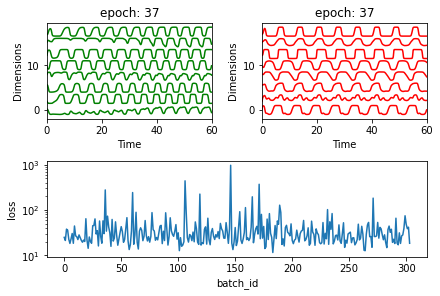

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.28683835  0.15299209  0.16930434 -0.52938642 -0.61712122 -1.33987424
  -0.17125707 -0.59789397]
 [ 0.08986682 -0.13554195 -0.62831809  0.39156492  0.54430821 -0.65836861
  -0.34617164 -0.85997836]
 [-0.37955871 -0.61735975 -0.18330766 -0.05698876  0.53431632 -0.77455338
   0.12806843 -0.96678663]
 [ 0.37484977  0.56848224 -0.46549459  0.30650252 -0.11033646 -0.01533745
  -0.54024581 -0.53892308]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.02s/it]

[[-0.25245369  0.09054706 -0.24164834  0.10340121  0.38999675 -0.84843844
  -0.26378276 -0.58207703]
 [-0.27796277 -0.05819564  0.09538624  0.2061416   0.26368301 -0.08693327
   0.27590119 -0.85347812]
 [-1.07043442 -0.89114055 -1.2527998   0.50582479  1.6996225  -0.45215135
  -0.47217587 -1.23208866]
 [ 0.17426766 -0.40944132 -0.63086628 -0.69723106  0.1150863  -1.24867811
  -0.52519642 -1.87734394]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.02it/s]

[[-1.08119492 -0.33107473 -1.38330444  0.98354292  1.41315598  0.84015563
  -0.62459217 -1.15693413]
 [-0.21941532  0.02224343 -0.12201239  0.52526875  0.3505308   0.15691126
   0.16826565 -0.16709199]
 [ 0.37371318  0.35678949  0.11189017  0.27990777 -0.45485777  0.63084124
   0.1964665  -0.3794074 ]
 [-0.62003449 -0.35312723 -0.43024255  0.28740089  0.73263553 -0.46681492
  -0.16890557 -0.86644507]]


 38%|███▊      | 3/8 [00:02<00:04,  1.04it/s]

[[-0.58358597 -0.12979443 -0.88686324  0.71034596  0.84081528 -0.15148437
  -0.39712098 -1.10899571]
 [-1.24461264 -0.41804136 -0.66095608  0.58742731  1.14980673 -1.06759024
  -0.47342908 -1.0890915 ]
 [-1.19131453 -0.64463904 -1.55645448  0.2624141   1.24162958 -0.52364249
  -0.90124438 -2.18244346]
 [ 0.15733326  0.63265374  0.30953929  0.69220413  0.18338013  0.3240401
   0.11719617  0.17262391]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 0.34682915  0.16724207  0.51274753  0.27987891 -0.14999202  0.85207002
   0.96245385  0.23330309]
 [-0.47612731 -0.06135261  0.0049835   0.6122117   0.64767453  0.772449
   0.41233903  0.19710811]
 [ 0.19578279  0.23535515 -0.04684769  0.45203583 -0.15686468  0.52642192
   0.24030779 -0.69588552]
 [ 0.138327   -0.11322326 -0.70327201 -0.84241603 -0.12238371 -1.95832789
  -0.91018282 -1.69478927]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[ 0.00360389 -0.17496615 -0.41022222  0.11651673  0.33214229 -1.24162404
  -0.38694913 -0.40750821]
 [-2.46084797 -0.35007851 -0.66636982  1.58911108  1.90287867  1.10324845
   0.043668   -0.59330925]
 [ 0.70727011  0.58584072  0.91066152  0.6068443  -0.48467666  2.05366949
   1.40418082  0.64939111]
 [ 0.4107897   0.14815077  0.21034811  0.40056006 -0.03347372  0.06094679
   0.47982245 -0.16211228]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[ 0.39784707  0.17130414  0.03472715  0.18400909 -0.27605293  0.00549952
   0.34719914 -0.42247865]
 [ 0.45789601 -0.08542543  0.14034564  0.19831396  0.03108741 -0.17914398
   0.41254379  0.32767512]
 [-1.16355749 -0.47942131 -1.36986715  0.66534292  1.38270829 -0.36695672
  -0.87970821 -1.83919635]
 [ 0.27199777  0.05546726  0.39055721  0.00388224 -0.38353493 -0.50617841
   0.25692641 -0.26759768]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[-5.50882758e-01 -1.50805850e-01  1.42925966e-01  6.18790415e-01
   4.46832406e-01  1.98790405e-01  4.56962096e-01 -2.78015229e-01]
 [ 1.66785973e+00  8.17364876e-01  1.90240702e+00 -9.46399182e-02
  -1.50165690e+00  1.26859868e+00  1.60379148e+00  1.21509054e+00]
 [-1.45271532e+00 -8.39367338e-01 -1.39232899e+00  3.45449324e-01
   1.80772299e+00 -1.05249597e+00 -9.30262392e-01 -1.73015745e+00]
 [-6.04879753e-04  2.21138980e-01 -1.20572913e-01  3.40305846e-01
   1.66315690e-01  1.38542517e-02 -1.75468449e-01 -8.03521743e-01]]


100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


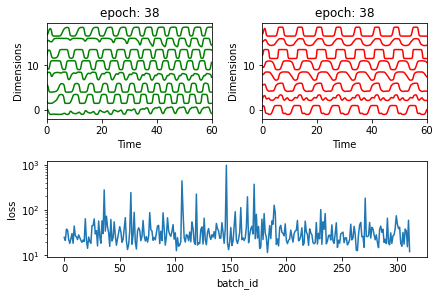

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-2.04146286 -0.24403415 -1.49699577  1.84434492  2.17248992  1.16069195
  -0.34257602 -1.47301967]
 [-1.32040021 -0.72885049 -1.16918667  0.83198317  1.76442301 -0.91448358
  -0.56122173 -1.45281042]
 [ 0.19041578 -0.1281156  -0.55225701 -0.26616127  0.14699775 -1.19958715
  -0.577478   -1.01844021]
 [ 0.05156616 -0.04593509 -1.23891864  0.15478189  0.57736941 -0.72159512
  -0.93125473 -1.85560122]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[-2.76828291 -1.03671404 -1.91866498  1.22867998  2.4687708  -1.16745572
  -1.04783689 -2.11645781]
 [ 0.00620138 -0.22944569 -0.25509784 -0.18764633  0.21574035 -1.57905018
  -0.32320637 -1.14129837]
 [-0.01047131  0.39529083  1.23105127  0.98262552 -0.03475393  1.33629211
   1.3749997   1.36811262]
 [ 0.52187841  1.00949596  0.94518771  1.36175431 -0.3117321   1.08936929
   0.65882561  1.39004465]]


 25%|██▌       | 2/8 [00:01<00:05,  1.10it/s]

[[-0.85283452 -0.23932767 -1.2742316   0.10938922  0.77078561 -1.78813313
  -1.30440019 -1.83607769]
 [ 0.77803904  0.55759917  0.60978854  0.18323088 -0.46130089  1.30341795
   0.82217702  0.32050904]
 [-0.49202032  0.4505024   0.11902029  1.42224623  0.8698229   0.87794674
   0.30407103  0.45168022]
 [-0.34274773  0.46452713  0.96001008  1.11674356  0.06975582  1.7057128
   1.29294121  0.80095735]]


 38%|███▊      | 3/8 [00:02<00:04,  1.11it/s]

[[-0.8975851   0.44112542 -0.25629923  1.80873142  0.76514924  1.4703264
   0.23281479 -0.36454298]
 [ 0.83597633  0.27598641 -0.12598486 -0.12722724 -0.41312986 -0.62548933
  -0.36934142 -0.30487884]
 [-0.18396561  0.00863868 -1.05049039 -0.11405751  0.49028917 -1.43617832
  -1.1236732  -1.93332172]
 [-0.05599217  0.4371195   0.17860892  0.66210405 -0.12864689 -0.35972719
   0.06110452 -0.43169166]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[ 0.60542272  0.19674936  1.1730498  -0.01927562 -0.77819939 -0.22943267
   0.9168029   0.91101927]
 [-0.61847602  0.01096361 -0.84887352  0.76821075  1.0619663  -0.56519245
  -0.52430189 -0.7765315 ]
 [-0.99094357 -0.2002202  -0.43119798  0.97057836  1.13754782  0.20861866
  -0.01636126 -0.45837669]
 [ 0.0822973   0.21206142  0.39730425  0.3219298   0.03812029  0.17988762
   0.52445472 -0.08222662]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[ 0.92174955  0.64195942  0.85322739  0.46245446 -0.60466481  0.96796295
   0.91524684  0.839264  ]
 [-0.40467432  0.00625904 -0.64405249  0.66599105  0.74363561 -0.38868537
  -0.3174417  -0.84933362]
 [-0.13792527  0.26123277 -0.47904469  0.31094809  0.31400362 -0.46298018
  -0.41150645 -1.11028236]
 [ 0.10991342  0.07566424 -0.27595419  0.41441303  0.33256953 -0.63929396
  -0.29502972 -0.5216574 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.10it/s]

[[ 1.02736539  0.02029071  0.39610874 -0.96839506 -1.01812209 -1.38276692
   0.03732235 -0.52124733]
 [ 0.4410282   0.60130817  1.41347408  0.46710352 -0.41598778  1.1193861
   1.41785061  1.22879121]
 [ 1.71381153  0.55766718  0.7436564  -0.71475448 -1.88394726 -1.07898981
   0.36833152  0.58679793]
 [-0.17691977  0.48237961 -0.05378071  0.98495341  0.4746      0.96020488
   0.20436172 -0.16995154]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.11it/s]

[[-0.04248107  0.21549863 -0.53525163  0.5396501   0.21631129 -0.31031495
  -0.28533345 -0.45777868]
 [ 1.41471066  0.90191242  1.0140652   0.15265611 -0.86799705  0.5135483
   0.75617016  0.69733955]
 [ 0.07210545  0.19305134 -0.21630262  0.46774929  0.09761249  0.3044358
   0.04608409 -0.4123594 ]
 [-1.15049401 -0.34157542 -0.4446999   0.89014367  1.15477429 -0.41896878
  -0.12047943 -0.45011798]]


100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


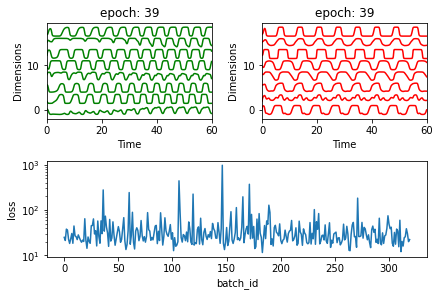

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-4.51333833e-01 -7.25767322e-01 -6.10738580e-01 -2.52493863e-01
   5.50994984e-01 -1.48428305e+00 -3.27563661e-01 -1.47466155e+00]
 [ 1.05764049e+00  6.46699475e-01  1.16380061e+00 -1.39296845e-01
  -1.02259899e+00  4.62719734e-01  9.78951421e-01  2.75366981e-01]
 [ 7.06353742e-02 -1.27758560e-01 -2.62537877e-01 -1.78552695e-01
   8.76264234e-02 -1.05732516e+00 -2.01936519e-01 -8.09385988e-01]
 [-2.87035081e-01  2.18417111e-02  1.23193175e-03  4.99932714e-01
   3.57249410e-01  5.65006926e-01  2.91398494e-01 -2.82573776e-01]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.05s/it]

[[ 1.06259409  0.4152574   0.68139791 -0.01462803 -0.69073018  0.23138794
   0.59919683  0.15896539]
 [ 0.19701958  0.9536338  -0.0219905   1.55945151  0.30026362  1.56656718
   0.24020308 -0.05889143]
 [ 0.47022348  0.0806885   0.10690305  0.24066375 -0.16170778 -0.59253116
   0.09549888 -0.3642525 ]
 [ 1.13855218  0.97816639  1.06143284  0.61531573 -1.00773853  1.3064379
   0.8663217   1.02949349]]


 25%|██▌       | 2/8 [00:01<00:06,  1.01s/it]

[[ 1.03916676  0.88874369  0.90363528  0.43295438 -0.93417887  1.20432992
   0.85620292  0.6219493 ]
 [ 1.73648368  0.04433983  0.78592659 -1.30980715 -1.17589548 -0.95627467
   0.48485087 -0.22253612]
 [ 0.32545648 -0.03840462 -0.07488259  0.27162231  0.05769393 -0.0441646
   0.2647258  -0.3814016 ]
 [-0.87285624 -0.07805662 -0.6324475   1.21257729  1.17788551  0.62677234
  -0.01642936 -0.69237156]]


 38%|███▊      | 3/8 [00:02<00:05,  1.00s/it]

[[ 1.2743185  -0.10973996  0.78488635 -1.28793139 -0.73694756 -1.8860647
   0.30057286  0.14219833]
 [-0.31341852  0.25904219  0.38553032  0.57640821  0.47443978  0.43732203
   0.49911438  0.19913992]
 [-0.58522543 -0.15248587 -0.60114602  0.54251085  0.65103783 -0.51566893
  -0.39500491 -0.92769888]
 [-0.02158731  0.63480974  0.01579757  0.66169076 -0.2402638   0.65245804
   0.20208495 -0.33187989]]


 50%|█████     | 4/8 [00:04<00:04,  1.03s/it]

[[ 0.46556229 -0.1316864  -0.28700447 -0.76241618 -0.264427   -1.18824177
  -0.44694894 -0.9693944 ]
 [ 1.28787262  0.23994271  1.1497746  -0.59173137 -0.98480552 -0.32112722
   0.84120271  0.83001356]
 [ 0.74153468 -0.03660183  0.05318789 -0.44163537 -0.43096195  0.06142594
   0.3629381  -0.70814229]
 [ 0.51577223  0.07014698  0.69364887  0.08872929  0.06357738  0.6036978
   0.85501532  0.90939243]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.08s/it]

[[-0.18488074  0.0229297  -0.26633149  0.38837509  0.57720846  0.33647312
  -0.01496485 -0.24232085]
 [-0.11926124  0.25912943 -0.43114887  0.47358223  0.1679052  -0.84807635
  -0.43201454 -0.79911797]
 [-0.94816159 -0.405053   -0.47486765  0.8819274   0.99636665  0.30541184
   0.08278757 -0.56285008]
 [ 1.74025993  0.30836495  1.37957248 -0.77168934 -1.40921545 -0.6900343
   0.80502899  0.93617645]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.15s/it]

[[ 0.48573505 -0.11073607  0.27659016 -0.64854595 -0.44605966 -0.75100116
   0.25606297 -0.48943757]
 [-1.76358488 -0.3526406  -0.95815322  1.64291737  1.6852911  -0.21420814
  -0.5709815  -1.03111385]
 [ 0.75828882  0.34064914  0.30345939  0.05497373 -0.31152972 -0.96558327
   0.06796969  0.43780865]
 [ 2.22288143  0.80487742  0.77367152 -0.5823605  -1.68259711 -0.76037417
   0.42898294 -0.04266131]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.16s/it]

[[-1.66244166 -0.07886287  0.07877706  1.86694578  1.49805135  1.64484898
   0.62191529 -0.07477201]
 [-0.88483357 -0.00955278  0.05287864  1.20771931  1.11682736  1.35990934
   0.61297286  0.16019313]
 [-2.12957681 -0.04842037 -0.79613861  2.17201815  2.01688705  1.12671679
  -0.27174024 -0.72032929]
 [-1.37107989 -0.75205273 -1.64290717  0.80111211  1.68716569  0.09006485
  -0.69800743 -1.82986301]]


100%|██████████| 8/8 [00:02<00:00,  3.17it/s]


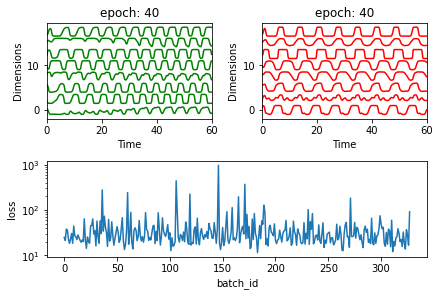

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.97808614  0.01838409 -0.24783917  0.96137568  0.98030884  0.66596191
   0.12218338 -0.54323364]
 [-0.99556506 -0.44232713 -0.82047528  0.74908523  1.48844794 -0.06007091
  -0.197067   -0.88911516]
 [-1.03900898 -0.22174177 -0.92031408  1.3354377   1.22561454  0.10123018
  -0.36974725 -0.82113739]
 [-0.90973221  0.18335343 -0.09891899  1.1790644   0.74492203  0.46738108
   0.0787059  -0.51532918]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.19s/it]

[[ 0.06688384  0.49962218  0.33052599  0.65590491  0.14714534  0.20481261
   0.39939497 -0.18846792]
 [-0.72431434  0.01400663 -1.06456219  0.56738599  0.86394798 -1.04476359
  -1.05906074 -1.55157713]
 [ 1.58237262  0.2426375   0.49981328 -0.72430137 -1.12458743 -0.81590604
   0.23969286 -0.46358694]
 [-0.32387903  0.21747488 -0.00677058  0.51831675  0.38168811 -0.62702062
  -0.09442216 -0.2517987 ]]


 25%|██▌       | 2/8 [00:02<00:07,  1.18s/it]

[[-0.73406486 -0.77346239 -0.87139206 -0.20843621  0.95249782 -1.43649182
  -0.52620864 -1.54551074]
 [ 1.14085504  0.69066417  0.77117867 -0.16520791 -1.04686844 -0.10586633
   0.34227528  0.17248787]
 [ 0.11279325  0.238302   -0.08167477 -0.09177982 -0.05587261 -0.0506313
  -0.05472562 -0.64682901]
 [-1.13769249 -0.1366047  -0.98334322  0.60857292  1.2056882  -0.1680057
  -0.58601256 -1.51773853]]


 38%|███▊      | 3/8 [00:03<00:05,  1.13s/it]

[[-0.65889603 -0.12612718 -0.76201063  0.6949645   0.94882436  0.01354301
  -0.22972197 -0.95705938]
 [-0.04538315 -0.78590704 -1.12167336 -0.49810433  0.55190604 -1.11545489
  -0.69179019 -1.58411326]
 [ 0.17031226 -0.10303581 -0.58051767 -0.34465568 -0.18791835 -1.24777012
  -0.63533463 -1.70479016]
 [ 0.4612343   0.04317953 -0.23787604 -0.17928456 -0.28483137 -0.2640344
  -0.106848   -0.25085812]]


 50%|█████     | 4/8 [00:04<00:04,  1.06s/it]

[[ 0.82053234 -0.01199682  0.64207183 -0.31945835 -0.75798658 -0.95502813
   0.54747127 -0.41610843]
 [ 0.64007955 -0.05558179 -0.31095173 -1.1267077  -0.62221636 -1.89529078
  -0.70971672 -1.88636128]
 [ 1.01734295 -0.16788675 -0.59507538 -0.93686235 -0.26199203 -1.75753533
  -0.60785082 -1.48329122]
 [-0.29143779  0.20995617 -0.12160809  0.44882207  0.22249596 -0.12756195
   0.17294385 -0.60808384]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.01s/it]

[[-1.49468871 -0.08000314 -0.1973912   1.39726422  1.043165    0.59618288
   0.10274697 -0.04418656]
 [ 1.04690406  0.80203147  0.99287013  0.1510598  -0.6640991   0.53634784
   0.61246122  0.92153188]
 [-0.46779349 -0.7140366  -1.74738217 -0.24031251  0.92009233 -0.86744425
  -1.05230173 -2.78633678]
 [-0.39796636 -0.26642497 -1.17210857 -0.46912271  0.36791897 -1.39782063
  -1.22133893 -1.86178131]]


 75%|███████▌  | 6/8 [00:06<00:01,  1.02it/s]

[[ 0.36935913 -0.29406572  0.06930588 -0.44869609 -0.08853305 -0.91668007
   0.13915905 -0.73033658]
 [-0.16544614  0.26776594  0.08966269  0.50269945 -0.01572172  0.14139026
   0.09974292  0.10564029]
 [-0.69298141 -0.29013857 -0.19807732  0.63456457  0.93522345 -0.58105081
  -0.00612421  0.32197787]
 [ 2.1197176   0.42146606  0.481177   -0.94053722 -1.2796977  -0.474795
   0.05907003  0.07660394]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[-0.27320317 -0.25469249 -0.41378845  0.01744387  0.37685535  0.39122913
  -0.00459758 -0.15590307]
 [-0.87252649 -0.31150983 -0.96124762  0.19708567  0.80111681  0.10313148
  -0.42871573 -1.52038484]
 [ 0.13960134  0.60026385  1.05289686  0.99606799 -0.34100956  1.37832812
   1.17467529  0.82831189]
 [ 0.44786789  0.47478754  0.39302705  0.46481146 -0.14435138  0.34428841
   0.38370155 -0.28952518]]


100%|██████████| 8/8 [00:02<00:00,  3.24it/s]


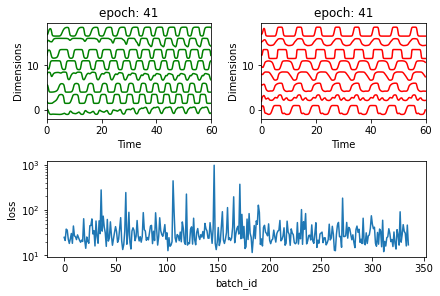

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.63495094  0.50052452  1.09335343  0.30671819 -0.54350045  0.97681489
   1.18359606  0.88970985]
 [-0.71869864 -0.0224755  -0.59295366  0.89502115  0.9693726   0.1622093
  -0.27691065 -0.86612821]
 [ 0.15280772 -0.4560956  -0.47853971  0.15196101  0.64367918 -1.33398557
  -0.36844573 -0.46026557]
 [-1.02225799 -0.27196701 -0.71081964  0.91720812  1.07768591  0.68154393
  -0.11876443 -0.69901775]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.07it/s]

[[-0.72884528  0.11852631  0.06230117  1.07673585  0.54546963  0.78529655
   0.45783237 -0.42927394]
 [-0.97420928 -0.23337253 -0.8995123   1.08507387  1.30667685 -0.08462542
  -0.38572805 -0.94108409]
 [ 0.9107955   0.0472488  -0.17384882 -0.00666692 -0.17263364 -0.45099938
  -0.17453964 -0.34522161]
 [ 1.37264256  0.23406842  0.34576409 -0.76519399 -0.75338639 -1.05795083
   0.09910282 -0.08813394]]


 25%|██▌       | 2/8 [00:01<00:05,  1.09it/s]

[[-1.48859075 -0.15033716 -0.96555121  1.43504512  1.55646101  0.96606071
  -0.20399848 -1.20465532]
 [-2.02216939 -0.59677772 -1.96211188  1.24775524  2.12139842 -0.91912546
  -1.18831672 -2.22080319]
 [-0.50835213  0.56593304  0.66227171  1.80388998  0.55231013  1.74718733
   1.11940537  0.4528903 ]
 [ 0.2717339   0.65552744  1.22736063  0.72410705 -0.3294814   0.4591323
   1.03192511  0.9431661 ]]


 38%|███▊      | 3/8 [00:02<00:04,  1.09it/s]

[[ 0.83261973  0.1944883   0.72746689 -0.65077384 -0.6359391  -1.48974809
   0.1852749   0.27483589]
 [-0.45708252  0.25020372  0.09938029  0.91300135  0.38327948  0.38901174
   0.33751551  0.18540026]
 [-0.27816832  0.28570854  0.26122363  0.68084056  0.36097016  0.61598132
   0.39499118  0.06090132]
 [-0.89851633 -0.51680209 -0.91092707  0.15568323  0.94791962 -1.54836271
  -0.74340586 -1.86656822]]


 50%|█████     | 4/8 [00:03<00:03,  1.09it/s]

[[-0.12382385  0.21779066 -0.01532114  0.42313118  0.13708252 -0.19518545
  -0.10163216 -0.38153464]
 [-0.41687302  0.32722999  0.27170597  1.05058358  0.54044889  1.11788441
   0.53400058  0.24174691]
 [ 0.13009473 -0.13857492 -0.00373211  0.11817868  0.32825299  0.06142192
   0.21899534 -0.52720393]
 [ 1.04063701  0.21687806  0.09499318 -0.44285864 -0.69184625 -0.2034368
   0.05203337 -0.22490992]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[-1.57516825 -0.80452482 -2.03037124  0.59792954  1.7637885  -1.71772646
  -1.40385592 -2.45507788]
 [ 0.96874761 -0.1175887   0.46145321 -1.02390845 -0.71334027 -1.21155528
   0.26520707 -0.60572254]
 [ 1.04006387  0.86661542  0.73300922 -0.01645817 -0.76161264  1.30317838
   0.65534595  0.5205984 ]
 [ 0.97353679  0.41625444  1.43603166 -0.02455352 -1.10860526  1.06907018
   1.30311272  0.38721299]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[-0.83395263 -0.24712484 -0.02511289  0.7352793   0.65222597 -0.85437105
   0.12740604 -0.23988045]
 [-1.7276069  -0.46017067 -2.07075673  1.33995834  2.02593895 -0.51867317
  -1.27271512 -2.07917655]
 [ 0.30351216  0.37977053 -0.19936955  0.80949842  0.17436377  0.71211573
   0.12891052 -0.07046943]
 [-0.11587614  0.52029734 -0.00439703  0.81029227  0.0527779   1.2388599
   0.30913809 -0.29885331]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-0.08776798  0.01765112  0.51930475  0.32780643  0.01995699 -0.81438477
   0.48234823  0.58837299]
 [ 0.42249699  0.36150287 -0.08503887  0.0357653  -0.42073065  0.05763005
  -0.09832321 -0.46397249]
 [ 0.02475578  0.04169816 -0.18154201  0.36939138  0.12831438  0.1904768
   0.07228078 -0.74964761]
 [ 0.13492675 -0.23615267 -0.40011623  0.12548211  0.50708289  0.01373019
   0.05482598 -1.17284163]]


100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


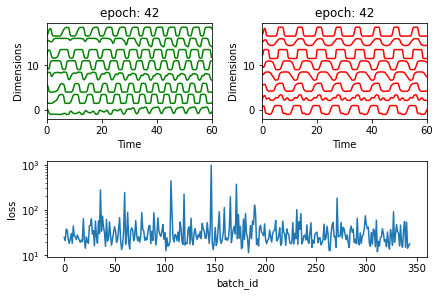

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.29482757 -0.49418054 -1.45714988  0.55257142  0.86849285  0.37436874
  -0.46544805 -2.08840866]
 [-0.19180043  0.40713463  0.06570604  0.68146977  0.28146785  0.25550786
   0.09383805  0.1427583 ]
 [-0.13917008 -0.27275176 -0.75410056 -0.2644562   0.41294751 -1.22656318
  -0.67455618 -1.33050503]
 [ 0.73628293  0.16008624  0.14756592 -0.46550139 -0.72217649 -0.46480011
   0.23647494 -0.59425713]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.00it/s]

[[-0.78422388 -0.20076455 -0.67435971  0.96509915  0.86036149  0.48028437
  -0.13149427 -0.22133608]
 [ 1.49221052  1.15354107  1.4086962   0.23695993 -1.45047771  1.49665906
   1.11284811  0.92621579]
 [ 0.34696766  0.28581542 -0.74785039 -0.00367262 -0.32508208 -0.80694752
  -0.78287899 -1.21797928]
 [-0.13297122  0.23071332 -0.19197892  0.52712597  0.3191254  -0.46240624
  -0.07982974 -0.51297085]]


 25%|██▌       | 2/8 [00:01<00:05,  1.01it/s]

[[ 0.76944603  0.24580162  0.47549953 -0.03734256 -0.40921363 -0.00852455
   0.52317842  0.15204689]
 [-0.15537521  0.33769014  0.51394968  0.67976324 -0.04595306  1.24980348
   0.65867854  0.28809153]
 [ 1.69549014 -0.02413696 -0.20013534 -1.59820519 -0.91815097 -1.71679754
  -0.4134445  -1.26428459]
 [-0.74524035 -0.1863551  -0.32707026  1.02894131  1.01866896 -0.06717658
   0.07862496 -0.64752293]]


 38%|███▊      | 3/8 [00:02<00:04,  1.03it/s]

[[-0.49321233  0.22890965 -0.1435808   0.90901854  0.55598334 -0.25515767
  -0.11142441 -0.044933  ]
 [-0.40372003 -0.65511229 -0.75018047 -0.10064502  0.92229854 -0.55397664
  -0.24948639 -1.37830229]
 [-1.0243706  -0.14796434  0.04564826  1.10802582  1.02968139 -0.05146911
   0.17561002  0.00893962]
 [-1.19893106 -0.33689788 -0.93861455  0.97782562  1.38457775 -0.59306975
  -0.59301764 -0.90997176]]


 50%|█████     | 4/8 [00:03<00:03,  1.05it/s]

[[ 0.82917933  0.95766194  1.55608099  0.59073999 -0.84341806  1.02936913
   1.20778842  1.87584433]
 [ 0.33653853 -0.15435984 -0.36972755 -0.542696   -0.1996833  -1.12927574
  -0.30421495 -1.63528984]
 [ 0.20978364  0.39641445  0.12516455  0.80840497  0.20123244  1.82792835
   0.57327694  0.01773647]
 [-1.77565213  0.01050431 -0.26483813  1.91505184  1.43295247  1.29377618
   0.3142631  -0.03379672]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[ 0.04309552  0.24736149 -0.22990461  0.52159841  0.46279484  0.45264268
   0.18837403 -0.50097815]
 [ 0.70896667  0.5195044   1.23194609  0.43860764 -0.57764363  1.30404558
   1.16943612  0.67409844]
 [ 0.29849726  0.36110551 -0.17668808  0.62537492 -0.14976528  0.01530174
  -0.18785455 -0.30779046]
 [-1.0869169   0.09762256 -0.36281986  1.66779341  0.85262417  1.08595826
   0.11869352  0.04484243]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[-1.20677969  0.25068559 -0.33614518  1.79388844  1.03486903  1.26955999
   0.23844805 -0.37517891]
 [-1.71201003 -0.64569975 -1.25534707  1.22839187  2.13827804  0.10586232
  -0.54877603 -1.32333377]
 [-0.16942488  0.25024607  0.59032331  0.39815177  0.1206982   0.61218079
   0.68532885  0.19635307]
 [ 0.66094581  0.61503577  1.3193015   0.2682582  -0.56302476  0.81490897
   1.12048113  0.85715911]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-1.15274789  0.67795658  0.91860044  2.3400536   1.15828948  3.366769
   1.52302882  1.41831529]
 [-1.14063881 -0.28149262 -0.80979313  0.97927509  1.14004421 -0.18669182
  -0.31839462 -0.91442411]
 [-0.2524618   0.22280034 -0.11633455  0.7183093   0.57696043  1.20645049
   0.13932432 -0.14207795]
 [ 0.17188287 -0.17196847  0.27546847 -0.33156423 -0.05086926 -1.25475755
   0.04950631  0.24662807]]


100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


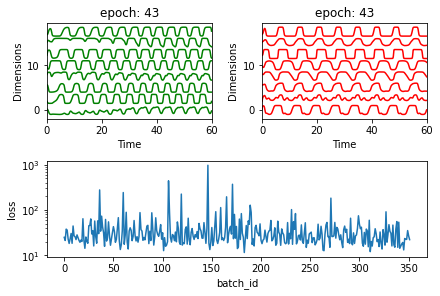

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.27221614  0.75106137  0.26523027  1.02317539 -0.13665063  0.78433191
   0.36535588  0.28688084]
 [ 0.55839167  0.59819793 -0.00974846  0.31634341 -0.60756144 -0.43918794
  -0.35092408 -0.3823313 ]
 [ 1.15419571  0.27998458  0.01594993 -0.89684013 -0.8106472  -1.36273479
  -0.28081632 -0.64003725]
 [ 0.04798658 -0.05793651  0.07827164 -0.32743587  0.05712797 -1.00604391
  -0.02508994 -0.50152364]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[-0.29080047 -0.27352697 -0.98352803  0.01307102  0.28033104 -1.39859032
  -0.6560308  -1.10222554]
 [ 0.81819829  0.06175969  0.29253638 -0.666686   -0.34813071 -0.55250511
   0.29957424 -0.49451628]
 [-0.92290615 -0.5120503  -1.76947407  0.14697513  1.23171462 -1.41564626
  -1.43271027 -2.63900872]
 [ 0.70587862 -0.61119203 -0.11527383 -1.23175116 -0.27614002 -2.37389945
  -0.26028389 -1.26266063]]


 25%|██▌       | 2/8 [00:01<00:05,  1.10it/s]

[[ 1.28323814e+00  2.62849681e-01  6.87550750e-04 -6.11991119e-01
  -8.93988144e-01 -1.13962165e+00 -3.22656281e-01 -4.62337843e-01]
 [ 4.85921728e-01 -3.96564010e-01 -6.99940293e-01 -1.07078896e+00
  -2.60368446e-01 -1.46461594e+00 -6.53185301e-01 -1.10525856e+00]
 [ 2.72472773e-01  2.63481057e-01  5.26557409e-01  2.01585078e-01
  -1.64183118e-01 -3.38256184e-01  3.78161490e-01  1.30610446e-01]
 [ 8.68529644e-01  5.29594118e-01  7.93503366e-01 -2.98020768e-01
  -9.84948103e-01 -5.72113079e-01  4.19687905e-01  8.12178969e-02]]


 38%|███▊      | 3/8 [00:02<00:04,  1.11it/s]

[[-0.05246984 -0.10149442 -0.78436058  0.07081322  0.44573801 -0.81492652
  -0.6353998  -1.4554232 ]
 [-0.28132744 -0.07322371  0.27572657  0.50959795  0.43169124  0.43546669
   0.59818495  0.22303093]
 [ 0.94901551  0.29645074  0.2336025  -0.56669121 -0.97557416 -0.90047103
  -0.03989353 -0.3908627 ]
 [ 1.03251128  0.9376322   1.78185631  0.7589527  -0.65290632  1.93536743
   1.44699871  1.99882703]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[-0.51567122 -0.28664805 -0.47932711  0.05269112  0.5511453  -0.1846346
  -0.11895451 -1.11007447]
 [ 0.2936909   0.43030606  0.8298159   0.41079665 -0.47382114 -0.42185192
   0.4816164   0.48077734]
 [-0.55173769  0.11829066 -0.07537169  1.14939139  0.50193791  0.28227371
   0.29931622  0.08210363]
 [ 1.11245786  0.61635168  1.33876357 -0.39299852 -1.10105984 -0.45597551
   0.77823261  0.58520472]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.10it/s]

[[ 0.1031674  -0.03414286  0.19953488 -0.2729569  -0.47274949 -0.37861367
   0.18742173 -0.6196894 ]
 [ 1.62541786  0.62469509  1.63930504 -0.64641558 -1.75733031 -0.04300137
   1.13634357  1.00140958]
 [ 1.08302063  0.31225807  0.80366294 -0.48661186 -0.82228011 -0.06980538
   0.61163761  0.09470126]
 [-0.6219743  -0.12749691 -0.44507752  0.772335    0.90868988  0.56101261
   0.06577431 -0.66954875]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.11it/s]

[[ 0.09000065  0.06484631 -0.58682142  0.21067619  0.43823305 -0.56128379
  -0.53148266 -0.82649614]
 [ 0.63738908  0.34482616  0.42998164 -0.05848296 -0.40194784  0.63562415
   0.58081916 -0.39539891]
 [ 0.48078931 -0.35610299  0.08131396 -0.64466441 -0.13050854 -0.8053045
   0.29779121 -0.3053842 ]
 [-1.40122359 -0.19066398 -1.50568182  1.4755176   1.53589985  0.81461224
  -0.84163423 -1.39319679]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.10it/s]

[[ 0.7192961  -0.0637114  -0.14979969 -0.51918459 -0.37649758 -1.77244989
  -0.37676718 -0.6136625 ]
 [-0.23730747 -0.35750812 -0.36205286  0.02679753  0.50177267 -0.97167682
  -0.17324153 -1.03306046]
 [-0.33532519  0.54967926  1.9203512   1.81317122 -0.03664523  3.82856961
   2.52124428  2.36828007]
 [-0.53646264 -0.36990713  0.14549459  0.50562015  0.53420371  0.09930786
   0.54544697  0.1350855 ]]


100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


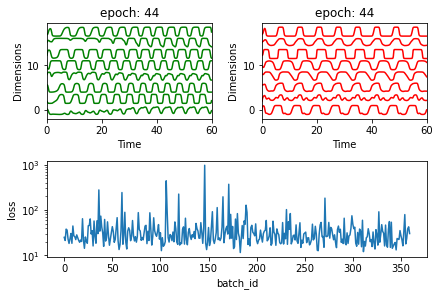

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.87266252  0.40560822  0.96344603 -0.07673053 -0.60933524  1.8163228
   1.23824254  0.45372404]
 [-0.09601675  0.59576523  0.42551337  1.04649249  0.2981117   0.88553164
   0.60043583  0.14345595]
 [ 0.45833055 -0.12658047 -0.68516784 -0.62760551 -0.05844368 -0.77326589
  -0.53781939 -1.39386935]
 [-0.43059965  0.67086855  0.69019302  1.11242516  0.33502372  0.86547552
   0.70852005  0.48066083]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.02s/it]

[[ 0.74308017  0.12026844  0.38240565 -0.15099479 -0.49301359 -0.17297727
   0.39415374  0.27124688]
 [-0.62290084 -0.71535823 -1.03196367  0.00437943  0.97773432 -0.35809661
  -0.23564351 -1.99129228]
 [ 0.01747024  0.37877625  0.41683946  0.07912276 -0.213995    0.59716505
   0.29108517 -0.13486158]
 [-1.83504572 -0.61435437 -1.18430464  1.16888926  1.83736422 -0.51037434
  -0.599288   -1.32520835]]


 25%|██▌       | 2/8 [00:01<00:05,  1.02it/s]

[[ 0.23976957  0.5723651   0.56628636  0.08096499 -0.38270411  0.12679708
   0.31677282 -0.06167931]
 [ 0.18274992  0.94651291  0.65836311  0.42938706 -0.59758055  0.76693798
   0.4678907   0.41580278]
 [ 0.77717991  0.3875852   0.64544975 -0.18789298 -0.57760135  0.55725361
   0.6437753   0.17027013]
 [ 0.7814985   0.34185865  0.35679399  0.13771445 -0.18663099  1.31644165
   0.60630072  0.23673664]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[-0.15743408  0.75184438  0.20774476  1.41501285  0.23860385  1.36271288
   0.53050292 -0.01375876]
 [ 1.11581704  0.33161304  0.33571393  0.18307333 -0.48345322  0.59969719
   0.66706029  0.18850348]
 [ 0.38353249  0.01588992  0.30949377 -0.08114538 -0.3310892  -1.32047092
   0.1213055  -0.48904986]
 [ 0.14752708  0.34818192  0.3748993   0.94617192  0.12214177  0.89009225
   0.60156044  0.22690713]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-0.80750879  0.12736205 -1.27198481  0.93880767  0.94464534 -0.24393563
  -0.9808465  -1.33548688]
 [-0.40512051  0.16382444 -0.16135844  1.06336273  0.54076098  0.62893461
   0.20196975 -0.68012363]
 [-0.18547665 -0.06579868 -1.11561321  0.1678888   0.58754424 -0.07173821
  -0.68145253 -1.42026894]
 [-0.22837174  0.51670886  0.39008549  1.04229106  0.19096474  1.65293462
   0.75241132  0.16946105]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[ 0.64736106  0.22559363  0.13011199  0.14225466 -0.20913987  0.91818754
   0.54291457 -0.35446164]
 [-0.51022408  0.13159573 -0.65846803  0.77849783  0.62833694 -0.78202317
  -0.6302338  -0.8820071 ]
 [-0.62822871 -0.08236183  0.12356936  0.49010916  0.58340829  0.841578
   0.64360401 -0.42461957]
 [ 1.15308391  0.40538613  1.08796336 -0.21139155 -1.14091526  0.75262021
   1.18404768  0.54661171]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[ 0.37030916  0.32685249  1.03219956  0.30843397 -0.34609704  0.22125627
   0.86031547  1.22280046]
 [-1.25124297 -0.08166468 -0.18975805  1.45683773  1.26656789  1.23975697
   0.29244234  0.26480689]
 [-0.01759584 -0.52053124 -0.91168351 -0.57845045  0.17397511 -2.21498929
  -0.93808428 -1.82559943]
 [-1.56326566 -0.10617986 -0.7564456   2.23459817  1.95563992  0.89779036
   0.16360233 -0.48117206]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[-0.68147976  0.00229913 -0.96631896  0.51909496  0.78260158 -0.01960492
  -0.73574492 -0.99919538]
 [-0.23261563 -0.1354824  -0.73337306  0.2663915   0.20153523 -0.96969338
  -0.57899672 -1.79936197]
 [ 1.19003573  0.78150878  0.66236196 -0.00558496 -0.7738978   0.87909432
   0.72431596  0.2387597 ]
 [-0.11371799 -0.55490616 -1.09788581 -0.54488739  0.5160181  -0.56893873
  -0.6671819  -1.92033934]]


100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


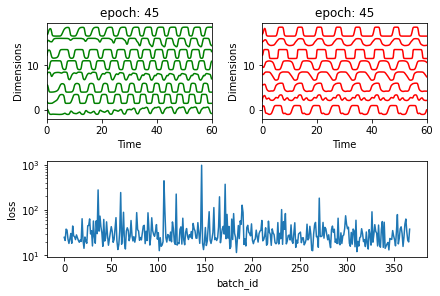

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.43637735  0.39382556  0.89006467  0.76108425  0.16261089  1.10565354
   1.16366101  0.43146718]
 [ 0.88859143 -0.04005677  0.05660193 -0.32471941 -0.27374267 -0.08356702
   0.32870217 -0.21850886]
 [ 0.3975871  -0.01296437 -0.34490192 -0.39658357 -0.097881   -0.39516427
  -0.25941221 -0.63526821]
 [-0.89213088 -0.19159796 -0.2766315   0.66774968  1.08360943 -0.11831513
  -0.07595361 -0.38735749]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.02it/s]

[[ 0.99188947 -0.19918617  0.33199922 -1.01105946 -0.7302879  -0.92383693
   0.26846657 -0.39215136]
 [-0.47957349 -0.04136543 -0.06165057  0.42459284  0.3937869  -0.30971113
  -0.02269634 -0.1600865 ]
 [-1.10730116 -0.50925908 -0.92047761  0.57988764  1.24760428 -1.19925405
  -0.58425873 -0.72334375]
 [ 0.38571089  0.37392078  0.17742395 -0.43788376 -0.32729208 -0.94223077
  -0.16222218 -0.65238647]]


 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[ 0.77158559  0.59243854  0.9986478   0.15682584 -0.76838334  1.10547787
   0.96432832  0.05744864]
 [ 0.22680776  0.09874335  0.22545204  0.34569418  0.20871442  0.06245476
   0.55869736 -0.19562024]
 [ 0.5567388   0.28106199  0.16659754 -0.22179369 -0.54497501 -0.01774784
   0.16885814 -0.46712119]
 [ 0.08856915 -0.44891827 -0.76558062  0.0172517   0.85058342 -1.50170687
  -0.51723495 -1.29282997]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[-1.75898419e-01  1.09759463e-01  3.57715563e-01  1.09443113e-01
  -1.09340775e-03 -7.81055841e-01  2.02941794e-01  8.34757083e-03]
 [-1.27157887e+00 -2.80641679e-01 -1.10505116e+00  7.86358821e-01
   1.33323299e+00 -3.54600265e-01 -7.41325416e-01 -1.27994535e+00]
 [-1.74914595e-01 -4.48270033e-01 -8.37547723e-01  3.61306594e-02
   5.27670424e-01 -2.86626208e-01 -2.79156097e-01 -1.51652682e+00]
 [ 5.10307570e-01 -6.74416462e-02 -6.40621342e-02 -2.99798605e-01
  -2.33939773e-01 -5.87856302e-01  3.30746655e-03 -7.22214390e-01]]


 50%|█████     | 4/8 [00:03<00:03,  1.05it/s]

[[-2.13166577 -0.30235847 -1.04299677  1.6464149   2.05030544  0.77554559
  -0.16571113 -1.00032333]
 [ 0.13621701 -0.28677263 -0.75065042 -0.18393994  0.41476917 -0.92828945
  -0.51548609 -1.20628327]
 [-1.12119604 -0.52023766 -1.27041283  0.72215552  1.52056446 -0.15899012
  -0.56314203 -1.71814834]
 [-0.93588747 -0.09436427 -0.44767854  0.95084446  0.88111324  0.05247257
   0.03029822 -0.9707022 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[ 0.94621762  0.55621405  1.15428247  0.02436562 -0.69621211  1.09676255
   1.06049117  0.31690063]
 [-0.14841629 -0.29357856 -0.66688214  0.08038175  0.31495694 -0.43448393
  -0.15220482 -1.34862404]
 [-0.8385766  -0.26308221 -0.97093292  0.37884358  1.27937148 -0.74252008
  -0.50694486 -1.40120034]
 [ 1.08237269  0.19140755  0.79853296 -0.02834546 -0.58050353  0.16098746
   0.77868687  0.12697448]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[ 0.06013824  0.39535938  0.8194327   1.0572825   0.31343802  1.64580523
   1.21124474  0.76985012]
 [-1.21791865 -0.45999334 -1.45507562  0.44189304  1.21941953 -1.17242889
  -1.07479929 -1.97275101]
 [ 0.11726759 -0.14707847  0.50356151  0.46723205  0.45349704 -0.05085031
   0.57806491  0.44096103]
 [-0.63439374 -0.45215433 -0.5752066   0.39053345  1.02954284 -0.06373077
  -0.125441   -0.62833775]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.10it/s]

[[ 0.27286414 -0.07022003 -0.8626507  -0.23000022  0.15424087 -0.52443343
  -0.58395172 -1.23589869]
 [ 0.34667793  0.10482858  0.02107975  0.28636621 -0.28077248 -0.67122671
   0.16854002 -0.29417008]
 [ 0.71877758  0.59189382  0.56879179  0.35682444 -0.58985245  0.21535155
   0.43179168  0.18392221]
 [-0.63123794 -0.19562252 -0.74796802  0.25893159  0.85160339  0.08801483
  -0.44986404 -1.56361381]]


100%|██████████| 8/8 [00:02<00:00,  2.94it/s]


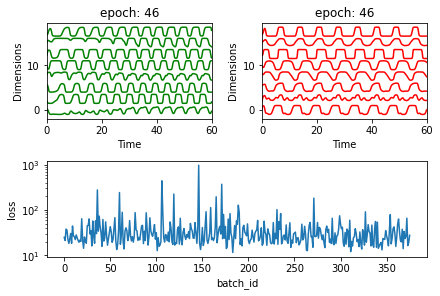

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.42693374  0.68831861  1.0962698  -0.27850562 -1.15520043  0.2862146
   0.77980081  0.54468582]
 [ 0.48440491  0.53722321  0.55216459  0.48533575 -0.24718351  1.06447839
   0.6917254   0.75059955]
 [-0.63522409  0.38276301  0.17974967  1.29698239  0.5242722   0.84787644
   0.53131857  0.49555022]
 [ 0.17335573  0.36462816  0.67819046  0.76678206 -0.23686838  0.41996968
   0.64379936  0.93909228]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.25s/it]

[[-6.53447120e-04 -1.82590277e-01 -7.77068038e-01 -1.18584327e-01
   4.14580692e-01 -1.82543837e+00 -7.96591300e-01 -1.22815159e+00]
 [-5.83450943e-01  2.23027595e-01  5.38911078e-01  1.04144453e+00
   4.68807316e-01  1.77054450e+00  9.11599006e-01  8.48972113e-01]
 [ 6.58091616e-01  1.40839270e-01  1.48148570e-01  1.53178414e-01
  -3.29072911e-01 -6.97121554e-02  1.70416152e-01 -1.41403737e-01]
 [ 2.63345344e-01 -7.84608525e-02 -7.89796578e-01 -3.69598536e-01
   2.67194957e-01 -5.19638185e-01 -6.24932699e-01 -1.45297844e+00]]


 25%|██▌       | 2/8 [00:02<00:07,  1.23s/it]

[[ 0.40107804 -0.37938768 -0.57267587 -0.83207428 -0.0018395  -0.87423539
  -0.38139353 -1.10246536]
 [ 0.26737314  0.75436923  1.37675591  0.76400051 -0.54913474  1.68862263
   1.354187    1.24379547]
 [ 0.14745544  0.50017427  0.21379611  0.22570213  0.14125932 -0.20848576
   0.0517505  -0.03519549]
 [-0.2236663   0.13233159  0.61431713  0.81525388  0.24546659  0.08901297
   0.58270881  0.44820934]]


 38%|███▊      | 3/8 [00:03<00:06,  1.27s/it]

[[-0.05677386  0.23438639  0.21809531  0.60466102  0.07451735 -0.06517638
   0.07128842  0.19632538]
 [ 0.38553472 -0.46006619 -0.69258114 -0.46058828  0.18954932 -1.45309043
  -0.43794842 -1.19779602]
 [ 0.16727889  0.2893918  -0.05248747  0.00230657 -0.22540089 -0.52527393
  -0.18349579 -1.23628442]
 [ 0.75780363  0.53049696  0.33684667  0.28465189 -0.31242292 -0.05601985
   0.27270022  0.4745706 ]]


 50%|█████     | 4/8 [00:04<00:04,  1.23s/it]

[[ 0.89562945  0.26493665  0.42822662 -0.16631176 -0.54931083 -0.62988351
   0.39088446 -0.30222947]
 [-0.08764414 -0.10720646 -0.12685945 -0.01087864  0.27589825 -0.00899686
   0.10982004 -0.72543045]
 [-0.40683414  0.12706022 -0.11826773  0.68937516  0.41475044  0.81282247
   0.35063446 -0.28786311]
 [-0.77655858 -0.32634639 -1.34329187  0.43454648  0.78394645  0.03064126
  -0.52442097 -2.19929762]]


 62%|██████▎   | 5/8 [00:06<00:03,  1.21s/it]

[[ 0.44831709  0.62965757  1.35796136  0.88816984 -0.37947974  2.07558125
   1.56251038  1.08313702]
 [ 1.42008004  0.15813003  0.23504794 -0.66701389 -0.96453658 -1.00605368
   0.19418426 -0.5704318 ]
 [ 0.4650631   0.32022655  0.42482339  0.29520143 -0.3712496  -0.40260014
   0.17113216  0.22412245]
 [ 0.89979468  0.86144417  1.62435265  0.09494244 -1.14643235  0.29263357
   0.99254622  1.37672678]]


 75%|███████▌  | 6/8 [00:07<00:02,  1.23s/it]

[[-0.18393431 -0.26494488 -0.70017517  0.15742502  0.81314632 -0.62137493
  -0.33811694 -1.20231354]
 [ 0.07921033  0.66584011  0.13314958  1.20826279  0.18744762  0.91124065
   0.36055435  0.47458774]
 [ 0.63715141  0.59660098  1.2906521   0.43916903 -0.63197858  1.26585419
   1.46559828  1.90686022]
 [-0.2479637   0.2647575  -0.14076595  0.71976834  0.41512635 -0.1672252
  -0.23734104 -0.25992873]]


 88%|████████▊ | 7/8 [00:08<00:01,  1.22s/it]

[[-1.16376005 -0.47309088 -1.19382257  0.66629687  1.30480011 -0.97562862
  -0.79807478 -1.50781657]
 [-1.73065606 -0.28640069 -1.18694162  0.89590789  1.55197302 -0.35605527
  -0.79771153 -1.78561332]
 [ 1.79177226  0.31952808  0.52819158 -1.41882674 -1.31144812 -1.52044393
  -0.03816531 -0.2691516 ]
 [-1.1427     -0.19355381 -0.6821547   1.38555079  1.14298611  0.4898896
  -0.08176473 -0.7997099 ]]


100%|██████████| 8/8 [00:03<00:00,  2.48it/s]


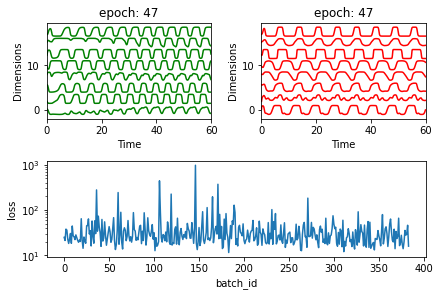

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.23708276  0.28333982  0.33152224 -0.17867138 -0.12081129 -0.74086436
  -0.07147848  0.04900013]
 [ 0.14530338 -0.03599362 -0.21452721 -0.11811623 -0.00195373 -0.50350729
  -0.25401934 -0.13281189]
 [ 0.60623223 -0.10190569  0.05377475 -0.50027544 -0.40492571 -0.67116232
  -0.04140119 -0.46691953]
 [-0.36440778 -0.08138668 -0.02460704  0.05727391  0.13211605  0.24186692
   0.20391018 -0.49181269]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.08s/it]

[[ 0.80053469  0.41032023  0.9649731  -0.48622297 -0.96742629 -0.49712511
   0.62015185 -0.16714387]
 [ 0.97134608  0.56103654  0.51878354  0.19980871 -0.79375009 -0.05727863
   0.42936133  0.00639093]
 [-0.07981078 -0.14242895 -0.44712497  0.35405521  0.36235529 -0.80233566
  -0.37773258 -0.52240821]
 [-1.46713138 -0.33514238 -0.6272635   1.09633365  1.41511359  0.21107651
  -0.21225286 -0.32056291]]


 25%|██▌       | 2/8 [00:02<00:06,  1.07s/it]

[[ 0.73804017  0.04130351 -0.07668286 -0.78454954 -0.11912828 -1.47344293
  -0.58949612 -0.55602636]
 [ 0.38850567  0.21889035  0.43134438  0.08713372 -0.24303445 -0.32785868
   0.30341711 -0.33253587]
 [-0.37971162  0.51656265  0.27798735  1.42043112  0.2326936   1.50376908
   0.74345479 -0.03076688]
 [ 2.33388378  0.65769337  0.84221472 -1.42744891 -2.03160018 -1.7948874
   0.21199291 -0.09197127]]


 38%|███▊      | 3/8 [00:03<00:05,  1.11s/it]

[[ 0.09988049  0.79427718  0.2558149   1.00588839  0.01823194  1.22669267
   0.27794118  0.43586478]
 [ 0.44956943  0.41183016  0.41607953  0.71964927 -0.12438884  0.17154311
   0.35498192 -0.01700636]
 [ 0.06863403  0.40333214  0.50407746  0.96262291  0.14388461  0.50112519
   0.60647193  1.07979114]
 [ 0.94104356  0.59948086  0.93992798  0.24723582 -0.51066946  0.91116423
   0.81155271  0.64422753]]


 50%|█████     | 4/8 [00:04<00:04,  1.09s/it]

[[-0.15033506 -0.08444932  0.1399559   0.63528482  0.32718923  0.58446968
   0.4498331  -0.89311589]
 [ 0.25198435  0.38217943 -0.15809462  0.39899547  0.03930727  0.63751661
   0.2349742  -0.88796296]
 [ 0.6894448   0.5636331   1.08503158  0.51033187 -0.46057014  1.20659157
   1.37175367  0.9703389 ]
 [ 0.13813951 -0.08866937 -0.55352873  0.18076553  0.13825768 -0.71020322
  -0.10480412 -0.99545719]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.07s/it]

[[ 0.73749038  0.5268675   0.24694461 -0.11479139 -0.59095446 -0.20471466
   0.09560981 -0.17855516]
 [ 0.65503852  0.06532921  0.87442147 -0.17627572 -0.32500299 -0.20065113
   0.76109158  0.28345355]
 [-0.22166673 -0.03929886 -0.03257479  0.50431768  0.44334341  0.06894038
   0.15185482 -0.45613705]
 [ 2.07817721  0.98283796  1.38323415 -0.48781723 -1.50322166  0.71359165
   0.94283238  0.71187861]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.03s/it]

[[ 0.73559443  0.55848657  0.46380641  0.22343194 -0.46190853  0.59103861
   0.46592648  0.42185184]
 [-0.29179096 -0.23164488 -0.01433959 -0.12463321  0.29946241 -1.05800105
  -0.00755397  0.17633637]
 [-1.11152184  0.04733663 -0.03859562  1.39489149  0.95075423  0.92053667
   0.34267173 -0.08362765]
 [ 0.26620345  0.61183233  0.39403503  0.98353702 -0.01006023  2.00018954
   1.00462957  0.59087598]]


 88%|████████▊ | 7/8 [00:07<00:00,  1.01it/s]

[[ 0.26328292  0.12464551  0.14945249 -0.44559702 -0.38995019 -0.73679985
   0.00281832 -0.50514976]
 [-0.42767243 -0.16268344 -0.6520588   0.82775116  0.98143058  0.06566236
  -0.11924859 -0.84595679]
 [ 2.23658948  0.82421031  0.87581576 -0.92896734 -1.64234392 -0.71256027
   0.26444178  0.24777047]
 [ 1.52398412  0.34522882  0.52363268 -0.70836987 -1.21244364 -1.04932725
   0.14403284  0.19877261]]


100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


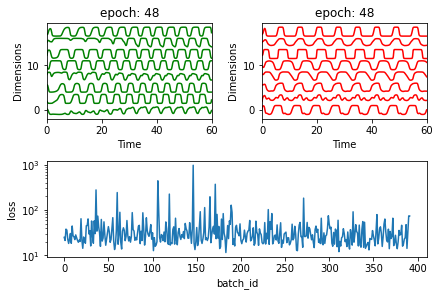

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.49141838  0.41129413  0.53988652  2.00890305  0.81607906  1.6879324
   0.81774759  0.24820462]
 [ 0.62478345  0.74156606  0.59975961  0.40509874 -0.50825619 -0.01874157
   0.33864737  0.0848269 ]
 [ 1.28247184  0.26656295  0.68847275 -0.90649584 -0.91399933 -0.83918117
   0.19479462  0.07140696]
 [-0.15277711  0.28374408  0.34138813  0.73191073  0.34654354  0.62582875
   0.49417427 -0.11600151]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.07it/s]

[[-1.35671069  0.07616736 -0.78824468  1.54980329  1.45932951  0.7845013
  -0.25358669 -0.75964179]
 [ 2.44261847  0.87417543  1.39855581 -1.08364333 -2.13356587 -0.27639272
   0.78558921  0.74364525]
 [ 0.74475182 -0.00753999  0.11127246 -0.55528796 -0.2956232  -0.52056516
   0.13957612 -0.16467266]
 [-0.29591065 -0.00512623 -0.65131535  0.46076415  0.59934221 -0.23821565
  -0.40638261 -0.53171527]]


 25%|██▌       | 2/8 [00:01<00:05,  1.09it/s]

[[-0.97054445 -0.70534777 -1.11604928  0.38665222  1.46050479 -0.71419491
  -0.77352312 -1.18976935]
 [ 0.10781623  0.30243566  0.21368682  0.61437015 -0.01021873  0.04811077
   0.30620479 -0.20144031]
 [-0.71878053  0.09608273 -0.43198853  0.87745583  0.8647527   1.08093855
  -0.14079496 -0.33429443]
 [ 0.22158694  0.40549552  0.50167763  0.77926246  0.03671595  1.47891429
   0.83290993  0.55143136]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:02<00:04,  1.09it/s]

[[ 3.71194209e-01  4.83495680e-01  7.05931235e-01 -6.13010540e-04
  -4.79592006e-01 -6.74483827e-01  2.98480226e-01  3.73084621e-01]
 [ 8.25790862e-03  1.35070823e-01  1.34218392e-01  3.02769393e-01
   1.71069477e-01 -3.87965187e-01  7.83333776e-02 -4.09866929e-01]
 [ 1.11055181e+00  6.57538017e-01  6.23729916e-01  5.11013422e-02
  -8.55067528e-01  6.11063028e-01  5.61219433e-01  6.16767491e-01]
 [ 6.01081427e-01  4.06681152e-01  6.92038563e-01  6.00343053e-01
  -4.75743943e-01  4.90768530e-01  6.09602159e-01  3.13154768e-01]]


 50%|█████     | 4/8 [00:03<00:03,  1.10it/s]

[[ 0.09934382  0.1820235   0.80138311  0.57944174 -0.01533491  0.80763893
   1.04658318  0.19080177]
 [-0.23161691  0.35433861 -0.12934876  1.04754163  0.29100067  1.34075753
   0.26229114  0.34174096]
 [ 0.9422716   0.41274694  0.74674952 -0.16950137 -0.71766171 -0.60438852
   0.39951285  0.37594644]
 [-0.0383393  -0.12636747 -0.01656224 -0.00561472  0.28809541 -1.21950816
  -0.01934494 -0.38419872]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[-0.6653381  -0.18306342  0.12967944  0.78857349  0.87335582  1.39200557
   0.56231241 -0.05038756]
 [-1.63665259  0.50697568  0.29857634  1.86914798  1.40289963  0.87836373
   0.25004587  0.10504905]
 [ 0.83911831  0.26330143  0.2081121  -0.30369792 -0.35488391 -0.99454996
  -0.11048934 -0.08256419]
 [-0.67308587  0.30751836 -0.22247298  0.93080846  0.69020263  1.07280254
   0.21342768 -0.07270329]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[ 1.50612012  0.8654897   1.35679366  0.15161275 -1.10809318  0.11930138
   0.87513618  1.44529082]
 [ 0.39054753  0.16278145  0.19477872 -0.16402532 -0.17213878 -0.79349472
   0.02305299 -0.62870988]
 [-0.22747123 -0.12123547 -0.4985218   0.28019848  0.47201468 -0.34925024
  -0.24391367 -1.19470713]
 [-0.04962952  0.12901045  0.33482025  0.34801508 -0.1644335  -0.13664031
   0.38739364 -0.30941678]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[ 0.17770737  0.09924336  0.42110917  0.59094895  0.1378419   1.0431177
   0.69909072  0.33440683]
 [-0.74750254 -0.09560669 -0.43251957  1.26154455  1.18378557  0.46371107
   0.013412   -0.02293868]
 [-0.62920853  0.37135188 -0.13100443  0.56021197  0.31750725 -0.30481943
  -0.24007249 -0.61658294]
 [ 0.41911473  0.18320743  0.56287163  0.10437053 -0.48748056 -0.1363697
   0.55738411  0.02839381]]


100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


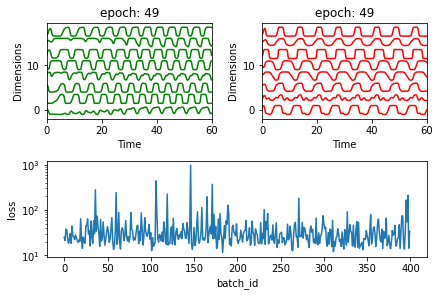

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.15499369 -0.31428207 -0.58535873 -0.13176094  0.24899336 -1.91567839
  -0.70320835 -1.51702556]
 [ 0.55103794  0.68990618  0.78098607  0.46436812 -0.34193148  0.45955998
   0.74949746  0.54673774]
 [ 0.2754597  -0.16734471  0.08667258 -0.17516789 -0.09663173 -0.06574044
   0.26432975 -0.56796519]
 [ 0.1078618   0.61702757  0.69545798  0.97734463 -0.13399257  1.86698125
   0.95524949  0.73636072]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[ 0.39337363 -0.05584833 -0.16925918 -0.06322181 -0.05616555 -1.36167717
  -0.1784542  -0.18689708]
 [-0.20412304  0.02004033 -0.03395221  0.34462024  0.17684174 -0.54451354
   0.03267342 -0.32326057]
 [ 1.22455601 -0.08953619 -0.01014569 -0.79217084 -0.51554151 -1.30924623
  -0.11928933 -0.65473327]
 [ 0.1136177   0.19109423 -0.09207527  0.15671869 -0.04238372 -0.85476646
  -0.09098897 -0.67407358]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.02s/it]

[[ 1.54462911  0.28620838  1.59629177 -1.00050047 -1.4580562  -0.00485678
   1.12245646  0.72896452]
 [-1.64046514 -0.3160329  -0.8330771   1.46763076  1.49863942 -0.14778008
  -0.30524228 -0.74131732]
 [-0.98665254  0.1520048  -0.71356726  0.62574879  0.60470516 -1.84253055
  -0.94662436 -1.1126814 ]
 [-0.29376018  0.12789755 -0.48032729  1.11183958  0.6692554   0.80015384
   0.02357081 -0.36822091]]


 38%|███▊      | 3/8 [00:03<00:05,  1.04s/it]

[[ 1.37103982  0.37228952  0.52643191 -0.64905623 -1.10839458 -1.25818031
  -0.03993769 -0.19333323]
 [ 0.29758292  0.08457151  0.09325999  0.59663474 -0.02333092  0.95064887
   0.55645393 -0.39169657]
 [-0.81266512 -0.51142673 -0.56741174  0.21418914  0.74665613 -0.85374991
  -0.3057643  -1.02800805]
 [ 0.83440782  0.92025097  1.35048078  0.23785539 -0.96051196  0.57988791
   0.96082152  1.10807847]]


 50%|█████     | 4/8 [00:04<00:04,  1.11s/it]

[[-0.29540432 -0.22687234 -0.40364239  0.07019671  0.46349786  0.32596627
   0.220812   -0.87506473]
 [-1.52286771 -0.7680442  -1.96814786  0.76946717  1.90392018  0.51230527
  -0.83735232 -2.2864543 ]
 [ 0.41717621  0.47406461 -0.19106772  0.57306459  0.08688921  1.17111657
   0.36813516 -0.32151972]
 [-0.6209634   0.14497174  0.74369561  1.23500704  0.80242801  1.96683531
   1.33717377  0.92646817]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.11s/it]

[[-0.44099503  0.12706856  0.67198681  0.61283339  0.3268397   0.55693592
   0.70921914  0.65376328]
 [ 1.01123709  0.60466291  0.78499913  0.66379022 -0.36140363  1.38154215
   0.91690264  0.63859686]
 [ 0.41721926 -0.16629395  0.65393043  0.11269011 -0.06986109  0.28583644
   0.89113338  0.5716008 ]
 [-0.16041473 -0.01192569 -0.709284   -0.01741228  0.39965281 -1.11890278
  -0.73796245 -1.38846767]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.08s/it]

[[-0.00723296 -0.16677907  0.12782877 -0.4815188   0.11988606 -1.50008625
  -0.10443375  0.03272843]
 [-0.05637964  0.24815078  0.19874858  0.34007678 -0.15343747 -0.22284283
   0.06200209 -0.01446574]
 [ 1.13758579  0.36063447 -0.09020502 -0.21179618 -0.60428877  0.09972293
   0.00176697 -0.5954712 ]
 [-0.83395806 -0.64269815 -1.00152722  0.39941193  1.35712659  0.00248748
  -0.22330939 -1.25370026]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.08s/it]

[[ 0.72731558  0.25723754  0.77195449  0.08492727 -0.43318878 -0.16945455
   0.67584801  0.32125044]
 [-0.64914405  0.2960352  -0.25686492  1.24049519  0.8853746   0.75000985
   0.01707455 -0.15759881]
 [ 0.40645518  0.4732295  -0.01494494  0.1075837  -0.42857557  0.13981907
  -0.03750648 -0.47126792]
 [ 1.04589726  0.76655617  1.75242073  0.18811472 -1.11979599  1.18960043
   1.40833117  1.21511349]]


100%|██████████| 8/8 [00:02<00:00,  2.68it/s]


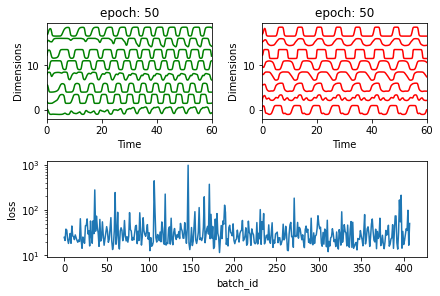

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.24878406  0.70479602  1.10988899  0.94145752 -0.14946891  1.17190476
   1.15264445  1.25861314]
 [-1.20015029  0.22456056 -0.47393314  1.75502637  1.2750946   1.28314899
   0.19907155 -0.53665589]
 [ 0.64404371  0.29243347  0.46833412 -0.14751984 -0.41014364  0.51909435
   0.586411   -0.45930026]
 [-0.26055514 -0.42315025 -0.09950963  0.0528129   0.75514169  0.16199391
   0.41677794 -0.56877682]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.07s/it]

[[ 0.48540999  0.49325983  0.37717404  0.51635792 -0.19965041  0.16652498
   0.28276936  0.52902223]
 [ 0.55364799  0.26550099  0.44645802  0.13682148 -0.41773209 -0.03517159
   0.60794653  0.1107951 ]
 [ 0.34528053 -0.03105253 -0.09829398 -0.46915015 -0.0556346  -0.9007163
   0.02796536 -0.97758804]
 [-0.27676786 -0.0141576   0.06926892  0.19240238  0.43791554  0.5487208
   0.31801827 -0.48322857]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:06,  1.02s/it]

[[ 0.5009722   0.50003912 -0.1588816   0.58947393 -0.26856051  0.91388617
   0.12262137 -0.60075776]
 [-0.37217281  0.28977274 -0.14034238  0.69424774  0.58042879  0.57681639
   0.17156822  0.13604295]
 [ 0.06482469  0.29422242  0.22910721  0.39929973  0.21028483 -0.17976682
   0.28657788 -0.78260119]
 [ 0.67167     0.21741709  0.1800853   0.02317853 -0.33145051  0.22864539
   0.35564591 -0.35315517]]


 38%|███▊      | 3/8 [00:02<00:04,  1.02it/s]

[[ 0.12250392  0.338143   -0.26377929  0.65156339  0.04106152  0.79800358
   0.01098052 -0.61703657]
 [-0.99802053  0.46946828 -0.43260599  1.49687032  1.31624816  1.51123912
  -0.10235038 -0.22729066]
 [ 1.05082219  0.00345908  0.10919137 -0.73865723 -0.78756472 -1.08701823
  -0.06491373 -0.61541299]
 [-0.14668478  0.48977032  1.09591762  1.30387137 -0.09362311  1.6380382
   1.33454293  1.10877502]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 0.64371256 -0.18257722  0.60973981 -0.50968068 -0.24480321 -0.62472348
   0.49969675  0.24420957]
 [-1.01063604 -0.10839615 -0.35499894  1.16199184  1.03497096  0.36598357
   0.07208602 -0.35765874]
 [ 0.18443968  0.51303899 -0.13111735  0.69972389  0.23362801  0.09102992
  -0.11901041 -0.56073755]
 [-0.70827098 -0.06109326 -0.18138652  0.80544792  0.85538288  0.58727675
   0.23340311  0.10971887]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.05it/s]

[[-4.74453918e-01 -2.82844089e-04 -3.14206153e-01  8.51236447e-01
   8.97381852e-01  6.36152631e-01  1.98009024e-01 -5.09495799e-01]
 [-1.66230857e-02 -8.01684487e-02 -4.58810144e-01 -5.15202194e-01
  -8.25703257e-05 -2.10040324e+00 -9.59397649e-01 -8.91874534e-01]
 [ 4.01839403e-01  2.53388558e-02 -6.06405706e-01 -1.06184306e-01
   2.76425259e-01 -1.05482550e+00 -5.12075947e-01 -9.08863997e-01]
 [-1.23972493e+00 -6.90017024e-01 -1.56594178e+00  2.18373518e-01
   1.28721014e+00 -1.68997625e+00 -1.33113248e+00 -2.04742409e+00]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.07it/s]

[[-1.84733346 -0.72434982 -0.73918983  1.06366751  1.52948601  1.08097346
   0.24446838 -1.20873138]
 [ 1.08886174  0.51542911  0.9995916  -0.4098095  -0.89287006  0.14843367
   0.83895313  0.67412329]
 [ 1.02428758  0.77835386  1.04602007  0.66989622 -0.3989953   1.20068321
   1.01024839  1.42602576]
 [ 0.38461247  0.00836772  0.06629467 -0.36420341 -0.28853907 -0.38449854
   0.10197467 -0.64416895]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[-0.13455426 -0.27376832 -0.86911405 -0.19347617  0.31009523 -1.64659834
  -0.79076286 -1.01880242]
 [ 0.17417739 -0.0728726  -0.27011166  0.1169449   0.26696996  0.23196438
   0.09829845 -0.39319079]
 [ 0.03311056  0.28844978  0.54117523  0.6430616  -0.12069792  0.29790373
   0.49061485 -0.2889015 ]
 [-0.30643219  0.08463728 -0.89880877  0.22502329  0.7397971  -0.66856693
  -0.73427629 -1.38934361]]


100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


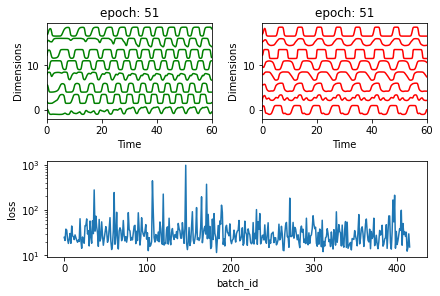

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.23317011 -0.4931948  -0.41015031 -0.31451707  0.171653   -1.62687337
  -0.41188946 -0.99707926]
 [ 1.42916243  0.55348258  0.46573162 -0.1883337  -0.95052961  0.39458771
   0.41101261  0.24963454]
 [-0.74227768  0.04354765  0.1054171   1.2295033   0.90064569  0.54430905
   0.50237523 -0.11912802]
 [-0.70857537 -0.0208723   0.0380471   0.91410457  0.8783489   0.48875505
   0.32242671 -0.3371744 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.04s/it]

[[-0.33106514 -0.13220257 -0.46030742 -0.09940596  0.34235838 -0.48162462
  -0.19120049 -1.38286109]
 [ 1.12550561  0.31582042  0.6551031  -0.43760455 -1.0087692  -1.15273158
   0.34077158 -0.0576618 ]
 [ 0.28842429  0.20592396  0.35572597  0.51869315  0.02905159 -0.25951217
   0.36543917  0.28850634]
 [ 1.22804608  0.388533    0.64938995 -0.28945308 -1.3462006  -0.36093979
   0.6241791  -0.26493786]]


 25%|██▌       | 2/8 [00:01<00:05,  1.00it/s]

[[ 1.23515864  0.06718883  0.37526605 -0.15682716 -0.29855871 -0.12851264
   0.4669147   0.20842793]
 [ 0.69155373  0.46618018  0.29882652 -0.06472218 -0.50003735  0.24944521
   0.22845064 -0.37226731]
 [-0.07136859  0.26607172  0.01049124  0.84862435  0.30131729  0.6007113
   0.28958072 -0.28959653]
 [-0.17079556 -0.14889946  0.70705593  0.1444969  -0.02456778 -0.36910488
   0.69611715 -0.39030364]]


 38%|███▊      | 3/8 [00:02<00:04,  1.04it/s]

[[ 6.76974138e-01  2.99199174e-02 -2.53237701e-01 -6.03786015e-01
  -3.76094382e-01 -1.00525767e+00 -3.21427301e-01 -1.32966455e+00]
 [-3.95725194e-01 -1.26403005e-01 -3.07072063e-01  8.48818272e-01
   5.19957217e-01 -2.98719463e-01  8.44173341e-03 -5.89496547e-01]
 [-9.30509401e-01  2.40357487e-01 -4.66069086e-01  1.32442880e+00
   9.27687560e-01  8.29364565e-01  5.78084882e-02 -4.31951211e-01]
 [-4.44874008e-01 -4.03734895e-01 -7.67023866e-01  1.59792447e-04
   4.82596515e-01 -1.17454845e+00 -6.14232182e-01 -1.26966516e+00]]


 50%|█████     | 4/8 [00:03<00:03,  1.06it/s]

[[ 1.20227446  0.52389747  0.7113483   0.22262773 -0.84659555  0.31509821
   0.5642925   0.45708695]
 [-0.18691403  0.15822602 -0.57402823  0.25741081  0.19374578 -0.32599377
  -0.60727525 -0.58298549]
 [-1.04641467 -0.81131687 -1.88924019  0.05281775  1.46494901 -2.25881017
  -1.58085986 -2.61521579]
 [ 0.71590156  0.30191971  0.01649691 -0.16651493 -0.34485941 -0.80120927
  -0.1885046  -0.94967949]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[-1.57405663  0.18942182  0.70182592  2.48267863  1.53000729  3.04878238
   1.67996471  1.33712128]
 [ 0.14249038  0.21772654  0.56713095  0.04219573 -0.06749274 -0.69459017
   0.38966443 -0.43234711]
 [-0.21816421  0.17235087 -0.19632133  0.88113222  0.20567473  1.14185895
   0.35104881 -0.20946051]
 [ 0.5869728   0.286912    0.36433511  0.16485491 -0.18864078  0.26440975
   0.48072469  0.40773088]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.10it/s]

[[ 0.2556297  -0.03554376 -0.26728113 -0.27933799 -0.20068582 -0.79889618
  -0.26421198 -1.35162023]
 [ 1.91465823  0.45812882  1.13006387 -1.04842238 -1.68649635 -0.12962604
   0.70697286  0.72012701]
 [-1.71544371 -0.22562775 -0.7246854   1.40034737  1.75894758  0.78385518
   0.03341155 -0.75928094]
 [ 0.79325605  0.65420097  0.69399436  0.08684648 -0.62448535  0.05279865
   0.41299308  0.43033733]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[-1.88356358 -0.15372731 -1.28269334  1.40676454  1.97493344  0.01004897
  -0.65739195 -2.0039695 ]
 [-0.22359753 -0.10061594 -0.33910207  0.34113155  0.33021609 -1.15440399
  -0.37814333 -0.886784  ]
 [-0.17388923  0.37617433  0.75061706  0.44319553  0.18775049  1.23856142
   0.87670938  0.56280061]
 [ 1.26890219  0.16336131  0.1562159  -0.79991021 -0.89460921 -1.31430515
  -0.08621794 -0.50455944]]


100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


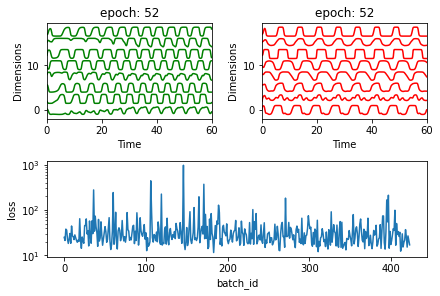

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.14748664 -0.2763759  -0.44473201  0.73494552  1.02611441 -0.17055966
   0.04824837 -1.03446339]
 [ 1.46645664  0.80777042  0.9771625  -0.37597631 -1.41567725  0.14091117
   0.44197863  0.52981814]
 [-0.38134723 -0.06271385 -1.03993536  0.71910913  0.78467993 -0.7188469
  -0.84534272 -1.54750268]
 [ 0.14623201 -0.22532009 -0.50415217  0.06150473  0.28392535 -1.31420116
  -0.37156284 -0.58811063]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[-0.24764352  0.43688562  0.64913685  1.01806342  0.10297361  1.31852928
   0.84494813  0.76559222]
 [ 0.85211071  0.03600506 -0.49753057 -0.48195155 -0.27054895 -1.12517825
  -0.47764849 -1.02033502]
 [-0.07737911 -0.15143476 -1.00198841 -0.18519875  0.67059966 -1.65160836
  -1.16488418 -1.26888109]
 [ 0.68052839  0.36446595 -0.09865129  0.03080838 -0.25716866 -0.54721615
  -0.09857984 -0.66620444]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.10it/s]

[[ 0.39291323  0.29925268  0.42982935 -0.23600416 -0.38602936 -0.80663121
   0.10683685 -0.56477595]
 [ 0.70051962  0.22530123  0.32585537 -0.58638146 -0.44848359 -0.766066
   0.1830364  -0.16789676]
 [-0.38609139 -0.09497496  0.3241286   0.92226292  0.63957496  0.80703693
   0.8326992   0.20941258]
 [ 0.21031137  0.58983769  1.08121969  0.52342097 -0.41636147  0.94559923
   1.07238583  0.95860408]]


 38%|███▊      | 3/8 [00:02<00:04,  1.11it/s]

[[-8.89282468e-01 -3.45738767e-01 -1.09349574e+00  8.25124905e-01
   1.62442823e+00 -2.32218562e-01 -4.85732017e-01 -1.49079388e+00]
 [ 2.56791310e-01  4.36603079e-01 -1.88167672e-04  4.94260983e-01
  -9.95951666e-02 -7.95044776e-02 -1.04486308e-01  7.51228881e-02]
 [-9.30959501e-01  3.38502316e-01  6.55986940e-01  1.36553795e+00
   4.71913088e-01  7.70830876e-01  8.22788312e-01  3.44168487e-01]
 [-1.45894951e+00 -2.43579212e-01 -8.59177460e-01  1.37734273e+00
   1.66321905e+00  9.73840540e-01 -9.77769761e-02 -8.74171402e-01]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-4.42537429e-01  2.74458009e-01  1.44911614e-01  1.07441723e+00
   6.79587825e-01  1.91845174e-02  1.42184038e-01  5.77646690e-01]
 [ 5.86260382e-01  6.29076311e-01  2.11889505e-01  3.53413855e-01
  -3.87688651e-01 -1.40043624e-02  9.85703995e-02 -1.44047925e-03]
 [-2.16328270e+00 -3.76821950e-01 -1.60703508e+00  1.72049720e+00
   2.24134377e+00 -2.29116555e-01 -9.49055738e-01 -1.52543918e+00]
 [ 1.05326045e+00  1.38245774e-01 -4.06591653e-02 -7.18498891e-01
  -7.99116904e-01 -1.42579892e+00 -3.53678453e-01 -8.73292681e-01]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[ 0.89984872 -0.14165271 -0.47412881 -1.0794241  -0.31918064 -2.04516856
  -0.75598627 -1.83208817]
 [-1.1840658  -0.17690687 -0.44431569  0.87601291  1.08532592 -0.51142089
  -0.34205135 -0.73939348]
 [ 0.42388855  0.74444225  1.47082648  0.63103492 -0.41232256  1.41407242
   1.37770785  1.05311369]
 [ 0.47261695  0.76527299  0.8323839   1.10254786 -0.0950389   1.2380795
   0.91350224  1.30111291]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[ 0.36277798  0.03946153  0.2196489   0.0323533  -0.07548029 -0.7606099
   0.13587225 -0.11062554]
 [ 1.33831775  0.33199856  1.35982223 -0.3846096  -0.91461934  0.29876839
   1.30157495  1.05028115]
 [ 0.61352521  0.52189906  0.97033204  0.50733166 -0.54658301  1.55531858
   0.98807652  0.7232031 ]
 [-0.32628546 -0.58992799 -1.29288172  0.03946989  1.05788466 -0.62478396
  -0.68754949 -1.49678392]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[ 0.26174656  0.08032503 -0.35298175 -0.21313369 -0.286621   -1.18771358
  -0.47666154 -1.4323767 ]
 [ 0.42472993  0.29439016 -0.21840617  0.27438915  0.01550115  1.07892615
   0.2426009  -0.24562646]
 [-0.32366199  0.34768411 -0.2524916   1.55148768  0.77601852  2.16469567
   0.36180422  0.92673012]
 [ 0.16169081  0.32279995  0.76324351  1.14000195  0.31660137  0.85234653
   0.90485548  1.00567393]]


100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


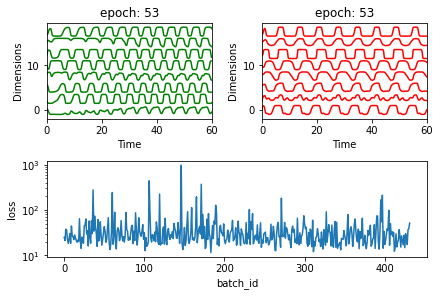

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.0492271  -0.67529053 -1.03108056 -0.64826607  0.31965573 -1.87723142
  -0.72939576 -1.70242731]
 [-1.41345553  0.20716046 -0.3463694   1.75150963  1.41879559  0.78720365
   0.06181675  0.2733999 ]
 [-1.3961721  -0.47772395 -1.50036543  1.24797414  1.72838936 -0.18965231
  -0.8185445  -1.24755476]
 [ 0.09688147  0.40904481  0.80348157  0.70828608 -0.14879467  0.41380663
   0.65006027  1.09198876]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.03s/it]

[[-0.15657408 -0.38655559 -0.53817411 -0.05502656  0.47517407 -0.81094087
  -0.13199704 -1.68862139]
 [-0.1174732   0.67921817  0.82127232  1.01432566  0.10129372  1.19355533
   0.85996227  1.02307853]
 [ 1.18242267  0.64029173  0.59803421 -0.26518433 -0.80929329 -0.35658621
   0.30422848  0.34122302]
 [ 0.52842037  0.08105294 -0.10992802 -0.12574775 -0.02657665 -0.45957741
  -0.12260143 -0.10360835]]


 25%|██▌       | 2/8 [00:01<00:05,  1.01it/s]

[[ 0.00522965  0.2503172   0.3639175   0.23249097  0.06744916 -0.82128577
   0.06258137  0.47798772]
 [ 0.86412237  0.13239277 -0.44662177 -0.0564509  -0.33833483 -0.85207705
  -0.31655959 -1.17908655]
 [ 0.31913694  0.70629269  0.62114454  1.08229601 -0.04541257  1.50963814
   0.84741511  0.59388382]
 [-0.5852988  -0.27485111 -0.99481902  0.44212283  1.12889532 -0.53027443
  -0.76755774 -1.02729892]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[ 0.12548179 -0.94424671 -1.32370434 -0.91090666  0.28601521 -2.18261003
  -0.96066507 -2.61831897]
 [-0.37056686 -0.60079808 -0.88859143 -0.47749209  0.77132739 -1.95852487
  -0.7925644  -1.22325876]
 [-0.91946385 -0.56207326 -1.8878403   0.29697373  1.08646934 -1.26048923
  -1.43702766 -2.20674602]
 [ 0.03040185 -0.12357645  0.39932655  0.0944625   0.16648053  0.00418915
   0.48757457  0.22090178]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-0.42496173 -0.07710234 -0.49590328  0.9147249   0.74973559  0.04624611
  -0.06631038 -0.30469182]
 [ 0.25147945  0.37446294  0.33498347  0.2415289  -0.28203773  0.61500617
   0.40374795  0.23393309]
 [ 0.48247932  1.04539076  1.25475924  1.27545041 -0.68713244  3.04184522
   1.53966871  0.9711907 ]
 [ 1.71896146  0.54579063  0.74958294 -0.88177289 -1.75042109 -0.4898908
   0.34992117  0.32052469]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[-4.86692632e-01 -9.90877748e-01 -1.37046901e+00 -7.47346012e-01
   9.94157158e-01 -2.60711433e+00 -1.11454142e+00 -2.01489583e+00]
 [-3.15365436e-01  8.09467684e-04 -7.79135801e-01  3.41358689e-01
   2.94674365e-01 -1.04448093e+00 -7.71361219e-01 -1.09075802e+00]
 [ 9.42854933e-01  1.03210912e-01  3.22816835e-01 -5.39607514e-01
  -7.08894279e-01  1.26354252e-01  4.71596245e-01 -3.57327902e-01]
 [-1.06903409e+00 -5.26536283e-01 -8.28107684e-01  3.20007210e-01
   1.10253677e+00 -1.48154449e+00 -6.75539945e-01 -1.46731499e+00]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[-1.52226746 -0.62477715 -0.61117025  0.68993134  1.32164138 -0.54482927
  -0.31478849 -1.04073121]
 [-2.95055681 -0.90408542 -1.79936393  2.11739234  3.07432187  0.12639551
  -0.68131217 -1.44551878]
 [-1.76314576 -0.11729262 -0.77776653  1.82223675  1.73507111  0.43676661
  -0.14493089 -0.77715229]
 [ 0.39677273 -0.24613093 -0.65397059 -0.63617928 -0.00324767 -1.03367147
  -0.48965158 -1.17424578]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[-0.5729444  -0.16838349 -0.76623074  0.04435593  0.57161868 -0.78556073
  -0.48402382 -1.24602778]
 [-1.09895509 -0.19203862 -0.68117389  0.76978899  0.81558198 -0.75364504
  -0.53141676 -0.65648017]
 [-1.74905921 -0.54183794 -1.22465879  1.03901235  1.67774503  0.2600512
  -0.49205359 -1.24297032]
 [-1.96730112 -0.34005591 -1.24198429  1.31328378  1.69117034 -0.70863846
  -0.73324697 -1.43570132]]


100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


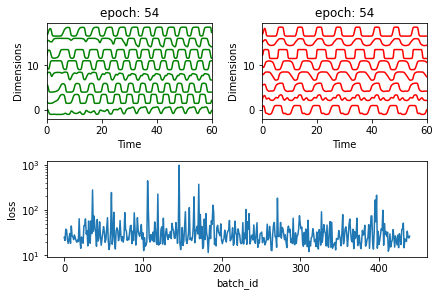

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.74378899  0.4683667  -0.12752883  0.25765444 -0.47267192  0.48170315
  -0.00629086 -0.47043123]
 [ 0.23988736  0.38168738  0.42040896  0.63357881 -0.1544646   0.76096619
   0.61305909  0.00230493]
 [ 0.06091299  0.67462826  0.6551454   0.7103189   0.0308402   1.21623531
   0.67526006  0.33609875]
 [-0.21518026 -0.46854228 -0.53721048 -0.1523138   0.46389382 -1.3679447
  -0.34934918 -0.92569557]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.10it/s]

[[-1.46431089 -0.03587774 -0.61589302  1.22786933  1.33300067  0.69886663
  -0.11272741 -0.63322354]
 [ 1.30135458  0.34492881  0.1971596  -0.74563686 -1.01637671 -0.37260549
   0.09221883 -0.85766907]
 [-0.66417841  0.08757417 -0.4395001   0.73508733  0.71483056 -0.29286638
  -0.2471653  -0.35880829]
 [ 0.25134695 -0.13361336  0.01696284 -0.27955495 -0.02581997 -0.71749118
   0.06841    -0.50810023]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.10it/s]

[[ 0.18020115 -0.07117638 -1.07427917 -0.5739008   0.0087782  -1.30549096
  -1.08460653 -1.74531615]
 [-0.80572757 -0.1741539  -0.74467186  0.81033452  0.97114938 -0.02660675
  -0.4149815  -0.49941387]
 [ 0.56862117  0.31588985 -0.11654535 -0.14228253 -0.4794382  -0.52168276
  -0.33553974 -0.35718519]
 [ 0.42882626  0.35766508  0.10070493  0.51087479 -0.12930829  0.20531854
   0.18227282  0.08550544]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[-0.63188818 -0.75931281 -0.82008916  0.14895102  0.90621527 -0.39706973
  -0.29659813 -0.8652432 ]
 [-0.26310898  0.18770171  0.17384743  0.56173565  0.2322168   0.67129413
   0.39596864 -0.37116043]
 [-0.01757688  0.27075673  0.13046147  0.63519225  0.23427374 -0.22197007
  -0.03083448  0.24934047]
 [ 2.25278397  0.44864081  1.51809928 -1.27764789 -2.04477984 -0.35786416
   1.03118574  0.90341053]]


 50%|█████     | 4/8 [00:03<00:03,  1.09it/s]

[[ 0.21030016  0.00589563 -0.20847242  0.08015121 -0.02616977 -0.05607294
   0.02393176 -0.60674383]
 [ 0.04585348 -0.00555997 -0.74245912 -0.22650247 -0.17277188 -0.94366825
  -0.58763339 -1.62605925]
 [ 1.19680356  0.4150805   0.46135996 -0.7627468  -1.09339695 -0.15531503
   0.34555414 -0.55126196]
 [-0.91126723 -0.08324396 -0.73889602  0.7272192   0.74084571  0.50284629
  -0.11622338 -1.43228156]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.10it/s]

[[ 0.13960287  0.39761758  1.47601463  1.16750833  0.10431738  1.98729644
   1.662893    1.66486488]
 [ 0.22471567  0.72018897  0.90841649  0.33745828 -0.6298491   0.65206591
   0.78119389  0.51935233]
 [-0.0993801   0.04323762 -0.56382625  0.41819874  0.46106185  0.12305741
  -0.34093997 -0.40613761]
 [ 0.30615807  0.4545885   0.01054932  0.58181426 -0.02952305 -0.18196849
  -0.1554209  -0.11016716]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[-0.41440817 -0.04443112  0.05132468  1.00003473  0.66548679 -0.66753902
   0.01363884 -0.26450953]
 [ 1.36424155  0.29759236  0.50914383 -0.78826635 -1.02772789  0.32062254
   0.56195084 -0.13677886]
 [-0.31940211 -0.50913209 -1.15579404 -0.47330563  0.69586427 -2.08192794
  -1.01305383 -1.48620973]
 [ 0.35276935  0.09993861 -0.51855051 -0.07178734  0.18315285 -0.75456569
  -0.46850728 -0.62204038]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.10it/s]

[[ 0.68047994 -0.07678935  0.26998973 -0.17789831 -0.17483062 -0.87408417
   0.21929932 -0.13576642]
 [-1.41852988  0.23627454  0.21619313  1.99365568  1.24545722  2.30126972
   0.90572424  0.55277769]
 [-0.06822139  0.01760057  0.33680508 -0.14659047 -0.30379779  0.09293832
   0.38280294 -0.42416092]
 [ 0.54491288  0.24074854  0.35193642 -0.13938023 -0.61749352 -0.3962516
   0.29946573  0.21493077]]


100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


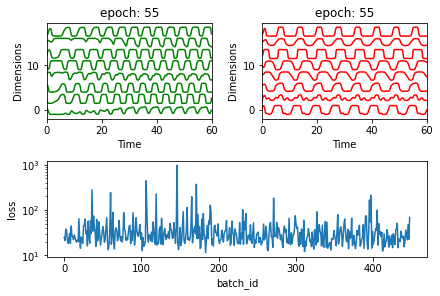

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.1389381  -0.3391752  -0.62184942 -0.7845603   0.28461261 -1.22515904
  -0.59616303 -1.76498814]
 [ 0.45182684  0.03391129  0.2387552  -0.22311819 -0.37724818 -0.40419461
   0.34201367 -0.11156509]
 [ 1.17698906  0.38786766  0.48281785 -0.44908826 -0.80514112 -0.50751716
   0.26477693  0.20907582]
 [-0.69438536  0.12700523 -0.24916462  1.01943546  0.81401091  0.5359313
   0.02242421 -0.16014205]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.10it/s]

[[-0.69501904  0.10398975 -0.75277238  0.73936514  0.94227785 -0.8518095
  -0.77229629 -1.23805485]
 [ 1.05707793  0.62618518  1.27988284  0.20231684 -1.16186897  0.24278518
   1.06306945  1.42039538]
 [ 0.64871233  0.85735163  0.5884978   0.46212718 -0.192081    0.35707514
   0.20744112  0.63889183]
 [-0.14537039  0.64532947  0.74600837  1.53751362  0.2993913   2.01514898
   1.14460086  0.89031733]]


 25%|██▌       | 2/8 [00:01<00:05,  1.11it/s]

[[-0.43231176 -0.50011184 -0.92263285 -0.50813563  0.40428414 -2.04756876
  -1.08550798 -1.62142323]
 [-1.30614249 -0.41325305 -1.59930728  0.93773773  1.46840107 -1.06995546
  -1.08590229 -1.38352941]
 [ 0.63755484  0.88075149  1.15206179  0.56391384 -0.33428352  1.45873204
   1.20269735  0.75784616]
 [ 0.10901073 -0.49691118 -0.92050176  0.43288093  0.64567075 -0.9323719
  -0.32863014 -1.62365173]]


 38%|███▊      | 3/8 [00:02<00:04,  1.11it/s]

[[-1.07202854 -0.12925547 -0.17672938  0.86041932  0.77586446  0.40913875
   0.25831099 -0.77212423]
 [-0.58155823  0.10486132 -0.77672173  0.3784398   0.51790844 -0.61209889
  -0.6007244  -1.26829783]
 [ 0.85183656  0.3778596   0.78432282 -0.1865031  -0.90955903 -0.33021644
   0.65769504  0.0734748 ]
 [-0.441304   -0.48666784 -0.68246587 -0.28532381  0.70518315 -1.00397425
  -0.30211034 -1.36630751]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 50%|█████     | 4/8 [00:03<00:03,  1.11it/s]

[[ 0.48108315  0.61199074  0.34152863 -0.36136004 -0.75840627  0.12492576
   0.09528189 -0.40159878]
 [-1.74910363 -0.31673495 -1.2355207   1.54837361  1.99658785  0.57193239
  -0.54468614 -1.02068315]
 [-2.06768749 -0.3045878  -0.65159613  1.9080828   2.0115665   1.48679049
   0.16294482 -0.30821236]
 [-0.3684934   0.23027632 -0.18489596  1.19972708  0.68227143  0.50903548
   0.19018833 -0.40392498]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[-0.0769314  -0.31385345 -0.30358611  0.42429661  0.3890465   0.3748383
   0.21076693 -0.48609023]
 [ 0.83243235 -0.10846235  0.09697123 -0.53741505 -0.70647089 -1.00075405
   0.28521214 -1.0341643 ]
 [ 0.12752007  0.27812805  0.4323728   0.26444213 -0.0403136   0.78373566
   0.59961529 -0.23295854]
 [-0.0230103   0.4260497   0.58046699  0.48576699 -0.16861649  0.29625626
   0.46156097 -0.06658277]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[-0.77125874 -0.13208136 -0.07481876  0.41656824  0.52080392  0.04921022
   0.18427471 -0.10587764]
 [ 2.36195109  0.95943322  2.38123489 -0.57756623 -2.39474599  1.35501228
   2.12626701  2.06830747]
 [-0.67770854 -0.05623662 -0.88226462  0.89230199  0.93200736  0.26455707
  -0.28381697 -0.83205522]
 [ 0.09373355  0.10648602  0.22732155  0.15770203  0.23701111  0.43023672
   0.33133767  0.11371999]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[-1.49264118 -0.44860785 -0.8173016   1.06297099  1.43850058  0.66381832
   0.03698944 -1.05517925]
 [ 2.25321338  0.35087728  0.24761605 -1.03772209 -1.24962768 -1.57766651
  -0.05314432 -0.38589067]
 [-0.93918413 -0.07062741 -1.20626736  1.10948926  1.0097895   1.11320478
  -0.27620392 -1.68916891]
 [-0.1493715  -0.4652969  -1.1611075  -0.30750927  0.61403515 -2.16174175
  -1.2687966  -1.74090956]]


100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


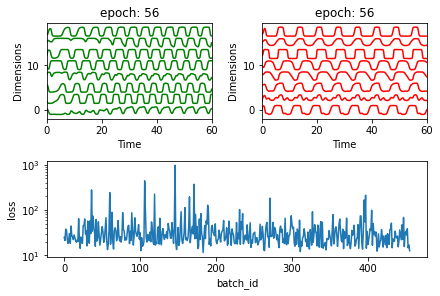

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.07841456  0.48316289  0.57290403  0.74346381 -0.21129606  0.8531418
   0.67895965  0.27303046]
 [-0.02241344  0.15631007 -0.37418937  0.02337026  0.27159859 -0.61825798
  -0.40147192 -0.84426379]
 [ 0.44343217  0.37103918  0.35621742  0.67207146 -0.07296617 -0.48268026
   0.28791543  0.23250048]
 [ 0.32737316  0.47478133  0.53684127  0.68621962 -0.07934655  0.99314795
   0.70069778  0.41707167]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[ 0.57615535 -0.36675253  0.05046949 -0.84451273 -0.54063527 -0.8081437
   0.18067903 -1.03833115]
 [-0.26307647 -0.2321251  -0.32459052  0.26147508  0.60753401 -1.10737051
  -0.1121759  -0.39307006]
 [-0.09613887  0.58770164  0.16706159  0.81580271 -0.03727713  1.1858431
   0.32620493  0.09069073]
 [ 0.35284893 -0.38771046 -1.08993382 -0.34778049  0.2637577  -1.53796418
  -0.8041828  -1.71358085]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[-0.55650218 -0.63236419 -1.24374278 -0.27388512  0.49549714 -2.1394227
  -1.0529976  -1.90724384]
 [ 0.92240261  0.063252    0.81350047 -0.36669535 -0.45502727 -0.00905648
   0.79738799  0.32055536]
 [ 0.48745657  0.62583456  1.12853011  0.85318078 -0.34765387  1.96326714
   1.23987069  1.11613333]
 [-0.05778721  0.25450006  0.24842192  0.27793879  0.03466196  0.65124745
   0.28356219 -0.47978383]]


 38%|███▊      | 3/8 [00:02<00:04,  1.08it/s]

[[ 0.42421064 -0.21396259 -0.30163221 -0.37218924 -0.05416484 -1.34185756
  -0.27090951 -1.01122105]
 [ 0.34848252  0.29850272  1.02096992 -0.30386189 -0.626175   -1.38087475
   0.33090348  0.28315195]
 [-0.73320834  0.12551252 -0.28974481  1.44898517  1.00692529  0.69044695
   0.108893   -0.2321601 ]
 [-0.4873638   0.00197378 -0.9209281   0.50638168  0.52964436  0.03346639
  -0.54791671 -1.2987593 ]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[-0.07711115 -0.06935396 -0.86578139 -0.24054261 -0.05279314 -0.89553562
  -0.6813595  -1.80838226]
 [ 0.2783959   0.16635186  0.45068642  0.04916617 -0.30814717  0.33464309
   0.47449309  0.0472029 ]
 [ 0.42155641  0.58341479  0.5586586   0.67493907 -0.51201848  1.54508078
   0.95734651 -0.07566894]
 [-0.92552539  0.26233484  0.3005016   1.34506807  0.81524462  1.17761893
   0.56578794  0.27696639]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[ 0.74756881  0.15768069  0.79370375  0.14656561  0.12211252 -0.40247884
   0.73722666  0.68198708]
 [ 0.23088741  0.02099944 -0.22830621  0.07707022  0.31272933 -0.17746571
  -0.17275313  0.19764985]
 [-1.14539845 -0.62698293 -1.13024651  0.14458024  1.33307493 -1.56160291
  -0.8554451  -1.97226083]
 [ 0.55399148 -0.03482271 -0.24585327 -0.59932624 -0.32961909 -1.33996675
  -0.32076113 -0.73066687]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.09it/s]

[[ 0.15094219  0.29814043  0.04773124  0.45021977 -0.09359189  0.2453541
   0.06266053 -0.19266884]
 [-0.73839594 -0.7771574  -1.22277682  0.21610349  1.16736441 -0.77265707
  -0.66679238 -1.36395966]
 [ 0.7124443   0.030825    0.66718657 -0.40121013 -0.53984573 -0.80011999
   0.51841286 -0.02705213]
 [-0.46380206  0.40994426  0.50925804  1.61362751  0.63760798  1.53353762
   0.82670722  0.87310356]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.10it/s]

[[-0.72703904 -0.15657336  0.12820939  1.17127659  0.97024178  1.13300039
   0.74008986  0.23892152]
 [ 0.24237727  0.16729115 -0.15808164 -0.08118212  0.1230343  -0.57085583
  -0.11789905 -0.72930869]
 [-0.13461267 -0.21968518 -0.73583947  0.03709779  0.74089117 -0.53970191
  -0.50774163 -1.13739431]
 [ 0.89294553  0.22242941  0.78198385  0.11317013 -0.70893913  0.15713149
   0.73144977  0.72195188]]


100%|██████████| 8/8 [00:02<00:00,  3.41it/s]


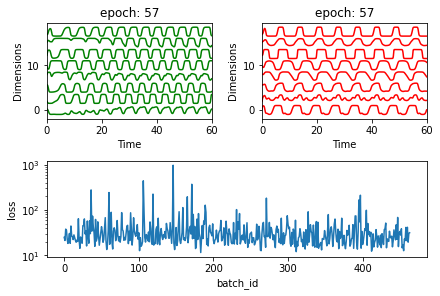

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.00788392e-01  5.07695337e-01  1.97779995e-01  6.70617951e-01
   1.43774408e-03  4.64923826e-01  2.61691119e-01  1.00822715e-01]
 [-9.07475836e-01 -1.30317077e-01 -3.62495037e-01  4.71045193e-01
   7.81269422e-01 -5.21755586e-01 -1.28292929e-01 -1.06697103e+00]
 [ 3.52537542e-01  2.64526075e-01  4.65479473e-01  2.62374834e-01
  -3.38337534e-03 -8.61678462e-03  3.46609240e-01  3.35593011e-01]
 [ 1.75875365e+00  1.07205596e+00  1.65810143e+00 -6.45113598e-02
  -1.63978186e+00  9.98669124e-01  1.28209418e+00  1.03692902e+00]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[ 0.36192959 -0.21841457 -0.24057315 -1.06717153 -0.3596456  -1.97136223
  -0.5011771  -1.80257757]
 [-0.63109692 -0.0648087  -0.43896925  0.85892291  0.7142896   0.39951092
  -0.04072895 -0.57943582]
 [-0.03629615  0.67470877  0.30204118  1.30975355  0.1336086   2.13296675
   0.7826625   0.87276553]
 [-0.92037935 -0.17375386  0.00556426  0.72197276  1.13831424 -0.25567391
   0.19291724 -0.19796197]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[-1.15835831 -0.05282448 -1.17958439  1.07239653  1.40114771  0.38724626
  -0.80501276 -1.22360843]
 [ 0.28870655  0.12161939  0.01725726 -0.0995732   0.01193071 -0.52959358
  -0.00662822 -0.45697559]
 [-0.99661722 -0.04154815 -1.31704972  0.95380746  1.11688343 -0.31240417
  -0.99237388 -1.62718077]
 [ 0.48549508  0.07015252 -0.6806336  -0.69426686 -0.20964763 -2.1740625
  -1.05600943 -1.58973119]]


 38%|███▊      | 3/8 [00:02<00:04,  1.09it/s]

[[-0.26280325 -0.39086049 -0.40158351 -0.46890569  0.36408016 -1.28386143
  -0.33567263 -1.57470828]
 [ 0.23644197  0.59277515  0.59016297  0.97790265 -0.00986438  1.1184399
   0.78984746  0.85647014]
 [-0.31427243  0.39482669  0.07323689  1.08075071  0.3055457   0.55846746
   0.24556119 -0.05586743]
 [ 0.60302946  0.28844636  0.17627253 -0.23957509 -0.53976061 -0.48618365
   0.18818365 -0.45825591]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[ 0.6806563   0.45868034  0.31173338  0.28061181 -0.31642028  0.76299426
   0.41975372  0.1591947 ]
 [ 0.39852169  0.16293971  0.59845049 -0.05406756 -0.41577423 -0.69724356
   0.29897423  0.71384744]
 [-0.06967045  0.20676697  0.46324826  0.26617973  0.07499047 -0.29473766
   0.42547886 -0.32933971]
 [ 1.94499481  0.38136136  1.22239067 -0.89076784 -1.40248554 -0.42324214
   0.86364824  0.6096353 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[-1.12296499 -0.68410592 -1.41338864  0.52729264  1.46688813 -0.76820587
  -0.90174738 -1.44943249]
 [-0.36363147  0.26403025  0.13939427  1.4596573   0.779432    1.472956
   0.61089362  0.63054022]
 [ 0.71327867  0.11614507  0.96052192 -0.36397651 -0.65829175 -0.39991527
   0.6527584   0.19359882]
 [-1.15125388 -0.23546114 -0.81926419  1.19915761  1.49812213  0.45173334
   0.01474391 -0.81988932]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[-0.58286014  0.1373463  -0.25090702  0.25290135  0.0715184  -0.95776544
  -0.37652589 -0.65984559]
 [-0.28054762 -0.21983268 -0.44002256  0.3821001   0.52013223  0.06306186
   0.08211385 -0.69300233]
 [ 0.2574308   0.56148641  1.01342415  0.6994145  -0.2838343   0.88674649
   0.98449027  0.93758123]
 [-0.59299846  0.38334718  0.26551262  0.75773007  0.53100794 -0.09879998
   0.22229911  0.03287748]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.03it/s]

[[-0.70875619  0.02235883 -0.1385886   0.72554662  0.43920365  1.4874643
   0.39989776 -0.6096025 ]
 [-1.58126201 -0.59575945 -1.01574893  1.2376516   1.71788128 -0.40158863
  -0.32546306 -1.31336843]
 [ 0.59076693  0.26978629  0.10110922 -0.0146334  -0.35600823 -0.69647557
   0.09036741 -0.05160687]
 [ 0.07041373  0.08226398  0.40350011  0.06576342 -0.0518184  -0.82495344
   0.21746064 -0.29342607]]


100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


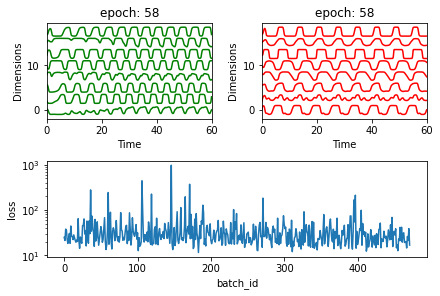

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.03850137  0.20600868  0.66964569  1.73355636  0.85548013  1.37206624
   1.26251753  0.57095886]
 [-1.09939972 -0.09641764 -0.52683017  1.08331398  1.09841554  0.06132667
  -0.17013908 -0.41454408]
 [ 0.3603887  -0.22002305 -0.07323225 -0.05864883 -0.03153027 -0.62345006
   0.08676831 -0.25431136]
 [-0.11142761 -0.33840898 -0.50315845  0.3351818   0.41787543  0.19137489
   0.10666406 -0.57718506]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.06s/it]

[[ 0.1394859   0.51760779  0.79890978  1.14299955  0.09514484  1.36806067
   0.96504932  0.98262231]
 [ 0.13708367 -0.20429378 -0.40597854 -0.49705043  0.12130149 -1.44846417
  -0.47857937 -0.98273343]
 [ 0.4952488   0.06656463 -0.14368399 -0.11392413  0.15335995 -0.9633342
  -0.20411691 -0.38591413]
 [ 0.56482731  0.35923412 -0.03911374 -0.02632759 -0.08756274  0.10924845
  -0.04223454 -0.55903402]]


 25%|██▌       | 2/8 [00:01<00:06,  1.02s/it]

[[-0.7708634  -0.07854688 -1.36969123  0.78758583  1.15105525 -0.43383667
  -1.01468747 -1.90989195]
 [-0.35547777  0.27491802  0.21070264  0.70444767  0.33628662  0.73058806
   0.30924588  0.08661594]
 [ 1.19858871  0.74207596  1.22243591 -0.15145392 -1.15329471 -0.17847412
   0.983188    0.35298462]
 [-0.76254401 -0.30346816 -0.49724891  0.70928962  0.87162658  0.10866793
   0.06342755 -0.88610197]]


 38%|███▊      | 3/8 [00:03<00:05,  1.04s/it]

[[-0.88854077 -0.00476939 -1.43090013  0.89000888  0.99249118  0.48701488
  -0.90327904 -1.37647914]
 [-0.45569984  0.400473   -0.54549098  1.09235623  0.67273231  0.89091339
  -0.26969945 -0.61557184]
 [ 0.00211999  0.1445901   0.13836195  0.57480545 -0.0068573  -0.38181319
   0.20164358 -0.21083522]
 [-0.41497814 -0.62947049 -1.1148222  -0.05085983  0.83282812 -1.17973838
  -0.64356709 -1.26199684]]


 50%|█████     | 4/8 [00:04<00:04,  1.06s/it]

[[-0.60656695 -0.00214392 -0.75622791  1.18522416  0.91215645  1.39765087
  -0.05100518 -0.26886162]
 [-0.38544255  0.16270072  0.46343943  0.55612676  0.24588785  0.51029776
   0.66762657 -0.1835867 ]
 [-0.22275089  0.23282752  0.55261895  0.7064834   0.13530673  0.4713758
   0.55645976  0.31920702]
 [ 0.71670321  0.122807   -0.0056606  -0.6611927  -0.37886823 -0.91564216
  -0.07129392 -1.30878231]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.04s/it]

[[ 1.21385183  0.49226253 -0.03731421 -1.07202165 -1.20116363 -1.14293191
  -0.67567178 -1.02906594]
 [ 0.77579449  0.87642818  1.22778656  0.54877377 -0.84304379  0.72401657
   1.19314942  1.209976  ]
 [-1.37338025 -0.41482691 -0.95301398  1.44613497  1.63094248  0.11851208
  -0.39983586 -0.85730953]
 [ 0.75330871  0.04576879  0.40442752 -0.35965007 -0.58028068 -1.47911065
   0.00723114 -0.07354623]]


 75%|███████▌  | 6/8 [00:06<00:01,  1.01it/s]

[[-0.39235291 -0.35465987 -0.38293607  0.50143867  0.70955221  0.07949334
   0.2596512  -0.82206299]
 [ 0.37400227 -0.14092024 -0.05235492 -0.09929199 -0.04539576 -0.94912288
  -0.16449663 -0.32848755]
 [ 0.49287823  0.57402414  1.06675371  0.44345236 -0.81855546  1.28515484
   1.13744981  1.14052321]
 [ 0.51985803  0.01759062 -0.12369313 -0.18311018 -0.08965826 -0.40338765
   0.1173288  -0.60322267]]


 88%|████████▊ | 7/8 [00:07<00:00,  1.01it/s]

[[ 0.80525596  0.282613   -0.03880045  0.1562983  -0.31747205  0.10613511
   0.22251728 -0.08446478]
 [ 0.3605898   0.08562909  0.21509539 -0.02903643 -0.30060634 -0.39883395
   0.34875487 -0.26974604]
 [-0.69482099  0.02936752 -0.54644887  0.87334314  0.77805413  0.40440803
  -0.11927019 -0.57377728]
 [-0.25532139 -0.1890806   0.03633834  0.67469982  0.1839894   0.13328345
   0.44038347 -0.42452299]]


100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


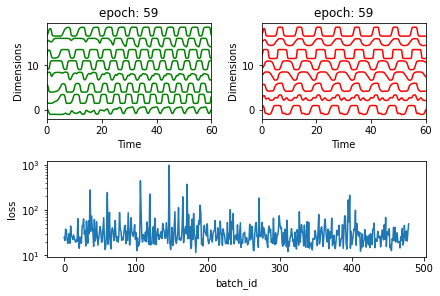

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.69238716 -0.00353758 -0.85674135  0.81639441  0.87204639  0.35347935
  -0.36082967 -1.06680766]
 [-0.14554507 -0.07233478 -0.26193069  0.46074308  0.97527099 -0.01415603
   0.23523221 -0.45702264]
 [ 0.87246629  0.95058268 -0.08135267  0.36991354 -0.57287442  0.47518318
  -0.21500357 -0.54527141]
 [ 0.76102106  1.13702826  1.15215274  0.65439066 -0.88325935  1.50096552
   0.91755596  0.7990145 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[-1.40185989 -0.15429068 -1.13183296  1.18782297  1.39080359  1.01459742
  -0.33224102 -0.92967651]
 [ 0.67420433  0.30313897 -0.20405688 -0.43012888 -0.33776875 -0.43277797
  -0.39143085 -0.08102386]
 [-0.01957989  0.16402612  0.04599406  0.38313473 -0.00385304 -1.00423784
  -0.13061215 -0.66751618]
 [-0.7769339  -0.34994525 -0.48094845  0.91600958  1.43032209  0.19884266
   0.10066224 -0.49664834]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[ 0.30328149  0.37010993  0.16522925  0.20976691 -0.24831387  0.16563056
   0.08629868 -0.04303347]
 [ 0.7514546  -0.43271599 -0.47216842 -0.95514299 -0.14825541 -1.18222704
  -0.25029464 -0.9743758 ]
 [-0.72048683  0.06603862 -0.26644568  0.62995702  0.68569811 -0.2281554
  -0.20209026 -0.80615192]
 [-1.00813248  0.07472637 -0.02861198  1.76714328  1.28534551  1.87336041
   0.77129412 -0.03079659]]


 38%|███▊      | 3/8 [00:02<00:04,  1.04it/s]

[[-0.07083054  0.42509892 -0.45198591  1.06216482  0.55095059  1.44043168
   0.13628414 -0.3033859 ]
 [ 0.65253166  0.48511969  1.29178247 -0.1051736  -0.70680441  0.91121283
   1.09652864  0.74739045]
 [ 0.02372381  0.31256008  0.26865869  0.87327714  0.27167928 -0.698045
   0.18245931  0.30772569]
 [-1.6966485  -0.59634813 -1.60032986  0.93396698  1.69618378 -0.66188994
  -0.94566033 -2.24655201]]


 50%|█████     | 4/8 [00:04<00:04,  1.02s/it]

[[ 0.17175213  0.13255179  0.21369132  0.20296334 -0.0858061   0.15662278
   0.34373987 -0.23178666]
 [-0.16950175  0.03417907 -0.61151263  0.75739331  0.41049262  0.18172253
  -0.0537768  -0.60151932]
 [-2.080024   -0.62237136 -1.64987629  1.17052023  2.33030228 -0.70150739
  -1.12124184 -1.55258213]
 [-0.50215098  0.26885694  0.16203378  0.9672839   0.53961379  0.33372689
   0.15738926 -0.32650997]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.02it/s]

[[ 0.21744098  0.35262283  0.46631999 -0.14288181 -0.38509493 -0.00754961
   0.27835828  0.20266305]
 [-1.69848727  0.11427604 -0.56329592  1.98342229  1.59780781  0.74494907
   0.00983804 -0.19445421]
 [ 1.02456543  0.57696382  1.53035417 -0.07715245 -1.22525718  0.26941769
   1.09037357  1.50296794]
 [ 1.57688514  0.79428119  1.00891239 -0.47062306 -1.36193409  0.29033582
   0.76267331  0.70473869]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[ 1.54895176  0.57189567  0.86136229 -0.20496117 -1.19664056  0.01429389
   0.52068809  0.72108486]
 [ 0.61828044 -0.1297422   0.30289654 -0.41329046 -0.23260029  0.37700957
   0.48683787 -0.52700853]
 [ 0.05317696 -0.05792006 -0.66143289 -0.15444976  0.512816   -0.3852002
  -0.2811876  -1.08510987]
 [-1.47268452 -0.34951757 -0.16059596  1.55620468  1.52745765  0.43550347
   0.32578744  0.29960051]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.02it/s]

[[ 1.3057045   0.64665999  0.74077174 -0.31847121 -1.01365537 -0.06799956
   0.4763867  -0.35245532]
 [ 0.44538116  0.70957543  0.82581238  0.73206288 -0.5817108   1.1070898
   0.76471224  0.58774532]
 [-0.53879258 -0.08487746 -1.21002457  0.23989435  0.7359709  -0.88968984
  -1.06488351 -1.53408049]
 [ 0.62302688  0.63883115  0.1462121   0.47898935 -0.19066795 -0.17185159
  -0.05583383  0.12291065]]


100%|██████████| 8/8 [00:02<00:00,  2.92it/s]


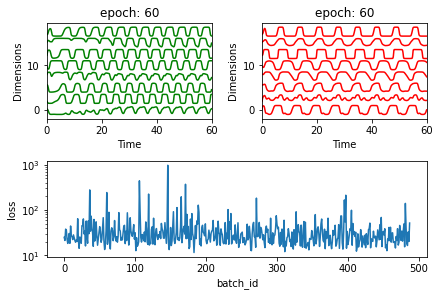

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.04066146 -0.24616776 -1.04041207  0.07143842  0.32663555 -0.81430825
  -0.63396492 -1.52592391]
 [-0.93897129  0.09155003  0.10970588  1.25934353  0.76686387  0.02659895
   0.19059409  0.23008929]
 [ 0.48419094  0.20175736  0.61878682 -0.05196132 -0.36056814 -0.7295611
   0.44393079 -0.03535848]
 [ 1.22434505  0.37939729  0.51070594 -0.4285457  -1.13418426 -1.07276848
   0.0196035  -0.39318543]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.12s/it]

[[-1.24143193  0.36016408 -0.20804818  1.77943284  1.25632088  2.19653744
   0.55123194 -0.37504755]
 [ 0.00719432 -0.2611795  -0.66122488 -0.57616855  0.02537978 -0.97161793
  -0.54163464 -1.1403982 ]
 [ 0.52062934 -0.02004476 -0.17667408 -0.55579177 -0.12716273 -1.27247836
  -0.26708607 -1.19478139]
 [-0.24419724 -0.1693639  -0.8002869   0.34427244  0.72787051 -0.36860229
  -0.28259281 -1.44686996]]


 25%|██▌       | 2/8 [00:02<00:06,  1.05s/it]

[[ 0.14723001 -0.06766186  0.03563865  0.04854354  0.10231831 -0.79014783
   0.05964534 -0.28061214]
 [ 0.35177711  0.31393919  0.38078571  0.18628974 -0.33419445  0.02052107
   0.15340841  0.11782358]
 [ 0.23481457 -0.012984    0.48438464  0.49834444  0.24571306  0.67334982
   0.86669528 -0.01524427]
 [-1.05001076 -0.22705758 -0.97641872  0.68143755  0.81980681 -0.32537811
  -0.56298543 -1.10810108]]


 38%|███▊      | 3/8 [00:02<00:05,  1.00s/it]

[[-1.23497509 -0.73088957 -1.33664804  0.18670303  1.19037536 -1.28839381
  -0.88022173 -2.11847377]
 [-0.1460407  -0.22779204 -0.56973186  0.08197617  0.30232439 -0.32059105
  -0.29514962 -1.43456406]
 [ 0.76287536 -0.02921706 -0.75995506 -0.30198192 -0.14368203 -0.25825203
  -0.34643349 -1.10993954]
 [ 0.47291865 -0.20017789 -0.24714845 -0.94705344 -0.43144829 -1.62079398
  -0.55244744 -1.83862439]]


 50%|█████     | 4/8 [00:03<00:03,  1.03it/s]

[[-0.35474978  0.10525747  0.00424803  1.38769561  0.81676837  1.68866972
   0.78198524  0.11118219]
 [-1.02221656 -1.01682333 -1.48652759 -0.41280198  1.20136301 -0.78195051
  -0.7657853  -2.02336747]
 [ 0.59453893  0.27721499  0.25900887 -0.11947075 -0.61036082  0.44575984
   0.35293848  0.03678121]
 [ 0.12505421  0.19617386  0.19261177 -0.18989277 -0.48766271 -1.28939539
  -0.05982099 -1.23128765]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.05it/s]

[[-0.13512558  0.3764366   0.05001657  0.35041796 -0.17720817 -0.15461471
  -0.00134757 -0.63014924]
 [ 0.9940113   0.93414497  0.87279483  0.24509163 -0.95584794  1.05110159
   0.60130373  0.55566235]
 [ 0.79471652  0.82499133  0.71506022  0.52701629 -0.7895204   0.95746447
   0.74867107  0.44883999]
 [ 0.4121882   0.37907604  0.3056807   0.52717589  0.21015907  0.45060489
   0.60807198  0.1667898 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.03it/s]

[[-1.22151603  0.58031643 -0.13901619  2.09520002  0.88477588  1.59773612
   0.2180942   0.45840333]
 [-0.86457543 -0.04746103  0.03166752  1.25592283  0.91106764  1.09178629
   0.59396943 -0.24068625]
 [ 0.90056612  0.7496559   0.86935318  0.19635107 -0.80223788  0.51203218
   0.65296275  0.5133294 ]
 [-0.44584678  0.31891151  1.11355118  1.03794496  0.36018789  1.52739329
   1.51830915  0.98772191]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.05it/s]

[[ 0.76406087  0.37987414  1.25302553 -0.20938222 -0.82509332  0.39331477
   0.9302997   1.29726237]
 [-1.25638508  0.01220886 -0.67932536  1.59375304  1.45822253  0.32462692
  -0.27833763 -0.2802949 ]
 [-0.57353639 -0.16583536 -0.61535406  0.55071753  0.83575736 -0.08535768
  -0.2094313  -0.69153676]
 [ 1.10082357  0.72936939  0.60964722 -0.28862662 -1.16494028  0.08227331
   0.25407262  0.04045753]]


100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


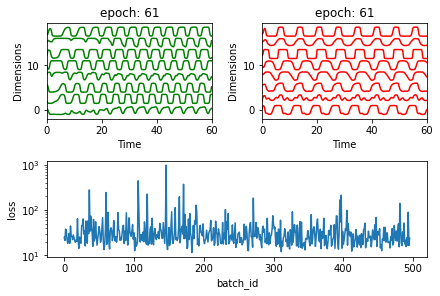

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.50579587  0.51290752 -0.04073798  1.7341536   0.47793527  0.42679239
   0.23597123  0.17498015]
 [ 0.37454963 -0.16797368  0.01563254  0.2479443   0.13383956 -0.57354905
   0.25484379  0.06523612]
 [ 0.17652459  0.10405147  0.10780613  0.52565712  0.085692    1.4446875
   0.76042418 -0.09225393]
 [-0.12011775 -0.01529098 -0.04190645  0.1588317   0.50169629 -0.63738509
  -0.07131887 -0.15268075]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[ 1.10858967  0.69846234  0.97686561 -0.37222182 -1.39313352 -0.08018372
   0.55989661  0.18151179]
 [-0.21175675  0.31969506  0.10996589  0.6496679  -0.00535315  0.16271466
   0.2255555   0.0581886 ]
 [ 0.37585761  0.79824665  0.43293982  1.2784068   0.13962536  1.67845655
   0.59192238  0.8901198 ]
 [ 0.02790522 -0.25604053 -0.44213098  0.01734749  0.33953761 -0.80622498
  -0.33106471 -0.72390233]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[ 0.12950304  0.53009797  0.15036068  0.91437263  0.12846817  1.08169831
   0.43140049 -0.03534928]
 [ 1.0735216   1.07096244  1.22940601  0.62104723 -1.04028655  1.32710947
   0.94620757  1.23612137]
 [-0.37325766 -0.17471868 -0.42617612 -0.20085088  0.39254757 -0.79339792
  -0.14644688 -1.08241905]
 [-0.2271881   0.19965288 -0.06922991  0.08138607  0.02362942 -0.0877907
  -0.0303814  -0.57420119]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[ 2.21573368  0.71269417  1.06556305 -1.17801377 -2.04346896 -0.58133341
   0.40709433 -0.42407999]
 [-0.07173153  0.25862745 -0.25212967  0.32860511  0.17691744 -0.82465876
  -0.38035471 -0.40483159]
 [-1.03773797 -0.53375306 -0.48733137  0.57256727  1.1722858   0.31601002
   0.17167969 -0.70089542]
 [-0.74776568  0.48796483  0.21070429  1.91161691  0.68986677  1.72339493
   0.63878952  0.46096819]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[-0.07251036  0.08891497 -0.3918402   0.56559238  0.36097619  0.02531516
  -0.30680944 -0.57186579]
 [-0.06624444  0.20798298 -0.01556115  0.39604566 -0.07982521 -0.7400687
  -0.1105498  -0.84654438]
 [-0.85888448  0.1559518   0.22000927  1.60062884  1.03587489  1.06323575
   0.67953377  0.22518853]
 [ 0.04185197  0.18990988 -0.14499376  0.44856173  0.28101704  0.99819941
   0.39812657 -0.64679624]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.08it/s]

[[ 1.50076956 -0.26315256 -0.38717357 -1.27960864 -0.71127644 -2.43893246
  -0.73954636 -0.84458793]
 [ 1.20182782  0.08602684  0.24235154 -0.71121305 -0.8586852  -0.85734261
   0.03636815 -0.66889781]
 [-0.46423525 -0.00496118 -0.03658198  0.27624715  0.14117762 -0.20357734
   0.04751087 -0.50565157]
 [ 0.05444308  0.34706786  0.27695817  0.36581543  0.04073861  0.59711791
   0.32505233 -0.14916408]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.07it/s]

[[ 1.65635214  0.97994576  1.30550609 -0.03018302 -1.34009161  1.7749213
   1.29175319  0.85132787]
 [-0.87003248 -0.33881168 -1.31015943  0.77008321  1.30356029 -0.1887628
  -0.85259418 -1.31871931]
 [-0.69839406  0.47371598  0.52920074  1.72007809  0.4944454   0.6292386
   0.57406995  0.25276052]
 [-0.75864996 -0.1312611  -0.3057274   0.83048454  0.94754586  0.04864844
   0.01064235 -0.21462327]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[ 0.33502985  0.30451684  0.45713085  0.45297164 -0.03570496  0.2564903
   0.47643983  0.29472926]
 [-1.28252603  0.04297591 -0.68513299  1.36000956  1.25270518  0.87586622
  -0.11721823 -0.72113447]
 [-0.50618282  0.41493382 -0.00645701  0.9910279   0.62280295  1.08097508
   0.29829277 -0.18434386]
 [ 0.041428   -0.32440625 -0.90999344 -0.4022842   0.31792891 -1.68850397
  -0.70459591 -1.64622502]]


100%|██████████| 8/8 [00:02<00:00,  3.24it/s]


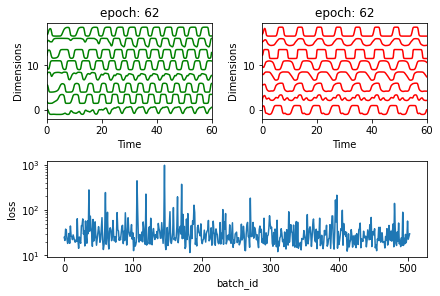

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.17281304  0.42621352  0.96953086  1.59523835  0.40673557  1.89769854
   1.19266895  1.53811711]
 [ 0.1777903   0.10403387  0.1396754  -0.32361079 -0.22212981 -0.9676453
  -0.06945959 -0.41516559]
 [-1.54656317 -0.05166377 -0.1376921   1.42141299  1.46396731  0.90818734
   0.55154758  0.18065411]
 [ 0.88861335  0.65661283  0.68610731 -0.11397673 -0.58936938 -0.22147464
   0.47322082  0.17895664]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.07it/s]

[[-1.47436102 -0.3639603  -0.97553997  1.14316161  1.84699639 -0.04890135
  -0.45695586 -1.1242949 ]
 [-0.27437294  0.0281427  -0.55821319  0.9390434   0.59520823  0.14266616
  -0.22377816 -0.57672215]
 [ 0.61343705  0.07464807  0.04474527 -0.4220805  -0.12089447 -0.4001288
  -0.03922122 -0.15818766]
 [ 0.15767662  0.26285221  0.18460802  0.59614865 -0.02119618  1.14582152
   0.54742811  0.15911046]]


 25%|██▌       | 2/8 [00:01<00:05,  1.09it/s]

[[ 0.20307543  0.25098467  0.59883417  0.76596739  0.10790441  1.11579843
   1.03727735 -0.05971763]
 [ 0.83285384  1.16661336  1.22174851  0.72798125 -0.95299506  1.4517971
   1.10333764  1.10158175]
 [-0.11326754  0.54389118  0.60176093  1.005279    0.13504748  1.29775505
   0.71126793  0.64222663]
 [-0.28086137 -0.15394938 -0.90659825  0.51476183  0.79520833 -0.46724881
  -0.27480496 -1.68659593]]


 38%|███▊      | 3/8 [00:02<00:04,  1.10it/s]

[[ 0.74883408  0.44815271  1.16738637  0.93040407 -0.30577906  0.69433909
   1.24873653  1.28712909]
 [ 0.0356504  -0.30346298 -0.71950849 -0.47561174 -0.11119679 -1.52158733
  -0.73295863 -1.75074683]
 [ 1.14986481  0.84982159  0.7069731   0.00961633 -0.96863246  1.00658823
   0.74810601  0.86735893]
 [-1.43201974  0.06611477 -0.74845502  1.31588199  1.45015776  0.50757401
  -0.29277289 -1.01257347]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 50%|█████     | 4/8 [00:03<00:03,  1.10it/s]

[[-0.6689363   0.43783047  0.10713122  1.38891846  0.88906099  1.42278771
   0.49755998  0.28348784]
 [-2.34933618 -1.1425896  -2.23136325  1.53147228  2.75535971 -0.18332816
  -1.12309828 -2.20209846]
 [ 1.25564888  0.28888071  0.2996964  -0.83014656 -0.92066243 -0.93479971
  -0.16816319 -0.48565517]
 [-0.0873779   0.03130315 -0.28662024  0.20672782  0.22044279 -0.75520758
  -0.32083458 -0.62954582]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[ 0.55430417  0.26534166  0.30663432  0.03466937 -0.43012464 -0.77411848
   0.1177791   0.36722099]
 [-0.23267646 -0.09221141 -0.22152312  0.48462989  0.12483371  0.29750438
   0.07263006 -0.67777516]
 [-0.19944405  0.0697365  -0.16883441  0.86939965  0.65902178  0.6660188
   0.24387928 -0.60596162]
 [-1.04160723  0.47813924 -0.16572037  2.31388595  0.97332706  1.85899378
   0.2272121   0.83936332]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[ 0.06306509 -0.37919828 -0.69012807 -0.17564893  0.48607432 -0.75924277
  -0.47676112 -1.1452905 ]
 [-0.47927474  0.25696735 -0.46486566  0.80700533  0.5288883  -0.18661713
  -0.36936521 -0.19447526]
 [ 0.07543005  0.22521328 -0.13016696  0.73104637  0.45691282  0.16934905
   0.14088589 -0.04396668]
 [ 0.22539453  0.29276736  0.8577479  -0.17186552 -0.60631725  0.12247666
   0.69720657  0.10672378]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.08it/s]

[[ 0.09756273 -0.88648735 -0.26259079 -1.2274507  -0.29653544 -2.12901553
  -0.28218723 -1.12626657]
 [-0.36746431 -0.45874379 -0.80988612 -0.05009846  0.74700962 -1.02330749
  -0.51301633 -1.36838707]
 [-1.60870269 -0.60741737 -0.48464776  1.1342294   1.65649802  0.25766207
   0.2122893  -0.33321961]
 [-0.1051677   0.00889367 -0.08462462  0.03397603  0.25028264 -0.80080555
  -0.36283725 -0.50388725]]


100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


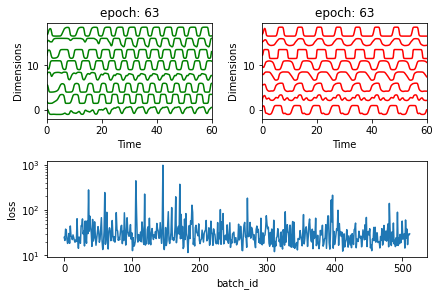

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.24895829 -0.01726276 -0.33735525  0.03970184  0.34606732 -1.17299782
  -0.37194656 -1.02272202]
 [ 0.1745904   0.56747154  0.60083808  1.03583584 -0.07824071  0.84496621
   0.71609251  0.25988779]
 [ 0.95817997  0.12294679  0.02866626 -0.67539398 -0.89716388 -1.10067896
  -0.37423003 -0.89003067]
 [-1.42379971 -0.32999374 -0.45807218  1.08891578  1.35862527 -0.32938105
  -0.17204359 -0.7717029 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.08it/s]

[[-0.28939824  0.02729598 -0.53345907  0.40035884  0.55845888  0.63973188
  -0.03503535 -1.2594706 ]
 [-0.69822947 -0.4291007  -0.22819399 -0.31657793  0.31297543 -0.68259127
  -0.02235768 -1.14885968]
 [ 0.12440604 -0.52718957 -0.7559822  -0.80594425  0.23917779 -1.9218307
  -0.78612528 -1.41009892]
 [ 0.6625932   0.80689813  0.95178642  1.00534805 -0.12506107  1.75562735
   1.05286679  1.13296494]]


 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[ 0.79957685  0.33466283  0.71356853 -0.14562651 -0.81659015 -0.84632319
   0.37696129  0.27636982]
 [ 0.87011639  0.62944178  1.05072936  0.13885769 -0.78900694  0.86204998
   1.01073033  0.67775629]
 [-0.78902582 -0.10921973 -0.82796001  0.6595115   0.9425425  -0.07383492
  -0.53109307 -0.64878897]
 [ 0.12372618  0.10191641 -0.27575963  0.82674412  0.41332348  0.22106925
   0.04178892  0.15170281]]


 38%|███▊      | 3/8 [00:02<00:04,  1.06it/s]

[[ 1.10042416  0.4613174   0.1422291  -0.53688459 -0.88738369 -1.00344256
  -0.26013438 -0.79918685]
 [-0.79686823  0.2758041  -0.36819179  1.13433163  0.96502431  0.46101946
  -0.03079192 -0.27459885]
 [ 1.29474055  0.5139      0.48365036 -0.16554665 -1.04669357 -0.42626409
   0.11134628  0.42125251]
 [-1.27726969  0.39218333  0.06496029  2.17187445  1.64582919  1.86514016
   0.73683606  0.33659347]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[ 1.05969434  0.76952027  1.08877689  0.0077885  -1.3002396  -0.64894824
   0.52982952  0.31261172]
 [-0.81029339  0.09539147 -0.48060021  0.88803784  0.6312035   0.05179183
  -0.19217557 -0.79438334]
 [ 0.75365797  0.86047154  0.3364351   0.55680575 -0.47771481  1.38268422
   0.46812887  0.37383044]
 [-0.03282629  0.24322552 -0.06084321  0.73236668  0.34129487  0.30704436
   0.30052734 -0.30029839]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[ 0.16907792 -0.00705859 -0.17434884  0.16136412  0.02977139 -0.17333281
  -0.02083773 -0.84382592]
 [ 0.13977158  0.10049708  0.4072214   0.75136596  0.10986325 -0.46663256
   0.40465956  0.35931558]
 [ 0.62475841  0.42523432  0.68492914 -0.39480344 -0.63392258 -0.46749931
   0.3644193  -0.41872263]
 [-0.02133511  0.05072869  0.17441214  0.10833047  0.14670845 -0.96734691
   0.04445847 -0.44331667]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[-5.98438574e-01 -8.77774282e-01 -1.63967654e+00 -1.65128877e-01
   1.09565363e+00 -1.07732877e+00 -8.70520705e-01 -1.97339023e+00]
 [ 9.38966331e-02  2.72380951e-01 -1.10627189e-01  1.50835089e-01
  -7.03172101e-02  2.55118600e-01 -6.22729274e-02 -2.79064195e-01]
 [ 1.68716840e+00  1.34877226e+00  1.65853332e+00  1.70364104e-01
  -1.45978448e+00  2.15339849e+00  1.41756855e+00  1.14739874e+00]
 [ 1.25528433e+00  6.14425361e-04  5.69269859e-02 -1.51488628e+00
  -1.11561863e+00 -2.89979676e+00 -6.56537436e-01 -9.96311066e-01]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[-1.84014124  0.15074418  0.1546853   1.84868324  1.56174941  0.97506836
   0.46613124 -0.27194699]
 [ 0.72469919  0.29301629  0.51041259 -0.3209329  -0.6540917  -0.981384
   0.15949139 -0.33565662]
 [-0.02294583  0.40311565  0.67355974  0.45916145  0.07594149  0.21413783
   0.45350916  0.55296438]
 [ 0.00238836  0.02323177  0.156417    0.795694   -0.01518395  0.93054119
   0.59885145  0.28990921]]


100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


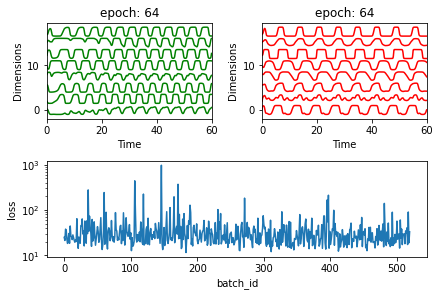

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.25955354  0.0146573   0.02207506 -0.08053567 -0.01840358 -1.72968273
  -0.34420673 -0.28236677]
 [-1.16189213 -0.3512845  -0.68913655  1.20669278  1.34522308  0.29933618
  -0.03957066 -0.90190409]
 [-0.89844308 -0.10913893 -0.58428021  1.12162396  0.88309639  0.17967519
  -0.06348937 -0.94810897]
 [-0.16230825  0.19589506 -0.60139278  0.19110508  0.36771366 -1.26379312
  -0.6456151  -1.06197121]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.07it/s]

[[ 1.33622681  0.2325879   0.72395275 -0.62167331 -0.98568062 -1.14014706
   0.30704668 -0.11496751]
 [ 1.52821059  0.94434284  1.3474361   0.12610555 -1.27066688  1.3736735
   1.28909056  1.42486949]
 [-0.91721035  0.19908548  0.00727261  1.16943101  0.71398548  0.04815634
  -0.00435878 -0.03035986]
 [-0.88940324 -0.63932349 -0.89063279  0.32418314  1.23347964 -1.48036438
  -0.70719235 -0.74622238]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[ 1.08714853  0.35180494  0.22664943 -0.384138   -0.66765207 -0.07619446
   0.13098663 -0.11806295]
 [-0.70638222 -0.38633851 -0.23641776  0.77276333  0.72222647  0.45258226
   0.14229093 -0.72046322]
 [-0.69009026 -0.14242772 -1.09667429  0.26592748  0.76601292 -0.49249215
  -0.70919158 -1.81880027]
 [ 0.12820691  0.05378653 -0.08837955  0.1855723   0.14654885  0.00669041
   0.14585663 -0.40279839]]


 38%|███▊      | 3/8 [00:02<00:04,  1.08it/s]

[[-0.3895455  -0.44298772 -1.41081175 -0.25401568  0.75935708 -0.99542582
  -0.9272395  -2.14480472]
 [-0.08119895  0.59397462  0.36721407  0.79118936 -0.40707284  0.92364316
   0.47180136  0.56935049]
 [-0.39667479 -0.32521419 -0.74099033 -0.18772073  0.60644057 -0.58461075
  -0.42526442 -1.28171633]
 [-1.14412734  0.02130065 -0.17726734  1.73494553  1.41251194  1.56425154
   0.40074472 -0.11587005]]


 50%|█████     | 4/8 [00:03<00:03,  1.04it/s]

[[ 6.39365327e-01  2.94224122e-01  3.17521033e-01 -3.06053606e-02
  -3.18790893e-01  2.75817162e-01  3.73881693e-01 -1.75780359e-01]
 [ 1.42492126e-01  2.79684092e-01  3.68133495e-01  6.06550956e-01
  -1.60974029e-01 -5.59947835e-01  2.04039022e-01  3.33453630e-01]
 [ 6.94506758e-02 -1.95586846e-02 -3.49767369e-01  1.33324055e-01
   7.17526108e-05 -5.21000795e-02 -1.73913818e-01 -7.52775905e-01]
 [ 7.59160235e-01 -4.12261715e-02 -5.57155400e-01 -6.12300477e-01
  -2.68114802e-01 -1.85813018e+00 -7.43605464e-01 -8.90991434e-01]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.01it/s]

[[-0.78121123  0.24164401  0.23290458  1.42088573  0.47416325  0.90843322
   0.55853207  0.33446413]
 [-0.71723626 -0.08272301  0.24637074  0.53971494  0.44206812  0.0273385
   0.42840497 -0.59764191]
 [-1.01675507 -0.23598557 -0.95879149  0.79146923  1.35893018 -0.29920978
  -0.56396194 -0.71210496]
 [-0.0694664  -0.81911672 -1.44045108 -0.40822997  0.72203659 -1.56088727
  -0.91781772 -2.30783601]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[-1.02647599  0.24143193 -0.09715848  1.72171785  0.85882467  1.4064273
   0.52345716 -0.12875877]
 [ 1.20638216 -0.26535496 -0.24354962 -1.0453918  -0.63893748 -1.81196724
  -0.3287568  -1.27780398]
 [-0.89391583 -0.10698947 -0.18902841  0.77725649  0.80712426  0.82394608
   0.43096605 -0.58026896]
 [-0.46128933 -0.25308889 -0.83396295  0.27520353  0.5507481  -1.194045
  -0.70059089 -1.07629403]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[ 0.38023116  0.2990244   0.08744655  0.12728864 -0.01898758 -0.31124308
   0.02046235 -0.44784148]
 [-0.50395594 -0.24356258 -0.47915286  0.18439113  0.76601499 -0.07566565
  -0.31556422 -0.03035081]
 [ 0.29190688  0.48162516  0.88205785  0.79399979  0.01887771  0.21665396
   0.78852827  1.09234829]
 [ 0.32944832 -0.529674   -0.88351955 -0.76735998  0.14098235 -2.55129811
  -1.06111463 -1.67978431]]


100%|██████████| 8/8 [00:03<00:00,  2.54it/s]


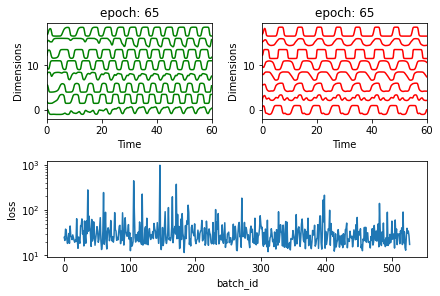

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.30861697  0.00846905 -0.30754346  0.67916132  0.51495237  0.02616154
   0.02421122 -0.29889841]
 [ 1.30735809  0.16721696 -0.09807581 -0.96709446 -1.12190256 -1.33656938
  -0.39994242 -0.85434986]
 [ 0.20333299 -0.54696029 -1.10550298 -0.53785543  0.24692633 -1.78634396
  -0.85382292 -1.90337012]
 [-0.22766631 -0.6056829  -0.0907004  -0.36803998  0.55994293 -1.72783395
  -0.0843609  -0.50502783]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.04s/it]

[[-0.09960725  0.48561496 -0.23626843  0.98626647  0.44831213  0.63540952
  -0.08311365 -0.54117854]
 [-1.07349527 -0.37995147 -0.89360964  0.70105703  0.95711942 -0.3346272
  -0.42151412 -1.28971299]
 [-1.60112119 -0.56034376 -0.72691226  1.01690216  1.43541723 -0.0217364
  -0.23977444 -0.93549303]
 [ 1.30931382  1.00503111  2.05853699  0.33579003 -1.42948917  1.88765699
   1.77084251  1.78221482]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:06,  1.00s/it]

[[-2.02168991 -0.6622028  -1.50456944  1.25624664  2.21868981 -0.59264522
  -0.76756547 -1.14305467]
 [ 0.82488365  0.43482827  0.10257173 -0.15421877 -0.53499955  0.2271546
   0.08076562 -0.29694486]
 [-0.04110701 -0.00936311  0.31731352  0.37362884  0.25486239  0.64516444
   0.69105248  0.0232947 ]
 [ 1.00462187  0.70732406  1.21050488  0.69537208 -0.54473923  1.00043743
   1.0561633   1.3872791 ]]


 38%|███▊      | 3/8 [00:02<00:04,  1.03it/s]

[[-0.21861     0.36403195  0.54025284  1.05015082  0.26695873  0.37207817
   0.46987173  0.88164496]
 [-0.85250216  0.18512679 -0.10381838  1.37377147  0.85192523  1.50975485
   0.40575141  0.35583694]
 [-0.29945398 -0.22396229 -0.57996711  0.43854477  0.76709017 -0.63091158
  -0.17024332 -0.81676805]
 [-0.58334141  0.50844797  0.38524061  1.71461035  0.68299864  1.2265999
   0.59005016  0.71907212]]


 50%|█████     | 4/8 [00:03<00:03,  1.06it/s]

[[-2.36354066 -0.56917422 -1.86176076  1.67378663  2.38520854 -0.07360358
  -1.00362978 -1.61999136]
 [-1.28770561 -0.30941089 -0.5919111   1.08166347  1.38592451 -0.66432625
  -0.27821074 -1.01751352]
 [ 0.9446722   0.5732306   0.92983451 -0.04679345 -0.99980515  0.65496908
   0.81657599  0.68330079]
 [ 1.26643005  0.4867196   0.50488537 -0.72328012 -1.08711682 -1.17722329
  -0.04463669 -0.07003804]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[ 0.83632279  0.03345629  0.00535834 -0.82846073 -0.69441322 -0.64174131
  -0.14447678 -0.283831  ]
 [-0.16674128 -0.39762316 -0.7107205   0.57699227  0.84191467 -0.04192822
  -0.17806383 -0.21397135]
 [ 0.54224642  0.51992504  0.19399983  0.02318568 -0.63139247  0.02529642
   0.16609075 -0.41533052]
 [ 1.15552929  0.36245875  0.65307617 -0.61097214 -0.69361715 -0.56499093
   0.28646322 -0.24886898]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.08it/s]

[[-2.12215461 -0.5457756  -1.73657824  1.49472158  2.45788376  0.02664265
  -0.95202166 -1.36960971]
 [ 0.1735266   0.06772501 -0.52105293  0.09544262  0.17614488 -0.4437221
  -0.25536779 -0.75298127]
 [ 0.73237449  0.23973713  0.93569174  0.37986879 -0.25496229  2.21663879
   1.49971243  0.76822731]
 [-0.60431454  0.32089843 -0.06220572  1.24602329  0.68303856  1.54906066
   0.48767059 -0.3792054 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[ 0.36084616  0.06620227  0.14920327  0.24024483 -0.10617667 -0.02609172
   0.13795188  0.06136835]
 [-1.63546416 -0.41632206 -1.9460128   1.22471247  1.8374325  -0.5228623
  -1.28364738 -2.12060961]
 [-0.59671973  0.12685675 -0.2247834   0.85256855  0.54890489  0.19628517
  -0.17347967 -0.12505076]
 [-2.95696813 -0.59058031 -1.60921068  1.54021266  2.77302293 -0.75730773
  -1.05248742 -1.67819699]]


100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


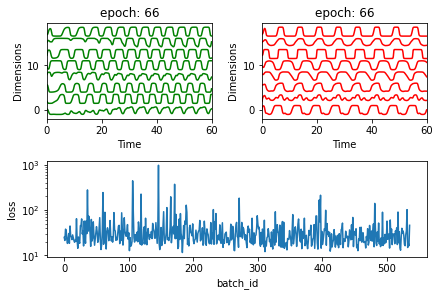

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.53517996  0.13886634  0.02867739  0.14410732  0.09855227 -0.51775354
  -0.10472926  0.12659234]
 [ 1.1416562   0.45892603  0.58294268 -0.27422574 -0.70651223 -0.37721846
   0.42254127 -0.17274946]
 [-0.48646786  0.35309936 -0.50948939  0.74912002  0.5337771  -0.21739988
  -0.52363291 -0.52866405]
 [ 0.88413988  0.29190987 -0.29908034 -0.16106767 -0.4840616  -0.42575014
  -0.19922457 -0.99294059]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.09it/s]

[[-0.18459783 -0.14291753 -0.796243    0.12539405  0.43637093 -1.04800301
  -0.49295935 -1.39488947]
 [-0.16771119  0.02886634 -0.10610196  0.21700708  0.39228024 -0.11780974
  -0.05326354 -0.82440325]
 [-0.14659071 -0.04747826 -0.14464326  0.31359017  0.11039335 -0.31523825
   0.07732927 -0.29504236]
 [ 0.61325411  0.32957888  0.84436818 -0.45010307 -1.02080347  0.21640884
   0.75319209  0.13675994]]


 25%|██▌       | 2/8 [00:01<00:05,  1.10it/s]

[[ 0.09767401  0.00384603  0.4363966  -0.07988162 -0.27994696 -0.22206395
   0.37331425 -0.41770892]
 [ 0.56913187  0.38880331  0.27978428  0.50095885 -0.23324512  0.89888888
   0.5640222   0.06562815]
 [-0.4910333   0.05541259 -0.17335072  0.89185744  0.48973439  0.14093201
   0.17373242 -0.57182939]
 [-0.72813109 -0.70148033 -0.4579718   0.00787566  0.72882352 -1.10184749
  -0.21259484 -1.04920747]]


 38%|███▊      | 3/8 [00:02<00:04,  1.11it/s]

[[ 0.26271968  0.42404833  0.49915966  0.90415097 -0.07210388  1.37102417
   0.84772903  0.33103533]
 [-0.33637845 -0.33256897 -0.4078157  -0.21022458  0.45640087 -1.31477575
  -0.4262294  -1.56843546]
 [-1.26776277 -0.18813194 -0.89350151  1.03241071  1.29484678 -0.29797208
  -0.49418555 -1.64030903]
 [ 0.80887532  0.11967078  0.4380404   0.02785894 -0.22742259 -1.15069944
   0.04268181  0.33394373]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[-4.48319920e-01  9.12543396e-01  5.53903850e-01  2.03363276e+00
   6.80093522e-01  1.89450766e+00  9.01147935e-01  1.41781962e+00]
 [-9.62594336e-02 -1.04700312e-01  1.46737153e-01 -1.55109513e-01
  -1.57399389e-01 -4.37971654e-01  4.03704192e-04 -1.02532279e+00]
 [-1.42763959e+00 -1.65131035e-01 -2.34419378e+00  1.63408716e+00
   2.05158549e+00  6.90104041e-01 -1.14857378e+00 -2.35179117e+00]
 [-3.64547544e-01 -1.33417670e-01 -4.95833044e-01 -5.28808151e-01
   1.68686694e-01 -2.28498320e+00 -8.83571456e-01 -1.19933115e+00]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[-0.22805126 -0.21490922 -0.60739959 -0.03353768  0.41799742 -0.05732291
  -0.40596793 -1.44659452]
 [ 1.70995551  0.82618802  1.11791107 -0.02667553 -1.50337547  0.71875808
   1.06577131  1.00954833]
 [-0.16546998 -0.12197324  0.17043917  0.92151545  0.43699829 -0.21803346
   0.37648919  0.16200877]
 [ 0.70451168 -0.07907886 -0.14924045 -0.69948211 -0.48570904 -0.77605087
  -0.10201856 -0.94620556]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.10it/s]

[[ 0.24585966  0.31098797  0.26801025  0.6019595  -0.09894201  0.29078632
   0.35925155 -0.11880641]
 [ 0.99816047  0.35650638 -0.02573731 -0.50791455 -0.7891748   0.01128782
   0.07591767 -0.42977157]
 [ 1.79084941  0.34709079  0.47117056 -1.14011408 -1.35329237 -0.51109905
   0.10861568  0.1123215 ]
 [ 0.38700036  0.16447749  0.15396164 -0.34706104 -0.02327833 -0.61957247
  -0.12147867  0.07239736]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.11it/s]

[[ 0.3509957   0.31896177  0.4202427   0.7221616   0.15510406  1.0859199
   0.66505299  0.86405601]
 [ 0.17420298  0.64256553  1.55321376  1.04263922 -0.30381897  1.28154099
   1.47569411  1.59802928]
 [ 0.90379184  0.5510179   0.6386268   0.03378883 -0.60246382  0.93786998
   0.64794741  0.15618121]
 [-0.40854776 -0.22389994 -0.20311067  0.39638877  0.57127863 -0.11915481
   0.14188715 -0.6495681 ]]


100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


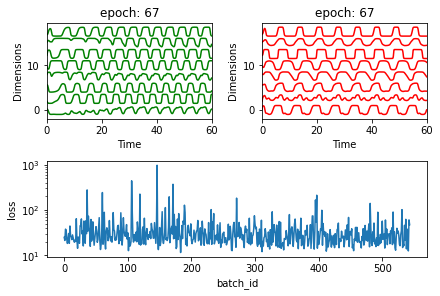

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.06007533  0.28880574  0.63754176 -0.42598548 -0.86080115 -1.03986822
   0.15423733  0.30617956]
 [-0.80622705  0.34102581 -0.35496999  1.65522327  1.19894461  0.93158815
  -0.0164573  -0.00950034]
 [ 0.25286144 -0.2984498  -0.72952089 -0.62747393 -0.05159561 -0.55317022
  -0.50052694 -1.74780556]
 [-0.35789165  0.19077908  0.0235225   1.11869597  0.59822593  0.99383657
   0.41137287  0.45745339]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.05s/it]

[[-1.35906061 -0.05790297 -1.23047333  1.28138607  1.3379661   0.66523561
  -0.57345999 -1.00296816]
 [ 0.5678964   1.18819734  0.97177419  1.24373766 -0.59000659  3.03209939
   1.18097667  1.447919  ]
 [-0.17641393  0.33462051  0.28277125  0.8681615   0.19601515  0.69781943
   0.21914006  0.36722565]
 [-1.46687957  0.23914717 -0.7478363   1.52012116  1.19309764  0.71747458
  -0.26124799 -1.0061456 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.00it/s]

[[-1.31995987 -0.02239317 -1.19491356  1.21108115  1.13609411 -0.40756336
  -0.88335669 -1.34756611]
 [ 1.28659099  0.09072861  0.85543231 -1.07135584 -1.15312597 -1.6457047
   0.27847897 -0.35262408]
 [ 0.32605787  0.82711358  0.64563902  0.82930572 -0.34902675  1.1454591
   0.66691807  0.27994487]
 [-2.33087102 -0.18415493 -1.30482363  2.25205897  2.44154184  1.61925083
  -0.2123621  -0.76508734]]


 38%|███▊      | 3/8 [00:02<00:04,  1.03it/s]

[[ 0.2014734  -0.14884661  0.17416462 -0.25120083 -0.13089149 -0.51584893
   0.20584292 -0.55375823]
 [-0.0988027   0.75487747  0.52220742  1.20621141  0.07773792  0.94797899
   0.61882408  0.78652879]
 [ 0.98876436  0.11057639 -0.19013328 -0.17576604 -0.13099393 -0.98123729
  -0.12107064 -0.77913148]
 [-1.49194303 -0.34748662 -1.07481093  1.1569524   1.66173349 -0.09986898
  -0.73068956 -1.03213553]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 0.66391824  0.56597231  1.11294007  0.05368664 -0.5464896   0.95326731
   0.97744742  0.92920107]
 [-0.07097085 -0.10271812 -0.78506147  0.45412832  0.54356539  0.15545788
  -0.31123254 -1.12194407]
 [ 0.20862481  0.36272521  0.58317274  0.24527293 -0.21882642  0.55919972
   0.66271551  0.33574523]
 [-0.50328138 -0.02754227  0.08940855  0.72257423  0.69408758  0.11842911
   0.34505191 -0.04846058]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[-1.67825471 -0.38153481 -0.96306943  0.87432591  1.47348209 -0.7466355
  -0.53996863 -1.2744589 ]
 [-0.41068838  0.4877655   0.59423982  1.45611318  0.59745946  1.86454606
   1.15664852  0.78324612]
 [-0.1339021   0.57292251  0.26066936  1.21200645  0.31365889  0.63673263
   0.40288236  0.2850159 ]
 [-0.18108875  0.115672   -0.27161446  0.18891196  0.20481315 -0.19829253
  -0.16443031 -0.81867775]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[ 0.29632006 -0.03834581  0.28690174  0.39707449  0.15510394  1.01287289
   0.65632342  0.0868056 ]
 [-0.01702709  0.15614773 -0.1978782   0.56240682  0.24376211  0.58248685
   0.14699774 -0.33629872]
 [ 0.89247716 -0.07815476  0.10548297 -0.41423265 -0.40969118 -0.26081514
   0.16906335 -0.10647131]
 [-1.33623245 -0.27873626 -0.80598662  1.20253346  1.87384514 -0.17996433
  -0.31850282 -0.63453209]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[ 0.16187894 -0.09620538 -0.65235424  0.06767161  0.16071652 -0.87052097
  -0.51029271 -1.24962026]
 [-0.78835022 -0.11728804 -0.40075047  0.99237056  1.15357852  0.51534714
   0.03374005  0.00220519]
 [-1.18906946 -0.04937383  0.28461895  1.02115375  1.04221787  0.61753891
   0.45375422  0.36334664]
 [-0.18483769 -0.38833045 -0.84547415 -0.25463897  0.67417247 -1.53687712
  -0.72464092 -1.3681392 ]]


100%|██████████| 8/8 [00:02<00:00,  3.23it/s]


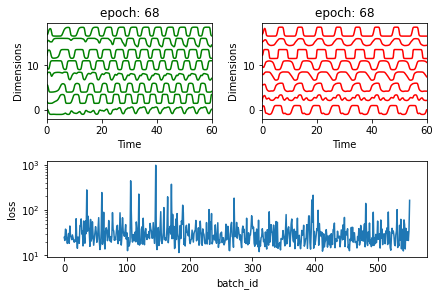

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.06062368  0.19989437 -0.04024719 -0.84136211 -0.94737523 -0.85525783
  -0.23676424 -1.16600047]
 [ 0.53395501  0.64542888  1.59924178  0.31913513 -0.64962292  1.30406688
   1.54891725  0.7369004 ]
 [ 1.39253865  0.20078118  0.41476152 -0.86049389 -1.17585608 -1.37088849
  -0.02917316  0.04051351]
 [-0.80860116 -0.01482894  0.18230101  0.99658654  0.84034537  0.26991721
   0.39409236  0.00174955]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.07it/s]

[[ 0.63288941 -0.05628819  0.00583598 -0.42768436 -0.05439581  0.06433958
   0.04033117 -0.10857895]
 [ 0.00533586  0.04195079 -0.08136961  0.61542871  0.50524741  0.74120126
   0.3549888   0.14926205]
 [ 0.88395353  0.18695438 -0.21361884 -0.71775065 -0.93372883 -0.67601863
  -0.46262443 -0.42577641]
 [ 0.67683762  0.35394666 -0.09376721 -0.08719347 -0.35950985 -0.40303269
  -0.28240003 -0.5511028 ]]


 25%|██▌       | 2/8 [00:01<00:05,  1.08it/s]

[[ 0.97199668  0.70448804  0.73844055 -0.10007293 -1.01711347  0.75230086
   0.50557284 -0.09851799]
 [-0.22086272 -0.01900764 -0.70854573  0.65851479  0.58182514  0.18953526
  -0.48738996 -0.50091531]
 [-0.44499881  0.30347625 -0.2112687   0.93579525  0.55109093 -0.15929972
  -0.12265117  0.23920076]
 [ 0.19257211  0.39432003  0.62441274  0.57847515 -0.23168049 -0.00902665
   0.60646395  0.57344868]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[-0.60416147 -0.3813918  -0.20508852  0.63144393  0.78673774 -0.11858153
   0.32945788 -0.49629508]
 [-0.39273171 -0.09178585 -0.09893304  0.59059635  0.31521664  0.6625758
   0.43101843 -0.67870789]
 [-0.93181192  0.46958873 -0.27706152  1.01002763  0.70469741 -0.0496597
  -0.56165053 -0.71772034]
 [ 0.34333569 -0.29422888 -0.56981089 -0.94122971 -0.06933285 -1.80467962
  -0.71455029 -1.06789698]]


 50%|█████     | 4/8 [00:03<00:03,  1.08it/s]

[[ 0.57856368  0.83877709  0.70100313  0.81750816 -0.17004012  0.91856645
   0.61405107  0.65247823]
 [-0.1547822  -0.50802712 -1.70780276 -0.41270054  0.54219694 -1.43841818
  -1.3624519  -2.29194848]
 [ 1.21220624  0.20328456  0.29693726 -0.64881431 -0.81079727 -1.43880723
   0.04458798 -0.34880313]
 [-0.61605297 -0.57995753 -0.24390416  0.64857157  0.84594022  0.23296509
   0.42027992  0.2381075 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.09it/s]

[[ 0.50383209 -0.01528024 -0.70066998  0.01459208  0.04719603 -0.37530844
  -0.3505542  -1.16849278]
 [ 0.113627    0.12336234  0.2875216   0.07200664  0.06240836 -0.33378912
   0.27676139 -0.26227288]
 [ 0.00214572  0.41367343  0.84296702  1.0124867   0.33804013  1.05994584
   1.01124012  0.90194799]
 [-0.6460863  -0.05943391 -0.05515442  0.74592188  0.80155503  0.00988438
   0.3832769  -0.2579805 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.10it/s]

[[ 1.27653937  0.39096403  1.20148518 -0.66643643 -1.38539901 -0.10124215
   0.77495699  0.43766304]
 [-0.74226571 -0.21733969 -0.02151121  1.09344616  1.19391152  1.06405578
   0.70587672  0.12172982]
 [ 0.28860016  0.21405962  0.0313743   0.42331198 -0.27007416  0.27690211
   0.18742123 -0.06402002]
 [-0.15560495  0.14019178  0.53330135  0.75577677  0.16383303  0.39968828
   0.65059542  0.31090537]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.09it/s]

[[ 0.37854808  0.65343465  1.3323191   0.63465432 -0.55115506  0.81343302
   1.18351428  0.89280458]
 [-0.27121212 -0.25205677 -0.37029584  0.09719611  0.62184361 -1.06344126
  -0.25497317 -0.84426508]
 [ 0.17588826  0.15064836  0.33438545  0.14924815 -0.13340509 -0.8015787
   0.21125218 -0.03972128]
 [ 0.10155063  0.32022732  0.9064692   0.42524841 -0.10806102 -0.02007718
   0.67726166  0.54264416]]


100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


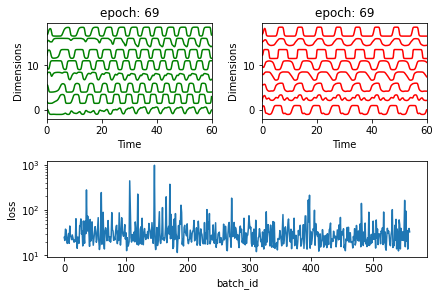

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.08292328  0.02174584 -0.7091398   0.05835415  0.3510677  -0.52316537
  -0.68612213 -0.71511508]
 [ 1.13118192  0.4130757   0.85386792 -0.34736821 -0.96688271  0.15135464
   0.63913464  0.39365777]
 [-1.74292057 -0.05571158 -0.81691284  1.39078363  1.48491756  0.62953564
  -0.24523154 -1.00273128]
 [ 0.98157036  0.25982517  0.94617386 -0.30561574 -0.79116052 -0.39506025
   0.76850408  0.28779435]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.07it/s]

[[ 0.47652789  0.42118992  0.60813328  0.21346495 -0.37259849 -0.35549638
   0.42975096  0.39967369]
 [-1.11346806 -0.05464985 -0.69104127  1.29177628  1.29806456  0.70667016
  -0.07034996 -0.56476126]
 [-0.96334412 -0.48909499 -1.63441116  0.21815002  1.23130746 -1.25934228
  -1.30910338 -2.08672206]
 [-0.52709786 -0.00955732 -0.77103832  0.7895955   0.64440303  0.96501963
  -0.23237723 -1.31983232]]


 25%|██▌       | 2/8 [00:02<00:06,  1.02s/it]

[[ 0.27563897 -0.15788016 -0.83544031 -0.0064743  -0.02237794 -0.71589122
  -0.59590274 -1.25734492]
 [ 1.84402712  0.58302616  1.53857401 -1.29426139 -2.09030676  0.01987144
   1.08184158  0.70353036]
 [ 0.69397041  0.69039158  0.43328006  0.51743286 -0.62709794  0.36987002
   0.48739458  0.21360841]
 [ 0.75316857 -0.05806345 -0.73785558 -0.19044456  0.10318685 -0.11787476
  -0.33165997 -0.86625114]]


 38%|███▊      | 3/8 [00:03<00:05,  1.03s/it]

[[-0.0720677   0.30849264  0.00651883  0.88076682  0.03319765  0.15825115
   0.04740018 -0.02607913]
 [-0.08926528  0.81987519  0.72546022  1.34501081  0.18406362  2.27306451
   1.08976781  0.87085276]
 [ 0.15702258  0.50167558  0.85515897  0.62239599 -0.23586069  1.13828529
   0.95417415  0.79347595]
 [ 0.52123105  0.26551208  0.7747152   0.64292024 -0.16673974  0.90552924
   1.09581587  0.54350283]]


 50%|█████     | 4/8 [00:04<00:04,  1.04s/it]

[[ 0.33556999  0.09954018  0.228865    0.63412992 -0.20093159  0.71126794
   0.43421426  0.36175336]
 [ 1.53693163  0.82596617  1.85281914  0.07969668 -1.49699297  0.90650588
   1.55467092  1.1183967 ]
 [ 1.17546026  0.45830213  1.99407707 -0.44172808 -1.22181264  0.62436611
   1.7794764   1.6724465 ]
 [ 1.60607191  0.78256807  1.13974916 -0.29543812 -1.27194385  1.41948377
   1.23118176  0.50483761]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.07s/it]

[[ 0.68666868  0.13039055 -0.07354728 -0.27096247 -0.4700957  -0.47468049
  -0.03133824 -0.72266307]
 [ 0.03060424  0.88697803  1.11195523  0.86462008 -0.6627731   2.04024087
   1.12066199  0.65555276]
 [-0.4727515   0.45833099  0.14748205  1.4110279   0.53214691  1.80595254
   0.5832539   0.45433544]
 [-0.70759394 -0.37438499 -0.4527058   0.67353081  0.88908799 -0.61336503
  -0.19814127 -0.72280152]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.07s/it]

[[-0.81446558 -0.00946579 -0.30779312  1.39189759  1.25035773  1.04154378
   0.34886414  0.12084578]
 [-0.31342973  0.07382903  0.34870672  0.78691287  0.27774819  0.44059168
   0.62200632  0.40172895]
 [-0.41014052  0.36842324  0.01084178  0.94678548  0.20655594  0.89919635
   0.2291698  -0.13685257]
 [-0.75380399  0.23865428 -0.24531432  1.16617149  0.78610924  1.14723625
   0.13053151 -0.32630379]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.05s/it]

[[ 0.79485407  0.43449106  0.66550597 -0.21893545 -0.76285006 -0.40451963
   0.35619713  0.30704575]
 [-0.06270718  0.68752384  0.26957643  1.09565757 -0.15670413  0.29904547
   0.07513408 -0.06151984]
 [-0.11785237 -0.02327002 -0.54944184  0.18541165  0.28873056 -1.17247468
  -0.70201809 -0.70688122]
 [ 0.53341787  0.15171742 -0.1999217  -0.56294451 -0.60098271 -1.54517298
  -0.51057738 -1.22372085]]


100%|██████████| 8/8 [00:03<00:00,  2.56it/s]


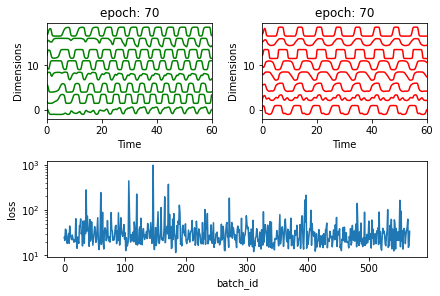

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.05956876 -0.27995923 -0.9180397  -0.15265996  0.66662778 -0.82382054
  -0.61912225 -0.5827005 ]
 [-0.5160177   0.17270649 -0.80668184  0.68736138  0.6790109  -0.42241227
  -0.58560806 -1.04578513]
 [ 0.25816589  0.4653843   0.65234437  0.23841982 -0.12164069  0.82033178
   0.75965675  0.49034611]
 [-0.16790511  0.55762953  0.50749558  0.76913091  0.09497213  0.58109689
   0.66846013  0.41630235]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.21s/it]

[[-0.18829605 -0.24365933 -0.95858299  0.11710379  0.53517686 -0.74534851
  -0.55677628 -1.45765895]
 [-0.05706283  0.56189624  0.76578936  1.37537949  0.25237974  1.35473084
   1.11781598  0.96666461]
 [ 1.52947982  0.5293779   0.70640264 -0.78756944 -1.49754007 -0.48593215
   0.47074087 -0.09506449]
 [-1.65230781 -0.03975713 -0.70377942  1.72493521  1.82387264  1.38246564
  -0.09201444  0.01310883]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:07,  1.30s/it]

[[-0.27771956  0.14817656  0.46874352  0.24821591  0.01347753  0.30218368
   0.47185128 -0.09496738]
 [-0.63888816  0.06712101  0.85229698  1.30909308  0.74901352  1.9941722
   1.44944407  1.07615964]
 [-0.85161127  0.29406557 -0.21774942  1.37903886  0.57600542  0.63436018
   0.18964054 -0.47504211]
 [-1.22710571 -0.05200974 -0.42249387  1.51569933  1.43453274  1.22369281
   0.32745545  0.20144993]]


 38%|███▊      | 3/8 [00:04<00:06,  1.31s/it]

[[ 0.69692327  0.7259526   0.63697095  0.627735   -0.75199655  0.61369775
   0.60499037  0.2697116 ]
 [-1.14177009 -0.71161548 -1.22744629 -0.08577663  1.11543513 -1.21833708
  -0.84162864 -1.74606605]
 [-0.7009718  -0.32961474 -1.00617817  0.27628423  1.06069578 -0.54778522
  -0.65001592 -1.78288505]
 [ 0.80409857 -0.23105266  0.19955663 -1.17098391 -0.8216841  -1.93735135
   0.05823696 -1.07836651]]


 50%|█████     | 4/8 [00:05<00:04,  1.21s/it]

[[ 0.49970599  0.36724817  0.6439685  -0.0795382  -0.53204373 -0.2394823
   0.45253944  0.36765622]
 [-0.60585844 -0.01007162 -0.32385891  0.44433154  0.78725448  0.22741064
  -0.18247416 -0.55243992]
 [ 1.7131662   0.65332616  1.15153784 -0.61606385 -1.26792344 -0.08461726
   0.74993913  0.82967474]
 [ 0.02933269  0.3581815   0.09336324  0.97810299  0.22488812  0.79808805
   0.51158891  0.59389994]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.13s/it]

[[-0.65781146  0.05220514 -0.92526569  0.54784182  0.72375808 -0.25277418
  -0.72030574 -1.43487411]
 [ 0.09168801 -0.55854552 -0.43511411 -0.21832759  0.3088667  -1.02723964
  -0.22805583 -0.9170368 ]
 [ 0.01827189  0.06001993 -0.87675415  0.11411143  0.20907084 -0.97524177
  -0.73512267 -1.57623093]
 [ 0.52322016  0.35791498  0.61487134 -0.29564002 -0.89940911 -0.40094615
   0.25485061 -0.60401669]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.09s/it]

[[ 1.21935204  0.97253699  1.35974211  0.34087896 -1.1642732   0.56739753
   0.92770605  1.08879846]
 [ 0.1598789  -0.08531816 -0.57666924 -0.02113793  0.27911794 -1.04387539
  -0.50028507 -1.21588811]
 [ 0.24991717 -0.09136893  0.08508707 -0.04596577 -0.09837038  0.98204417
   0.55406577 -0.58084567]
 [ 0.64731479  0.40353765  0.42873547  0.36114612 -0.54411982  0.52814092
   0.37206788  0.40978818]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.06s/it]

[[-1.74059668 -0.610424   -1.338699    1.17578962  1.76966109  0.27616662
  -0.44759172 -1.12016441]
 [ 0.56992297  0.16522588  0.42727271  0.16039349 -0.38136639 -0.21234258
   0.30213573  0.16530794]
 [-0.43060973 -0.53931875 -0.01885588  0.10994059  0.29496638 -0.67506842
   0.16088164 -0.69832988]
 [ 1.5089044   0.38535292  0.57915578 -0.84705754 -1.14356604 -0.60559527
   0.31652973  0.10877829]]


100%|██████████| 8/8 [00:02<00:00,  2.84it/s]


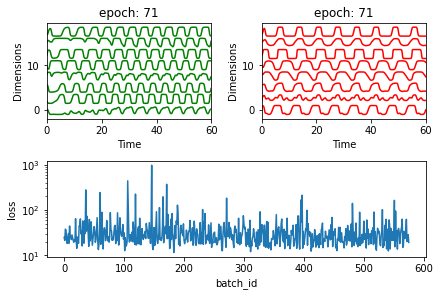

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.70934489  0.08725429  0.12664412 -0.10966603 -0.46335121  0.36637469
   0.37519527 -0.6374937 ]
 [-1.29597193 -0.37881601 -0.44836483  1.55302547  1.60195387  0.52707501
   0.28275813 -0.25578813]
 [ 1.07387278 -0.26893961  0.09177443 -0.73418834 -0.40665981 -0.52776763
   0.30243365 -0.16633691]
 [ 0.8346844   0.38058202  0.04206452 -0.13796913 -0.40358188 -0.54065284
  -0.0948726  -0.21598996]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.01it/s]

[[-1.98276790e+00 -1.35176158e-01 -1.00284653e+00  2.31487769e+00
   1.97348493e+00  1.68011442e+00 -9.01885979e-04 -2.36505080e-01]
 [-8.24280207e-01  9.77115260e-02 -8.27301127e-02  1.55157329e+00
   6.46560772e-01  6.86732679e-01  2.40606758e-01 -4.67705453e-01]
 [ 1.16145410e+00  5.56220972e-02 -5.59959289e-01 -1.64794869e+00
  -7.79628880e-01 -1.36403328e+00 -9.29412224e-01 -2.01907210e+00]
 [-5.33946574e-01  5.72405141e-02  2.13795188e-01  9.13766449e-01
   5.49056746e-01  6.05783123e-01  3.53645445e-01  3.20506054e-01]]


 25%|██▌       | 2/8 [00:01<00:05,  1.03it/s]

[[-0.6938659  -0.02636641 -0.52303151  0.86854004  0.64196051 -0.42802655
  -0.35342624 -0.52012357]
 [ 0.32866134  0.7841162   0.9809194   0.42807148 -0.49295097  0.96224176
   0.87285165  0.36925256]
 [ 0.10895723 -0.19295161  0.62925772 -0.27270979 -0.12017979 -0.92462516
   0.40922373  0.44228713]
 [ 0.97206092  0.39319294  1.39442186  0.23380521 -0.9868662   1.33852352
   1.47469117  1.25216968]]


 38%|███▊      | 3/8 [00:02<00:04,  1.01it/s]

[[-5.89924612e-01  2.96740476e-01 -2.63185984e-01  1.41682951e+00
   7.24353505e-01  1.50856154e-01  1.50788321e-02 -2.75248992e-01]
 [-1.08623774e+00 -2.02989240e-03  7.84429297e-02  1.13285251e+00
   6.57650455e-01  2.48731611e-01  4.74700289e-01 -2.06088690e-01]
 [ 7.39930783e-02  7.79741193e-02  5.27909863e-01  7.65041255e-01
   2.58988226e-01  7.87666737e-01  9.48019420e-01  8.24593274e-01]
 [-1.66004743e+00 -6.16739123e-01 -1.57803523e+00  4.53660467e-01
   1.41141034e+00 -1.59744324e+00 -1.22278676e+00 -2.14828729e+00]]


 50%|█████     | 4/8 [00:04<00:04,  1.02s/it]

[[ 1.0873995  -0.17323103  0.04222544 -1.19533214 -0.69434695 -1.87713718
  -0.30213358 -1.08717686]
 [-0.90965521  0.40723433 -0.33402116  1.5774565   0.82045086  1.11182192
  -0.03932302 -0.06863175]
 [-0.65124406  0.02001972 -0.33963597  0.78462692  0.70018041  0.74889862
   0.03770898 -0.73301797]
 [-0.73888795 -0.6948081  -1.79659224 -0.05950426  1.27842764 -1.54510451
  -1.27606159 -1.77418197]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.01it/s]

[[-1.43526545 -0.07752841 -0.15460523  1.26636899  1.20856251  1.25508566
   0.4136821  -0.19678603]
 [ 0.14789475  0.13452162 -0.03251508  0.26891291 -0.17530248  0.88244752
   0.4247199  -0.53215343]
 [-0.79528546 -0.54140334 -1.4205025  -0.11696718  0.9650824  -0.95143746
  -0.87739054 -1.9103106 ]
 [-0.21370942  0.1862421  -0.13150536  0.37975334  0.25655529  0.48000204
   0.15199412 -0.68420021]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[-0.66652105 -0.23302433 -0.24116656  0.71035146  0.92770244 -0.33760933
   0.08207339 -0.54460361]
 [-0.74146874  0.03543303  0.08388795  0.66268745  0.39368423 -0.44109453
   0.25666168 -0.40566227]
 [-1.62089965 -0.2171067  -0.63441985  1.52324844  1.57866117  0.4384036
   0.04421943 -0.19039221]
 [-0.3712613  -0.23966663 -0.08345639  0.17434635  0.69404243 -0.3360685
   0.04349568 -0.4668657 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.05it/s]

[[-0.88997318 -0.14360668 -0.66160235  1.06082123  0.73699919  0.7727524
  -0.01158453 -0.5453489 ]
 [ 0.3107144   0.37605163  0.36454022  0.62929288  0.00500934  0.53418047
   0.36346122  0.20813411]
 [ 0.31545668  0.12321987  0.01321599 -0.02686885 -0.0078119  -0.69402162
   0.07089839 -0.62676497]
 [-0.7638228  -0.22031149 -0.25263921  0.95314745  0.89952668 -0.23790329
   0.02318445 -0.70347744]]


100%|██████████| 8/8 [00:02<00:00,  3.17it/s]


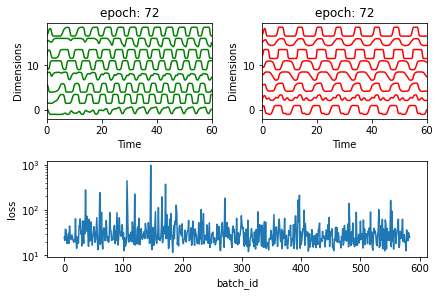

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.3283102   1.10696311  1.5718161   0.39770786 -1.05470014  1.73914552
   1.3787728   1.67344414]
 [ 0.65250387  0.58301803  1.30691151 -0.14612175 -0.95605163 -0.39807183
   0.77662261  0.74837761]
 [ 0.40857853  0.63970188  0.5634378   0.41278332 -0.15735128  1.22159952
   0.75732427  0.28518289]
 [ 0.39132743  0.44091669  0.78975493  0.8775265   0.05134792  0.98180157
   0.99293671  0.79357215]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.12s/it]

[[ 0.70736614  0.39421028 -0.11330484 -0.40881837 -0.50144583  0.13709275
  -0.11310211 -1.1415927 ]
 [ 0.05692802  0.0817523  -0.64029965  0.49501992  0.35099448 -1.07070904
  -0.73045283 -0.99182539]
 [ 0.37999725  0.41989097  0.20580032  0.01244218 -0.31234344 -0.53592955
  -0.09185209 -0.66107069]
 [-0.8669753   0.04242074 -0.40742     1.53804197  0.95966389  1.23534153
   0.1305603  -0.53168152]]


 25%|██▌       | 2/8 [00:02<00:06,  1.06s/it]

[[ 0.1798888   0.24357071 -0.01103254  0.27396561 -0.16691662  0.3468985
   0.19094957 -0.13608929]
 [ 0.00250927  0.56304884  0.18528175  1.07814438  0.05551973  0.42014964
   0.2711697   0.15071014]
 [-0.18140053  0.54841611  0.15515382  0.71089947  0.0676859   0.71603418
   0.31654462 -0.16433338]
 [-0.67582261 -0.33400124 -0.44283804  0.82756464  0.95089793  0.19446003
   0.10726601 -0.37332555]]


 38%|███▊      | 3/8 [00:02<00:05,  1.01s/it]

[[ 1.11276662  1.15808878  1.09900148  0.4145613  -1.45471091  1.04522031
   0.8971034   0.5870211 ]
 [ 0.44532149  0.30810353  0.58519322  0.38243232 -0.03917304  0.09716332
   0.67077677  0.742808  ]
 [ 0.95010008  0.27785004  0.44056688 -0.21592786 -0.51854122  0.16777405
   0.54506124 -0.39489733]
 [ 0.02772795  0.42993162 -0.01217484  0.72777795 -0.03375112  0.92286919
   0.38795949 -0.41724312]]


 50%|█████     | 4/8 [00:03<00:03,  1.01it/s]

[[ 0.17994404  0.64974024  1.00615919  0.93606206 -0.09765337  1.39993566
   1.0462365   0.73722818]
 [ 0.212063   -0.38689665 -0.40595318 -0.09191217  0.28620081 -0.68665903
  -0.10351328 -1.07505939]
 [ 0.0664887  -0.00189095 -0.46085567 -0.12140698  0.14356449 -0.30074155
  -0.31254788 -1.02345651]
 [ 0.97833335  0.53115408  1.10486822  0.50125607 -0.76408364  0.6580639
   1.03752306  0.76641144]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.01it/s]

[[-1.20738236 -0.25695111 -0.92090273  0.77730758  1.31579687 -0.49640498
  -0.64075434 -1.28864752]
 [ 0.75310755  0.67815617  1.42878724  0.13079008 -0.79811653  0.22654274
   0.99892545  1.07525342]
 [ 0.30538521  0.44370762  0.02160739  0.41825043 -0.13290795  0.68666617
   0.39455205 -0.56963663]
 [-0.16894928  0.50239721  0.29688627  1.18054995  0.24734699  1.75337959
   0.82434722  0.21243428]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.03it/s]

[[ 0.35625593  0.13768943  0.08030488 -0.15708307  0.07981779  0.47762978
   0.31174867 -0.21796816]
 [-0.97893073 -0.172665    0.113745    0.92219017  1.01341881 -0.3897892
   0.19540295 -0.29892975]
 [-0.20177522 -0.41639037 -0.6730094   0.08157174  0.76062514  0.83745596
   0.24600855 -1.2081741 ]
 [-0.10075529 -0.16082101 -0.51892512  0.28726385  0.53089458 -0.45096808
  -0.24837568 -0.8256698 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.02it/s]

[[ 0.42910828 -0.32044279 -0.38331238 -0.54405406 -0.07785176 -1.42616304
  -0.28108371 -0.93948096]
 [-0.53092731  0.66757634 -0.02155403  1.18277069  0.42303156  0.9552543
   0.14175574 -0.33806471]
 [ 0.66525097  0.44987132  0.36110625  0.11780388 -0.75297312  0.05152973
   0.2951523  -0.43390504]
 [ 0.55810963 -0.15889932 -0.42179143 -0.30259181 -0.04885534 -0.39882844
  -0.27703693 -0.86457112]]


100%|██████████| 8/8 [00:02<00:00,  3.11it/s]


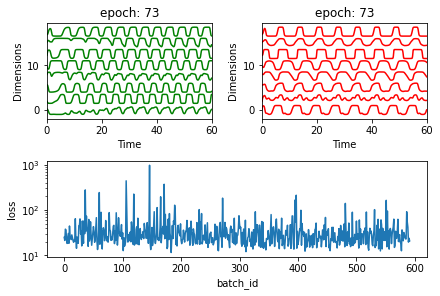

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.46245206  0.22141303 -0.04897298 -0.5248474  -0.60594972 -0.91624645
  -0.13685625 -0.37569539]
 [ 0.02288801  0.14960642  0.39063188  0.44053568  0.17327728  0.29577336
   0.55794871  0.46452845]
 [ 0.10339627  0.54703559  1.4397325   0.74966292 -0.42725611  1.21196024
   1.26567851  1.07121482]
 [ 2.00055001  0.51658284  1.03064378 -1.14985744 -1.51538152 -2.19531996
   0.17048449  0.17044798]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.04it/s]

[[-0.10877054  0.19801249  0.15321171  0.70052058  0.39439704  0.7046862
   0.36691255 -0.08700894]
 [ 0.37946032 -0.16057209 -0.00971468 -0.31306564 -0.1769292  -0.69579178
   0.09144073 -0.43795768]
 [-0.92880671 -0.691983   -1.65555385  0.38451205  1.31301261 -1.76018107
  -1.2620279  -1.87963713]
 [-0.12967398  0.27812021 -0.74519449  0.58087834  0.31683892  0.50131305
  -0.27131503 -0.84744666]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[-0.62492446 -0.08399976 -0.52225334  0.3124604   0.65463524 -0.80172079
  -0.48725567 -0.91497683]
 [ 0.29345566 -0.23418698 -1.05183219 -0.23832698  0.12599239 -1.68864529
  -0.94997694 -1.77342167]
 [ 0.6218602   0.12725301 -0.08144532 -0.10966391 -0.26175713 -0.13874357
  -0.13863218 -0.34519459]
 [-1.55461041  0.18667202 -0.18611909  1.67483618  1.27607508  1.23629928
   0.32137467 -0.2257961 ]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[ 0.58916074  0.46553858  0.31585954 -0.10533878 -0.83686165 -0.39813771
   0.1174665  -0.61318417]
 [-0.30056035 -0.0548187  -0.19209611  0.90014721  0.8648221   0.48554456
   0.26785429 -0.58449222]
 [ 1.18264174  0.53452758  0.2816361  -0.2092092  -0.86599626 -1.02652365
  -0.13797416 -0.61715352]
 [-0.76289003  0.17449434  0.59969104  1.21088567  0.58282539  0.68080855
   0.94624962  0.26265708]]


 50%|█████     | 4/8 [00:03<00:03,  1.04it/s]

[[ 1.32452304  0.33291414  0.88526453 -0.55362186 -1.01159444 -0.3509766
   0.47100712  0.36627126]
 [-1.3351083  -0.19229902 -1.25420609  1.30842644  1.51725116  0.43210711
  -0.46733816 -0.99231116]
 [ 0.70222344  0.3491464   0.92249328 -0.2734674  -0.84366897  0.8610101
   0.99260115 -0.11385264]
 [ 1.20240322  0.15375676  0.72255054 -0.34923726 -1.01087055 -1.06513678
   0.59001504 -0.21539961]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[ 0.16547315  0.26043963 -0.12013447  0.57895197  0.41740653 -0.64555884
  -0.12343856 -0.34027774]
 [-0.41486243  0.11511099 -0.52054624  0.27827313  0.40273544 -0.53143369
  -0.5477777  -0.82744775]
 [ 0.36946886  0.53427056  0.52033995  0.53419927 -0.52814395  0.42144947
   0.45697878  0.29810799]
 [ 1.65551011  0.59966553  0.75715713 -1.07856976 -1.47192487 -1.25273206
   0.25257368  0.19398615]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[-0.48823696 -0.17471752 -0.47835137  0.67006052  0.70292131  0.90759999
   0.09859408 -0.53842628]
 [ 0.44070969  0.09624138 -0.10175552  0.0812014  -0.34569224 -0.85358589
  -0.0638552  -0.31704126]
 [ 0.13804571 -0.21567706 -0.44132791 -0.22634779  0.12366555 -1.73602104
  -0.58932256 -0.58076272]
 [-0.68242988 -0.10758949 -0.75894277  0.39049641  0.80314516  0.74599764
  -0.26178361 -1.45871744]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[-0.68382641 -0.14623358 -0.24491768  0.60294344  0.6348182   0.28464956
   0.21038772 -0.51576868]
 [ 0.89712269  0.86774359  0.32656958  0.63109156 -0.50193273  1.30214455
   0.45856075 -0.08338524]
 [-0.20931859  0.24488393  0.13588774  0.58644693  0.21434276  0.01138148
   0.21207779  0.2405199 ]
 [ 0.45091474  0.14703841  0.25649714 -0.31602574 -0.49109364 -0.96414742
   0.03004044 -0.33462889]]


100%|██████████| 8/8 [00:02<00:00,  3.17it/s]


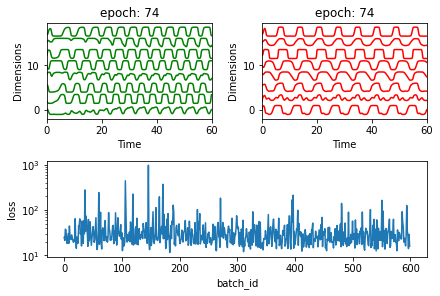

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.81294402 -0.22627927 -0.94616171  0.60017832  0.97977035 -1.06453373
  -0.80500887 -1.35934127]
 [ 0.21858191 -0.08410759 -0.05376047  0.40936355  0.43281421  0.78890967
   0.51384503 -0.47744599]
 [ 0.41851177 -0.03654296  0.03391067 -0.24858614 -0.14527847 -1.13980584
  -0.08851617 -0.71669966]
 [ 0.62554472  0.36563637  0.37913613  0.29935381 -0.1660364  -0.53073904
   0.3058129   0.13965212]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.07s/it]

[[-0.62616163  0.27488542 -0.28858436  1.33003774  0.98414445  0.51694122
  -0.0771101  -0.0285855 ]
 [-1.17428071 -0.06392518 -0.96892814  1.51595689  1.38502657  0.79658871
  -0.33835524 -0.87412762]
 [ 0.51126232  0.86653259  0.54856402  1.04567449 -0.48460298  2.15487953
   0.86161945  0.29775619]
 [ 0.65940725 -0.40003817 -1.22630566 -1.39178626 -0.10612211 -2.39438603
  -1.39283402 -1.92504999]]


 25%|██▌       | 2/8 [00:01<00:06,  1.03s/it]

[[-0.29240045  0.04707871 -0.29768439  0.2729556   0.61476618 -0.58487442
  -0.35112289 -0.67501221]
 [ 0.63830505  0.24475686  0.13815613 -0.01785508 -0.27515238 -1.04000857
  -0.11926012 -0.36222657]
 [ 0.3596218   0.0602156   0.26319815  0.08180716 -0.26874841 -0.89890575
   0.12823942 -0.45812494]
 [ 0.15447998  0.02574947 -0.48123536 -0.47337479 -0.27331738 -1.30006954
  -0.60133445 -0.82074296]]


 38%|███▊      | 3/8 [00:02<00:04,  1.00it/s]

[[ 0.04344817 -0.03117006 -0.37349711  0.22338933  0.2474401  -0.61999642
  -0.24297394 -1.15877397]
 [-0.8374885  -0.05149492 -0.56323824  0.9999947   0.90749363 -0.15334745
  -0.36080912 -0.45192961]
 [ 0.24277749  0.51791238  0.89980459  0.48120109 -0.41746137  0.45260784
   0.84404259  0.58073564]
 [ 0.09260036  0.18017026 -0.29997859  0.81104381  0.6373281   0.70770659
   0.1597348   0.08514141]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 1.17216072  0.48054743  0.406861    0.47849414 -0.58614349  0.67857982
   0.49662462  0.8516707 ]
 [-0.12909773 -0.0367234  -0.32807326  0.59145674  0.50402996  0.20743879
   0.04059294 -0.44343037]
 [ 0.90601346  0.54463241  0.7382945   0.2570167  -0.41274701  0.52718151
   0.72602649  0.60051568]
 [-1.97430196 -0.15122377 -0.68371185  2.14611496  2.0321337   2.34461026
   0.24098687 -0.24249167]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[-0.97067923  0.27135177  0.43721798  1.35102471  0.8816027   1.45560517
   0.88883741  0.65466361]
 [-0.10532644  0.34465218  0.08851724  0.41006087  0.2151544  -0.4983969
   0.02059433 -0.70955711]
 [-0.74034927  0.49146447  0.55553653  1.43404525  0.69569767  0.85913124
   0.67057915  0.45812959]
 [-0.19989378  0.61703829  0.36997528  1.38439898  0.3065341   0.86885708
   0.35488952  0.33397651]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.01it/s]

[[ 0.27700053  0.54821698 -0.47741173  0.6935258  -0.14473037  0.12335858
  -0.33694405 -0.62906088]
 [-0.51540545 -0.03657868 -0.94038105  0.41070054  0.58884304 -0.67156406
  -0.9522834  -1.41090082]
 [ 1.17134917  0.47467633  1.17790801  0.05631631 -1.1897908   0.08653437
   0.83701199  0.74121646]
 [-1.03336261 -0.20504858 -1.12339252  0.7353105   0.94383028 -0.27113256
  -0.79348467 -1.9884219 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[-1.00579109 -0.30524068 -1.01271542  0.66782551  0.75958073 -0.6944995
  -0.6691089  -1.64087763]
 [-0.79679878  0.12318522 -0.62629824  0.81070663  0.68754536 -0.2782837
  -0.45152459 -0.86284417]
 [ 0.09647503  0.01213526 -0.0501204  -0.09754645  0.0481011  -0.43178771
  -0.01047273 -0.78354322]
 [-1.18859448  0.26608565 -0.30395922  1.41078031  1.03143296  1.73641436
   0.25118635 -0.61932402]]


100%|██████████| 8/8 [00:02<00:00,  3.10it/s]


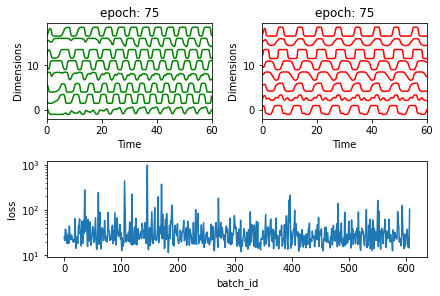

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.50070006  0.59479694  1.22869828  0.02840769 -1.260825   -0.51975138
   0.85653275  1.4339538 ]
 [-0.25821228  0.00176515 -0.62359622  0.3152105   0.30425908  0.43318728
  -0.15838431 -0.6588128 ]
 [-0.26617633 -0.0985215  -0.49414703  0.3698308   0.13849996 -1.11317833
  -0.3328729  -1.32675888]
 [-0.3848207   0.27705919 -0.37814607  0.68386881  0.39162588  0.27834158
  -0.20291592 -0.31869537]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.04it/s]

[[ 0.56044132  0.53251088  0.31899805  0.18729737 -0.59578999  0.59112059
   0.25138603 -0.40878161]
 [ 0.93687535  0.27913147  0.65850712 -0.30666522 -0.67140092  0.82142202
   0.76847786  0.08325801]
 [ 2.00430653  0.85710398  1.01033316 -0.48905247 -1.9460859  -0.85222043
   0.44641663  0.89841529]
 [ 1.31758014  0.72170351  1.3392737   0.35442659 -1.17887283  1.55558859
   1.48826229  1.0722662 ]]


 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[ 0.58385156  0.21844136  0.17651544 -0.38468995 -0.42228259 -0.64588839
   0.03888895 -0.8035061 ]
 [ 0.06226614  0.1586922  -0.55793283  0.11484359  0.42509931  0.05623317
  -0.1829853  -1.60418601]
 [ 1.25666182  0.06447072 -0.29909096 -0.888395   -0.56348068 -2.15406519
  -0.66806862 -1.06319374]
 [-0.16523608  0.41500523  0.38068984  1.11134625  0.27269177  1.70489082
   0.82699557  0.12195162]]


 38%|███▊      | 3/8 [00:02<00:04,  1.02it/s]

[[ 0.54129604  0.25245365  0.10946328 -0.13227959 -0.30634262 -0.89269861
   0.11073085 -0.641276  ]
 [-0.91316247 -0.2729578  -0.30197154  1.2918089   1.19034831  0.54008564
   0.39321426 -0.38980569]
 [ 1.53624096  0.42362982  0.8514619  -0.34553596 -1.36405558  0.20019109
   0.71432549  0.42927873]
 [ 0.70688627  0.33514811  0.64316102  0.10952016 -0.66190928 -0.5601984
   0.39164392  0.10489262]]


 50%|█████     | 4/8 [00:03<00:03,  1.04it/s]

[[-0.86928739 -0.15506694 -0.95807404  0.81291759  0.86953894 -0.53462551
  -0.57512755 -0.97163152]
 [-0.85289893 -0.42344945 -1.16335129 -0.02345248  0.76187837 -0.89748055
  -0.92547981 -1.80659103]
 [-0.11572616  0.20546445  0.64005913  1.25654362  0.17168306  2.1406657
   1.2360041   0.42620442]
 [ 1.02026153  0.6912721   1.0334351   0.06716941 -0.51902858  0.63819812
   0.79640161  0.72979854]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.05it/s]

[[-2.23592576 -0.43971538 -1.47908141  1.95606054  2.55317276  0.55856784
  -0.5913628  -1.16229857]
 [ 0.86363303  0.73548782  0.9651886   0.4591055  -0.51574301  0.49924041
   0.63273905  0.82874476]
 [-0.82809974 -0.04921416 -0.77659518  0.74730188  0.76524293  0.23957259
  -0.38665048 -1.32985459]
 [ 1.41748966  0.4887637   0.96240833 -0.8591405  -1.41417782 -0.29054051
   0.4687543   0.25841663]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[-0.571001    0.39655253 -0.12911236  1.2581659   0.77688941  1.09872007
   0.17361469 -0.34286444]
 [ 0.2512755  -0.14651705 -0.62500984  0.00731759  0.40442871 -0.24445085
  -0.24353606 -1.02354883]
 [-1.63924611 -0.51193032 -0.76738189  0.99492028  1.51759401 -0.45817472
  -0.14852229 -1.30630241]
 [ 1.12137941  1.35027137  1.53138257  1.10084844 -1.16147365  1.82132915
   1.19201804  1.30724791]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[ 0.64656558  0.09448584 -0.30045145 -0.76994027 -0.51148247 -1.25192779
  -0.52513058 -1.35551522]
 [ 1.33873765  0.9890552   1.01548715  0.52641761 -1.04592104  0.69256459
   0.60203349  1.16558365]
 [-1.23362907 -0.81427222 -1.11528132  0.60038342  1.73886384  0.08460644
  -0.21129375 -1.76344296]
 [-0.27974163  0.29438505  0.13681152  1.08685733  0.56773104  1.7312886
   0.52006629 -0.0651814 ]]


100%|██████████| 8/8 [00:02<00:00,  3.16it/s]


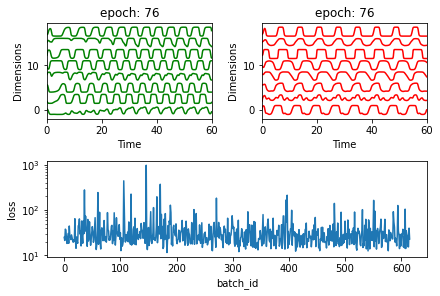

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.6055875   0.30783974  1.17428229  0.1686848  -0.73009623  0.92068341
   1.30589637  0.90207763]
 [-0.94788883 -0.04212954  0.05849646  1.37267625  1.14574316  1.34586481
   0.59347719  0.43877289]
 [-0.75811897 -0.13930853 -1.00885384  0.58812235  1.101386    0.08932749
  -0.55195701 -1.21991205]
 [-0.56859572  0.13622228 -0.34333576  0.93159601  0.79248268  0.12605599
  -0.18980626 -0.05615082]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.03it/s]

[[ 0.94561376  0.15469042  0.6283728  -0.04918247 -0.80545552 -0.66977006
   0.57427555  0.14607184]
 [ 2.00998544  0.57718862  1.21819962 -0.82914993 -1.50804222 -0.72276792
   0.67401801  0.83549912]
 [-0.56122423 -0.60397045 -1.6144607   0.17942671  0.97505441 -1.72897218
  -1.19417095 -2.08763528]
 [-1.58379823 -0.0954029  -1.1917351   1.47725038  1.4880203   0.41094281
  -0.59990747 -1.5423238 ]]


 25%|██▌       | 2/8 [00:02<00:06,  1.03s/it]

[[ 0.30580231  0.49128869 -0.19714822  0.28698428 -0.16328584  0.29749725
  -0.26812757 -0.51770119]
 [-1.26132522 -0.08435967 -0.43971321  1.43489002  1.37837624  0.90600499
   0.17155572 -0.42690687]
 [ 0.59094727  0.52262969  0.70748087  0.1438112  -0.41801036 -0.03410797
   0.45128779  0.42245252]
 [-0.00550366  0.43452139  0.29179339  0.89105362  0.46422111  0.95652824
   0.44877283  0.75824636]]


 38%|███▊      | 3/8 [00:03<00:05,  1.09s/it]

[[-1.48332551 -0.3510322  -1.2157628   0.91059386  1.61694486 -0.75081229
  -0.89702121 -1.23775179]
 [ 0.01848544  0.39619564  0.70411532  0.19159245 -0.24759942 -0.88757967
   0.28705458  0.41704237]
 [ 0.40631025  0.4605912   0.70769519  0.35784175 -0.54468072  0.54757445
   0.74893206  0.39980976]
 [ 1.39771021  0.12361698  0.4857025  -0.86184501 -0.88664459 -0.36527065
   0.29574732 -0.0394388 ]]


 50%|█████     | 4/8 [00:04<00:04,  1.11s/it]

[[-0.48825569  0.06605429 -0.38299547  0.87383684  0.44925538  0.8968489
  -0.04647262 -0.43420312]
 [-0.73297399  0.72964222  0.05263618  1.7930583   0.70913493  2.60819528
   0.76280493 -0.07827574]
 [-0.31411511  0.01240802 -1.1403454   0.03586164  0.45007773 -0.97790508
  -0.99605202 -1.93330482]
 [ 0.27830875  0.23881703  0.02167114  0.37965168 -0.02086996  0.47755431
   0.24324146 -0.69056725]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.17s/it]

[[ 1.29683134  0.83816568  1.0694824   0.13957499 -1.00699221  1.02113649
   0.98985021  0.50596723]
 [ 0.17647688 -0.23145576 -0.75844184 -0.00415675  0.09559541 -0.33045704
  -0.29639233 -1.23855573]
 [ 0.38881366  0.74576507  1.01092279  0.61561914 -0.42479955  0.58366159
   0.7585816   0.55333497]
 [-1.00571406 -0.58136996 -1.07719549  0.21216132  1.22345841 -1.52597564
  -0.91286802 -1.19686818]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.15s/it]

[[-0.65875058  0.14325221  0.24726049  1.39294417  0.96670559  0.29573232
   0.48416723  0.60514958]
 [-0.83615942 -0.43899884 -0.63655508  0.73010114  0.96136791  0.41341178
   0.15555851 -1.07102498]
 [-0.30817903  0.96145416  0.48577918  1.74118831  0.35138507  2.44158582
   0.83706163  0.45839568]
 [-1.50099782 -0.11564776 -0.70329341  1.63323689  1.73973855  0.79465842
  -0.10343471 -0.64204791]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.09s/it]

[[ 0.05102232 -0.60783164 -0.72130863 -0.53797657  0.07940253 -1.11675778
  -0.32678046 -1.75887914]
 [-0.04136868 -0.28260985  0.20924561  0.29836109  0.21210442 -0.32242612
   0.41599276  0.21320385]
 [-1.20026142 -0.27085048 -0.30268727  0.74883853  1.16672804  0.59096748
   0.1988485  -0.00564557]
 [ 0.62686012  0.48192488 -0.03953303  0.10405226 -0.32361379  0.87287667
   0.17896114 -0.47192614]]


100%|██████████| 8/8 [00:02<00:00,  3.20it/s]


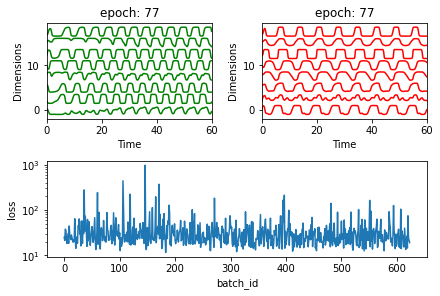

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.18137327 -0.43401977 -0.96457439  0.59766219  1.15972723 -0.59391728
  -0.55573189 -1.03369201]
 [-0.63662298  0.16403376  0.2306089   1.11994222  0.73073083  1.42934483
   0.78243078  0.44794382]
 [-0.91138781 -0.17398837 -0.06191186  0.48053755  0.78599763 -1.01076089
  -0.26141567 -0.59856962]
 [ 0.57687509  0.51332068  0.06373541  0.7535069  -0.34994466  1.09813648
   0.29812902 -0.45595718]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.03s/it]

[[-0.49107069 -0.0834654  -0.69499569  0.50119415  0.89275117 -0.43378455
  -0.38231833 -1.30142123]
 [-0.27465065 -0.58582878 -1.60408565 -0.20739881  0.5231892  -0.877967
  -1.11772658 -2.20959382]
 [ 0.47176705 -0.32184463  0.55639114 -0.8507049  -0.34401577 -1.08961247
   0.43005453 -0.57359123]
 [ 0.57443288  0.97858248  1.33602722  0.60527923 -0.80314405  1.17077032
   1.15987198  0.95590259]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.05s/it]

[[ 0.18753857 -0.02903303 -0.31305065 -0.36019609  0.08251065 -0.42767289
  -0.26138021 -0.61971214]
 [ 1.6348369   0.63794743  1.50913771 -0.65974783 -1.415236    0.39056396
   1.24959564  1.1801449 ]
 [-1.69364489 -0.14730554 -0.82790756  1.87804695  1.83366562  1.03733527
  -0.26272003 -0.40677605]
 [-0.25015115  0.02437278 -0.4213622   0.43023976  0.67466128  0.02690184
  -0.0854046  -1.01129195]]


 38%|███▊      | 3/8 [00:03<00:05,  1.03s/it]

[[ 0.11208176 -0.07976622 -0.63102924 -0.14217989  0.47699184 -1.58166585
  -0.9532808  -1.27147317]
 [-0.24780581  0.17433614 -0.65281132  0.20063653  0.24596829 -0.92691613
  -0.56986324 -1.84780471]
 [ 0.08399581 -0.46101361 -0.57783193 -0.65684355  0.01039097 -1.28286572
  -0.43112026 -1.87953457]
 [-0.2832466   0.14619456 -0.02892508  1.14773744  0.35903895  0.70474467
   0.37478733 -0.09898886]]


 50%|█████     | 4/8 [00:04<00:04,  1.02s/it]

[[ 0.33925475  0.7178842   1.15015216  0.74829879 -0.37084727  0.32403788
   0.8065569   1.38098888]
 [-0.12822276  0.37350194 -0.24069492  0.83992853  0.42208274  0.5143601
   0.05301094 -0.58210172]
 [-0.65283866  0.1112048  -0.33652118  0.99220232  0.82951424  0.3587855
  -0.21542514 -0.59539175]
 [-2.78788131 -0.60906735 -1.51429611  1.81101605  3.01335289  0.40772571
  -0.60302221 -1.1126652 ]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.02s/it]

[[ 1.22469889  0.81634356  1.74850743  0.13067511 -1.22307121  1.35591639
   1.62502938  1.49067455]
 [ 0.40968292  0.59956723  0.63724209  0.62274664 -0.22061794  0.32028045
   0.41214247  0.42408716]
 [-0.28362968  0.09382474 -1.08423936  0.6607792   0.92933965  0.25161108
  -0.76422207 -1.47993992]
 [ 0.17059985  0.37901518 -0.03421884  0.32192665  0.10652453  0.42722328
   0.03039112 -0.28905262]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.03s/it]

[[-0.03381726  0.40651053  0.84678594  0.66704107 -0.19706361  1.16490502
   1.06896356  0.60984152]
 [ 1.21871824  0.40937112  0.72625714 -0.42963653 -0.91012309 -0.51065791
   0.44913685  0.27518171]
 [-0.04319718 -0.09102973 -0.47127757  0.12604796  0.12912216 -0.43433846
  -0.33176231 -0.72130385]
 [-1.01150762 -0.24618348 -1.03264882  0.91398595  1.42442034 -0.33126854
  -0.5970682  -0.97620821]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.02s/it]

[[ 0.45661147  0.63749967  1.54783332  0.87882959 -0.44094907  1.51979081
   1.52599912  1.69498728]
 [ 0.11516722  0.33212079 -0.40398527  0.26206238  0.25506329 -0.2959579
  -0.44630514 -0.9294938 ]
 [-0.2988092   0.08704735 -0.27168696  0.80387595  0.53605444  1.03488069
   0.31859149 -0.60658124]
 [ 0.47771519  0.42106582 -0.29588631  0.20918076 -0.18881543 -0.00444499
  -0.36162693 -0.71874012]]


100%|██████████| 8/8 [00:02<00:00,  2.92it/s]


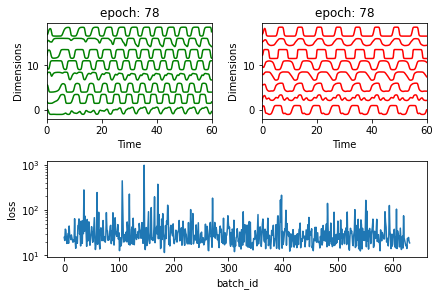

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.63526815  0.00656598 -0.25144544 -0.50422713 -0.35174253 -1.52466828
  -0.46401967 -1.00298988]
 [-0.06421597 -0.67713612 -0.64834102 -0.75601624  0.40480334 -1.360772
  -0.35431358 -1.40136539]
 [ 0.10612521  0.29753412 -0.01402842  0.10603906 -0.02348117 -0.60436412
  -0.21814438 -0.33975492]
 [ 1.29890793  0.44213912  0.56910195 -0.48467239 -1.26518259 -0.65833559
   0.32442651 -0.30991295]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.01it/s]

[[ 0.09237555 -0.31124344 -0.21235458  0.01186404  0.53522427 -0.41635205
   0.06095043 -0.40152885]
 [-1.63822369 -0.13158341 -0.91615356  1.3875286   1.64153118  0.63845231
  -0.36953388 -0.94839728]
 [ 0.38777147 -0.36250103 -0.54484456 -0.62932014 -0.35644005 -1.70119358
  -0.50796342 -1.08122467]
 [-1.36713992 -0.55844107 -0.70997089  0.99495535  1.40129609  0.07726196
  -0.22191716 -0.8100777 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.11s/it]

[[-1.09776906 -0.27180325 -0.04728757  1.20542569  1.13814121  0.59337932
   0.47285643 -0.06367366]
 [-0.87871821  0.30606657 -0.06535045  2.11438877  0.86574746  1.85754485
   0.5156149   0.34917677]
 [ 1.07325748  0.75182766 -0.0780039  -0.06325852 -0.76494972  0.04551066
  -0.09159082 -0.42744516]
 [-0.71269212 -0.11973259 -0.21735498  0.64559851  0.91998229 -0.01931039
   0.08389302 -0.34158161]]


 38%|███▊      | 3/8 [00:03<00:05,  1.10s/it]

[[ 0.23933996 -0.00782174 -0.91622269  0.09960063  0.2063691  -1.03364479
  -0.89907527 -0.90435774]
 [ 0.67552657  0.46812862  0.55765593  0.34183196 -0.23589394 -0.15649658
   0.25881102  0.35073944]
 [ 0.43781541  0.04356452  0.15585331 -0.13613143 -0.28556797 -0.64666147
   0.01515469 -0.34180085]
 [ 0.2440677   0.26980509  0.19657368  0.33150547 -0.06995247  0.39413871
   0.26501514  0.4014159 ]]


 50%|█████     | 4/8 [00:04<00:04,  1.11s/it]

[[ 0.7080878   0.29966976  0.55046452 -0.3542925  -0.36454069 -0.38424931
   0.45688403 -0.2719969 ]
 [ 0.9579682   0.20396439  0.43238966 -0.61760362 -0.68792879 -1.17783994
   0.20402375 -0.21445508]
 [-0.14068251 -0.1692269  -0.26762995  0.09223754  0.23052071 -1.1953112
  -0.59718744 -0.7044865 ]
 [-0.88100199 -0.51894815 -1.67182129  0.4106419   1.11856035 -1.02150945
  -1.13776319 -1.96292096]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.07s/it]

[[ 1.46259773  0.70757486  0.76688817 -0.02334043 -1.32695813 -0.65104894
   0.27561588  0.07554936]
 [-1.70909943 -0.37373402 -1.40107004  1.26701556  1.78700407 -0.41180261
  -0.80250475 -1.69690753]
 [ 0.94647219  0.28346393  0.39745452 -0.29446913 -0.36603533 -0.95607722
   0.02396835  0.38479635]
 [-0.4763929  -0.32292598  0.18729848  0.42595911  0.33007013  0.17367448
   0.40557733  0.30248451]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.08s/it]

[[ 0.40598612  0.12726957 -0.32200418  0.25109015  0.2372666   0.18840371
   0.04972366 -0.46921123]
 [ 0.76052158 -0.31289467 -0.70678583 -1.12757856 -0.22529815 -2.42804136
  -0.93781779 -1.63719543]
 [-0.35236908  0.10334344 -0.05280916 -0.0095213   0.03266478  0.614182
   0.17532752 -0.86410586]
 [-0.91844334 -0.35826381 -1.0828377   0.68500254  1.19263187 -0.13364586
  -0.37869963 -1.66827598]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.07s/it]

[[-0.19099831 -0.27718966 -1.43766022 -0.34916339  0.64924574 -1.41073336
  -1.28866401 -1.59903122]
 [ 0.10985168  0.17737381  0.23380443  0.40603834 -0.0249312   0.05910483
   0.48670149 -0.09179042]
 [-0.93409229  0.2171092   0.85496784  1.60297234  0.70936082  1.87823206
   1.18968161  0.67564489]
 [-1.33163749  0.37217067  0.2617781   1.38511772  0.98871899  1.2243031
   0.39342939  0.15056607]]


100%|██████████| 8/8 [00:02<00:00,  2.73it/s]


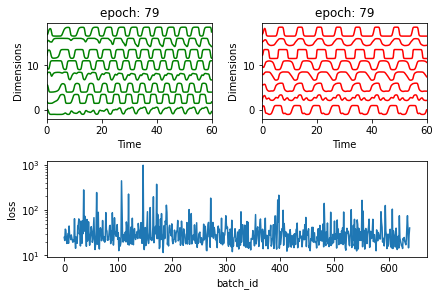

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.03784567  0.42919884  0.36957031 -0.02855146 -0.62659134 -0.68573354
   0.27923088  0.03686432]
 [-0.75315303  0.1396693  -0.49545472  0.96006     0.87810956  1.58110575
   0.278409   -0.80939084]
 [-0.97769252  0.05157855 -1.02036787  1.08152406  1.12147884  0.04084813
  -0.62166213 -1.0595584 ]
 [-1.08378475 -0.06190759 -1.00007488  0.64061059  1.12985535  0.53859709
  -0.66745028 -1.40850958]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.18s/it]

[[ 0.41467427 -0.01863145 -0.34365407 -0.2827729  -0.05203325 -0.83939593
  -0.29816804 -0.99836609]
 [ 0.02186641  0.25109277  0.32121539  0.48198886  0.18390514 -0.14045166
   0.18712654 -0.15061571]
 [ 0.47565956  0.27765154  0.24565701  0.51839531 -0.15371942  0.67273191
   0.48766992 -0.2758284 ]
 [-0.09401746 -0.02599135 -0.46768953 -0.17607829  0.26584893 -0.05465658
  -0.2885913  -0.77497818]]


 25%|██▌       | 2/8 [00:02<00:06,  1.14s/it]

[[-1.33821859 -0.53214636 -1.36491468  0.33473288  1.66746677 -1.35943689
  -0.94463494 -1.75055093]
 [-1.1328071   0.49014011  0.1980422   1.78980149  0.74920011  2.09790829
   0.66216259  0.32113152]
 [-1.4955968  -0.15771954 -0.32733534  1.41361927  1.43015276  1.48602522
   0.1943296  -0.35067727]
 [ 0.17077482  0.07897099 -0.05380717  0.00993385  0.13134726 -0.92181899
  -0.03194589 -0.96850847]]


 38%|███▊      | 3/8 [00:03<00:05,  1.11s/it]

[[ 0.2737083   0.02961144  0.58139122  0.01708571 -0.21412728 -0.01267085
   0.63759091  0.43177728]
 [-1.94385221 -0.63809497 -1.17530448  0.67315894  1.69428946 -1.94650818
  -1.18337479 -1.90534811]
 [-0.36518814 -0.32229911 -0.28911818  0.1695577   0.8921683  -0.93733289
  -0.16558206 -1.05207969]
 [ 0.73319652  0.55456307  1.10896849  0.28984669 -0.40842552  0.6528563
   0.86480045  0.89011391]]


 50%|█████     | 4/8 [00:04<00:04,  1.20s/it]

[[-1.89006248 -1.0627025  -1.60577357  0.51724097  1.92966701 -0.62582031
  -0.88564714 -1.69000447]
 [-0.75443578  0.01943651 -0.18431889  0.28788853  0.68347795 -1.54179503
  -0.52108418 -0.61808598]
 [ 0.05098096  0.04912686  0.03727705 -0.09551865 -0.0909508  -0.62434544
   0.08372773 -0.44469362]
 [-0.67179687 -0.07570052  0.04824531  0.98489074  0.66990671  1.29479385
   0.48370178  0.35410409]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.22s/it]

[[ 2.00689827  0.15522499  0.53766477 -1.48901749 -1.27927832 -1.31034535
  -0.02097528 -0.40603355]
 [ 0.88665884  0.22236808  1.09180175 -0.06732911 -0.67555804 -0.83659309
   0.63829662  0.77026989]
 [ 0.05266841  0.55093848  0.43558148  0.3655675  -0.30746235  0.15579865
   0.11942781 -0.35408626]
 [-0.60324935 -0.10629472 -0.59095591  0.50037379  0.90751733  1.24702214
  -0.05189012 -0.67040656]]


 75%|███████▌  | 6/8 [00:07<00:02,  1.21s/it]

[[-0.61416419 -0.06694704 -0.54485779  0.61488307  0.42001038  0.19579104
   0.00867947 -1.0030893 ]
 [-1.40481925 -0.53996759 -1.01497568  1.02905991  1.71857879 -0.83267338
  -0.58675458 -1.00382961]
 [-0.41941654  0.06620992  0.69355886  0.31267865  0.24108508  0.02047291
   0.64722972  0.35731829]
 [ 0.56736375  0.50726193  0.08218529  0.81680802  0.07656228  1.23250405
   0.4913758  -0.07021851]]


 88%|████████▊ | 7/8 [00:08<00:01,  1.20s/it]

[[-0.83951325  0.27845568 -0.41269178  1.3111218   0.93751295  1.20234328
  -0.01309353 -0.16603974]
 [ 0.30389618  0.4523082   0.56803766  0.6823666   0.0953186   0.33982997
   0.54580379  0.88398577]
 [-0.57174904  0.0054154  -0.32864954  0.2862321   0.52886106 -1.37160801
  -0.41371132 -0.53697836]
 [-0.97868094 -0.29775273 -0.8207115   1.09971062  1.59337615  1.07712829
  -0.16260193 -0.95095687]]


100%|██████████| 8/8 [00:02<00:00,  3.04it/s]


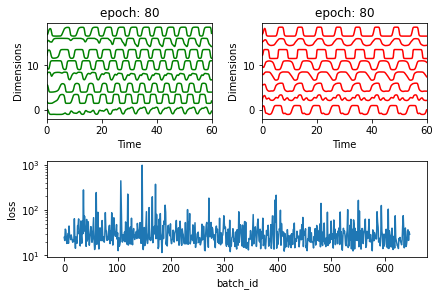

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.85522787  0.13023602  0.15741101  1.17138723  0.83500369  1.14543441
   0.58709362  0.23539263]
 [ 2.1501967   1.0545881   1.67978483 -0.66056772 -2.02193753  0.58030427
   1.31703679  0.95755975]
 [-0.97804269 -0.81312382 -0.62928307  0.48410845  1.21006097 -0.33578787
   0.01598947 -1.02360667]
 [-0.73211401 -0.28857324 -0.46748926  0.73035202  0.90800961  0.16965609
   0.07181233 -0.94942292]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.02it/s]

[[-0.86200458 -0.18182756  0.09422584  0.65157316  0.65963766  0.34318316
   0.44808526 -0.51070478]
 [-0.69441734 -0.01628509 -0.1708675   0.7241505   0.71687962  0.04257311
   0.05730827 -0.87901658]
 [ 0.41001077  0.26671562 -0.1001621  -0.23129462 -0.27630708  0.14338139
  -0.0338948  -0.75760436]
 [-0.67897579  0.05463107 -0.8019866   1.33866735  1.12738369  1.15427618
  -0.21507194 -0.57374623]]


 25%|██▌       | 2/8 [00:01<00:05,  1.01it/s]

[[ 0.33757706  0.01820644 -0.23275572  0.34101394 -0.23190689  0.57237721
   0.16229257  0.1724497 ]
 [-1.18051471 -0.19182235 -0.94256918  1.10001037  1.418394   -0.29807862
  -0.56768997 -1.23608178]
 [-0.41309335  0.0772122  -0.4266988   0.67054006  0.74742665  0.30474639
  -0.03005807 -0.81395337]
 [-1.02671813 -0.30538409 -1.04786978  1.00706833  1.29543567  0.04369244
  -0.5617651  -0.94903533]]


 38%|███▊      | 3/8 [00:03<00:04,  1.00it/s]

[[ 0.15247906  0.18897718 -0.41140478 -0.25565924 -0.04189262 -0.46455207
  -0.44144521 -0.87950297]
 [ 0.01512961  0.10744396 -0.3801775   0.31010534  0.30762264 -1.24752582
  -0.55076926 -0.30345661]
 [ 0.88190253  0.25167593 -0.06318908 -0.57307612 -0.90570304 -1.16988481
  -0.27136441 -0.92728106]
 [ 0.8902869   0.53418973  0.21781479 -0.1231922  -0.72016686 -0.1470092
   0.1590795  -0.15833462]]


 50%|█████     | 4/8 [00:04<00:04,  1.03s/it]

[[-0.04526016 -0.10517904  0.06510576 -0.13595391  0.07207564 -0.86457722
  -0.01452731 -0.49310494]
 [ 0.94186356  0.45347396  0.69285186 -0.33768074 -0.85825227 -0.7164051
   0.2882263   0.28767761]
 [ 0.85788986  0.26835937  0.99023429 -0.00349102 -0.45603727  0.36923546
   0.95695947  0.49059292]
 [-0.47286143  0.56873772  0.82175539  1.39193688  0.28397373  1.32357304
   0.89879471  1.03762469]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.02s/it]

[[ 0.30800941 -0.26077901  0.06662492 -0.36610398 -0.08795006 -0.33961754
   0.18406646 -0.38078154]
 [ 0.07231782  0.56748151  0.82551897  0.36209156 -0.37253515  0.4349634
   0.62251882  0.3859919 ]
 [ 0.56521164  0.62811347  0.2413079   0.10985413 -0.84386818  0.03457737
   0.19244618 -0.64135074]
 [-0.70519153  0.32728752 -0.69342212  1.37727434  0.87066356  0.82864803
  -0.37626485 -0.61285457]]


 75%|███████▌  | 6/8 [00:06<00:01,  1.01it/s]

[[-0.16522305 -0.39966196 -0.70347261  0.01700801  0.38667041 -0.60949658
  -0.4432411  -1.07219908]
 [ 0.94740108  0.51181286  0.99851087  0.29328438 -0.45729657  1.12192934
   1.26241678  0.87337845]
 [ 0.62102994  0.36611528  0.38878777  0.00884557 -0.27402735  1.1210797
   0.61609114  0.07198651]
 [ 1.00935624 -0.03825933  0.1699453  -0.73312153 -0.75052513 -0.74547162
   0.23467633 -0.5970935 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.02it/s]

[[-1.01374571 -0.5187483  -0.14577326  0.5722603   1.23793907 -0.39995161
   0.11176813  0.07241062]
 [-0.3839992   0.45985924  0.43555955  1.5978103   0.60980574  2.62390855
   1.09948128  0.91220113]
 [ 0.77982386  0.4747054   0.81794764  0.51534745 -0.29067599  0.48676356
   0.80532452  0.47294205]
 [ 1.02845042  0.68253851  0.97384309  0.28060614 -0.78980026  0.34790248
   0.87443157  0.76104371]]


100%|██████████| 8/8 [00:03<00:00,  2.52it/s]


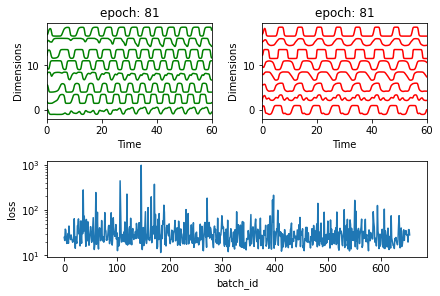

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.4627356  -0.24063053 -0.92011927  0.35075256  0.79808148 -1.35200379
  -0.76964605 -0.89805219]
 [-0.96031172 -0.37384222 -0.47119455  0.64671289  1.19209898 -0.09185191
  -0.01019321 -0.55861579]
 [ 0.12433611  0.06737978  0.08646961  0.28867844  0.13474858  1.01321954
   0.43750918 -0.09288931]
 [-0.41128925 -0.19183739 -0.88832049  0.38015001  0.84491785 -0.36961959
  -0.48206924 -1.30814893]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.08s/it]

[[-0.20252161  0.15134771  0.00413493  0.78342009  0.61748392  0.41816925
   0.12648928  0.21574925]
 [ 0.36633828  0.27204305  0.38499795  0.43010858 -0.03059532 -0.05162267
   0.35919665 -0.00168548]
 [-1.25912892  0.28150682 -0.42613816  1.21708217  0.96566893  0.87477165
  -0.30273805 -0.3737729 ]
 [-1.58580279  0.22808065 -0.90410292  1.53047015  1.46106187  1.55800359
  -0.15874212 -0.40149542]]


 25%|██▌       | 2/8 [00:02<00:06,  1.07s/it]

[[ 1.97534974  0.55748576  0.94926101 -1.74539868 -1.80900503 -0.9940806
   0.30745972  0.168997  ]
 [-1.16010627 -0.08502702 -0.84034785  1.26389768  1.11868373  0.65211629
  -0.28327389 -0.67820352]
 [-0.07289675  0.15956013 -0.234879    0.04520883  0.31861591 -0.44753812
  -0.30217979 -1.17802517]
 [-0.96011089  0.28222106  0.37463516  0.89091739  0.40835099  0.61638203
   0.45295399  0.08931785]]


 38%|███▊      | 3/8 [00:03<00:05,  1.04s/it]

[[-0.30439603 -0.30795866 -0.75601035  0.15619088  0.21721427 -0.286429
  -0.41155419 -0.89938622]
 [-1.36642351 -0.16508745 -0.02047959  1.44466617  1.16456702  0.59577217
   0.45461772  0.4987236 ]
 [ 0.24208053  0.46397116  0.19297109  0.47931183  0.15663083  0.05075697
   0.24191003  0.03667737]
 [ 2.01635626  1.01215689  1.02562132 -0.54054711 -1.53950235 -0.04445669
   0.42808994  0.69980043]]


 50%|█████     | 4/8 [00:04<00:04,  1.01s/it]

[[ 0.90563025  0.63466814  1.12405182  0.03338379 -0.78812414 -0.09056051
   0.63285978  0.60027576]
 [ 0.22423059  0.32120411  0.56020232  0.30112954 -0.16886805 -0.09049138
   0.45278708  0.23955462]
 [-1.24533371 -0.68523658 -1.6205352   0.35259162  1.61270512 -1.33965593
  -1.15812071 -2.03634433]
 [ 0.40756563  0.54315577  0.44904269  0.05403293 -0.32808213  0.49351753
   0.40531868 -0.25850414]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.02it/s]

[[-2.09412512 -0.45098281 -1.73116446  1.45912717  2.07746657 -0.28259795
  -0.99156294 -1.96479194]
 [-0.04358689  0.0665367  -0.6088324   0.47701717  0.41705957  0.03599841
  -0.26133601 -0.74609246]
 [ 0.11044379  0.72436065  0.92043311  0.95882752 -0.02208701  1.41354152
   0.86535876  0.66629181]
 [-0.03448146 -0.12621391  0.07579337  0.06914542  0.16810181 -0.34497198
   0.16682234 -0.25706226]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.00s/it]

[[-0.89378054 -0.11802183 -1.69430646  0.40488248  1.09636936 -0.90382424
  -1.32835755 -2.12451797]
 [-0.25026312 -0.23517389 -0.37001604  0.58045578  0.90545405 -0.31458059
   0.11581422 -0.24935232]
 [ 0.47501024  0.15576745  0.11810858 -0.00307631 -0.32263159 -0.5935716
  -0.11578611 -0.62450681]
 [-0.29276081  0.12967464 -0.50133825  0.46538221  0.41741078 -0.18381127
  -0.43714076 -0.7016063 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.02it/s]

[[ 0.6756962   0.41431232  0.57527326  0.06463872 -0.45554118  1.1388006
   0.77031479  0.33024604]
 [-0.17808164  0.9765492   1.28782447  2.04753296  0.05420049  2.68595277
   1.56468872  2.13302554]
 [-0.77921435 -0.44698181 -0.6455599  -0.16719317  0.46492121 -2.49860045
  -0.93060053 -1.71481074]
 [ 0.98390881  0.68562511  0.55050034 -0.0996419  -0.86118927  0.4790843
   0.37740098  0.27193484]]


100%|██████████| 8/8 [00:02<00:00,  3.05it/s]


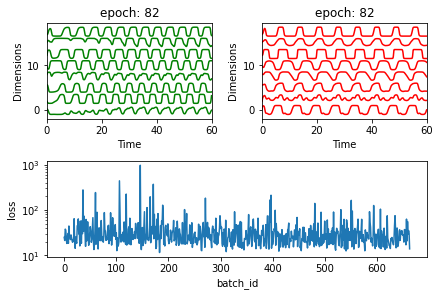

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.39881763  0.38499217  0.70222797  0.71913176 -0.13426697  0.37698565
   0.71713659  0.68135434]
 [ 0.54728034  0.28926346  0.13265797  0.35500108 -0.35226951  0.13557257
   0.36252906 -0.32270466]
 [-0.10155928 -0.30647318 -0.80768683 -0.40477251  0.30220881 -1.95707633
  -0.87978001 -1.38794952]
 [-0.25555062  0.11715344 -0.04793355  0.9411407   0.43886349  0.27809032
   0.08817502 -0.44818042]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.02it/s]

[[-1.20744177 -0.82313981 -2.17961234  0.64419194  1.75857322 -1.58475021
  -1.41842077 -2.69019425]
 [ 0.65933127  0.09394314 -0.03804418 -0.46581706 -0.59461002 -0.33017307
   0.0978471  -0.67776918]
 [-0.12648925  0.53918593  0.41037934  0.36090477 -0.08116876 -0.47467966
   0.05965576  0.07483541]
 [ 0.66668864  0.82249903  1.11813033  0.67626292 -0.5680238   0.89008012
   0.89823602  1.05965056]]


 25%|██▌       | 2/8 [00:01<00:05,  1.03it/s]

[[-1.92310375 -0.44083894 -1.7573143   1.73644243  1.98413771  2.04912553
  -0.49734669 -1.3421812 ]
 [ 0.44698022  0.46408168  0.36198033  0.04016086 -0.3872405   0.43281876
   0.26766252 -0.26242428]
 [-1.01054479 -0.39000521 -1.50233363  0.42368536  1.05014346 -1.47174935
  -1.17416465 -1.86912612]
 [ 1.57413947  0.13409788  0.89119915 -1.47532309 -1.72804576 -1.55859506
   0.26086932 -0.14311711]]


 38%|███▊      | 3/8 [00:02<00:04,  1.01it/s]

[[ 0.16422417 -0.02813445 -0.13254559  0.02247395  0.11460068  0.06866457
   0.18615667 -0.64832691]
 [-0.93601356 -0.36800147 -0.64611012  0.44296084  1.03127096 -0.96894734
  -0.52880557 -0.55740754]
 [-0.54027478  0.26823691  0.59527966  0.84452171  0.28212644  0.44768251
   0.78067107  0.22190058]
 [-0.87452494  0.0250582   0.54878825  1.36150504  0.86036081  1.45864548
   0.92813152  1.03903036]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 1.0564372   0.2169447  -0.01314893 -0.41114573 -0.68373939 -0.41628261
  -0.02425055 -0.40054295]
 [ 0.92330378  0.62935592  1.232441    0.35148784 -0.99960168  1.15189574
   1.17743563  1.01349755]
 [-0.25495672 -0.227505   -0.98207181  0.17057707  0.63455666 -0.43817572
  -0.49199861 -1.63598972]
 [-0.67572496 -0.00253031 -0.01736822  1.15114072  0.81505695  0.24175111
   0.31437584  0.08235498]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.03it/s]

[[-0.76328255 -0.31183    -0.6531361   0.57149364  1.03452302 -0.16790705
  -0.32668186 -0.70924876]
 [-0.45770854  0.21646462  0.20995242  0.73303138  0.38941306  0.78187315
   0.39611654 -0.2540142 ]
 [ 0.12779571 -0.0051615  -0.33753972 -0.33746762  0.0151057  -1.54756679
  -0.5420482  -1.14332522]
 [ 1.1955883   0.47919391  0.37342308 -0.52505478 -0.83262264  0.16805078
   0.35482604 -0.07229258]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.07s/it]

[[-0.44433609 -0.31394759 -0.20213174  0.09362054  0.27195552 -0.68360741
   0.00633716 -0.86743198]
 [-0.9849791  -0.54632557 -0.59126218  0.75322394  1.03232783 -0.8901279
  -0.27113546 -0.83236672]
 [-0.5040788   0.52721626  0.55978464  1.8103151   0.90041527  1.75560876
   0.91747002  1.09501857]
 [ 0.26980868  0.68273202  0.68133441  0.80097252  0.09097425  1.13914741
   0.49587723  0.87234072]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.05s/it]

[[-0.37673848  0.33266303  0.12777314  0.87069062  0.28967579  1.24280003
   0.49771366 -0.48966319]
 [ 0.48967724  0.26616442  0.76575656  0.09320723 -0.77138903  0.18029166
   0.8435639   0.60182021]
 [ 0.3997744   0.94090758  0.89308534  0.52846767 -0.37292687  0.6108494
   0.69401399  0.37375566]
 [ 0.73821508  0.86349845  1.2290225   0.54208296 -0.81432845  1.78774222
   1.16453096  0.99475572]]


100%|██████████| 8/8 [00:02<00:00,  2.68it/s]


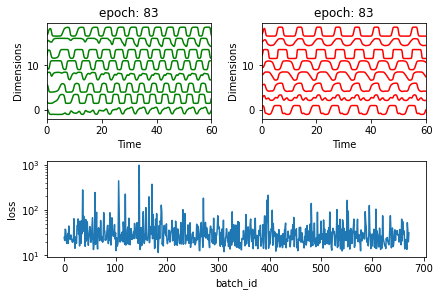

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.54025185 -0.00267705 -0.17883653  1.14191564  1.06676673  0.55911678
   0.14532488  0.11645897]
 [ 0.84994744  0.68535059  1.02651203 -0.13572394 -0.94896669  0.35369904
   0.6117928   0.0083503 ]
 [ 0.59668405  0.383603    0.53878447 -0.12007175 -0.54814477  0.68922939
   0.57048069  0.10719491]
 [-0.3968222   0.25034346 -0.27679909  0.9392557   0.52791462  1.36675229
   0.26259524 -0.82710834]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.21s/it]

[[-0.74103413  0.03282737 -0.36550667  0.27772427  0.32329307  0.075487
  -0.12190447 -1.26129201]
 [ 1.17611012  0.18625185  0.08660603 -0.72235077 -0.5185321  -1.47155321
  -0.36967786 -0.43474317]
 [-0.39713883  0.44286011  0.05431609  1.20057566  0.51532561  1.33649777
   0.40834037 -0.31816427]
 [ 0.11336597  0.5069041   0.44156979  1.15960156  0.22166082  1.17349922
   0.69643727  0.42554165]]


 25%|██▌       | 2/8 [00:02<00:06,  1.17s/it]

[[-0.86511252  0.33466406 -0.46547727  1.56586017  0.89955016  0.59179473
  -0.12383081 -0.38176879]
 [-0.93658751 -0.90526586 -1.47898002 -0.19258788  1.19008715 -1.39569407
  -0.97850433 -2.13334047]
 [-0.36171469  0.41473707 -0.10347819  1.05823321  0.44934445  1.09767371
   0.254998   -0.54293318]
 [-0.93226267 -0.44771203 -0.36370078 -0.39331849  0.673829   -1.46669884
  -0.38600704 -1.29068449]]


 38%|███▊      | 3/8 [00:03<00:05,  1.14s/it]

[[ 1.29825547  0.78867302  0.79050708 -0.12944939 -1.39048182 -1.35436658
   0.27314118  0.14652789]
 [-1.81835692 -0.57704184 -1.32991904  1.05152064  1.91541479 -0.72458983
  -0.95352606 -1.35884512]
 [-0.0601606   0.03570269  0.27540896  0.42232825  0.16579673  0.70506922
   0.66146601 -0.06248057]
 [ 1.4986342   0.3806882  -0.51559784 -0.90464481 -0.81619082 -1.49013356
  -0.76244093 -1.29400311]]


 50%|█████     | 4/8 [00:04<00:04,  1.16s/it]

[[ 0.11551533 -0.5080127  -0.27805548 -0.39004152  0.12518057 -0.2035267
   0.2375369  -1.00272263]
 [-0.70588805 -0.01617625 -0.86735229  0.59338392  0.9992916   0.13046963
  -0.41775087 -1.16128385]
 [ 0.20243625  0.48807742  0.99328825  0.06431307 -0.4274963  -0.01113413
   0.62849604  0.86331752]
 [ 0.40432707  0.20369086  0.07167782  0.44956639 -0.23544938 -0.42586033
  -0.11779897 -0.34210619]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.18s/it]

[[-0.52691395  0.07474282 -0.37351869  1.19646518  0.67861606  1.30119746
   0.31902866 -0.53716278]
 [ 1.54244311  1.0201244   1.07318495  0.13467616 -1.18657579  0.43141977
   0.69698888  1.16248534]
 [ 0.32418014 -0.14495907 -0.34856699 -0.36362909 -0.20835102 -0.57990298
  -0.29656036 -0.992909  ]
 [ 0.11907285  0.25524236  0.54209465  0.77134517 -0.15821046  0.03460717
   0.50118417  0.59244594]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.15s/it]

[[-0.14292318  0.84319818  0.82412641  1.09218252 -0.02111311  0.86688091
   0.59006682  0.67893097]
 [ 1.12683983  0.55882501  0.38356377 -0.20956603 -0.91971166 -0.57319863
  -0.12633876 -0.09215558]
 [-1.16885806  0.31410938  0.09544293  1.81766234  1.30641951  1.26354112
   0.53849961  0.26861729]
 [-0.08500099  0.15515581 -0.59605568  0.34672053  0.276077   -0.2617725
  -0.43431568 -1.11726119]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.13s/it]

[[ 0.20779363  0.20417047 -0.1790262   0.59250252  0.20045175  0.57388981
   0.18644916 -0.05448722]
 [-0.32784181 -0.26000275 -0.53244422  0.15241888  0.56170259 -0.51111245
  -0.2871762  -0.62883708]
 [ 0.81246013  0.48443068  0.82160261 -0.2045502  -0.61832984  0.13578957
   0.62823913 -0.16097154]
 [-0.63770431 -0.16562899 -0.9273361   0.78561389  0.84543265  0.55500789
  -0.38761666 -0.92506281]]


100%|██████████| 8/8 [00:02<00:00,  2.69it/s]


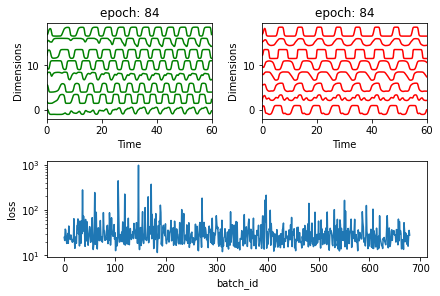

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.01686497 -0.61389307 -0.99428363  0.51677814  1.31970618 -0.50604937
  -0.59908208 -1.4467416 ]
 [ 0.28556256 -0.28004369  0.04340136 -0.37851329  0.0074573  -1.4235944
  -0.10983993 -0.41365271]
 [-0.57233223  0.32500549  0.51236873  1.27334834  0.4476667   0.99226737
   0.645095    0.58867075]
 [-0.21364037  0.41683495  0.87006916  0.99239645  0.08503001  1.68293954
   1.09780151  0.7975463 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.12s/it]

[[ 0.1195501   0.01717205 -0.65890876  0.4683667   0.73481455 -0.14966898
  -0.25029745 -0.70825056]
 [ 0.16293959  0.0033461   0.14151416 -0.01132605  0.07547254 -0.2314136
   0.01270521  0.08641618]
 [ 1.0538427   0.36961426  0.63364776 -0.86107322 -1.19561991 -1.03628999
   0.12930646 -0.64718605]
 [-1.93228249 -0.28500855 -1.15376644  1.97786736  2.02711365  0.39762274
  -0.44778709 -0.91689081]]


 25%|██▌       | 2/8 [00:02<00:06,  1.13s/it]

[[-0.02562944  0.11944038  0.45124206  0.07069509 -0.27209141 -0.43414171
   0.36680382  0.0348243 ]
 [-0.37737297  0.16499993 -0.34376295  0.88217766  1.10784765 -0.38270878
  -0.32274735 -0.14063478]
 [ 0.17849309  0.31836066  0.58412441  0.16436863 -0.4641257  -0.02604246
   0.48913947 -0.16555975]
 [ 0.04342813 -0.08796929 -0.14247218  0.14112978  0.21347708  0.11367587
   0.30656254 -0.80172684]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:03<00:05,  1.10s/it]

[[-0.64321449 -0.03516155 -0.07329155  0.94940248  0.49310892  0.37556562
   0.19043107 -0.34184319]
 [ 1.46223268  0.66484157  0.69566781 -0.50520727 -1.14899948  0.51681315
   0.64822378 -0.34864396]
 [-1.3576137   0.19252453 -0.17264183  2.17108897  1.32581192  1.45345516
   0.4140473   0.31532393]
 [ 0.49281215  0.11380612  0.21675919 -0.36658162 -0.55405855 -0.52273409
   0.12148351 -0.39446203]]


 50%|█████     | 4/8 [00:04<00:04,  1.06s/it]

[[ 0.70523018  0.33850499  0.30399092  0.22162266 -0.52874327 -0.20638737
   0.24244153  0.15487756]
 [ 0.75310787  0.36301372  0.7983284   0.10803203 -0.47628977  0.60794091
   0.91686027  0.11958788]
 [-0.35202446  0.31622952 -0.01592639  0.70378652  0.28461755  0.48455065
   0.15214265 -0.11866953]
 [-1.0246402  -0.06095826 -0.42231627  0.7138586   0.92676822  0.28249278
  -0.10476935 -0.93733589]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.02s/it]

[[ 0.40427269  0.23163823  1.00516358  0.16162139 -0.33690456 -0.20068449
   0.7535493   0.68033385]
 [-0.45065771 -0.32133939 -0.93873624  0.45684381  0.76120113 -0.99834441
  -0.76092392 -1.70503123]
 [-0.0567964   0.45777842  0.94486364  0.87824419  0.29946268  1.05863654
   0.98750608  0.96119052]
 [-0.1371435  -0.15466557 -0.42426092  0.22591961  0.39537529  0.50700244
   0.03600705 -0.58883025]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.02s/it]

[[-0.33584632  0.14793933 -0.60545259  0.81389336  0.46849204 -0.49105511
  -0.47314091 -1.23751906]
 [-0.45856648 -0.22967041 -0.88273257 -0.31565239  0.45745961 -1.97834708
  -0.97109934 -1.86415551]
 [-1.48733348 -0.18009041 -0.4783715   1.57380342  1.38223605  1.0594858
   0.15817557 -0.09088179]
 [-1.17841191 -0.23165966 -0.67948639  1.14011456  1.53072799  0.82056239
   0.01768266 -0.66808545]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.01s/it]

[[-0.51281307 -0.41544392 -1.20258461 -0.26328106  0.6712555  -1.80568727
  -1.17817644 -1.77279059]
 [ 0.47449558  0.62617256  0.89606071  0.58580265 -0.3627218   0.91496236
   0.86970104  0.56833158]
 [-1.12725925 -0.3110927  -0.84730089  1.25130842  1.21541254  0.25978764
  -0.30895667 -0.83472591]
 [ 0.39445501  0.53446438  0.00334384  0.21357441 -0.1086711   0.02487464
  -0.08717056 -0.51103368]]


100%|██████████| 8/8 [00:02<00:00,  3.18it/s]


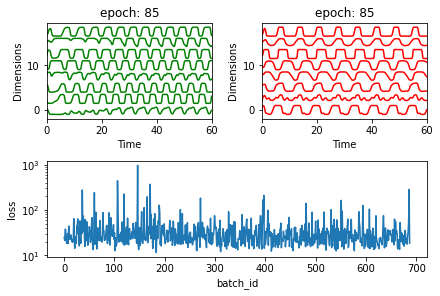

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.39540134 -0.10491713 -0.16145841  0.28335986  0.66118498 -0.17540659
  -0.06229697 -0.06461703]
 [-0.05106362 -0.35332374 -0.42411307 -0.54413722  0.39893064 -0.19948049
   0.01369311 -0.8503833 ]
 [-0.51478862  0.57976386 -0.38551477  1.0906803   0.50898309  1.91429517
  -0.03878883 -1.07616624]
 [ 0.529035    0.39670592  0.58860964 -0.1369159  -0.41300153  0.06303879
   0.59931867 -0.442225  ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.02it/s]

[[-0.18344786 -0.40506281 -0.1660204  -0.01377517  0.59368611  0.12392298
   0.20007994 -0.41343408]
 [ 1.08299297  0.71692394  0.94811402 -0.0538827  -0.99788071  0.4525236
   0.81486904  0.20863514]
 [ 0.04224996  0.29627986  0.31254755  0.28015888  0.09185514 -0.08236878
   0.24986697 -0.41867154]
 [-1.33795526 -0.72744446 -1.24795817  0.62491268  1.53479583 -1.38100934
  -0.83167238 -1.68812188]]


 25%|██▌       | 2/8 [00:01<00:05,  1.01it/s]

[[ 0.96179494  0.92450844  1.05421248  1.0492888  -0.60115446  1.56516754
   0.99201313  1.37620701]
 [ 1.00925147  0.50231085  0.74879136  0.21190422 -0.37608259  0.36416434
   0.69307276  0.84023285]
 [-0.8267534   0.05270269 -0.29250661  0.90868219  0.85313346  0.06145009
  -0.15881925 -0.55325032]
 [ 0.78548801  0.1239256   0.65241692 -0.37118747 -0.61436539 -0.76230819
   0.41944355  0.22498884]]


 38%|███▊      | 3/8 [00:02<00:04,  1.04it/s]

[[-0.00967203 -0.14974797 -0.38807452 -0.41591419  0.30263591 -1.20871249
  -0.36508623 -0.83137924]
 [ 0.71581241  0.06064148  0.51913182 -0.29235023 -0.19477383  0.33632108
   0.48417682 -0.01783408]
 [-1.1520751   0.25283475 -0.41326093  1.59337363  1.11891584  0.94923453
   0.07057614 -0.21034826]
 [-0.72734394  0.1101071  -0.29683548  1.34692853  0.55568826  1.55631935
   0.42159609 -0.50297508]]


 50%|█████     | 4/8 [00:03<00:03,  1.01it/s]

[[ 1.77509067  0.82900901  1.35203889 -0.60817038 -1.68650258  0.04428158
   0.80726968  0.45607833]
 [-0.92422308 -0.36075152 -1.20504882  0.49493165  1.42363828 -0.99199895
  -0.76862632 -1.11764014]
 [-0.00695757 -0.20708332 -0.85572191 -0.0237285   0.38260409 -2.19389398
  -0.97840034 -0.82876989]
 [-0.67301232  0.21052095  0.07198509  1.60003157  0.8601149   2.09971635
   0.75899257  0.5565713 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[ 0.16752558 -0.12531881  0.27917396 -0.52726445 -0.32014117 -0.98160984
   0.11655862 -0.3677094 ]
 [ 0.04128568  0.34825903  0.27546955  0.57184143  0.11015158  0.51501516
   0.37378312  0.39585679]
 [-0.70447305  0.20329047  0.41925967  0.62179963  0.47080712 -0.51325955
   0.20680893 -0.24897404]
 [-0.67338149  0.00262437 -0.02371086  0.78557918  0.78380247  0.01137497
   0.35898727 -0.00982639]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.05it/s]

[[-0.30010323  0.00335934 -0.47227296  0.48368316  0.34942652 -0.65522713
  -0.19822741 -0.81392844]
 [-0.00579465  0.33406583 -0.14704936  1.29668152  0.41295397  0.99582306
   0.21393331  0.47522344]
 [ 0.45397664 -0.16738401 -0.16812285 -0.06628149 -0.06483119 -0.19785966
   0.13785341 -0.13745185]
 [ 0.37209461  0.67219014  0.94774025  0.26192135 -0.79254699  0.52858967
   0.70079496  0.59465151]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[ 0.3165761  -0.2161659  -0.35090804 -0.96695536 -0.34633339 -2.2226026
  -0.71162726 -1.31492886]
 [-1.64010441 -0.01867405 -1.30556623  1.54748975  1.91362749 -0.45528958
  -1.05674178 -0.77060487]
 [-0.47147843  0.16166194 -0.31721617  1.11881764  0.67449806  1.52353144
   0.28676376 -0.34508019]
 [-0.05656081 -0.05453127 -0.77999663  0.39082166  0.36567709 -0.55093228
  -0.52111551 -0.91190979]]


100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


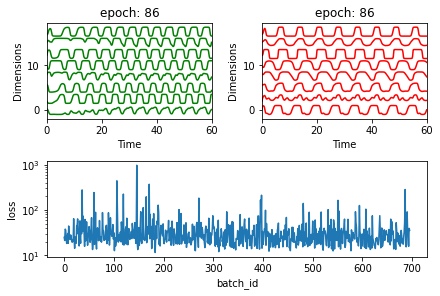

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.42912246 -0.16327048 -0.37653301  0.23305592  0.59024875 -0.41951008
  -0.27588023 -0.54106818]
 [-0.21118462 -0.22169399 -0.22547038  0.56337608  0.5524418  -0.21678842
   0.01004183 -0.52695599]
 [-0.16876873  0.41903233  0.23861363  0.55559131  0.25658813  0.43291729
   0.36715881 -0.33083242]
 [-0.36250464  0.1274273   0.10576687  0.40748501  0.05377926  0.35097123
   0.19333805 -0.45231536]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.07s/it]

[[-0.91222747 -0.5207768  -0.52160929  0.7081883   1.19050793 -0.21240765
  -0.0365663  -0.56815848]
 [-0.68010818 -0.12657158 -0.51175069  0.73114096  0.76451381  0.91990592
   0.19691274 -0.24955892]
 [-0.19106162  0.83602174  0.67594362  1.37840158  0.16984771  1.97946959
   0.91804903  0.38500526]
 [-1.48576651 -0.77471935 -1.80993695  0.68475878  1.71818656 -1.4175989
  -1.23129029 -1.82183697]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:06,  1.02s/it]

[[-0.40891115  0.2492819   0.28075335  0.83823738  0.69888801  0.49747758
   0.43788983  0.29183679]
 [-0.18250273  0.28491535 -0.33571777  0.33343691  0.45126539  0.23519848
  -0.10408969 -0.93741812]
 [ 0.10152917  0.06405912 -0.1714657   0.41203091  0.14527561  0.04607068
  -0.02205888 -0.49499943]
 [-0.85445723 -0.1561396  -0.90990711  0.57002796  1.11690311 -0.48346732
  -0.63180871 -1.47371686]]


 38%|███▊      | 3/8 [00:02<00:04,  1.01it/s]

[[ 1.15284875  0.63987537  1.24052958 -0.46835463 -0.91308504  0.17481788
   0.64282169  0.70115708]
 [-0.04001466 -0.06762056 -0.30312301  0.14860736  0.17222121 -0.14365389
   0.01833236 -0.51656246]
 [ 0.0161546   0.4572162   0.22842175  0.83020129  0.17601058  1.02894543
   0.5878396  -0.33423671]
 [-0.73395529 -0.45186463 -1.17088447  0.08175859  1.05055919 -0.81202354
  -0.81643315 -1.95502624]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[-0.94706606 -0.24476491 -0.6462908   0.59553672  0.78250484  0.10785113
  -0.12668898 -1.09297434]
 [ 0.77391799  0.06316937 -0.32311778 -0.83360401 -0.45869727 -1.69653758
  -0.47040857 -1.2327263 ]
 [-0.06997518 -0.07915007 -0.81856309 -0.02553347  0.21973715 -1.37960353
  -0.80392196 -1.72588041]
 [ 1.33420411  0.6422848   0.69962042 -0.11895349 -1.22959582  0.02872879
   0.52322895  0.36220864]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.03it/s]

[[-0.1742656  -0.303004   -1.18343285  0.15210421  0.34385874 -1.54034025
  -0.97101702 -1.83999781]
 [ 1.46900364  0.65963296  0.40221055 -0.74674734 -1.01996403  0.42878333
   0.07465459 -0.50424246]
 [ 0.68294539  0.27644452  0.35897866 -0.11489    -0.68781153 -0.74493972
   0.22531268 -0.5462578 ]
 [-0.42699578  0.0462324   0.38733714  1.2542416   0.49638154  0.89776907
   0.83276021  0.71561628]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.05it/s]

[[-1.19130848 -0.54701029 -1.04572827  0.67939753  1.45420881 -0.09721253
  -0.32685477 -1.48556364]
 [-0.24272225  0.55003187  0.9909918   1.62971967  0.54806874  2.34151327
   1.48238337  1.27479606]
 [ 1.86961317  0.64939586  1.03008942 -0.78346011 -1.45402219  0.32725254
   0.9518365   0.19487345]
 [ 1.3933818   0.50649118  0.18974568 -0.603304   -1.00171476 -0.60806881
  -0.11970446 -0.3802732 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.03it/s]

[[ 1.06457206  0.08989908  0.51482551 -0.80196023 -0.6798515  -1.11689772
   0.20267284 -0.06512735]
 [ 1.09495748 -0.36936387 -0.00787032 -1.08729922 -0.62010539 -1.15757546
  -0.00543193 -0.92123644]
 [-0.72908813  0.34609329  0.07249862  1.60769759  1.08405754  1.26324402
   0.56579227  0.34425325]
 [-1.29690435 -0.07214352 -1.18743248  0.97659897  1.39290187  0.63257385
  -0.50978999 -0.88250005]]


100%|██████████| 8/8 [00:02<00:00,  3.09it/s]


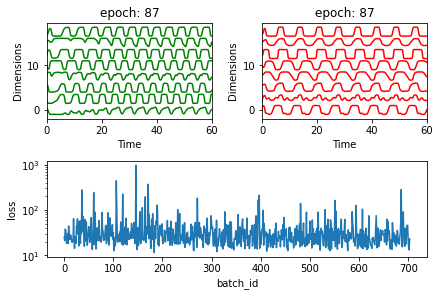

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.05270674 -0.20772607  0.07787162  0.05970523 -0.01993741 -0.18646455
   0.27583148 -0.5612386 ]
 [-0.4474008  -0.48309498 -1.36929874  0.38572548  1.19762878 -0.68546329
  -0.67148617 -1.50884692]
 [ 0.21473775  0.27384302 -0.30429644  0.05261902  0.05780834  0.45323986
  -0.17492922 -0.85471588]
 [-1.41730204 -0.32490814 -0.30071712  1.13904142  1.51010893  1.38321911
   0.55085798 -0.79494117]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.02it/s]

[[-0.43617416 -0.0371463  -0.98799401  0.39697946  0.48251822 -0.00641171
  -0.60946014 -1.28733739]
 [ 1.3864712   0.4562484   0.49397265 -0.43109438 -0.926136   -1.06668597
   0.09068365 -0.06907042]
 [ 0.68154494  0.25023419  0.35448545  0.09831061 -0.21684152 -0.29124186
   0.19383082  0.40950952]
 [ 1.11135133  0.02867555 -0.00702093 -0.56086361 -0.61968375 -1.74599638
  -0.4561194  -0.34265383]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[ 6.38984061e-01  3.14180673e-01  3.64729990e-01 -3.15134758e-01
  -5.64936515e-01 -1.15370139e+00 -4.56043484e-02 -1.58437642e-01]
 [-1.36737087e-01  6.15028541e-02  1.62557780e-01 -6.96871796e-05
   7.36397324e-02 -7.48203634e-01  5.58398417e-02 -4.85054292e-01]
 [-5.24973413e-02  6.58398202e-01  5.90881752e-02  1.23518003e+00
   5.77096217e-01  8.87217217e-01  9.10056190e-02  2.52033218e-01]
 [-1.34769429e-01  1.31804028e-01 -8.85879268e-01  5.81976623e-01
   6.53670516e-01 -5.37144210e-01 -6.24700436e-01 -9.65581077e-01]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[-0.63725457  0.09186859  0.11218599  0.98999375  0.73854209  1.52677246
   0.44581135 -0.12890405]
 [ 1.1455478   1.04146363  1.96904111  0.3212712  -1.12787309  1.20637518
   1.66259256  1.70159974]
 [-0.69494681  0.32280931  0.07137095  1.05159809  0.62578989  1.70338818
   0.5544142  -0.08624939]
 [ 0.00953259  0.18878025  0.53717265  0.26478017 -0.12426389  0.5432003
   0.82452372  0.09930368]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[-0.67125375  0.49835453  0.64880659  1.50483245  0.70838255  1.91514705
   0.96703479  0.56681228]
 [-0.06550822  0.0964953   0.55529809  0.40031238  0.05062535 -0.82544291
   0.26643688  0.30310738]
 [ 1.3608434   0.47711223  0.16211584 -0.87991578 -1.10976207 -0.67596643
  -0.30877846 -0.61722729]
 [ 0.29839899  0.35201109  0.67629663  0.12288182 -0.37858285  0.30698247
   0.56925953  0.36056434]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[-0.50384767  0.03525466 -0.01333162  1.21086433  0.69415837  1.00588968
   0.44044257 -0.01567509]
 [ 2.16573597  0.88635759  1.62277682 -0.96263501 -1.81363215  0.33010353
   1.07889519  0.79278178]
 [ 0.01089791 -0.10170273 -0.52762239 -0.0772286   0.17076151 -0.85517921
  -0.3528559  -1.03295899]
 [-0.97659764 -0.04927078 -0.64345799  1.01879606  0.93873638  0.59831901
  -0.19836824 -0.47371281]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.05it/s]

[[ 0.5297669   0.04255387 -0.0724758  -0.05782119  0.03533558 -0.5437433
   0.04276982 -0.198581  ]
 [-0.07533042  0.1746091   0.36448546  0.44756457  0.04530941  0.07081438
   0.34773663  0.01722615]
 [-0.13497414 -0.08623672 -0.45045725  0.49637444  0.8915177   0.52961813
   0.03836355 -0.57824082]
 [ 0.31670571  0.58844918  0.66234372  0.88780931  0.00129232  0.1594754
   0.70349829  0.70731604]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.05it/s]

[[ 0.18802251  0.03836982  0.49183103  0.17173203  0.05905115  0.07739475
   0.72058021 -0.03538336]
 [ 0.16230345  0.4584134   1.0577619   0.92094564 -0.22194999  0.66243056
   1.11289932  0.89054932]
 [-0.63423899 -0.33518853 -0.652115    0.18194039  0.80937521 -0.94404911
  -0.47515746 -1.31104512]
 [-0.18431675  0.52566055  0.00409462  1.19300755  0.13341999  1.23365411
   0.25277745  0.08190921]]


100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


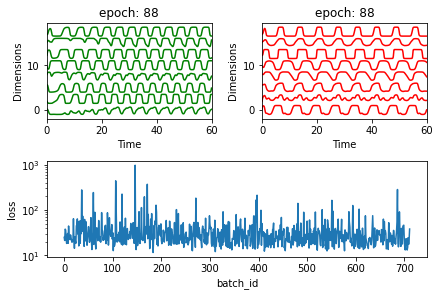

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.05918585  0.5065337   0.70013317  0.62124613 -0.44033781 -0.00333031
   0.49318644  0.24590839]
 [-0.21389633  0.06600309 -0.36727358  0.87485729  0.47772184  0.8989762
   0.13665449 -0.53214391]
 [-0.8163227  -0.17623724 -0.76423323  0.37606362  0.67748649 -0.64521629
  -0.61730705 -0.98182646]
 [ 0.23409033  0.40679623 -0.05022035  0.3096893  -0.10860821  0.10523618
  -0.09425171 -0.5002913 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.09s/it]

[[-0.08895646  0.3250458   0.21752678  0.6026007   0.14833124  0.98228698
   0.42822922  0.1419404 ]
 [ 1.26923233  0.39273619  0.39397992 -0.17678961 -0.65347154 -0.1381521
   0.32226655  0.37073957]
 [ 0.97558471  0.06616373 -0.20681873 -0.20393989 -0.23625514 -0.7865801
  -0.18537533  0.15228994]
 [ 0.03445223  0.10169576 -0.17249664  0.55504577  0.0294612  -1.07734408
  -0.20991054 -0.65602228]]


 25%|██▌       | 2/8 [00:02<00:06,  1.04s/it]

[[ 0.99836163  0.51885277  1.38995493  0.19013194 -0.91908109  1.23832766
   1.5112031   0.54140859]
 [-0.19492956 -0.42845695 -0.68465106 -0.24545455  0.42812395 -0.62424705
  -0.40412371 -1.33970076]
 [-0.35158486  0.04115888 -0.01046293  0.64051292  0.61858254  0.99546839
   0.39466738  0.32632769]
 [ 1.12535433  0.68865467  1.19171456 -0.276132   -1.06097466 -0.79897641
   0.60662093  0.6099475 ]]


 38%|███▊      | 3/8 [00:02<00:05,  1.01s/it]

[[-1.07854055  0.30021567  0.80840924  1.48693565  0.75101947  1.66642847
   1.03518403  1.03522066]
 [-1.39624964  0.06648111 -0.84492209  1.40496212  1.28121926  1.37131922
  -0.23935222 -0.73801861]
 [-0.12241185  0.39224682  0.43786653  0.97582863  0.33569654  0.53906656
   0.40419963  0.63192134]
 [ 0.81455262  0.81426362  1.6086334   0.7081287  -0.85590037  1.48268598
   1.39128583  1.49189061]]


 50%|█████     | 4/8 [00:03<00:04,  1.00s/it]

[[-0.1675201   0.81661839  0.71912235  1.53403104  0.51618351  1.87383344
   0.81267978  1.13900032]
 [-0.55275794  0.14521722 -0.2320002   0.78474014  0.80372789  0.46573785
   0.09841767 -0.41760365]
 [-0.57158426  0.00325869  0.70474546  0.87842718  0.58732076  2.29594802
   1.2238117   1.10143793]
 [-0.35577059  0.18479522  0.26842689  0.69625756  0.23868763  0.87712691
   0.64455782 -0.20075055]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.02it/s]

[[ 0.3784194   0.59263033  0.93611539  0.43670909 -0.47984002  0.42122714
   0.76979769  0.42074635]
 [-0.32163611  0.34986531  0.29100183  1.14359397  0.36612143  1.06505828
   0.43342871 -0.35903439]
 [ 0.45818393  0.76996173  0.09746201  0.85926493 -0.21481975  0.42571615
   0.0639926   0.38721552]
 [ 0.28333598  0.43413956  0.74383264  0.4179189  -0.06556764  0.0457481
   0.49038051  0.4357557 ]]


 75%|███████▌  | 6/8 [00:05<00:02,  1.02s/it]

[[ 0.38967972  0.03129111  0.34226573 -0.05508497 -0.15343753 -0.22817895
   0.50973711  0.02633325]
 [-0.21789936  0.00567401  0.27237054  0.7225858   0.50185191  0.57373206
   0.54100924  0.33867532]
 [-0.89791169  0.26239151 -0.18921482  1.46475125  1.35868688  1.17478407
   0.18990755  0.38999035]
 [ 0.35411187  0.33125558 -0.00912981  0.22334848 -0.078974    0.15229556
  -0.12803029 -0.02867676]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.01it/s]

[[ 0.70100852  0.48196189  0.4286191   0.05673015 -0.47605208 -0.1210137
   0.24557438  0.65528119]
 [ 1.00696329  0.37366327  0.63925248 -0.03897717 -0.75087624  0.79683041
   0.79516576  0.05687462]
 [-0.07329596  0.01878656 -0.10864572  0.71786717  0.48038363  0.99174065
   0.38220624 -0.16990466]
 [ 0.21206855 -0.3015787  -0.18721144 -0.51861771 -0.19130896 -1.42972397
  -0.19545278 -0.66198251]]


100%|██████████| 8/8 [00:02<00:00,  3.04it/s]


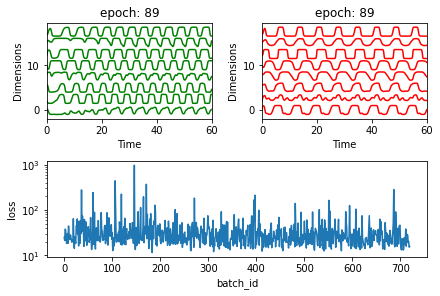

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.34270988  0.01389317 -0.59720891  0.13491715  0.36235931 -1.00146129
  -0.60061579 -1.0190189 ]
 [ 0.76865263  0.92272071  0.80437759  0.77423318 -0.67624795  1.38616222
   0.87948023  0.5029172 ]
 [ 0.75822552  0.60115213  0.82035245  0.42665148 -0.51214152  0.57964034
   0.77577772  0.3370389 ]
 [ 0.47012103  0.27985853  0.34607718 -0.1670612  -0.13854662 -0.48577533
   0.2233683  -0.21316159]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:11,  1.67s/it]

[[ 0.79863863  0.73890016  0.76212863  0.88336543 -0.16158358  1.21982659
   0.82867886  0.55614091]
 [ 0.57464932  0.08073279 -0.07610392 -0.6410145  -0.43240741 -1.91141721
  -0.43045737 -0.75824944]
 [-0.31774286  0.09692009 -0.55299105  0.59024792  0.50914044 -0.0561707
  -0.18050345 -0.36277697]
 [-0.7570799  -0.31095131 -0.87888213  0.6516111   1.10286402 -0.13233206
  -0.29022842 -0.89271222]]


 25%|██▌       | 2/8 [00:02<00:09,  1.52s/it]

[[ 0.91070919 -0.20628255 -0.56879367 -0.78108864 -0.59276482 -1.59394785
  -0.64829434 -1.22077522]
 [-0.01845402 -0.13176655  0.35584179  0.28011498  0.23829595 -0.51864344
   0.51288288  0.09453844]
 [ 0.94048852 -0.32920195 -0.1511369  -0.6842539  -0.42711097 -1.33222484
  -0.06645954 -1.201098  ]
 [ 0.83851627  0.07103271 -0.06746804 -0.5170155  -0.33952772 -0.95221211
  -0.24373413 -0.9684119 ]]


 38%|███▊      | 3/8 [00:04<00:07,  1.44s/it]

[[ 1.2965721   0.75905756  0.44841034 -0.18001284 -0.80829907  0.11627798
   0.16039211  0.01738931]
 [-0.35175859 -0.19760585 -1.03501722 -0.09526915  0.83068444 -0.80200091
  -0.72111304 -1.57854612]
 [ 0.06718271 -0.22234575 -0.63715388 -0.23764683 -0.09661553 -1.65678126
  -0.74597724 -1.00232587]
 [ 0.51086351 -0.1186731  -0.46423692 -0.44593135 -0.30154644 -0.58314962
  -0.30630982 -1.34024379]]


 50%|█████     | 4/8 [00:05<00:05,  1.41s/it]

[[ 1.67046815  0.71233625  1.00012383 -0.63650903 -1.2655796   1.11886238
   1.0335434   0.76165909]
 [ 0.12744892 -0.08016252  0.55249317 -0.35346249 -0.33721643 -1.46369458
   0.08987523 -0.07319916]
 [-1.47022143  0.11514211 -1.03988491  1.92092375  1.84390134  1.28631845
  -0.32999671 -0.55902902]
 [-0.82349237  0.04693579 -0.68492531  0.71294437  0.93627046 -1.03105312
  -0.63206037 -0.57585696]]


 62%|██████▎   | 5/8 [00:06<00:04,  1.38s/it]

[[-0.84861065 -0.22004219 -1.02969746  0.94898806  1.42649694 -0.1108419
  -0.43541048 -1.16118568]
 [-0.06776143  0.43029287  0.18513276  0.72146692  0.05646679  1.2199381
   0.41987301  0.00728609]
 [-0.13738857 -0.28938409 -0.89445243 -0.20186738  0.36631288 -1.33775965
  -0.84709273 -1.42171776]
 [ 1.12385726  0.73586286  1.1414247   0.05067737 -0.93688481  1.51559161
   1.1831708   0.81147725]]


 75%|███████▌  | 6/8 [00:07<00:02,  1.31s/it]

[[-0.21531336 -0.42284797 -0.21855498  0.04427787  0.38754309 -0.13499338
   0.13851101  0.04195178]
 [ 1.35846536  0.71783412  1.27792953  0.05284351 -0.98592382  0.86916354
   1.22532858  1.70830998]
 [-0.23611474 -0.70511792 -1.42430181 -0.66259537  0.64054532 -2.81373464
  -1.3860572  -2.05650464]
 [ 0.3122747   0.00963017  0.11467527  0.69669232  0.38905897  0.38773462
   0.38348931  0.10481856]]


 88%|████████▊ | 7/8 [00:09<00:01,  1.27s/it]

[[-0.18137378  0.10319396 -0.1200974   0.49285819  0.25324137  0.12482532
   0.11107017 -0.66073164]
 [ 1.27921913  0.55553119  1.1224021  -0.51505227 -1.36857229 -0.45865381
   0.75107099  0.05791253]
 [ 0.97391691  0.52977746  0.16893752 -1.050621   -0.73930472 -0.89957988
  -0.48271191 -0.40114013]
 [ 1.44836502  0.2463849   1.19520064 -0.93446596 -1.17418896  0.19478539
   1.23813181  0.66492086]]


100%|██████████| 8/8 [00:02<00:00,  3.13it/s]


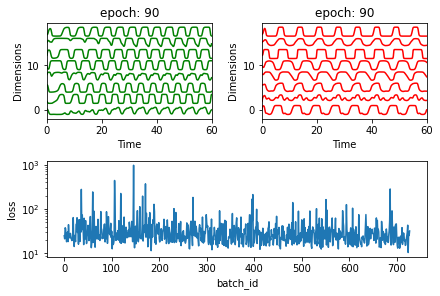

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 6.51530766e-01 -1.37524885e-04  1.83542862e-01 -1.04225170e-01
  -5.02585753e-01 -3.48486888e-01  2.65205865e-01 -4.17844918e-01]
 [-1.16880464e+00  3.11998246e-01 -4.17697228e-01  1.48588828e+00
   1.07962625e+00  1.68403108e+00  2.60551385e-01 -5.86566121e-01]
 [-4.92752309e-01  2.81926775e-01  1.13595073e+00  8.11403966e-01
   1.72195362e-01  5.82471499e-01  1.00243430e+00  9.06970846e-01]
 [ 1.85534788e-02  3.91864613e-01 -2.10036079e-01  5.41231756e-01
   1.95711734e-01  3.01704376e-01 -2.15771292e-01 -7.83622765e-01]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.04s/it]

[[-0.90538356 -0.46704112 -1.28026146  0.27717664  1.18524114 -1.14750932
  -0.95869603 -1.65396102]
 [ 0.75038388  0.40607409  0.38615412 -0.107537   -0.56556984  0.18928372
   0.35293834 -0.29530444]
 [ 0.3226146   0.27512615 -0.19958525 -0.04315961  0.10035217 -0.64342973
  -0.36253212 -0.35645575]
 [-0.21613965  0.11125516  0.22188187  0.81313512  0.26781432  0.40205698
   0.46432812 -0.02939319]]


 25%|██▌       | 2/8 [00:02<00:06,  1.03s/it]

[[-1.70280616 -0.2950469  -0.37376463  1.36057465  1.70062176  1.60170118
   0.60165341 -0.58346784]
 [-0.63086096  0.18736631 -0.23888249  0.83338522  0.66032299  0.12118676
  -0.11410234 -0.2089848 ]
 [ 0.3005193   0.48451311  0.14055372  0.44742698 -0.00682037 -0.31372727
   0.10111201 -0.31798508]
 [ 1.07273251  0.52113564 -0.05005337 -0.09291844 -0.7512194  -0.87316667
  -0.43538954 -0.5891296 ]]


 38%|███▊      | 3/8 [00:02<00:04,  1.00it/s]

[[ 0.44605416  0.78638142  0.7282986   0.86605529 -0.27359418  0.55432075
   0.62570155  0.71113464]
 [ 1.86143718  0.48804988  0.53756248 -0.82332706 -1.26877397 -0.76831435
   0.15178558 -0.07990799]
 [-0.39504489 -0.13964739  0.04450776  1.01230671  0.73995511  0.60365162
   0.53263977 -0.21822166]
 [-0.19516565  0.37823793 -0.04676814  0.61500228  0.26130387 -0.04117499
   0.02703456 -0.24418656]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[-0.19018557 -0.19706243 -0.03067374  0.02819204  0.00475759 -0.19677907
   0.19386074 -0.38829299]
 [ 0.40894408  0.19591696  0.13070079 -0.40098846 -0.47759628 -0.66666082
  -0.11203239 -0.51567573]
 [-0.67444211 -0.53451702 -0.53432408 -0.15162104  0.72655933 -1.80854674
  -0.55345853 -1.36969832]
 [-1.16124713  0.0984861  -0.0968231   1.50739274  1.1506867   1.49410443
   0.48359862 -0.0666562 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.00it/s]

[[-0.40198868  0.14812384 -0.01331248  1.12006242  0.57068808  0.99799885
   0.37238965  0.04109703]
 [-0.95335849 -0.68069587 -1.29259396 -0.20401848  0.87011763 -1.86446853
  -1.00558575 -2.23141833]
 [-0.3963505  -0.30448434 -0.29869354  0.24674684  0.85374423  0.32098298
   0.04949663 -0.33977695]
 [-0.69683899 -0.3145852  -1.35508541  0.36654566  0.69361018 -1.62308072
  -1.32480663 -1.52385635]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.02it/s]

[[ 0.27442513  0.41959078  0.6283787   0.3600847   0.03509793  0.56841219
   0.74289799  0.43620678]
 [-0.08085339  0.20995468  0.61419152  0.41802605 -0.1992136   0.13059336
   0.51686439 -0.18456995]
 [-0.08073238  0.38065424  0.00823994  1.2800411   0.63234181  1.4072482
   0.60861006 -0.03093371]
 [ 0.82416841  0.76214023  1.28639685  0.64851148 -0.5366262   1.40553947
   1.27156401  1.04644505]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.03it/s]

[[ 0.13101764 -0.18802047 -1.14178574 -0.10296346  0.1539631  -1.46650458
  -1.09199567 -1.90319623]
 [-0.21765524  0.13144324 -0.39813594  0.63176227  0.49026835 -0.17426232
  -0.14265558 -0.49830047]
 [ 0.26806546  0.78710785  0.82658805  1.57804222  0.17484815  1.99019813
   1.1596999   1.21361334]
 [ 1.47996802  0.33406907  0.52384802 -0.24595712 -0.88336072 -0.26981061
   0.17090182  0.5993267 ]]


100%|██████████| 8/8 [00:02<00:00,  2.96it/s]


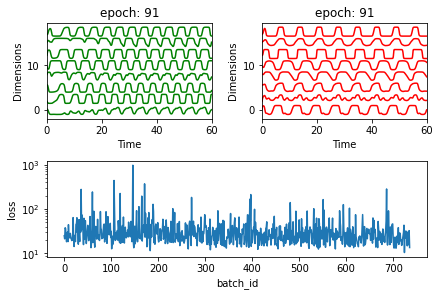

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.45454879  0.46570384 -0.24413244  1.47883779  0.8794932   1.74485537
   0.34276386 -0.32901375]
 [ 0.50898631  0.91492377  1.16562068  0.86806547 -0.33853516  1.90467377
   1.14083871  1.31634274]
 [-0.43678482 -0.31564307 -0.32143238  0.65487072  0.48854173  0.17223203
   0.11262411  0.06109539]
 [-0.36161634  0.29664844  1.15053681  1.19910089  0.22807738  1.66880012
   1.41888414  1.22024154]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.05s/it]

[[-0.40309818  0.22580805 -0.51003209  0.6931305   0.47305461  1.47858533
   0.01268864 -0.93740432]
 [ 0.19663902  0.41541277 -0.14157992  0.80560231  0.35575104  0.81365729
   0.06975766  0.13466452]
 [ 0.48202172  0.09947219  0.38728248 -0.01434702 -0.31794058 -0.3968409
   0.38612843  0.01346617]
 [ 0.2234191  -0.04327514 -0.84961121 -0.24397326  0.14516536 -1.63415122
  -0.96796481 -2.13375865]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.05s/it]

[[ 0.20056215 -0.41053923 -0.62174432 -0.41172939  0.60743782 -1.53747559
  -0.5756292  -1.16826965]
 [ 0.1814192   0.25404874  0.24561719  0.63963611  0.01903597  0.23527865
   0.19153497  0.16118809]
 [-1.50049118 -0.61016261 -0.95332919  0.85524673  1.45957201 -0.22566697
  -0.50191186 -1.06280552]
 [ 0.74301372  0.31591454 -0.04937311 -0.53986283 -0.66988603 -0.57775705
  -0.28503897 -0.14243371]]


 38%|███▊      | 3/8 [00:03<00:05,  1.05s/it]

[[-8.77759453e-01 -1.02469453e-01 -6.21826218e-01  1.27168422e+00
   9.88108549e-01  5.11819955e-01 -1.61840310e-02 -5.96491880e-01]
 [-9.63378835e-01 -1.80770690e-01 -1.46604502e+00  5.05793680e-01
   1.11676998e+00 -4.90451244e-01 -9.69814364e-01 -2.04587957e+00]
 [-6.57407007e-01 -2.59773191e-01 -6.84177873e-01  6.10722805e-01
   8.56694901e-01 -4.27675691e-01 -4.71584851e-01 -1.10574688e+00]
 [ 5.64761408e-02  1.83600895e-03 -3.09697031e-01  1.18405021e-01
  -5.68232817e-02 -1.39512913e+00 -4.61570362e-01 -1.20150716e+00]]


 50%|█████     | 4/8 [00:04<00:04,  1.02s/it]

[[ 1.43912482  0.42440671  0.6116463  -1.19425886 -1.33396443 -1.20182913
   0.15785858 -0.6982971 ]
 [-0.04538139  0.16939553 -0.35001842  0.41849901  0.25103628  0.21001489
  -0.04682906 -1.03233626]
 [ 0.16131482  0.42586009  0.28358101  0.59822931  0.03839663  0.43243882
   0.43791376  0.33960981]
 [-0.43735835  0.58147544 -0.70402021  0.85792864  0.58770278  0.12010428
  -0.63508832 -0.48759953]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.09s/it]

[[ 0.25964158  0.20666134  0.55658493  0.50884811 -0.18816595  0.74459619
   0.89907248 -0.02480192]
 [ 1.25773978  0.01802083 -0.08439896 -1.17158567 -0.69868062 -2.39208574
  -0.70342423 -0.78037084]
 [-0.30293457 -0.27731203 -0.96768035 -0.09419116  0.49330241 -1.94933664
  -1.06044027 -1.84199851]
 [ 0.29454674  0.55479295  0.52886654  0.68873467 -0.54000691  0.4288358
   0.53977883 -0.09571834]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.08s/it]

[[ 0.69699486  0.20959064  1.04247521  0.28775024 -0.17684906  0.42322516
   1.03792862  0.57121271]
 [-1.06318006 -0.38987973 -0.69456325  1.12531209  1.34328448 -0.54168799
  -0.13310318 -0.88052259]
 [ 1.13829428  0.6877736   0.35963978  0.03819832 -0.61039292  0.45809645
   0.33665181 -0.03168677]
 [-1.10574473 -0.41982891 -0.60505133  1.45865225  1.50944373  0.48476193
   0.23343494 -0.47926653]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.10s/it]

[[-1.12839042e+00 -1.36707745e-02 -6.59295397e-01  7.99273462e-01
   9.99087456e-01  4.72905924e-01 -1.94745230e-01 -1.23008097e+00]
 [ 1.70608107e+00  1.93514715e-01  2.31584469e-01 -1.09352036e+00
  -1.14165044e+00 -1.18414488e+00  4.99631213e-04 -9.95930010e-01]
 [ 1.46401056e+00  9.35002862e-01  6.22089683e-01 -2.52145472e-01
  -1.33038197e+00  3.58450417e-01  2.68361307e-01  1.49266134e-02]
 [-3.71779800e-01  1.94790246e-01 -2.67066566e-01  1.08584519e+00
   5.44408024e-01  1.54548980e+00  3.34354212e-01 -3.70345235e-01]]


100%|██████████| 8/8 [00:02<00:00,  2.92it/s]


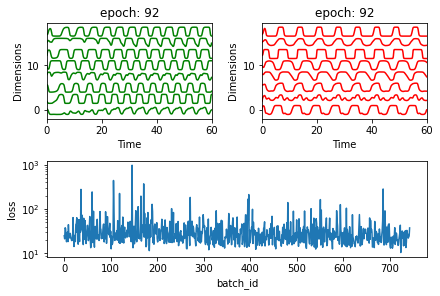

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.3481582   0.19303169  0.05458415  0.08840257 -0.12786616 -0.49563509
  -0.0596222  -0.39193828]
 [-1.31064436  0.22014058 -0.04856806  2.14955839  1.42494229  3.01765845
   1.00310764 -0.42220191]
 [ 2.06691302  0.64172126  1.64245295 -0.290075   -1.67847326  0.27672829
   1.26882028  1.17535528]
 [ 1.26359989  0.39646555  0.89777018 -0.50352002 -1.21885723  0.36062212
   0.85664588  0.45125329]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.05s/it]

[[ 0.24077506  0.3030859   0.3898141   0.17734703 -0.08383931 -0.7380289
   0.13019999 -0.22029244]
 [-0.62610136 -0.49673931 -1.10541266  0.60717708  0.9194187   0.03012068
  -0.47799443 -1.27472732]
 [-0.15020838 -0.53667076 -0.6138063  -0.51099365  0.62978709 -1.60047932
  -0.65002114 -1.02692735]
 [-0.83239529 -0.17379359 -0.04014271  1.42859769  1.25815769  1.19806695
   0.71417399 -0.15771092]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.05s/it]

[[-1.06963117e+00  7.03581861e-01  4.36759775e-01  2.07024857e+00
   1.10358913e+00  2.25423580e+00  6.75626843e-01  1.03825433e+00]
 [-2.77031894e-01  1.25057752e-01 -2.61829533e-01  6.43485888e-01
   3.94832107e-01  2.24191578e-03  4.16794633e-03 -7.85396687e-01]
 [ 1.25305130e-01  6.78795002e-01  6.45230431e-01  1.12888159e+00
  -1.84846412e-01  1.26825852e+00  7.53976123e-01  9.27082541e-01]
 [-5.06513623e-01 -2.31573460e-01 -3.55143509e-01  6.02868599e-01
   9.50548392e-01 -4.64506534e-02 -3.84937792e-02 -3.73426935e-01]]


 38%|███▊      | 3/8 [00:03<00:05,  1.01s/it]

[[ 0.33540134 -0.14821811 -0.32515292 -0.52803193 -0.42825958 -1.84409015
  -0.49897783 -1.24038235]
 [ 0.35284948 -0.07116219  0.4205879  -0.27825628 -0.0614606  -0.69524555
   0.30428784 -0.03751009]
 [ 0.25140493  0.20901815  0.24931686  0.04272126 -0.13832953  0.20164396
   0.45611884 -0.53908988]
 [ 1.15857121 -0.09080667  0.22336325 -1.18798875 -0.80677718 -2.44526903
  -0.3101966  -0.66930321]]


 50%|█████     | 4/8 [00:04<00:04,  1.09s/it]

[[ 0.60993008  0.25331291  0.09303106  0.30903518  0.06535528 -0.29678912
   0.29417266  0.07576047]
 [-0.85467751  0.59620181  0.77853922  1.67181688  0.81270747  2.72159534
   1.31108155  0.7969139 ]
 [ 0.66991659  0.72664364  1.79511131  0.17407954 -0.89364106  1.6080431
   1.77186308  1.32918373]
 [-0.39702746  0.51317244 -0.20427628  1.1655531   0.4346935   1.12927948
   0.08837528  0.33172734]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.06s/it]

[[ 0.3152115  -0.10736573 -0.26134002 -0.33866113 -0.14596425 -1.32430634
  -0.42167615 -1.26218661]
 [ 0.59639146  0.39031974  0.61602543  0.0089518  -0.40204686 -0.08952752
   0.5482348   0.03338509]
 [ 1.42885677  0.98747742  1.16392263 -0.12165068 -1.40734746 -0.076116
   0.571271    0.94136465]
 [-0.30256288  0.08999314 -0.10602162  0.61327263  0.49042999 -0.20955701
  -0.09036348 -0.21803665]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.02s/it]

[[-0.17288291 -0.11035118 -0.37468074  0.59771365  0.60012593 -0.68847333
  -0.28676863 -0.1225507 ]
 [-0.91762151 -0.01192646 -0.08869377  0.74537354  0.87130856 -0.05231744
   0.09942157 -0.13346756]
 [-0.34692223  0.71414869  1.07157325  0.88411613  0.11355084  1.35556914
   0.9935428   0.20458619]
 [ 0.92069705  0.25048501  0.28199753  0.05997564 -0.56014661  0.74022169
   0.49013846 -0.24866318]]


 88%|████████▊ | 7/8 [00:07<00:00,  1.01it/s]

[[ 1.22314066 -0.18005954 -0.59994303 -0.9491741  -0.35121709 -1.82001735
  -0.79928238 -0.88894457]
 [-1.0453931  -0.82033024 -0.65871851  0.43159299  1.42421055 -1.28886105
  -0.25750013 -0.80555836]
 [-0.16961215  0.65927082  1.54040932  1.53754346  0.12471914  2.24841862
   1.76412656  1.62127519]
 [-1.86741061 -0.38621868 -1.12104977  1.22245857  1.52679646 -0.0447708
  -0.44620462 -1.11317038]]


100%|██████████| 8/8 [00:02<00:00,  2.93it/s]


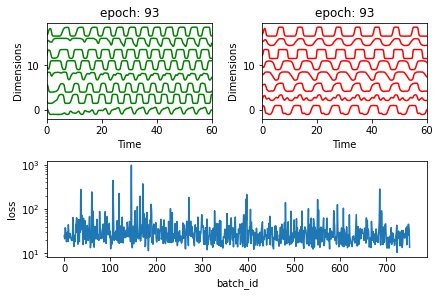

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.44558466  0.1195524  -0.72619879  0.71258461  0.81126304 -0.31067522
  -0.53734108 -1.07121411]
 [ 1.14846924  0.23782323  0.66621645 -1.10701802 -1.04771526 -1.30414927
   0.23793617 -0.19864139]
 [ 0.23691346  0.05439345  0.12348108 -0.23346921 -0.10782279 -0.0809104
   0.17387236 -0.49561202]
 [-0.08255229  0.03163169 -0.13942007  0.26410277  0.24946802  0.18449752
   0.15885492 -0.58338015]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.07s/it]

[[-0.19894376 -0.29639769 -0.05656725 -0.20190203  0.11963625 -0.96112476
  -0.12453393 -0.60879886]
 [ 0.44801359  0.29095342 -0.00495141  0.21034208 -0.05068257  0.48451792
   0.29715575 -0.18780219]
 [-0.64627037 -0.21355973 -1.19333282  0.61930724  0.92405852 -1.04284286
  -1.14294126 -1.39772345]
 [ 0.09250326  0.15242268  0.43139104 -0.19654017 -0.00934998 -0.14323441
   0.18553564 -0.54536121]]


 25%|██▌       | 2/8 [00:01<00:06,  1.03s/it]

[[-0.87110303 -0.04268745 -0.52699108  1.09612821  0.8362872   0.27920857
  -0.21479427 -0.5998257 ]
 [-1.25642718 -0.123715   -0.25529003  1.14633476  1.31862008  0.83285354
   0.22479476 -0.50236563]
 [-1.2066079  -0.60055663 -0.8268593   0.81660687  1.54769539  0.06461485
  -0.05583296 -1.24041686]
 [-0.10847508  0.22211806 -0.30135222 -0.14626647  0.02424816 -0.6208084
  -0.37821187 -1.02261859]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:02<00:05,  1.01s/it]

[[-0.66438063 -0.32762799 -1.36345301  0.54897994  1.24301347 -1.53707918
  -1.18921509 -1.84241524]
 [-0.29079852  0.10175138  0.49042973  0.29389367  0.11398137  0.34944353
   0.72945383 -0.25156735]
 [-1.27403103  0.29895185  0.20827818  1.81876618  1.07031853  1.51214182
   0.6432328   0.2204107 ]
 [ 0.36484998  0.06805271  0.44688182 -0.06990688 -0.49216139 -0.40543009
   0.3882856  -0.4876481 ]]


 50%|█████     | 4/8 [00:03<00:03,  1.00it/s]

[[ 0.10415462  0.24417932  0.87991027  0.56343039 -0.18258703 -0.01264834
   0.67559404  0.35424766]
 [-0.14678291  0.31810341  0.85236647  0.70750171  0.11402539  2.22194481
   1.37333491  0.71448662]
 [-0.12092716 -0.2103888  -0.53972442 -0.22194694  0.25400404 -1.59752389
  -0.54767476 -1.10377628]
 [-0.22948563 -0.01418627 -0.23739286  0.4644118   0.44311887 -0.35418056
  -0.11679115 -0.73295366]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.01it/s]

[[-0.9284342   0.02855252 -0.23955863  1.30053015  1.45952569  0.01032335
   0.05153118  0.1806223 ]
 [ 0.01065661  0.10919165  0.16953511 -0.01476924 -0.04005513 -1.1346582
  -0.03138198 -0.58247844]
 [-1.04916115 -0.34013761 -1.67832375  0.6643222   1.54605372 -0.29627217
  -0.94685255 -1.96399683]
 [ 0.14849129  0.23480877  1.25882735  0.43559338 -0.30404453  0.94462788
   1.36761589  0.28658006]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.02it/s]

[[ 7.88949952e-04 -7.24101361e-02 -7.89966751e-01  4.45250322e-01
   1.82826998e-01  1.36419956e-02 -2.84820574e-01 -1.40764309e+00]
 [-4.25153067e-01  3.13466805e-01  2.62601309e-01  7.77876014e-01
   5.76534511e-01  4.71066620e-01  4.01244096e-01 -3.14663717e-02]
 [-2.50738569e-02  7.81774446e-01  6.74923013e-01  1.19630159e+00
   2.38987327e-01  2.23240686e+00  9.83227315e-01  8.18248703e-01]
 [-4.90285113e-01  3.35587545e-02  2.08637359e-02  8.51004250e-01
   5.29167949e-01  5.24177321e-01  2.90135823e-01  8.27874669e-03]]


 88%|████████▊ | 7/8 [00:06<00:01,  1.02s/it]

[[ 0.05993166 -0.67193043 -0.81080143 -0.92482867  0.26845851 -2.57103073
  -0.7924888  -1.6089624 ]
 [-0.259816   -0.54986098 -0.5631441   0.0035858   0.90858875 -1.02874308
  -0.31379567 -1.18124837]
 [ 1.11006312  0.31933763  0.34406521 -0.29549806 -0.69201883 -0.16707767
   0.32837198  0.4630411 ]
 [-0.86989986 -0.03574527 -0.72701549  0.96397414  1.00825581  0.3352488
  -0.29891585 -1.12466175]]


100%|██████████| 8/8 [00:02<00:00,  3.14it/s]


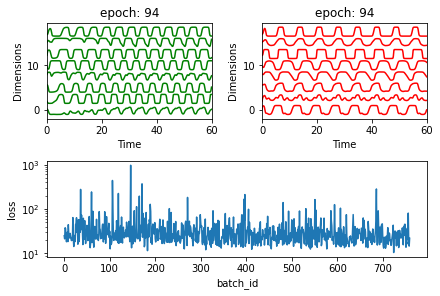

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.11411593 -0.11441361 -0.05438682 -0.3854497  -0.02974264 -1.46970596
  -0.29254073 -0.38136162]
 [ 0.47575086  0.35802344  0.64370654  0.70687428 -0.17985333  0.83328062
   0.86286194  0.53819765]
 [ 0.99307502 -0.1816537   0.44180644 -0.79771559 -0.90277867 -0.78005798
   0.34077013 -0.60617529]
 [-1.31477603 -0.03415361  0.12522572  1.48654147  1.28786819  0.93098187
   0.51369862 -0.1462712 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.07s/it]

[[-0.68702368 -0.11069627 -0.28682714  0.66496495  0.60220745  0.00576887
   0.13333871 -0.7686719 ]
 [ 0.05110324  0.32980426  1.07811465  0.63095745 -0.07342778  0.40738733
   1.00970396  0.93183156]
 [-0.45766955  0.24960357  0.01169805  1.08799239  0.70219222  1.18078185
   0.41353771 -0.14806475]
 [ 0.49958561  0.08843759 -0.39131943 -0.12566896 -0.21231956 -1.1408239
  -0.44385788 -0.60604116]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:06,  1.04s/it]

[[-0.03803086  0.43419964  0.31847182  0.95048963 -0.06474988  1.01548415
   0.40511254  0.54520657]
 [ 0.69978578  0.32119955  0.42528753  0.47548967 -0.25981197  0.7788743
   0.59922087  0.49470618]
 [-0.8125789  -0.05429998 -1.29187847  0.38055209  0.8056428  -0.77343258
  -0.98476166 -1.88674273]
 [ 0.99926215 -0.05598373 -0.1457626  -0.97766033 -0.56340898 -1.47350162
  -0.32951669 -1.29837195]]


 38%|███▊      | 3/8 [00:03<00:05,  1.03s/it]

[[ 6.42207711e-01  7.69260554e-01  7.86307393e-01  2.37153634e-01
  -4.26681048e-01  1.81973138e-01  5.05525599e-01  3.80937537e-01]
 [ 7.06861202e-01  4.37406748e-01  7.81963179e-01  4.68180890e-02
  -3.09643439e-01 -4.24606951e-01  6.07036394e-01  3.16712149e-01]
 [ 1.01446858e+00  3.00779531e-01  7.48762131e-01 -3.61965817e-01
  -7.74268572e-01  1.54267634e-01  7.36867902e-01 -6.10738129e-02]
 [ 4.12351747e-02 -3.99450820e-04  4.70161553e-01  4.04132494e-01
   4.98710916e-02  8.80052295e-01  7.82940056e-01 -1.07779509e-01]]


 50%|█████     | 4/8 [00:04<00:04,  1.04s/it]

[[ 1.87959187  0.50729314  1.07543009 -1.04521791 -1.7007487  -0.16419353
   0.60324229  0.16517204]
 [-2.03026266 -0.29365763 -0.53650619  1.78775904  1.71313958  0.66750868
  -0.00613968 -0.43325682]
 [ 0.22736161  0.57475237  0.80529318  0.91565725  0.04156863  1.42466378
   0.98096046  0.6771147 ]
 [ 0.38731063  0.48499338  1.77663012  0.06687041 -0.92752055  0.25349291
   1.13029262  0.57805646]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.01s/it]

[[ 1.32511202e+00 -1.92572402e-03 -1.58436501e-01 -1.01740563e+00
  -9.65577480e-01 -1.25560884e+00 -3.40872789e-01 -1.08819484e+00]
 [ 1.22585321e+00  1.18676482e-01  3.78549488e-01 -9.14273822e-01
  -9.18384390e-01 -1.08219631e+00  1.25802859e-01 -5.03623309e-01]
 [ 1.33613739e-01 -1.13690038e-01 -1.52230833e-01  6.65665273e-02
  -1.72485955e-01 -5.33662648e-01  1.90477989e-01 -9.40000149e-01]
 [ 8.30865211e-04  2.27805520e-01  9.54507573e-01  6.21515986e-01
   4.99350464e-02  2.77952253e-01  9.62487185e-01  4.78949881e-01]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.01it/s]

[[-0.0553491   0.21000261 -0.64618963  0.55639637 -0.0671604  -0.30255527
  -0.50067651 -0.8609412 ]
 [-0.59848714 -0.24699055 -0.48836521  0.71730995  0.93150517 -0.54188582
  -0.22599282 -0.05516493]
 [ 0.52053518 -0.19195558  0.33422776 -0.24162652 -0.35741093 -0.36076979
   0.4474779  -0.41685091]
 [ 0.92011825  0.15419982  0.92348023 -0.51025684 -0.97206851 -0.8626664
   0.74517183 -0.12224017]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.02it/s]

[[-0.23384015 -0.3461403  -1.15086373 -0.21580478  0.39237119 -1.58805672
  -0.97837549 -2.05689438]
 [-0.65450044  0.19806212 -0.12282927  1.50685954  0.84527721  1.26695165
   0.44444403  0.1679013 ]
 [ 0.62621865  0.22328559  0.49746913 -0.16266789 -0.53130893 -0.16545707
   0.36880442  0.47913004]
 [-0.20889829 -0.34887904 -0.28726428  0.14227421  0.74348167 -1.14614881
  -0.12206362 -0.43320708]]


100%|██████████| 8/8 [00:02<00:00,  2.99it/s]


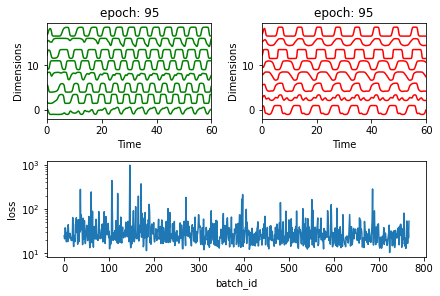

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.02168352  0.46516999 -0.13232387  0.8576588   0.3122124   0.92574509
   0.02568071 -0.09701819]
 [ 0.00843008  0.15722207  0.32998385  0.26104976  0.39129188 -0.19011416
   0.42474805  0.3681695 ]
 [ 1.05845225  0.27930079 -0.09244461 -0.39667945 -0.45193244 -0.19441254
  -0.09178472 -0.45522133]
 [ 0.79408666  0.10883096  0.44124252 -0.69376631 -0.49373867 -1.41677907
   0.24695907 -0.3923725 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.12s/it]

[[-1.5378824   0.01889967 -0.07877348  1.87067372  1.48481527  0.87633777
   0.5189633  -0.25920966]
 [-1.0140851   0.19534721 -0.24207187  1.32322768  1.09825548  1.19828972
   0.23981129 -0.27420924]
 [-1.56630051  0.56999054 -0.01331473  2.10716706  1.49789343  1.69690298
   0.35960671  0.21833254]
 [ 0.23307434  0.5137149   0.00851486  0.5032277  -0.01803125 -0.20378581
  -0.20685699 -0.15353502]]


 25%|██▌       | 2/8 [00:02<00:06,  1.07s/it]

[[-0.22659106 -0.0522192  -0.67388099  0.17333972  0.30901601 -0.71476255
  -0.49981201 -0.84860614]
 [-0.2023653  -0.27113001 -0.38456984  0.3607478   0.39461795 -0.38211739
  -0.13352759 -0.94669746]
 [-0.01800429 -0.05036749 -0.33666081 -0.10928877  0.00739328 -0.52287628
  -0.15410392 -1.18170341]
 [ 0.91592522  0.17685179  0.78652791 -0.20283923 -0.70924156  0.03136699
   0.7390374   0.56064507]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:03<00:05,  1.06s/it]

[[-0.03912771  0.14845187  0.16754957  0.32847755  0.40403374  1.0977845
   0.52185254  0.03610326]
 [ 1.46825602  0.40532278  1.11695207 -0.74470742 -1.52386647 -0.14996171
   0.74106214  0.40074285]
 [-0.20451729  0.7593137   0.40551095  1.28164005 -0.12287896  1.13927975
   0.40717253  0.26059558]
 [ 0.32441901 -0.31233366 -0.46619468 -0.43492903  0.1406137  -0.86248349
  -0.22953611 -1.03213968]]


 50%|█████     | 4/8 [00:04<00:04,  1.03s/it]

[[ 0.45408274  0.39354172  0.13678087  0.16382665 -0.48786875 -0.23952356
   0.02804024 -0.54565834]
 [-1.44038894 -0.36920275 -1.73567604  1.08810076  1.85021668  0.07672095
  -0.87914159 -1.51249186]
 [ 0.01274724  0.22210309  0.17836288  0.55330774  0.0348595  -0.18433807
   0.23213768 -0.30349486]
 [-0.03155541  0.30944681  0.07498468  0.99338141  0.14201987  0.14649318
   0.25918988 -0.08618842]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.00s/it]

[[ 0.83671169  0.55018625  0.70401882  0.06413926 -0.61683898 -0.13870123
   0.22477343  0.78935364]
 [ 1.25801967  0.51303058  0.05826014 -0.45206814 -0.8051568  -1.02387904
  -0.3582378  -0.51380345]
 [-1.12128542 -0.29186524  0.20528048  0.98469109  0.90837451  0.15698435
   0.54385987  0.00799603]
 [ 0.26643616 -0.51988014 -0.08081226 -0.91636896 -0.19183513 -1.5219535
  -0.04301538 -1.3481838 ]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.03s/it]

[[ 0.0460818  -0.20856142 -0.04029784  0.10345377  0.31176739 -0.06674417
   0.25223399 -0.34691178]
 [-1.56511739 -0.23385864 -1.65007293  1.32731177  1.83322532 -0.12532454
  -1.10897708 -1.62699075]
 [ 0.97586181  0.85371668  1.55539512  0.27209271 -0.81230357  0.85150812
   1.0530114   1.1349866 ]
 [ 1.14436878  0.12470809 -0.01261252 -0.86287584 -0.77465961 -1.37513704
  -0.32645457 -0.57472763]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.00s/it]

[[-0.53371123  0.65353885  0.15125316  1.61315175  0.68898787  1.25087586
   0.44998944  0.17818017]
 [-0.80230262  0.11857127  0.27930322  1.16560404  0.80742509  1.35320084
   0.72467909  0.37891456]
 [ 0.82483377  0.5153727   1.10763015  0.12752951 -0.96440596  0.46890371
   0.9942709   0.93085819]
 [-1.18800512  0.1066746  -0.83184536  1.34024197  1.20768566  0.85908846
  -0.50414865 -0.71640037]]


100%|██████████| 8/8 [00:02<00:00,  3.05it/s]


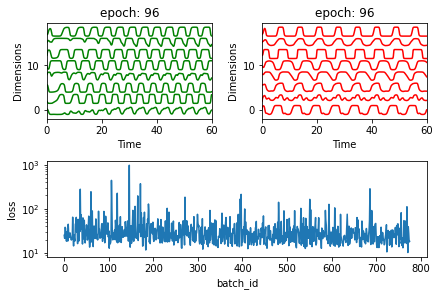

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.14460801  0.18731865 -0.12386904  0.57425258  0.04645632  0.15638093
   0.18194793 -0.33093987]
 [-2.01035312 -0.54746567 -1.79204685  1.70100316  2.1180342   1.00790847
  -0.67852856 -1.51783851]
 [-0.54367514  0.26673991 -0.71215485  1.26998841  0.80111831  0.98165055
  -0.20642996 -0.39978955]
 [-0.59123847 -0.10661714  0.03629142  0.96227203  0.59743881  1.37590501
   0.66648486  0.25582985]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.01it/s]

[[ 0.07668058 -0.12341789 -0.01195838  0.10561721  0.56372985  0.04343388
   0.26198337 -0.5757997 ]
 [ 0.3586308   0.01043051 -0.56548781  0.02690225  0.2210034  -0.69135732
  -0.38554054 -1.033483  ]
 [ 0.04226288  0.00384565  0.37656467  0.0394913  -0.01249054 -0.43239477
   0.24645715  0.18248166]
 [ 0.61928894 -0.06378841  0.24046737 -0.20175681 -0.01042076  0.04785013
   0.46096866  0.14967757]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.02it/s]

[[-0.16580019 -0.19096843 -0.1873507   0.20608295  0.45049409 -0.49961437
   0.05436545 -0.75952134]
 [-0.83940946 -0.94660604 -1.57542451  0.17277266  1.30283344 -1.26152141
  -1.0010035  -2.12301405]
 [ 1.38637358  1.02656003  1.76961476  0.32650473 -1.14123765  1.41914705
   1.50666613  1.38098303]
 [-0.52866327 -0.1094668  -0.82176947  0.35118445  0.70867269 -0.4513119
  -0.4703955  -1.63859043]]


 38%|███▊      | 3/8 [00:03<00:05,  1.03s/it]

[[-0.01645769  0.61207648  0.70315572  0.88651528  0.18585638  1.24976311
   0.89608893  0.46255438]
 [-0.61583206 -0.29256716 -0.95166171  0.39861088  0.80648876 -0.06900327
  -0.50082685 -1.32078491]
 [-0.11039313  0.40864822 -0.28205404  0.95882126  0.39848466  0.43398464
  -0.00765903 -0.27627252]
 [ 0.42200053  0.55880947  1.20580447  0.98921156 -0.17485175  1.85990097
   1.39979173  1.47366821]]


 50%|█████     | 4/8 [00:04<00:04,  1.01s/it]

[[-0.56160253  0.3016037   0.19668514  0.81599642  0.43884012  0.55152071
   0.44689283  0.41509361]
 [ 1.35379136  0.18581903  0.51890478 -0.89598659 -0.96089309 -0.32696429
   0.35545261 -0.16202425]
 [ 0.90301986 -0.70932246 -1.10121673 -1.9307204  -0.68827841 -3.41446111
  -1.35611806 -2.11665308]
 [ 0.3541196   0.018754    0.13514251  0.36243146  0.13923231  0.02857084
   0.40939405 -0.10222779]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.01s/it]

[[-5.40177643e-01  6.21540790e-01  4.49681003e-01  1.17309709e+00
   3.03546395e-01  8.36417630e-01  4.31665316e-01  1.50357454e-01]
 [ 4.56590615e-01 -8.78004068e-04 -3.24598506e-01 -2.49737082e-01
  -2.06286529e-01 -5.35943979e-01 -2.28396083e-01 -8.70646162e-01]
 [-7.95649168e-01 -5.02922577e-01 -1.69537391e+00  1.76202758e-01
   1.16829596e+00 -7.98320607e-01 -1.15322000e+00 -2.38295464e+00]
 [-2.17389779e-01  4.20211865e-01 -8.03361455e-02  9.47050440e-01
   2.23735182e-01  7.42645912e-01  4.19960139e-01  1.43382584e-01]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.04s/it]

[[ 0.84385595  0.16404711  0.99985746 -0.42406662 -0.79277524  0.27068108
   1.06601932 -0.21815501]
 [ 0.38849907 -0.11831957 -0.30921515 -0.78442323 -0.28062315 -1.27215594
  -0.44487564 -1.72469352]
 [ 1.0154206   0.25775031  0.8855704  -0.30437478 -0.82516254 -0.65461748
   0.68588398  0.40542205]
 [ 0.09973652  0.14132808 -0.73209906  0.25620522  0.28690681 -0.15934189
  -0.40380857 -1.49681177]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.07s/it]

[[-0.05579475 -0.26477283  0.06839295  0.61404155  0.54838565  0.2117932
   0.62668807 -0.04380622]
 [-0.29001798 -0.03122496  0.15427477  0.24611831  0.57874533 -0.15711055
   0.36707049 -0.14772632]
 [ 0.9392394  -0.19014375 -0.04263684 -1.22266026 -0.67115236 -2.56791113
  -0.4485126  -1.03100166]
 [-0.21549364 -0.15158997  0.07959597 -0.01654561  0.16855487 -1.12447963
   0.06068318 -0.4331887 ]]


100%|██████████| 8/8 [00:02<00:00,  2.99it/s]


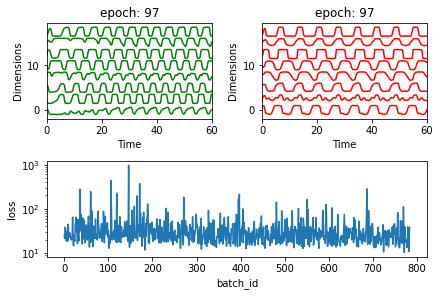

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.67827473 -0.25281867 -0.1701026   0.6185505   0.70886821  0.24451214
   0.22960161 -0.09032922]
 [ 0.74830316  0.34392412  0.11016277 -0.11838686 -0.65353334  0.29463133
   0.49934927 -0.77386822]
 [ 1.76611371  1.09471358  1.33049052 -0.06784188 -1.41758541  0.08500462
   0.82707628  1.02019463]
 [-0.0280952   0.82749097 -0.1942255   1.11201876  0.09548781  1.36983514
   0.01282358 -0.4350303 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.04s/it]

[[ 0.48338703  0.46716256 -0.23079371  0.06285162 -0.09983477  0.48958652
  -0.22712003 -0.79977281]
 [ 1.22784283  0.77908765  1.45423857  0.38103774 -0.94391045  1.43076281
   1.38792487  1.48267882]
 [ 1.27217393  0.49468538  1.69141712 -0.13074248 -1.24026962  0.63560749
   1.48169367  0.90537094]
 [-0.25915669  0.61070988 -0.63984679  0.87783763  0.40762869  0.74406741
  -0.34212228 -0.84282803]]


 25%|██▌       | 2/8 [00:02<00:06,  1.14s/it]

[[ 0.10960068  0.28339369 -0.20087915  0.89771393  0.48961131  1.51062854
   0.28812134 -0.28157384]
 [ 0.64267082  0.15997779  0.48713484 -0.24769644 -0.77777015  0.59810464
   0.71501885 -0.14856713]
 [-1.37390138 -0.70829275 -1.48005837  0.64319137  1.58242011 -0.1412872
  -0.54720403 -1.74813465]
 [ 0.90155255  0.01820002 -0.08248831 -0.35880529 -0.09135915 -0.21068682
  -0.0365765  -0.56140726]]


 38%|███▊      | 3/8 [00:03<00:05,  1.19s/it]

[[ 1.82858680e-01  3.60610975e-01  2.70834478e-01  7.54357787e-01
   2.46046818e-02  1.07278777e+00  6.16453347e-01 -9.04746969e-02]
 [-6.87554301e-01  2.80515299e-01 -1.72571622e-01  1.59933742e+00
   8.77590536e-01  1.21565601e+00  3.67000276e-01  2.31833942e-01]
 [ 7.80058252e-01  4.17908224e-01  9.49324982e-01 -7.08700564e-01
  -8.41060479e-01 -2.92394364e-01  6.82526693e-01 -7.05178605e-02]
 [ 1.19688286e-01  7.05689236e-01  4.88729492e-01  8.76706508e-01
   1.09291183e-03  5.33056428e-01  3.78701208e-01  2.66935974e-01]]


 50%|█████     | 4/8 [00:04<00:04,  1.17s/it]

[[-0.26874714  0.07818122 -0.51916048  0.41833708  0.49638807 -0.23254894
  -0.24179157 -1.07390979]
 [-0.74367078 -0.18671187 -1.32264163  0.42429895  1.26066043 -0.61616068
  -0.85373143 -1.81732319]
 [-1.03701372  0.0553844  -0.3130672   1.30561782  1.36584387  0.62911798
   0.11789243 -0.64698358]
 [-1.51796898 -0.28460185 -0.64862081  1.27490521  1.48204038  0.20768767
   0.08853214 -1.13994431]]


 62%|██████▎   | 5/8 [00:06<00:03,  1.19s/it]

[[ 1.21649325  0.8605179   0.79126367  0.35193337 -0.74615245  0.52855476
   0.72494958  0.33858016]
 [ 0.13334254  0.06302856 -0.31394476  0.10139617  0.08945738 -0.66434144
  -0.25448659 -0.59889334]
 [-1.02558893 -0.10088455 -0.77587652  1.38270945  1.25522415  0.96874984
  -0.17805498 -0.97920687]
 [-0.74473373  0.20385324  0.14869318  1.20872646  0.70399405  0.97240516
   0.43331873  0.34678147]]


 75%|███████▌  | 6/8 [00:07<00:02,  1.18s/it]

[[-0.0411908  -0.0519218  -1.08269672  0.40941857  0.64037738 -0.12301982
  -0.81116148 -1.100545  ]
 [-0.43383334  0.3950564   0.0441688   1.39157524  0.39702065  2.03930414
   0.62888687  0.46161361]
 [-0.58963622  0.53888628 -0.1978435   1.03273646  0.39801235  1.45677077
   0.11612279 -0.54747342]
 [ 2.73943322  0.33339391  0.39734542 -2.45201734 -2.07922521 -2.62897353
  -0.40892562 -0.56068062]]


 88%|████████▊ | 7/8 [00:08<00:01,  1.13s/it]

[[ 0.35508865  0.18156604  0.68636434  0.57231201 -0.28099446 -0.11802959
   0.60084318  0.27159812]
 [ 1.12066061  0.72126835  1.20340987  0.06661504 -0.96609992  0.86712465
   1.14001118  1.00555719]
 [ 0.43581644  0.02910349  0.05262227 -0.04382775  0.08941268  0.34293881
   0.2264447  -0.37178178]
 [-0.82702467 -0.12442991 -0.10481126  0.61411637  0.58060187  0.97255674
   0.43724986 -0.12415659]]


100%|██████████| 8/8 [00:02<00:00,  3.11it/s]


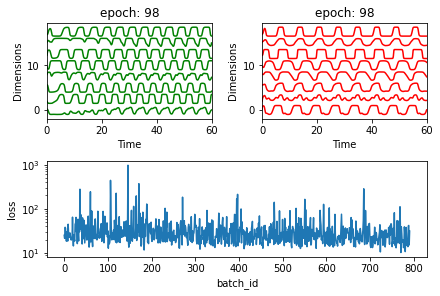

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.06187241  0.0771994   0.10257043  0.2126276   0.10144357 -0.18685166
   0.04572074  0.14189683]
 [-0.80915994 -0.66277844 -0.75783275  0.20761271  0.80901345 -1.61893626
  -0.6362143  -1.11891918]
 [-0.95544798 -0.45833647 -1.2568931   0.59638035  1.22834961 -0.13529154
  -0.64507051 -1.23205789]
 [-0.18923247  0.60747405  0.52665344  1.04760465  0.06672058  0.61931185
   0.61289567  0.64500535]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.16s/it]

[[-0.67242435 -0.05261626 -0.9500273   1.10478759  1.33239253  0.39615884
  -0.17571552 -0.92756504]
 [ 0.82969879 -0.29769573 -0.92066297 -1.23987973 -0.09897716 -2.54719306
  -1.29123162 -1.88993475]
 [ 0.44621734  0.14454109  0.0730083   0.02898874  0.01275855  0.07363557
   0.09926698 -0.04554551]
 [-0.5311965  -0.3308177  -0.97597647  0.3176056   0.88601155 -0.94234973
  -0.62619965 -1.38724998]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:02<00:07,  1.20s/it]

[[-1.29617085 -0.37876235 -1.17967621  0.71774255  1.32011098  0.45753469
  -0.41813109 -1.62528318]
 [ 0.30855337  0.53716233  0.14195699  0.05257866 -0.63994306 -1.73542894
  -0.47306658 -0.77892317]
 [-0.54582579  0.07449986  0.10248815  0.69188308  0.47651289  0.2285538
   0.34084671 -0.39450085]
 [ 0.14240384 -0.71551195 -0.83470444 -1.20389599  0.21289459 -2.72183227
  -1.05577442 -1.55911732]]


 38%|███▊      | 3/8 [00:03<00:05,  1.19s/it]

[[ 0.2160447   0.76334404  0.68264353  0.85946438 -0.45653523  1.98204716
   0.88566231  0.38195338]
 [ 0.67683353  0.39228913  0.46521295 -0.26964322 -0.67503728  0.09971549
   0.40344338 -0.37073897]
 [-0.5744357  -0.6131084  -0.59774538  0.0715641   1.08506425 -1.91499742
  -0.35931464 -1.0745371 ]
 [ 0.00636559  0.54942683  0.35409242  1.10743334  0.02053621  1.27878885
   0.62754018 -0.09714542]]


 50%|█████     | 4/8 [00:04<00:04,  1.19s/it]

[[ 0.53210336 -0.11581081 -0.70032937 -0.37151149 -0.06001982 -0.57746981
  -0.59414951 -1.26921645]
 [-1.22209393 -0.2245454  -0.31189653  0.93473068  1.22701721  0.45875889
   0.02181785 -0.86557973]
 [-1.27455766 -0.32671382 -1.21158164  0.91123205  1.1451977  -0.85929369
  -0.706832   -1.30568979]
 [ 0.54719644  0.37833952  0.26685368 -0.25174351 -0.30306326 -0.27824003
   0.03701247 -0.22737575]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.15s/it]

[[ 0.19487678  0.45437961  0.76611735  0.53262264 -0.16189849  0.58132624
   0.88168126  0.20966784]
 [ 0.93481536  0.96049238  1.69648929  0.53643209 -0.66667438  1.74587409
   1.67022133  1.5121786 ]
 [-2.51527563 -0.44465014 -1.06522258  1.91686314  2.43035883  0.14781218
  -0.40491404 -1.14600522]
 [ 0.38651608  0.19392604  0.47404059  0.15728062 -0.05315359  0.07170935
   0.40479389  0.02598939]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.09s/it]

[[ 0.659799    0.29532745  0.44817834 -0.32778235 -0.48036582 -0.08256229
   0.49942928 -0.68702891]
 [ 0.9195724   0.45753141  0.65909581  0.05979467 -0.39921633  0.48615055
   0.71259395  0.27314706]
 [-0.25049101 -0.33213423 -0.33112707 -0.03350434  0.37345713 -1.07349912
  -0.13969898 -1.33601511]
 [-0.06254488  0.39653233  0.02445839  0.879835    0.45956178 -0.00738375
   0.02584027 -0.10301009]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.05s/it]

[[ 9.65170318e-01  5.00182923e-01  4.06526854e-01 -3.14886014e-01
  -6.52082830e-01  1.70635892e-01  3.35810931e-01 -5.63662443e-04]
 [ 6.89680565e-01  5.32072668e-01  1.26103480e+00  3.71150685e-01
  -7.12535144e-01  1.79062607e+00  1.42892226e+00  4.57680749e-01]
 [ 7.98269092e-01  4.67450773e-01  3.11773790e-01 -5.55421495e-02
  -5.93016785e-01 -6.70244240e-01  3.45872039e-02 -1.99053929e-03]
 [-1.82711689e-01 -1.57072113e-01  2.79294164e-01  5.84351565e-01
   4.60550260e-01  1.23190240e+00  7.79042142e-01  2.76032356e-01]]


100%|██████████| 8/8 [00:02<00:00,  2.89it/s]


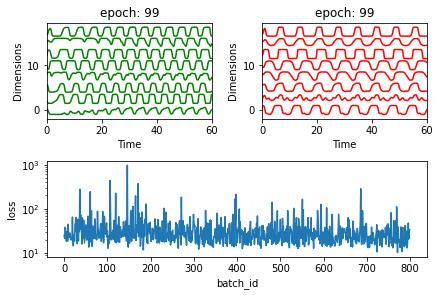

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.97672431  0.04708402  0.13557071  1.09248887  0.82887705 -0.10548942
   0.27122665  0.00814202]
 [ 0.11372163 -0.02334288 -1.00935812 -0.52969561  0.12728203 -1.25168145
  -1.0665433  -1.79594075]
 [-0.91495576 -0.27780508 -0.73067117  0.84092628  1.19705494 -0.29328329
  -0.38586007 -0.87887472]
 [ 0.81285912  0.34900589  0.96208124 -0.18417999 -0.53006689  0.58658857
   0.98537933  0.56297716]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.00it/s]

[[-0.73840802  0.09053228 -0.49675138  1.13259703  0.74473389  0.44253862
  -0.0196164  -0.64001395]
 [ 1.00177843  0.63325466  0.37685166 -0.32995192 -0.96345336  0.18494662
   0.12287947 -0.66619619]
 [-0.90403733  0.27876565 -0.36244368  1.41846342  0.93408333  0.96582859
   0.0436385   0.09965669]
 [ 0.67628112  0.99836469  1.13777227  0.85890598 -0.53706667  1.10017167
   0.98474844  1.28862115]]


 25%|██▌       | 2/8 [00:01<00:05,  1.02it/s]

[[-0.30878387  0.10429072 -0.48212372  0.50183206  0.67991093 -0.22385934
  -0.39283548 -0.52024291]
 [ 0.13566004  0.30370484  0.11290017  0.00341673 -0.14998544 -0.48133716
  -0.07776238 -0.1570154 ]
 [-0.75996603 -0.09076729 -0.54949366  0.64516011  0.69529468 -0.27384478
  -0.36135171 -0.56958238]
 [ 0.27139286  0.20725529  0.3676591  -0.04958693 -0.22090652 -0.523926
   0.30566217 -0.61230298]]


 38%|███▊      | 3/8 [00:02<00:04,  1.04it/s]

[[-0.92012755 -0.17400332 -0.92750767  0.71930028  1.01378534 -0.39203845
  -0.49660035 -1.22901162]
 [-1.32780648 -0.40801171 -0.18008874  0.96653878  1.34483179  0.43506861
   0.25244887 -0.50241887]
 [-0.96190094 -0.55690979 -1.06627354  0.50637109  1.30141101 -0.3050156
  -0.51601748 -1.02311514]
 [-0.70068699 -0.28658749 -0.46269105  0.5866579   0.63094241  0.51986666
  -0.05048995 -0.84652319]]


 50%|█████     | 4/8 [00:03<00:03,  1.01it/s]

[[-0.08329553  0.08391848 -0.14722427  0.5153667   0.34284976  0.25321381
   0.15027398 -0.13189095]
 [-1.18597371 -0.17726329 -1.05457096  1.13603138  1.4508694   1.30024088
  -0.23893243 -1.14033489]
 [ 0.54362618 -0.12004353 -0.06602785 -0.47212589 -0.16671453 -0.44433056
  -0.12235753 -0.69555996]
 [-0.08654131  0.61323331  0.37979401  0.42888494  0.04245121  1.31009796
   0.38692697  0.48517277]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.03it/s]

[[-0.51277467  0.26242298  0.12880522  0.7748399   0.50519885  1.90977291
   0.59956946  0.18604601]
 [-0.15319606 -0.10861218 -0.49656865 -0.12647284  0.2102531  -0.93801192
  -0.43319952 -1.09930343]
 [ 0.24730551  0.05955351 -0.26729901 -0.15265902 -0.17235523 -0.79907224
  -0.55250955 -0.76912082]
 [ 0.8644996   0.20850246  0.49402098 -0.28677422 -0.32165494 -0.95551105
   0.32989084 -0.15858928]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.10s/it]

[[-0.19773049  0.34591443  0.36359832  0.69156009  0.22954218 -0.10663348
   0.2679228  -0.11648439]
 [-0.04733228 -0.1920709  -0.06424711  0.1163532   0.15810045 -0.4853963
  -0.05862667 -0.95965507]
 [ 0.77557201  0.20845855  0.40906736  0.00489811 -0.44920158  0.14952821
   0.57266531  0.01697023]
 [ 0.62785954  0.36032218  0.17790799  0.01841926 -0.5293874   0.12012586
   0.10723279 -0.77468641]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.24s/it]

[[-0.22740017  0.0247881   0.1597182   0.41564814  0.35948972 -0.4794927
   0.2503317  -0.38744249]
 [ 0.35150985 -0.12746433 -0.20197654 -0.77443751 -0.01370618 -1.34220077
  -0.458223   -1.23165072]
 [-1.61432945 -0.046021   -0.69016279  1.39677655  1.24492729  1.10167296
  -0.04162479 -0.89261836]
 [-0.13018287  0.24092393  0.67215586  0.98269256  0.12305427  0.52983875
   0.67755919  0.3183747 ]]


100%|██████████| 8/8 [00:02<00:00,  3.01it/s]


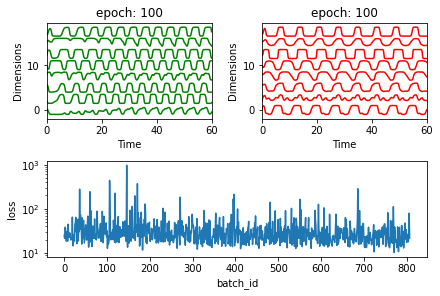

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.05153835  0.02333356 -0.07358857 -0.45026664 -0.40781269 -0.17041073
   0.09276033 -0.38471654]
 [-1.14686183  0.05480882  0.17572959  1.39193377  1.03002705  1.23286587
   0.57021048 -0.32210424]
 [ 0.53347016  0.01298357  0.5709664  -0.47897376 -0.36791886 -0.60492327
   0.25414465  0.05646541]
 [-0.2919922  -0.51488185 -1.34725552  0.10062775  0.97047611 -0.85202707
  -0.89562917 -1.42139705]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:08,  1.16s/it]

[[-1.03554945 -0.58964751 -2.24592538  0.43057342  1.33189383 -0.78945083
  -1.47750425 -2.61370201]
 [ 0.18386341  0.38748093  0.69210075  0.84553046  0.10759494  2.00480363
   1.1905436   0.59277788]
 [ 0.37044933  0.1611498  -0.1785726   0.58729386 -0.03505569  0.06289642
   0.04404238 -0.15745829]
 [-0.57844255 -0.16991853 -0.62581363  0.36520467  0.45909858 -0.51501671
  -0.49235582 -0.91392044]]


 25%|██▌       | 2/8 [00:02<00:06,  1.11s/it]

[[-0.59736032 -0.10142698 -0.55900909  0.40641366  0.75890171 -0.64654519
  -0.43995635 -0.82363459]
 [-0.65739548 -0.06114582 -0.78692435  0.80471287  1.09726882 -0.18288
  -0.60770443 -0.63109265]
 [ 1.14488814 -0.03269719  0.05772818 -1.0037627  -0.71766835 -1.28477544
  -0.23638717 -0.54124187]
 [ 1.36288113  0.06356461  0.97427157 -1.15453062 -1.13646837 -0.26656495
   0.66891612  0.32249721]]


 38%|███▊      | 3/8 [00:03<00:05,  1.06s/it]

[[ 0.89141023  1.20117441  2.48062872  0.91648696 -1.15821722  2.23082091
   2.2138893   2.61186844]
 [ 0.53432709  0.36201788  0.88729021  0.22224966 -0.90622139  0.05732191
   0.66821114  0.43044231]
 [-0.69886945  0.0851538  -0.53123377  1.30068718  1.33802768  0.62169439
  -0.03135177  0.12123709]
 [ 0.5365409   0.42009082  0.49842147  0.6338565  -0.35057914  0.20944943
   0.48144548  0.14628303]]


 50%|█████     | 4/8 [00:04<00:04,  1.04s/it]

[[ 0.39291703  0.33665163  0.22527402  0.01531655 -0.38470928 -0.48919125
  -0.00500154 -0.21910968]
 [-0.78832635 -0.6532118  -1.08381537  0.16615487  1.1926609  -0.10869692
  -0.43460304 -1.41910028]
 [-0.48581404 -0.13841298 -0.14451946  0.56514332  0.46861393  0.08114563
   0.07122275 -0.33901016]
 [-1.14790813 -0.15864736 -0.33143472  0.92940432  1.23756964  0.4622966
   0.06164795 -0.87200324]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.03s/it]

[[-1.64452608  0.02377417 -0.85338371  2.13884838  2.03217797  1.55028247
   0.00756107 -0.46130759]
 [ 0.8237253   0.74728512  0.89938632  0.09365892 -0.86659149  0.96405572
   0.92134301  0.68050845]
 [-1.39491798  0.2310204   0.13110661  2.44229386  1.43460552  2.69857111
   1.01000404  0.3437648 ]
 [ 2.02127397  0.65840242  0.79852376 -0.7230775  -1.90279068 -0.62156237
   0.34215755 -0.11297865]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.01s/it]

[[ 0.01744368  0.1542961   0.37606943  0.30926838  0.25727838 -0.63441907
   0.21378244  0.60446232]
 [-0.13720436 -0.16771398  0.05784338  0.20592054  0.39463681 -0.53905774
   0.06544626 -0.20187947]
 [ 0.78792186  0.37578091  0.40584942 -0.13625688 -0.3266183  -0.30105116
   0.23183424  0.26024298]
 [ 0.15955229  0.22999488 -0.65052645  0.35550273  0.23708218 -0.187894
  -0.47830984 -1.04226216]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.03s/it]

[[-1.51899026e+00 -5.89307764e-02 -1.00409998e+00  1.49158568e+00
   1.43563243e+00 -3.51009367e-01 -7.86790231e-01 -6.55422751e-01]
 [ 2.50864417e-01  2.62865671e-01 -1.10453691e-01  2.37053834e-01
   5.53885259e-02  6.85813768e-02 -1.70863403e-01 -1.01631362e-03]
 [ 4.66589446e-02 -2.20573622e-02 -1.81843970e-01 -2.88601355e-01
  -1.14888938e-02 -5.38206061e-01 -8.62967456e-02 -9.75708590e-01]
 [-3.93120113e-01  1.59291137e-01  9.57266919e-03  8.91296574e-01
   7.40049683e-01  8.10815478e-01  2.58980733e-01  3.12475950e-01]]


100%|██████████| 8/8 [00:02<00:00,  3.09it/s]


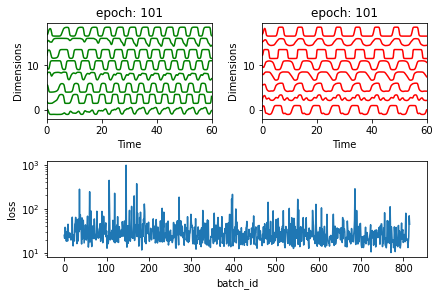

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.43674775  0.12192345  0.41652652 -1.0160974  -1.13679111 -1.54854718
   0.15314035 -0.36026107]
 [-0.42003912 -0.01794743  0.34241764  0.6741002   0.54325575  1.2145873
   0.87798796 -0.23610445]
 [ 0.90254562 -0.12273975  0.68380108 -0.36524796 -0.61760007 -0.94112378
   0.67986537 -0.04113062]
 [ 0.10690503  0.6156155   0.72841772  0.49395699 -0.56362929  0.48972145
   0.51758897  0.41083934]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.06it/s]

[[ 0.23190947  0.1767965   0.53868554  0.33785174  0.01122717  0.41358461
   0.86025544 -0.13318863]
 [ 0.61677223 -0.00916431  0.25937233 -0.6150997  -0.37041415 -1.11877644
   0.15365307 -0.5224933 ]
 [ 1.40775027  0.02654617 -0.20612419 -0.74098738 -0.7193699  -1.21242442
  -0.2919454  -1.04331154]
 [-1.32137275 -0.57806038 -0.9276272   0.94885966  1.3575303   0.19504548
  -0.1982439  -1.09068529]]


 25%|██▌       | 2/8 [00:02<00:05,  1.02it/s]

[[-2.08863787 -0.67152227 -1.52923084  1.46262956  2.64528817 -0.72533798
  -0.96586942 -1.05901437]
 [ 0.98569426  0.69749258  1.16546194 -0.08443801 -1.32672632  0.52459148
   0.91763497  0.6234508 ]
 [-0.30720103 -0.15137711 -0.3157991   0.1270878   0.33911127 -0.44573877
  -0.18251004 -0.23796692]
 [-0.22163498  0.89252583  0.47799569  1.31866473  0.01452295  0.98675681
   0.46658457  0.12555993]]


 38%|███▊      | 3/8 [00:02<00:04,  1.02it/s]

[[-1.15036879 -0.21892984 -1.09368638  0.77726072  1.45597687  0.49708327
  -0.7071039  -1.3445856 ]
 [ 0.0058915  -0.14864548 -0.46814436 -0.61568715  0.03666184 -1.22062678
  -0.48999182 -1.07555896]
 [ 0.32435477  0.67522383  0.4992285   0.74897597 -0.38077056  0.3850731
   0.31391293 -0.11182596]
 [-0.3550119   0.19153629 -0.14283171  0.71459849  0.31047357  0.72726159
   0.23029881 -0.40601019]]


 50%|█████     | 4/8 [00:04<00:04,  1.01s/it]

[[-0.61402735  0.07063271  0.52796967  1.29840962  0.66560648  1.40033872
   0.96250312  0.23955595]
 [ 0.359085    0.19824786  0.23141405 -0.24438204 -0.56718073  0.09213143
   0.3316439  -0.65457758]
 [ 0.55460235  0.2479849   0.61508331  0.41332954 -0.12357632  0.99402526
   0.79219036  0.87767143]
 [-0.35137308  0.1315953  -0.08505586  0.77865855  0.9059016  -0.0744188
  -0.18244065 -0.37703393]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.00s/it]

[[-0.44708186  0.2747714   0.1121468   0.71642291  0.41389152 -0.00988462
   0.06479309  0.35145749]
 [-0.966905    0.08273256 -0.09807725  1.34073894  0.89475602  1.10762255
   0.45858054 -0.06752046]
 [ 0.54554073 -0.68977145 -0.41956625 -0.82515545  0.08519279 -0.93342553
  -0.2381276  -0.70149845]
 [ 0.79353235  0.79678636  0.77462414  0.09880274 -0.61712437  0.1698126
   0.431566    0.55002596]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.02it/s]

[[-0.91515246 -0.22390441 -0.6340208   0.65360166  0.8941585  -0.56384773
  -0.3434454  -0.6838468 ]
 [-0.57201877 -0.17770636 -0.77145613  0.18217084  0.91149469 -0.73385034
  -0.68554527 -1.14548008]
 [ 0.32122496  0.55410043  1.00082509  1.15941194  0.00544903  1.95495317
   1.35958446  1.09638282]
 [-0.18344672  0.13046019  0.35081446  0.99418792  0.4897558   1.259481
   0.63460609  0.46343257]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[ 1.97822323  0.59569678  1.40284901 -0.6520493  -1.47559778 -1.03101264
   0.82390833  1.36054556]
 [-1.2550606  -1.07855714 -2.2998976   0.23149701  1.72743118 -2.158521
  -1.66420892 -3.32161205]
 [ 1.01587164  0.61377118  0.31464835  0.15145473 -0.4735234   0.28770179
   0.20088521 -0.02592187]
 [-0.86353112 -0.44155035 -0.77360494  0.66215178  1.25651055 -0.33599601
  -0.30052451 -0.92422222]]


100%|██████████| 8/8 [00:02<00:00,  3.11it/s]


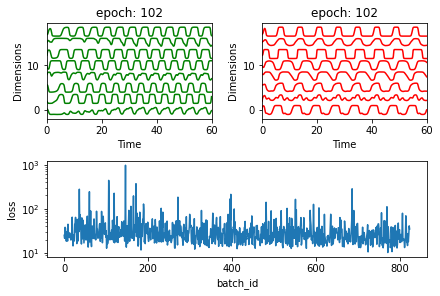

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.79287856  0.02859547 -0.84235676  1.22787568  1.03704473  0.54858596
  -0.30777996 -0.67455964]
 [-0.05847465 -0.24029501  0.08647318  0.24528584  0.42277874  0.01723401
   0.50671048 -0.5882881 ]
 [-0.3532005   0.54260806  0.75800624  1.41907371  0.47670496  1.02019971
   0.77888039  1.87206424]
 [ 0.44696614  0.02628863 -0.33422754 -0.54470752  0.08976245 -0.95434815
  -0.37756195 -1.01590639]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.11s/it]

[[-0.97905899 -0.49548364 -1.45720274  0.62086812  1.3889412  -0.89443001
  -0.92510301 -1.52462021]
 [ 0.30043353  0.00246229 -0.20886137 -0.40741463 -0.17921445 -0.79300062
  -0.25978947 -0.64656804]
 [ 0.77198073  0.66914656  1.12399442  0.56873218 -0.86425654  1.3640467
   1.19448299  0.77182836]
 [ 0.46164966  0.16090308 -0.39706536 -0.44879116 -0.08487242 -0.34968839
  -0.305086   -1.12459932]]


 25%|██▌       | 2/8 [00:02<00:06,  1.07s/it]

[[ 1.08960087  0.75603423  1.37731889  0.41217161 -0.76226079  0.82751882
   1.26018288  1.27943415]
 [ 0.37542496 -0.10212561 -0.18891081  0.23201165  0.03593657 -0.09913121
   0.10391449 -0.59421769]
 [-0.68614754 -0.51910366 -1.34056186 -0.14764272  0.82967176 -1.4618351
  -1.11512598 -2.00083252]
 [ 1.82039775  0.88683668  1.21535385 -0.22211254 -1.45111642  0.40958943
   0.89886532  0.83139757]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:03<00:05,  1.05s/it]

[[ 1.20934648  0.46681827  1.21867829 -0.32012355 -1.18295861 -0.08096243
   0.73232117  0.72655869]
 [-0.90179723 -0.74273042 -1.30434138  0.58273808  1.52161444 -0.86402628
  -0.55291236 -1.57778564]
 [-1.1073918  -0.17051819 -0.35424328  1.25034661  1.73149912  0.32546605
  -0.00698175  0.20003327]
 [ 0.16860973  0.48563498  0.20314001  0.5629394  -0.35784674  0.93665112
   0.54804348 -0.10079813]]


 50%|█████     | 4/8 [00:04<00:04,  1.05s/it]

[[-1.64812611  0.05230117 -1.14573008  1.46341907  1.66461739  0.70505841
  -0.62840788 -1.41011532]
 [-1.25795071  0.3838893   0.09913672  1.31623955  0.65039667  1.26369786
   0.58165101 -0.60048756]
 [ 1.53977818  0.06599445  0.19076679 -1.19321423 -0.93184842 -1.74752463
  -0.11267928 -0.35855295]
 [-0.43506413 -0.06208804 -1.02526683  0.90786564  1.17785403 -0.05538189
  -0.38274716 -1.18282893]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.02s/it]

[[-0.8250344  -0.4833934  -0.67281451  0.70822032  1.05458459  0.29206679
  -0.01008664 -0.89564553]
 [ 1.40146584  0.83872174  1.07055447 -0.32173769 -1.14672497 -0.29776994
   0.66628036  0.78407202]
 [-0.58991    -0.13210431 -0.06705382  0.53721066  0.66411662 -0.48383838
   0.13111171 -0.30983137]
 [-0.45210886 -0.27048589 -1.65198823  0.58350459  0.89262494 -1.12456722
  -1.19540043 -1.44929345]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.13s/it]

[[ 0.8347286   0.45708012  0.27131963  0.23393156 -0.33594193 -0.82983487
  -0.04806598  0.01194817]
 [ 0.25979683  0.76029275  0.79484857  0.83811908 -0.23139641  1.16065527
   0.86412098  0.22704959]
 [-0.56702717  0.07289934 -0.42859487  0.98239991  0.87588948  0.84754341
   0.04427459 -0.93357792]
 [-1.24906944  0.10439311  0.40164739  2.29966278  1.31298954  2.73818829
   1.33238039  1.05389743]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.13s/it]

[[ 1.12447362 -0.0714376   0.47427795 -0.68140488 -0.64777655 -0.68764366
   0.40156024  0.04770213]
 [ 0.45003918  0.10507486 -0.15304922 -0.43975552 -0.07494724 -1.23860919
  -0.40055912 -0.2644456 ]
 [ 0.25795248  0.04854281  0.1576729   0.59437884  0.1266214   0.9893821
   0.51218721 -0.00241744]
 [ 0.21796758 -0.14836557  0.36019084  0.31839165  0.11908539  0.01366392
   0.71630881  0.14875486]]


100%|██████████| 8/8 [00:02<00:00,  3.03it/s]


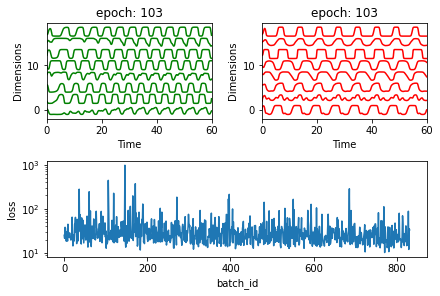

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.4581323  -0.06814318 -0.37500229  1.16015551  1.41950448  0.61759265
   0.12021428 -0.30551687]
 [ 1.10315529  0.01969322  0.01978471 -0.70388551 -0.38529752 -0.79597141
  -0.10129873 -0.86112626]
 [-0.16711756 -0.15859226 -0.4806646  -0.00152934  0.20191422 -0.64811018
  -0.27637372 -0.99303392]
 [ 0.49870229  0.35430247  0.33378854  0.27534148 -0.07307948  0.97355752
   0.68131915  0.13406816]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.03it/s]

[[-0.78445296 -0.15945526 -0.73380442  0.89241959  0.82294295  0.90071202
   0.04608105 -1.02251647]
 [-0.01466807  0.24573464  0.4699372   0.32636934  0.0810059   0.07261366
   0.48242149  0.41928678]
 [ 0.3120573   0.17453213  0.45968662 -0.21633215 -0.5438516   0.22062158
   0.75221033 -0.21969819]
 [ 0.4151093   0.90051299  1.38414849  1.22968322 -0.20179088  2.11803349
   1.55954932  1.45804368]]


 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[-0.76435622  0.10059891  0.06796009  1.21002749  0.96434233  1.02301999
   0.51080886  0.15162774]
 [-1.7972041  -0.77161042 -1.3416471   1.57106735  2.10380171 -0.12806917
  -0.36523691 -1.15166448]
 [-2.81081138 -0.47041155 -1.6917294   2.15248293  2.71067608  0.14395395
  -1.02239352 -1.33792995]
 [-2.03434772 -0.29706477 -0.94517773  1.80650469  1.96370395  0.27121197
  -0.34806356 -0.73248331]]


 38%|███▊      | 3/8 [00:02<00:04,  1.00it/s]

[[-1.1956429  -0.22577354 -0.58685276  1.46467073  1.62905957  0.48645762
   0.13850791 -0.5074303 ]
 [ 0.28028384  0.00882966 -0.49494576 -0.33391785 -0.39324351 -1.37069982
  -0.65811527 -1.13531222]
 [-0.78244593  0.04343937 -0.01417177  1.22658713  1.02597752  0.47698868
   0.31684455 -0.59890281]
 [-1.33924519 -0.16039831 -0.96418812  1.48063112  1.48981293  0.81387021
  -0.17106553 -1.12788063]]


 50%|█████     | 4/8 [00:03<00:03,  1.03it/s]

[[-1.33444776  0.01677992 -0.82044976  1.5815444   1.53150949  1.10304564
  -0.10412484 -0.77856306]
 [-0.27715484 -0.49167502 -0.49163964  0.42027243  0.92130607 -0.06118584
  -0.06639516 -0.273777  ]
 [-0.46469539 -0.11145334 -0.33903801  0.43207049  0.69978271  0.11001762
   0.01215828 -0.81569738]
 [ 0.38636816  0.82108217  1.10908877  1.22304478 -0.14227028  2.01253629
   1.32187382  0.9449301 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[ 0.22771636 -0.05809003  0.0383814  -0.03186375 -0.09294943 -0.51363104
   0.08640157 -1.02103991]
 [ 0.28694867 -0.0709107  -0.16980724  0.01845195  0.02007154  0.05555702
   0.14482027 -0.73726204]
 [ 0.10260985  0.2559495  -0.22590144  0.42704923  0.4373558   1.21286128
   0.28054596 -0.30247351]
 [ 0.42614195  0.35892386  0.46977198  0.41876095 -0.28635187  0.79512835
   0.52488009  0.16959109]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.05it/s]

[[-1.145171   -0.22120043 -0.74610025  0.84312747  1.19198201  0.48111651
  -0.10904084 -1.15804888]
 [ 0.85472163  0.27566424  0.53615739 -0.33833458 -0.5005258  -0.13347346
   0.51630656 -0.15733293]
 [ 0.0878388   0.41290577  0.11877202  0.39986155  0.0814636   0.62281346
   0.13072623  0.12609326]
 [-1.10762651 -0.06933324 -0.56666823  1.43203135  1.22861759  0.66411428
  -0.06625921 -0.45087616]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.02it/s]

[[-0.98712563  0.21350719 -0.06688499  1.63670075  1.31546005  1.65842705
   0.48464646  0.49507755]
 [-0.92507695 -0.28506707 -0.00198494  0.52161117  1.22247397 -0.16776268
   0.2601059  -0.57553171]
 [-0.46314385 -0.46063454 -1.01452319  0.37849603  0.78877971 -0.76089746
  -0.47490736 -1.21987885]
 [ 1.68471668  0.89180408  0.34066904 -0.90185804 -1.38315965 -0.91616876
  -0.31559197 -0.06585011]]


100%|██████████| 8/8 [00:03<00:00,  2.57it/s]


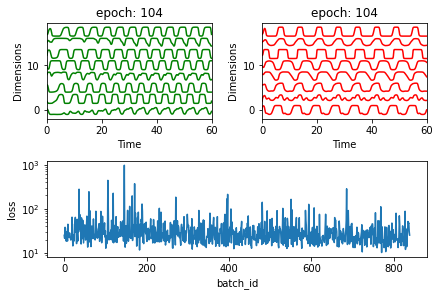

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.03893676  0.46313877  0.14500214  0.7053771  -0.28134294 -0.15739009
  -0.09693107  0.2981789 ]
 [ 0.22927719  0.42288297  0.34472338  0.61186175 -0.17946167  0.84345066
   0.5632431  -0.12713874]
 [ 0.20574217  0.02727205 -0.36533368 -0.23657072  0.04528281 -1.23553343
  -0.35461807 -0.88321903]
 [ 0.55383454  0.07799324  0.33458626  0.20880997 -0.2401988  -0.27831467
   0.50554513  0.02301634]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.08s/it]

[[-0.018089   -0.374335   -0.43766883 -0.08946608  0.56075012 -1.25281351
  -0.46993238 -0.56924871]
 [-1.74959609 -0.27947925 -0.53573008  1.60291896  1.59247417  0.28244365
   0.03261935 -1.09130791]
 [ 0.59960088  0.01910254 -0.72767911 -0.35934567 -0.13523153 -1.49147784
  -0.68827954 -1.12001839]
 [ 0.29801436  0.56882261  0.72033906  0.81192851 -0.17628683  1.02521581
   0.6629721   1.19096483]]


 25%|██▌       | 2/8 [00:02<00:06,  1.09s/it]

[[ 5.92699673e-02 -7.11228075e-02  1.65192307e-01 -5.93603386e-04
   9.52944486e-02  1.52359278e+00  7.15878888e-01 -5.89016462e-01]
 [ 1.35973787e+00  1.27793463e+00  1.62334265e+00  5.46171434e-01
  -1.51764110e+00  1.90755130e+00  1.29072148e+00  1.61615928e+00]
 [ 6.22119651e-01  3.42588033e-01  1.03613380e-01  2.80387306e-01
  -3.48165891e-01  8.35080109e-01  5.12922989e-01 -2.89693238e-01]
 [-1.21903720e+00 -4.21165849e-01 -1.03246646e+00  1.29274367e+00
   1.55285637e+00  4.34057432e-01 -2.77858026e-01 -1.13638323e+00]]


 38%|███▊      | 3/8 [00:03<00:05,  1.11s/it]

[[ 0.42911795  0.16161196  0.11611816 -0.2611174  -0.32146441 -0.80754521
  -0.03624149 -0.45294885]
 [-1.03950146 -0.10638047 -0.6570805   1.32408871  1.22033619 -0.36876711
  -0.34827767 -0.53000137]
 [-0.62709585 -0.03377689 -0.2302936   0.45677062  0.61292039  0.00972638
  -0.18577266 -0.62367679]
 [ 0.72417238 -0.1039495   0.11930012 -1.03244469 -0.63180407 -0.86444737
   0.11927664 -0.50647876]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 50%|█████     | 4/8 [00:04<00:04,  1.07s/it]

[[-0.47267942  0.42429536 -0.23673876  1.11172797  0.51578562  1.00517505
   0.06111527 -0.85398323]
 [ 0.08279143  0.88866419  0.28654019  1.09501298  0.08455757  0.78174572
   0.25143236  0.69536502]
 [-1.59248882 -0.55053983 -1.67796828  0.55204836  1.59342835 -1.94348656
  -1.5764617  -2.17288556]
 [-0.74437402 -0.1369346  -0.24184183  0.68208832  0.99629817  0.73607273
   0.25391163  0.02723271]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.08s/it]

[[ 0.08742678  0.2530503   0.7777935   0.72516384 -0.20800833  0.55183769
   0.90766826  0.29426134]
 [ 0.06538044  0.1927282  -0.03954943  0.19053868  0.32731935 -0.39790682
  -0.07763549 -0.07671814]
 [ 0.01560315  0.0451698  -1.01793212  0.62543017  0.66311592  0.59253733
  -0.36179932 -0.64121495]
 [ 0.51850317  0.38357828  0.7766988   0.67751557 -0.4605455   1.60879757
   1.11114344  0.51045957]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.04s/it]

[[-0.32236365  0.11834257 -0.2439104   0.73766809  0.4565691   0.53886906
  -0.08273963  0.01276994]
 [-1.12423367  0.02700504 -0.8697051   1.38543261  1.37183942  0.42298364
  -0.15207975 -1.10976664]
 [ 0.40404188  0.62511062  0.51320823  0.94052245  0.0851146   0.4428163
   0.41178259  0.7521993 ]
 [ 0.65120671  0.21287996  0.38401632  0.20593785 -0.04267087  0.27799953
   0.49515766  0.24031438]]


 88%|████████▊ | 7/8 [00:07<00:00,  1.00it/s]

[[-1.75635147 -0.25988659 -0.43636429  1.26866087  1.45723846  0.07622154
  -0.13941715  0.02218695]
 [ 0.24124497  0.15657478 -0.12431812 -0.27999075 -0.13361805 -0.82143771
  -0.32368432 -0.93989103]
 [ 0.50163253  0.3250611   0.12732766  0.12206585 -0.33769314 -0.53373767
   0.00579427 -0.54750892]
 [-0.74302963 -0.43265225 -0.9562846   0.38536552  0.7237223  -0.4995974
  -0.55996021 -1.3401096 ]]


100%|██████████| 8/8 [00:02<00:00,  3.15it/s]


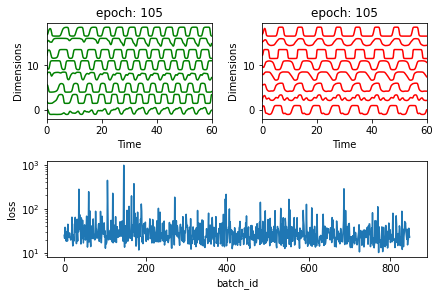

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.25461425  0.49705248  0.62796109 -0.78798576 -1.06314266 -0.34227974
   0.39974631 -0.41827015]
 [-0.74703462  0.02417401 -0.20260697  1.18959834  0.74977646 -0.05048497
  -0.19182769 -0.08414564]
 [-0.32419007  0.20112573  0.40004558  1.04865735  0.39544761  1.130734
   0.71046166  0.16593593]
 [-1.2093136  -0.02780291 -0.53289704  1.23971882  1.11275779  0.3438191
  -0.23179779 -0.43566684]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.01it/s]

[[ 0.75910997  0.83473961  1.14680215  0.84095881 -0.57243678  2.21725433
   1.31159811  1.17150124]
 [-0.00770028  0.47805856  0.11758753  0.56485701  0.0811265   0.24515223
   0.15349801 -0.12309642]
 [ 0.46671198  0.16540635  0.09236739 -0.08602639 -0.0270793  -0.55228595
   0.04944106 -0.70292182]
 [ 0.43479208  0.88030882  0.59483998  1.06012913 -0.16042249  0.95417516
   0.53811946  0.191253  ]]


 25%|██▌       | 2/8 [00:02<00:06,  1.09s/it]

[[-0.46117374 -0.18398697 -0.21774648  0.7997195   0.95419929  0.56140225
   0.34547057 -0.14626015]
 [-1.15113851 -0.01618268 -0.49162924  1.17210386  1.18535893  0.41937781
  -0.05317078 -0.82134281]
 [-1.75765235 -0.3528789  -1.87162068  0.9668248   1.97455574 -0.54535663
  -1.32368052 -1.59800527]
 [-0.64096844  0.22179182 -0.41770668  1.02487291  0.83565498  0.66079709
   0.00244842 -0.50343297]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:03<00:05,  1.12s/it]

[[-0.0901092   0.098162    0.25530665  0.53484797  0.3057071   0.31636879
   0.46602609 -0.05730446]
 [-0.33494705 -0.37547407 -0.82505972 -0.44182364  0.25634379 -0.92893852
  -0.51592861 -1.60627845]
 [ 0.26871359  0.05354252  0.15773716  0.18271146  0.01139533 -0.45021849
   0.09834744  0.00631614]
 [ 0.44044075  0.07657744  0.7469768  -0.05819006 -0.48195384  0.59456688
   0.99921464  0.07243452]]


 50%|█████     | 4/8 [00:04<00:04,  1.14s/it]

[[-0.45828555  0.61853832  0.29084893  1.47439405  0.21477836  0.8841373
   0.44796694  0.43517447]
 [-1.84352548 -0.24161547 -0.9629778   1.20872716  1.84368624 -0.24930895
  -0.50732616 -1.25140111]
 [ 1.35433578  0.30733     0.36026597 -0.56107625 -0.68557489 -0.67657365
   0.24275783 -0.33827645]
 [ 0.09072574  0.34234727  0.03812069  0.70296703  0.21124975 -0.18101099
   0.10630079 -0.07676844]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.15s/it]

[[-0.47841219 -0.23096525 -0.32809223  0.76315601  0.79156132  0.20743403
   0.28659176 -0.52262502]
 [-1.68306612 -0.26911526 -0.95803485  0.98216781  1.43362193  0.83515208
  -0.36022484 -1.67870237]
 [-0.77159457 -0.05408704 -0.34137307  1.05704506  1.14052772  0.41517764
   0.29351947 -0.26487039]
 [ 1.15882348  0.83306421  0.98474349 -0.29803677 -1.40510138  0.09957074
   0.52292487  0.13599709]]


 75%|███████▌  | 6/8 [00:07<00:02,  1.15s/it]

[[-0.22870398 -0.3503822  -1.01718481 -0.16331353  0.42400199 -1.74511714
  -0.80435292 -1.47164076]
 [-0.8518767   0.33709071  0.83340862  1.82442782  0.67343637  1.64708026
   1.31406689  0.93202967]
 [ 1.43678865  0.49921947  0.9718717  -0.41106965 -1.45991351  0.58483425
   0.76967262  0.49482845]
 [-1.8074561  -0.20028235 -1.68813431  1.55248469  2.1096824   0.0905944
  -1.02407393 -1.51535719]]


 88%|████████▊ | 7/8 [00:08<00:01,  1.14s/it]

[[-1.34932209 -0.32167737 -0.83193238  0.98428001  1.34318775 -0.10151236
  -0.35679332 -1.07808095]
 [-0.5150193   0.41732547  0.37318365  0.93264486  0.36735209  1.28363558
   0.75195338  0.32727062]
 [-0.69927897 -0.13213056 -0.31168395  0.32646429  0.75412507 -0.59451922
  -0.15831299 -0.69408858]
 [-0.93819968  0.31690005  0.29790113  1.92754451  1.15147241  1.89216367
   0.85831572  0.4694057 ]]


100%|██████████| 8/8 [00:02<00:00,  3.07it/s]


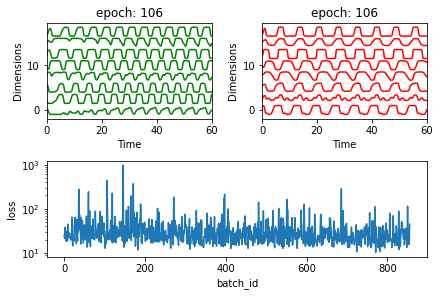

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.10130247  0.22889375  0.0396734  -0.43367731 -0.26766777 -0.77457728
  -0.30224462 -0.64488482]
 [-0.8919774  -0.14286626 -0.1459055   0.97118469  0.95851467  0.18323675
   0.07568185 -0.63719969]
 [-0.11099925  0.60567117  0.17292998  0.77321584  0.12475961  0.89030859
   0.1394383   0.73897058]
 [-0.88831623 -0.28512336 -0.88290924  0.89270694  1.37716498 -0.11821332
  -0.35156046 -1.25018555]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.03it/s]

[[-0.82764457 -0.02796809 -0.65576051  0.79437592  0.84210523  0.10237923
  -0.32447006 -1.1424018 ]
 [ 0.0546088   0.18060651  0.09663201  0.22878714  0.12017255 -0.37253049
   0.10070533 -0.13918477]
 [-1.91878983  0.71137251  0.19552621  2.83516729  1.57433596  2.33583585
   0.82726325  0.42856562]
 [-0.59030415 -0.22393912 -0.83989288  0.1777624   0.75335362 -1.20330165
  -0.60463126 -1.48231922]]


 25%|██▌       | 2/8 [00:01<00:05,  1.04it/s]

[[-0.46689046 -0.0894298   0.15300103  0.77120697  0.93243739  0.78567475
   0.56168326  0.35268531]
 [-0.34301758  0.41342949 -0.16798851  0.7789626   0.49561918  0.7929224
   0.074716   -0.17030689]
 [-0.73515391  0.05601935 -0.05145763  1.16638296  0.81604826  1.50319885
   0.68031055 -0.1533905 ]
 [ 0.51907813  0.19749142  0.41181769  0.27088875 -0.03186159  0.48605254
   0.56293138  0.42084762]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[ 1.44660797  1.15232168  1.25234808 -0.50270032 -1.53292224  0.26309935
   0.65020626  0.4255048 ]
 [ 0.38998804 -0.52789293 -0.36825627 -0.69348924 -0.12482767 -0.53096941
   0.04500903 -0.75238192]
 [ 1.21564983  0.24398075  0.53919474 -0.5179322  -0.62895653 -0.33419942
   0.41734652  0.48350101]
 [ 0.5949206   0.25401158  0.38854264 -0.40113718 -0.60496516 -0.92302527
   0.04515883 -0.26350942]]


 50%|█████     | 4/8 [00:03<00:03,  1.01it/s]

[[ 0.05866448  0.00454683 -0.43508423  0.15123964 -0.10345245  0.59901326
  -0.02422123 -1.03897309]
 [ 1.06064976  0.11614155  0.29341178 -0.39652998 -0.5620198  -0.99885077
   0.18979733 -0.29515952]
 [ 0.6052589   0.35528475  0.27515353  0.10481551 -0.26475552  0.30142612
   0.21229484 -0.19927859]
 [-0.86491444 -0.34150403 -1.07730885  0.07908544  1.00953464 -0.63763882
  -0.82154582 -1.58654   ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.03it/s]

[[ 2.55276878  0.6028339   1.0157104  -1.61705992 -2.17861339 -1.46351543
   0.12118617  0.32829118]
 [-1.09440616 -0.2393363  -1.08316083  0.29812178  1.17706901 -0.67909955
  -0.8572     -1.29253971]
 [-1.61722919 -0.10200631 -0.5629503   1.9985549   1.55858007  1.14937851
   0.21040905 -0.31181111]
 [ 0.13045845 -0.11371664  0.12791692  0.14679829  0.24020642  0.35786816
   0.47115513 -0.0739165 ]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.00it/s]

[[-0.05656227  0.03868247 -0.3626379   0.31845789  0.27586358  0.06299662
  -0.28295091 -0.62591646]
 [ 0.5620936   0.13254983  0.20097222 -0.30470008 -0.40870823  0.27732285
   0.400151   -0.4628675 ]
 [-0.56972236 -0.01585838 -0.81174585  0.43851466  0.59597175 -0.21767607
  -0.55876166 -1.32314285]
 [-0.74113801  0.08758095 -0.13235218  0.78227019  0.84470795  0.49464161
   0.20492145 -0.73154053]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.00it/s]

[[ 1.12587302  0.81813482  1.47199396  0.37320631 -1.41623848  1.23833507
   1.41369716  1.21276487]
 [ 1.72158019  1.01476338  1.60897354 -0.33362612 -1.61409168 -0.09961381
   0.96473147  1.46809509]
 [-1.37798663  0.05759736 -0.63889476  1.68775312  1.32709672  0.66798786
  -0.21867746 -0.56205679]
 [-0.89765624 -0.22324432  0.0585233   0.86587615  1.29681256  0.54587062
   0.55069923  0.26472852]]


100%|██████████| 8/8 [00:02<00:00,  3.01it/s]


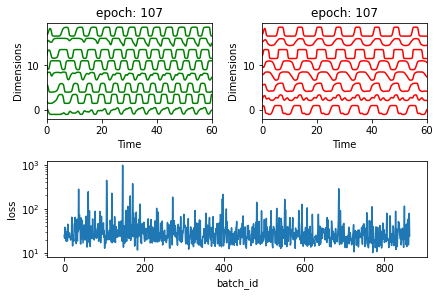

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.87705147 -0.9180471  -2.08856577  0.53940274  2.09713629 -1.50145153
  -1.47368687 -1.80945726]
 [-0.18689341 -0.15483976 -1.62502617  0.19362493  0.42800568 -0.7168317
  -1.24846094 -1.85853991]
 [-0.37721622  0.38609448  0.23784328  1.41659692  0.51315155  1.36089401
   0.6577752   0.95748977]
 [ 0.70572555  0.29353729  0.57571742 -0.32734822 -0.67434883 -0.18955019
   0.40760089  0.18809147]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.12s/it]

[[-0.14695972  0.9755932   1.16280637  1.6479418   0.1027269   1.7324047
   1.05818372  1.64965555]
 [ 0.68921372 -0.10368041 -0.11722208 -0.79662421 -0.43864058 -1.49801741
  -0.06983586 -1.46600109]
 [-0.94980502 -0.40362642 -0.80639879  0.76906726  1.09589312 -0.20456881
  -0.34338143 -1.09983235]
 [-0.84806573 -0.06503567 -1.66164588  0.3814038   0.92169569 -1.39571925
  -1.4881175  -1.90765457]]


 25%|██▌       | 2/8 [00:02<00:06,  1.07s/it]

[[ 0.47850199  0.50476829  0.36127082  0.14777251 -0.18340856  0.4912435
   0.43720041  0.31400794]
 [-0.86727688 -0.2192637  -1.14216436  0.78853218  0.97623177 -0.20936145
  -0.70788306 -1.52246519]
 [-0.72575616  0.23015494 -0.46298512  1.30975461  0.80261955  0.32922025
  -0.17091334 -0.10948755]
 [-0.37335842  0.41644329  0.70037948  1.57217499  0.60759391  1.45006781
   0.95568459  0.81198113]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:03<00:05,  1.04s/it]

[[ 0.70841232  0.31090975  0.66620369  0.22134771 -0.44185397  0.25815811
   0.58101906  0.24966089]
 [ 0.16244948 -0.33562756 -0.48405042 -0.10139102  0.64773404 -0.25748181
  -0.15689028 -0.50536399]
 [-0.3652601  -0.2420011  -1.7761659  -0.15324828  0.50229557 -1.61704411
  -1.55982843 -2.15728094]
 [-0.88742846  0.55662538  0.42586371  1.55583111  0.7398122   1.0883092
   0.67714596  0.68712313]]


 50%|█████     | 4/8 [00:03<00:04,  1.01s/it]

[[ 0.19981938 -0.01914577  0.13119951  0.28837133  0.0585606  -0.19730997
   0.22652243 -0.23959024]
 [-0.04081848  0.15221319 -0.36283143  0.41152494  0.51784368 -0.69939364
  -0.42106313 -0.50714956]
 [ 1.06084402  0.16318541  1.65638151 -0.03764813 -0.8018186   0.25364404
   1.53968881  0.8627857 ]
 [-0.32424196 -0.1088183  -0.5992597   0.47153958  0.54414204 -0.1566145
  -0.30663004 -0.9219407 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.01it/s]

[[-4.35579350e-01 -2.54349568e-01 -1.45218998e+00  2.92447023e-01
   8.42974638e-01 -1.08296810e+00 -1.24478546e+00 -1.87614641e+00]
 [-2.97652260e+00 -5.97084668e-01 -1.55118269e+00  1.98644469e+00
   2.62496929e+00  9.66775803e-01 -5.71366861e-01 -1.36239734e+00]
 [ 2.03481017e-01  1.23461649e-01 -6.74778286e-01  5.93280186e-05
   1.41173372e-01 -8.57771585e-01 -5.82722141e-01 -5.04005477e-01]
 [-2.20929071e-01 -1.37119541e-01 -7.88060297e-01 -3.40951246e-01
   3.22293597e-01 -1.14188324e+00 -7.42139189e-01 -1.47293602e+00]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.01it/s]

[[ 1.62978811  0.36928867  1.01965643 -0.7527837  -1.39392797 -0.65502767
   0.62478199  0.53016122]
 [ 0.7918477   0.73867994  0.72827209  0.32765698 -0.62346641  1.03718123
   0.84576606  0.09043037]
 [-1.10065643 -0.42206474 -0.87358238  0.69412913  1.52739442 -0.99850482
  -0.47246989 -0.98688544]
 [ 0.81259473  0.50240619  0.57997769 -0.09027202 -0.6528768  -0.30608408
   0.2548888   0.17858319]]


 88%|████████▊ | 7/8 [00:06<00:01,  1.02s/it]

[[ 0.28506353  0.79634822  0.71194407  0.77167412 -0.39033842  2.01885942
   0.7736396   0.39631323]
 [-0.82633328 -0.11064656 -0.85039142  1.05510264  1.12522861  0.72769917
  -0.144239   -1.07012364]
 [ 0.7903293  -0.3707087  -0.29862214 -1.20737574 -0.50672126 -2.27471499
  -0.57739021 -1.23486702]
 [ 0.21765594 -0.1134155   0.07685708  0.56001608  0.04083057  0.24595427
   0.66638336 -0.47332062]]


100%|██████████| 8/8 [00:02<00:00,  3.05it/s]


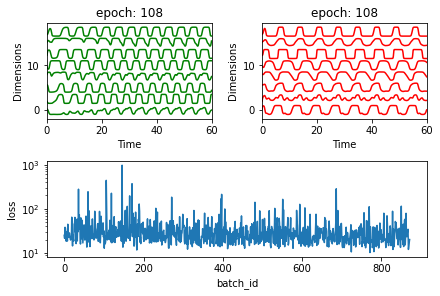

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.88771404 -0.47395662 -1.05700458  0.09254461  0.88496657 -1.33888325
  -0.92659685 -1.44233532]
 [ 0.68231533  0.75325013  1.16132517  0.28020358 -0.87907137  0.53451998
   0.92141224  0.6039674 ]
 [ 0.29267968 -0.12866696 -0.87082931 -0.13506481  0.46955641 -0.16695691
  -0.49325477 -1.40776602]
 [-0.9811146  -0.14186779 -0.64895837  1.37226425  1.38516654  0.5967575
   0.14643158 -0.19349209]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.03it/s]

[[ 0.44623496  0.31901243  0.19704725 -0.08600463 -0.45783139 -0.3822876
   0.07469081 -0.85068526]
 [ 0.00345204  0.16617675 -0.10486519  0.87951786  0.53021074  0.332343
   0.14843875 -0.13651876]
 [ 0.65946317 -0.22960996 -0.45320762 -0.47257492 -0.01154955 -1.0990166
  -0.35918581 -1.09777329]
 [-0.4490199   0.28113672  0.07355559  0.72112317  0.44421017  0.39357312
   0.13688745 -0.27599401]]


 25%|██▌       | 2/8 [00:01<00:05,  1.04it/s]

[[-0.48518261  0.073755   -0.43791736  0.35886775  0.31242168 -0.3497846
  -0.28613271 -0.63174724]
 [-0.07710661 -0.16167851 -0.35740698  0.20839296  0.27068034 -0.64213665
  -0.31934182 -0.46758089]
 [-1.05448682 -0.60147104 -1.06651777  0.56032011  1.68961534  0.28789545
  -0.32184616 -1.22525039]
 [ 1.26856431  0.69552807  1.09312179 -0.24431505 -1.4645584  -0.57360989
   0.46910049  0.70584514]]


 38%|███▊      | 3/8 [00:02<00:04,  1.05it/s]

[[ 1.07527547 -0.01325989 -0.50146145 -0.96372003 -0.72766276 -1.91948115
  -0.76669287 -1.35701307]
 [-1.05304612 -0.15312045 -1.26602381  1.09446195  1.28231029 -0.31738839
  -0.67599613 -1.80248421]
 [ 0.43703193  0.06865853 -0.3433709  -0.21679823 -0.15536884 -0.49076046
  -0.24308823 -1.17855048]
 [ 2.04912462  0.90139297  1.90329167 -0.75258384 -2.35982119  0.0607547
   1.08712896  1.29720807]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 1.07816624  0.2958092   0.32061045 -0.70237966 -0.96181739 -0.82170221
  -0.076513   -0.41012868]
 [ 0.13124803  0.18780464  0.24552556  0.93918602  0.25561296  0.04237298
   0.44829565  0.53235844]
 [ 0.89605114 -0.11908571 -0.46846276 -0.78856745 -0.37032397 -1.08003869
  -0.28853867 -1.32775426]
 [ 0.4942815  -0.05511965 -0.31241436 -0.53917762 -0.33109042 -0.45246207
  -0.16602362 -1.37739425]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[ 0.50937438  0.51460148  0.51619893  0.70904819 -0.20593092  1.14848966
   0.74860031  0.53681482]
 [ 0.87796018  0.04578466  0.08585696 -0.50156209 -0.11030473  0.06267411
   0.36512762 -0.36962367]
 [-2.17484756  0.20845077 -0.57541861  2.11003132  1.76491053  1.25729369
  -0.04568634 -0.28259453]
 [-1.05365977  0.06231534 -0.53487201  1.87029798  1.51301847  1.99781914
   0.40724337 -0.10125715]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[-0.53231845 -0.27661127 -0.56515503  0.21219545  0.99781992 -0.31885535
  -0.28115163 -0.58746958]
 [ 0.09229166 -0.11122476 -0.42076681 -0.14555757  0.15789862 -1.44888132
  -0.48607284 -0.95317364]
 [-0.25615325  0.27158466 -0.08734322  0.86456459  0.53853196  0.86849643
   0.34792387  0.20042703]
 [-0.22174098 -0.74508872 -0.82876775 -0.46291989  0.5725364   0.0727369
  -0.19418317 -1.14610515]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.04it/s]

[[ 1.49538298  0.97235656  1.18887575  0.32513124 -1.12827651  1.97657267
   1.11260955  0.93350932]
 [-0.39045666  0.06475239 -0.6587832   0.64642142  0.63642372  0.09603575
  -0.553061   -0.90410082]
 [ 1.12388012  0.04972732  0.28109568 -0.935892   -0.64794845 -1.47719442
  -0.08760631 -0.32616399]
 [ 0.05109319  0.20050337  0.80626197  0.97079567  0.1028516   0.31554546
   0.74853544  0.95430149]]


100%|██████████| 8/8 [00:02<00:00,  2.97it/s]


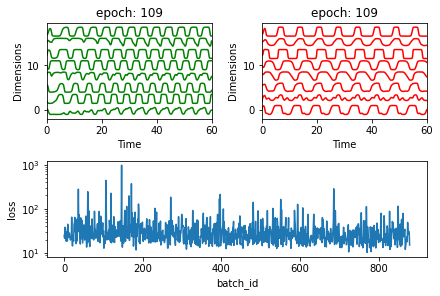

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-2.61781284e-01 -5.05187535e-01 -4.78899708e-01 -4.96273810e-01
   1.31874378e-01 -1.79389529e+00 -4.06600152e-01 -1.25187711e+00]
 [-4.39478841e-01  6.09740113e-03 -1.33356446e-01  4.76334902e-01
   4.48953082e-01 -3.54645407e-01 -3.93267865e-02 -3.30553736e-01]
 [-1.56547024e+00 -1.04964682e+00 -2.08257045e+00  2.66387160e-01
   1.80702416e+00 -1.59269864e+00 -1.55798738e+00 -2.52984574e+00]
 [ 3.72608014e-01 -1.80976066e-03 -1.97930057e-01 -4.03462532e-01
  -1.99025347e-01 -1.24975532e+00 -1.70584747e-01 -1.02228664e+00]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.11s/it]

[[-0.81318255  0.10025599 -0.75278104  0.87350661  1.00516775  0.29388436
  -0.31640924 -0.76765308]
 [-0.11024933 -0.00581068 -0.08785395  0.68395786  0.52818548  0.10155532
   0.22851236 -0.13835052]
 [ 0.31691368 -0.15180305 -0.70697075 -0.37979455 -0.16866682 -0.53153284
  -0.6013819  -0.9497367 ]
 [-1.43591475 -0.3838522  -1.01045005  0.59630939  1.35032482 -1.00351501
  -0.56000071 -1.83157384]]


 25%|██▌       | 2/8 [00:02<00:06,  1.06s/it]

[[-0.26794021 -0.23626439 -1.09525634  0.61152117  0.78696442 -0.09060193
  -0.66438968 -0.87738854]
 [ 0.74388983  0.4844857   0.39827089  0.13422327 -0.78463059 -1.08847988
  -0.04337759 -0.09236892]
 [ 1.05867074  0.15747139  0.39170766 -0.44517003 -0.56589361 -0.49725775
   0.26755662  0.02924675]
 [-1.42472379 -0.12016093 -0.96041618  1.72099594  1.60491104  0.95814836
  -0.08773361 -0.50141212]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 38%|███▊      | 3/8 [00:02<00:05,  1.02s/it]

[[ 1.13396532e+00  8.36827863e-03  4.02443047e-04 -1.02182408e+00
  -9.32209779e-01 -9.53683044e-01 -9.24857331e-03 -1.07891421e+00]
 [-8.58204040e-01  1.18928007e-02 -7.28463679e-01  1.31680655e+00
   1.25089659e+00  7.70840345e-01 -1.77199886e-01 -5.06850542e-01]
 [-8.47989397e-01 -1.31939462e-01 -6.63214672e-01  5.39885338e-01
   7.53338888e-01 -3.84902344e-01 -3.89913909e-01 -1.05346569e+00]
 [-2.88752254e-01 -6.67772624e-01 -1.02828058e-01  3.51600167e-01
   7.80875089e-01 -4.61729298e-01  4.29229314e-01  8.35354940e-02]]


 50%|█████     | 4/8 [00:03<00:04,  1.00s/it]

[[-0.23968142  0.36513582 -0.08637686  1.05047736  0.49919847  0.40129586
  -0.00469835  0.3858659 ]
 [-0.47605318 -0.30919732 -0.71543892  0.00331746  0.32837067 -2.01267839
  -0.78238363 -1.63081732]
 [-0.75240388 -0.03913345 -0.9007513   0.61388069  0.90643247 -0.50709448
  -0.73701718 -0.90127304]
 [-0.38954285 -0.14435713 -0.23838668  0.72103535  0.45499126 -0.76415256
  -0.16071208 -0.39199043]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.02it/s]

[[-0.83409317 -0.61086795 -1.32238545  0.50016915  1.21777827 -0.32800463
  -0.68397896 -1.04884599]
 [-0.18505501 -0.08748764  0.09349053 -0.61877971 -0.21806013 -1.55194298
  -0.06038829 -1.00040639]
 [ 0.75441136 -0.02604817 -0.45266659 -0.51571377 -0.277973   -0.97681449
  -0.37517405 -1.01416284]
 [ 0.06357268  0.37240742  0.06925531  0.14590829 -0.10902074 -0.09877838
  -0.0501616   0.26872707]]


 75%|███████▌  | 6/8 [00:05<00:02,  1.00s/it]

[[ 0.11524852  0.29931649  0.74686818  0.79904265  0.29019577  1.14845625
   1.0498317   0.89684148]
 [ 0.26731634 -0.12653075 -0.17843209 -0.08204609  0.16532398  0.23212658
   0.26939494 -0.77286528]
 [-0.42658308 -0.36566236 -1.82842503 -0.23832361  0.80439918 -1.01090605
  -1.4774884  -2.48662034]
 [-0.04087722  0.20429045  0.05690583  0.07695807 -0.03746625 -0.79076067
  -0.26572799 -0.28339627]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.01it/s]

[[ 0.76961915  0.03513519 -0.11977201 -0.97978151 -0.49198357 -1.95490162
  -0.33722921 -1.12839584]
 [-0.8668257  -0.37896885 -1.544862    0.22732909  1.2433093  -0.46003837
  -1.11244172 -1.63989405]
 [-1.21602125 -0.54762649 -1.68614778  0.86418509  1.54829185 -0.65121702
  -0.96270398 -1.67144632]
 [ 0.41281171 -0.07034782  0.20009738 -0.03759246 -0.06279438  0.1280704
   0.46462035  0.06358101]]


100%|██████████| 8/8 [00:03<00:00,  2.54it/s]


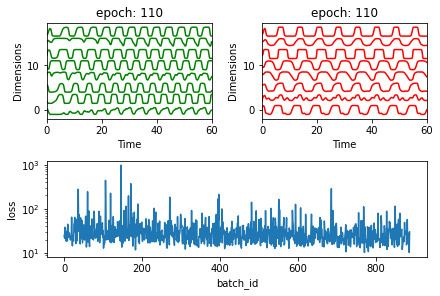

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.89218496 -0.335421   -0.97240234  0.71287347  0.92971172 -0.59879138
  -0.50044982 -1.56922474]
 [-0.23675488  0.01201352 -0.18578684  0.28833044  0.31846097 -0.18692417
  -0.06376074 -0.63296139]
 [-0.99252519 -0.55990077 -0.45482482  0.74465518  1.07318705 -0.33904512
  -0.09719318 -1.09466416]
 [-0.78699511  0.41180575 -0.43682141  1.4401714   1.0521323   0.88408444
  -0.1543703  -0.00665671]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.05it/s]

[[-0.01940902 -0.00993291  0.2966988   0.1244405  -0.02446239 -0.05551668
   0.34028179 -0.30662786]
 [ 0.89547017  0.67238699  0.77754125  0.83624026 -0.63184212  1.18546102
   0.88996763  0.33219821]
 [-0.09337043 -0.31296193 -1.33973481 -0.12869767  0.7125209  -2.49435924
  -1.31050124 -1.82318409]
 [ 0.26111059  0.19619895  0.6635603  -0.32317625 -0.24181309 -0.85003537
   0.41631587 -0.0522114 ]]


 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[ 0.42222331  0.61888816  0.69610313  0.47205928 -0.64269997  0.6353257
   0.73646046 -0.00991083]
 [-0.64975598 -0.0970807  -1.04027978  0.69571739  1.17870962 -0.42390355
  -0.67704707 -0.99518454]
 [ 0.45484477 -0.09559881  0.53999612 -0.49991812 -0.42221982 -0.51288627
   0.4403802  -0.14417831]
 [ 1.01477287  0.15631131 -0.04571708 -0.87355668 -0.87686473 -1.5586991
  -0.36697867 -0.87490433]]


 38%|███▊      | 3/8 [00:03<00:04,  1.00it/s]

[[ 0.63455343  0.35015683  0.96447844 -0.03529911 -0.39198396  0.26266334
   0.84170903  0.2985358 ]
 [-0.27247206 -0.00932098 -0.15950755  0.19529871  0.15514307  0.48639865
   0.07167544 -0.77607581]
 [-1.68552622 -0.20655499 -0.11713172  1.6842521   1.71330708  0.48829127
   0.11968976  0.36044986]
 [ 1.02764095  0.47281965  0.72916028 -0.21852569 -1.22323244  0.03020135
   0.42232862  0.38566259]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 50%|█████     | 4/8 [00:03<00:03,  1.01it/s]

[[-1.00473949 -0.39393487 -0.63412953  1.06455021  1.23957873  0.41866408
   0.0087169  -0.54100563]
 [-1.43538782  0.43365682 -0.13585718  2.55381794  1.55493329  2.50359545
   0.80110211  0.41972804]
 [-1.3308826  -0.36527499 -1.06641426  1.32213735  1.73824967  0.36578157
  -0.26000384 -1.01527264]
 [ 0.36963235  0.30022668 -0.13124638 -0.07231822 -0.29695269 -0.56576033
  -0.24658534 -1.01912713]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.01it/s]

[[-0.21748916 -0.36945589 -1.18576869 -0.39859477  0.3603331  -1.42397365
  -0.90964326 -2.17839295]
 [ 0.29137104  0.28954794  0.34418021  0.59523046 -0.17953498 -0.12390911
   0.40577886  0.09271562]
 [ 1.37828523  0.35615485  1.06710112 -0.56479548 -1.05037182 -0.00802905
   0.74489839  0.35925192]
 [ 0.86073509  0.0389876   0.47688417 -0.29536872 -0.56203764  0.0442884
   0.64853868  0.19289366]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.00s/it]

[[ 0.25270553  0.17346685  0.23568222  0.22304285 -0.19372253 -0.29609689
   0.2017378   0.05366575]
 [-1.6086117  -0.17611993 -0.64512504  1.16809289  1.26736547  0.18966652
  -0.12117156 -0.85390336]
 [ 0.1501431   0.06368738 -0.14480723 -0.11178568 -0.0792351  -0.03947722
  -0.01405208 -0.42141884]
 [ 1.21966906 -0.05565616 -0.09998677 -1.22262924 -0.74139931 -0.87689267
  -0.13746734 -1.29972822]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.02it/s]

[[-0.99353197 -0.43174883 -1.45950462  0.70043633  1.17114612 -1.25369912
  -1.11450895 -1.73733814]
 [-0.74065417  0.2745704   0.20300388  1.42777183  0.9563385   1.2123816
   0.66610866  0.50872687]
 [ 0.10952676  0.09682483  0.3715752   0.17520775  0.04195525 -0.65713728
   0.2939554  -0.19810222]
 [-0.54162462 -0.10970271  0.23808091  0.67643395  0.69196113  1.23890099
   0.70924773 -0.01765536]]


100%|██████████| 8/8 [00:02<00:00,  3.08it/s]


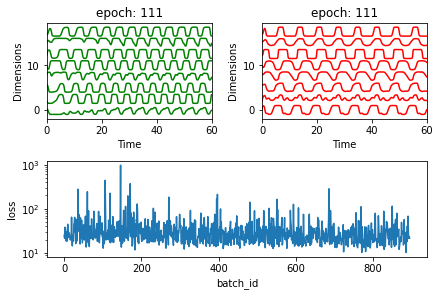

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-0.28392811  0.53066532  0.9002528   1.49083303  0.22395469  2.19304359
   1.21197914  1.2067783 ]
 [ 0.50937076  0.18593864 -0.35476304 -0.25257403 -0.02389626 -0.27185914
  -0.35568217 -0.87974469]
 [ 0.64439444  0.08788559 -0.55892793 -0.00272733  0.17047214 -0.72625275
  -0.5385419  -0.76359259]
 [-0.97742086 -0.38365899 -1.03514866  1.30979432  1.20400665  0.77299737
   0.03384528 -0.67221899]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.04it/s]

[[-0.10093996  0.33813033  0.5513903   0.17698945  0.16286897  0.43755042
   0.47619866  0.22463842]
 [-1.39122794  0.40350501  0.30370873  1.98233273  1.06183346  2.24569874
   0.95505042 -0.2830276 ]
 [ 0.73343422 -0.2166615  -0.06354898 -0.82488944 -0.32937372 -1.04672103
  -0.04554721 -0.78721888]
 [-0.73676701  0.23052737 -0.13970451  1.07276521  0.73397304  0.27748841
  -0.02425158 -0.69542568]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[-0.59234416 -0.45926605 -0.70045212  0.43209675  0.81771314 -0.93178238
  -0.45010408 -1.07765877]
 [-0.0367213   0.12029612  0.13179755  0.37972662 -0.03909047 -0.0510878
  -0.05829857  0.17351125]
 [ 0.1762793   0.14635363  0.19922092  0.76325233  0.07567624  0.83810475
   0.53515708  0.0586301 ]
 [ 0.07306453 -0.17557312 -0.19451004  0.07942666  0.2115598  -0.77150212
  -0.04712974 -0.56887191]]


 38%|███▊      | 3/8 [00:02<00:04,  1.07it/s]

[[-0.66103657 -0.07490944 -0.58290558  0.76680009  0.86232638 -0.95918428
  -0.59688908 -0.71192874]
 [-0.97761106 -0.30084577 -0.57362611  0.61173991  0.89898982 -0.68314687
  -0.40204291 -0.97545864]
 [-1.06679664 -0.10019881 -0.84577252  0.75579209  0.9776237   0.76523536
  -0.41753563 -1.31563365]
 [ 0.72502595  0.41836033  0.90578307  0.48208272 -0.46062359  0.64345633
   0.89111599  0.63167486]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[ 8.73498622e-01  5.77345939e-01  5.22979190e-02  3.00640406e-01
  -2.33761266e-01  1.39738241e+00  2.62254000e-01 -1.38174961e-01]
 [-4.47208418e-02 -1.53323696e-01  1.10216440e-03  2.28425439e-02
   1.96402978e-01 -4.00475935e-01 -1.03571466e-01 -3.92838198e-01]
 [-1.07884500e+00 -7.85576789e-01 -1.05210832e+00  1.82715925e-01
   1.25900659e+00 -1.60166404e+00 -6.99099009e-01 -1.79941562e+00]
 [-5.35149195e-01 -3.42875600e-01 -5.98037154e-01  3.79618307e-01
   7.63814724e-01 -1.25975733e-01 -1.42138419e-01 -8.48509317e-01]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.03it/s]

[[-7.23782559e-01 -4.89418744e-02 -8.77599236e-01  1.30498628e+00
   1.33162433e+00  1.35919739e+00 -3.62165578e-02 -9.15391840e-01]
 [-6.52471193e-01 -5.15630368e-02 -1.92956960e-01  9.53490112e-01
   7.65644014e-01  6.35878374e-01  2.21874833e-01 -5.17855724e-01]
 [-7.42910193e-01  1.00631838e-01 -7.47276686e-01  9.07002321e-01
   9.63676603e-01  2.15407013e-01 -5.77157488e-01 -8.00977249e-01]
 [ 1.52535718e-01 -2.98591054e-01 -3.54963604e-01  9.58622403e-02
   3.95073924e-01 -8.42853773e-01 -7.35913785e-04 -7.18472037e-01]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.05it/s]

[[ 0.19266606  0.99526752  0.91493095  1.1658056  -0.09817826  2.53621715
   1.19765745  0.93992914]
 [ 1.57479158  0.26120349  0.55206275 -0.18470999 -1.03313775  0.17548779
   0.61040878  0.56091382]
 [ 0.57751064  0.04823953 -0.45838161 -0.90424639 -0.25599447 -2.02309325
  -0.93848652 -1.63525198]
 [ 1.07889666  0.6703871   0.60923079 -0.01183997 -0.84428923  0.72045922
   0.52139119  0.0480193 ]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[-0.65390057  0.18204129  0.15846069  1.00421689  0.47869266 -0.12677865
   0.26330643  0.12889105]
 [ 1.29572376  0.21514524 -0.06779909 -0.63323534 -0.82715977 -0.86821498
  -0.31914526 -0.65137411]
 [-0.74249581  0.40461967  0.03626738  1.70867109  0.80997962  1.87719632
   0.51326358  0.43079282]
 [ 0.3843048   0.95024698  1.69887212  1.70235677 -0.08315102  1.98715588
   1.63825308  2.07204047]]


100%|██████████| 8/8 [00:02<00:00,  3.01it/s]


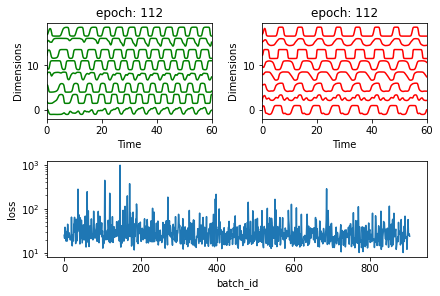

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.0279735  -0.10807219 -0.48942399  0.30048256  0.46933179 -1.04027791
  -0.33835461 -0.77619024]
 [-0.05426193  0.39469341  0.55401075  1.10220808  0.38896048  1.34372001
   0.88895366  1.06006416]
 [ 0.01034232 -0.08344052  0.11181408  0.25757702  0.14999834  0.1020157
   0.37685599 -0.12858461]
 [ 0.19993942 -0.40730243  0.37569543 -0.11645001 -0.07914304 -0.54607203
   0.4565165  -0.25302742]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.14s/it]

[[ 0.42190309 -0.17894022  0.23122687 -0.8647961  -0.43642542 -1.7813519
  -0.14530818 -0.97589964]
 [ 0.57830916  0.82101164  0.56380245  0.7080545  -0.27812269  0.83751762
   0.46949636  0.19385796]
 [ 0.78927719  0.02103035  0.20854901 -0.29702499 -0.37958326  0.19463967
   0.46287458  0.05431906]
 [-0.17798063  0.24345098  0.066641    0.63915793  0.52178742 -0.7827362
  -0.02465574 -0.30635892]]


 25%|██▌       | 2/8 [00:02<00:07,  1.19s/it]

[[ 0.24665743  0.09964879  0.24271483  0.16881808  0.03484064  0.15200067
   0.28072597  0.0590364 ]
 [-1.34567419 -0.77240203 -1.60157897  0.36089108  1.50736784 -0.71479161
  -0.90084192 -2.6808633 ]
 [ 0.07281746  0.43762375  1.02071446  0.60811702 -0.00669613  0.65272152
   1.12250452  1.19654253]
 [ 1.74215134  0.68083715  1.28932727 -0.76889131 -1.35383405 -0.89690751
   0.64285405  0.49364701]]


 38%|███▊      | 3/8 [00:03<00:05,  1.17s/it]

[[ 0.60100572  0.40130936  0.27206904  0.43742562 -0.40540531  0.15189784
   0.40274937 -0.33592612]
 [ 0.11539758 -0.15806764 -0.71869682 -0.55997027  0.23573945 -1.1487465
  -0.65717988 -1.50857562]
 [ 0.21087686 -0.20344929  0.56363183 -0.87466703 -0.28827153 -1.18445564
   0.47181761 -0.65915666]
 [-1.64241736 -0.47001945 -1.31270919  1.27666038  1.67447425 -0.14621632
  -0.60273344 -1.42443273]]


 50%|█████     | 4/8 [00:04<00:04,  1.13s/it]

[[-1.25577979  0.13468931 -1.13263561  1.21899226  1.20047314  0.15574852
  -0.78083877 -1.54822381]
 [-0.85433463  0.06746574  0.05348847  1.33374895  1.27601638  1.57184607
   0.69354778  0.0719323 ]
 [-0.71817821 -0.3316065  -1.11485537  0.39825812  0.94278368 -0.71929318
  -0.67087823 -1.46085479]
 [-0.50627034  0.18802449 -0.49084286  0.74971599  0.61245348  0.09195714
  -0.23930084 -0.42643871]]


 62%|██████▎   | 5/8 [00:05<00:03,  1.08s/it]

[[ 1.76420341  0.39755722  0.4300816  -1.16763607 -1.48101954 -0.7314144
   0.13181527 -0.33768019]
 [-1.27055102 -0.49458379 -0.58443217  0.88295255  1.57186194 -0.62567664
  -0.26947309 -0.32334304]
 [ 0.19292341  0.18839116  0.00816436  0.45202564  0.00837547 -0.03822579
   0.09257347 -0.28777533]
 [-0.4201209  -0.00681916 -0.57214938  0.77007257  0.71563788  0.02547929
  -0.2119671  -0.87583566]]


 75%|███████▌  | 6/8 [00:06<00:02,  1.07s/it]

[[-0.67240447 -0.14898125  0.40936933  0.54798261  0.51421216 -0.11007568
   0.54742585 -0.14515547]
 [-0.4907763  -0.40710368 -0.77332326  0.08145045  0.94046381 -0.77275292
  -0.40599139 -1.16657889]
 [ 0.21981472  0.35212102  0.97704561  0.48067652  0.01837905  0.73005796
   1.08669102  0.7130887 ]
 [ 0.52480133 -0.03146346  0.93127224 -0.27643791 -0.16803855  0.26586871
   1.05673793  0.04289571]]


 88%|████████▊ | 7/8 [00:07<00:01,  1.03s/it]

[[-0.44523934 -0.12285382 -0.93072615  0.21115528  0.65678228 -1.61284942
  -0.89236148 -1.52520233]
 [-0.84991723 -0.41059323 -1.05632854 -0.16171906  0.98355428 -2.0259577
  -1.17009609 -2.06105576]
 [ 1.16007239  1.12551477  1.08856553  0.84599564 -0.83437417  2.22356511
   1.18680325  1.35882483]
 [ 0.9208459   0.38245125 -0.07045131 -0.34617096 -0.50406536 -0.55132073
  -0.20617615 -0.82587258]]


100%|██████████| 8/8 [00:02<00:00,  3.19it/s]


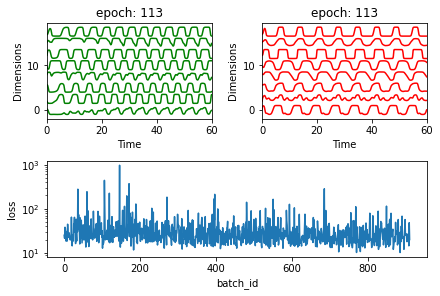

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.19075884 -0.18167723  0.59684912  0.09876505 -0.05045084  0.08107932
   1.10423411  0.15390413]
 [ 0.39739184  0.33622914  0.66547626  0.44407208 -0.3706012   0.44176551
   0.8591895   0.17706854]
 [ 0.46040263  0.1536844  -0.0753365   0.0868631  -0.14789956  0.23301103
   0.07060139 -0.62342111]
 [-0.09972958  0.18910612 -0.84118652  0.37123028  0.31926119 -0.45634856
  -0.86494682 -0.26864308]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.03it/s]

[[-0.45623348 -0.1601844  -0.8108559   0.36059979  0.42497335 -0.75949841
  -0.52815455 -1.2145169 ]
 [ 0.01985627  0.37218694  0.23494928  0.54181789  0.22532836 -0.03917448
   0.19137402  0.08972042]
 [ 0.74444106  0.38339818 -0.06616075  0.05978576 -0.57526451 -0.07937302
   0.02130166 -0.34481048]
 [ 0.13539108  0.29614612  0.21268841  0.24727052 -0.10395581 -0.00681031
   0.23547025 -0.21387358]]


 25%|██▌       | 2/8 [00:01<00:05,  1.04it/s]

[[ 0.45327648  0.15511892 -0.04662881  0.02091209  0.17530319 -0.97119022
  -0.15995938 -0.21483415]
 [-0.83335058 -0.91379193 -1.26112398  0.19369107  1.0326049  -0.98207408
  -0.48332178 -1.61543375]
 [ 1.02531837  0.38936895  0.13657715  0.12528508 -0.32416221  1.16248981
   0.52795427 -0.02731103]
 [ 0.65150634  0.22980942  0.38257162 -0.07077803 -0.55295825  0.47624571
   0.47983296 -0.27738889]]


 38%|███▊      | 3/8 [00:02<00:04,  1.06it/s]

[[ 0.12114127 -0.70863502 -0.62371815 -0.43500157  0.22227683 -1.7030956
  -0.37560695 -1.04188961]
 [ 0.10690432 -0.13522899 -0.12266565  0.13742296  0.07431549 -0.90916749
  -0.03476789 -0.39814317]
 [-0.00855769  0.62106373  1.14212131  1.52785151  0.22508606  1.3068168
   1.25208522  1.43909777]
 [ 1.31480307  0.79667264  0.65462922 -0.16842017 -0.92476923  0.20504766
   0.31530423  0.28612266]]


 50%|█████     | 4/8 [00:03<00:03,  1.03it/s]

[[-1.53276353 -0.13998267 -0.62949563  1.71536571  1.38696683  1.03037158
   0.10165784 -0.35102197]
 [-0.42172367 -0.06312786 -0.84750175  0.06301411  0.52006526 -1.2089923
  -0.7125641  -1.20320154]
 [-0.04398964 -0.16782542 -0.83691894  0.4599741   0.51226277  0.07021346
  -0.38864202 -1.20702501]
 [-0.28298219 -0.26574247 -0.62843927  0.23552325  0.62179513 -0.8076787
  -0.34101866 -1.12169333]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.05it/s]

[[-0.76964923 -0.32055765 -0.46810321  0.57811738  1.07269806 -0.35073891
  -0.2743562  -0.91878415]
 [ 0.14759538  0.63830803  0.88418749  0.8738325  -0.4437856   1.77672237
   1.19822171  0.59829753]
 [-0.21667398  0.04634265 -1.0051155   0.64923185  0.7930289  -0.28366312
  -0.62332877 -0.9047899 ]
 [-0.31233071 -0.38705915  0.19149128  0.2975857   0.61436033 -0.23146692
   0.53025594 -0.15648342]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[-0.10941308  0.2630297   0.68488952  0.67857902  0.29557005  0.97828111
   0.84620752  0.11635973]
 [ 0.49551922 -0.10431737 -0.22681061  0.33482635 -0.1575831   0.3892075
   0.33277311 -0.77802924]
 [-0.66372967  0.00733794 -0.06506552  0.55454067  0.59681302 -0.03316226
   0.15549439 -0.37149426]
 [ 0.36413656  0.29606867  0.30500302  0.57316747 -0.01475841  0.39534773
   0.34377174  0.13598945]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[-0.17698892  0.27890253 -0.29121349  0.33941265  0.11577894  0.59264978
   0.06693679 -0.83170895]
 [-0.15275572 -0.1212634  -0.67384926 -0.04291169  0.33954151 -0.24608978
  -0.40687656 -1.52555689]
 [ 0.48718142  0.30588847  0.37985754  0.17236064 -0.40942027 -0.54319859
   0.15483847  0.13970941]
 [ 1.12340509  0.36502119  0.64100462 -0.19955772 -0.61886169 -0.63205262
   0.37573446  0.13784852]]


100%|██████████| 8/8 [00:02<00:00,  3.10it/s]


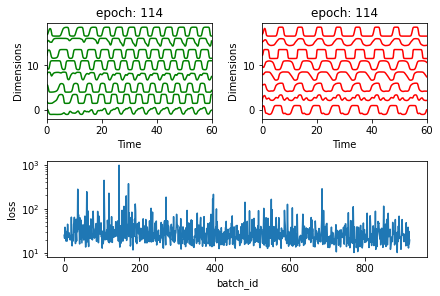

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[-1.44678911 -0.46785619 -1.38567294  1.02973844  1.50229586 -1.07007381
  -1.16208556 -1.50551547]
 [ 1.17319118  0.67076222  1.20689851  0.13642675 -0.87996228  1.50144555
   1.32589914  0.27517645]
 [-0.92656573 -0.83775102 -1.2515172  -0.06523316  1.08874153 -1.66741732
  -0.84623243 -2.24775594]
 [ 0.76653663 -0.07854816 -0.40858    -0.54429091 -0.17108237 -1.54677717
  -0.5968427  -0.61723022]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.14s/it]

[[-0.24359833 -0.28315689 -0.84319773 -0.19061841  0.54779609 -0.46456416
  -0.44888346 -1.75745929]
 [ 0.22333577  0.0614037   0.25357672  0.63432723  0.2945906   0.5473202
   0.6920849   0.04515301]
 [-0.90761409  0.2715007  -0.09135502  1.03040789  0.41003938 -0.19823835
  -0.11453596 -0.64716104]
 [ 0.70247064 -0.11134196 -0.31999369 -0.74482554 -0.42442162 -1.28716861
  -0.45269046 -1.0095951 ]]


 25%|██▌       | 2/8 [00:02<00:06,  1.08s/it]

[[ 0.77266644  1.04361854  1.24649487  0.47509768 -0.77679651  1.19416492
   0.89158994  0.88321092]
 [ 1.04699208  0.80046289  0.70841489  0.13102142 -0.84724227 -0.30426666
   0.30363165  0.39864259]
 [ 1.04488417  0.27579499  0.65387498  0.22141136 -0.34026752  0.37603211
   0.93031495  0.69728247]
 [-0.09134367  0.1126697  -0.92845095  0.56522425  0.68625861  0.29298486
  -0.50791504 -0.94704004]]


 38%|███▊      | 3/8 [00:02<00:05,  1.03s/it]

[[ 0.30517847  0.26613844  1.28756213  0.43831389 -0.24090324  0.22939888
   1.12240855  0.8968395 ]
 [ 0.1987156  -0.2683223  -0.90679571  0.17417382  0.25254923 -0.30187696
  -0.49942824 -1.04798591]
 [ 0.20983971 -0.02189264 -0.06577652  0.04869097 -0.07405489 -0.40837897
   0.17199747 -0.64159012]
 [-0.36015224 -0.10649042 -0.90831947  0.42600342  0.54556755 -0.49928389
  -0.58500801 -0.80594623]]


 50%|█████     | 4/8 [00:03<00:04,  1.01s/it]

[[ 0.72002544  0.53278393  0.67802347  0.3903009  -0.47425725  0.58776202
   0.79389982  0.6505061 ]
 [-0.0809554   0.53284197 -0.42887342  0.85031682  0.30245445  0.11202639
  -0.14657213 -0.75865986]
 [-0.42953123  0.62283643  0.38938403  1.69211299  0.54502606  2.14699886
   0.87231086  0.3963045 ]
 [ 0.09428541  0.09837848 -0.4850816  -0.17093209 -0.08374501 -0.87506848
  -0.56526605 -0.8626075 ]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.02it/s]

[[-0.65478377  0.10244446 -0.53586902  0.7126339   0.64319488 -0.21961438
  -0.45174219 -0.60720863]
 [-0.05567311  0.237797    0.6568206   0.91295496  0.1925228   1.3210128
   0.96180912  0.69381206]
 [ 0.11833888 -0.09653128  0.01074623  0.16516704  0.37336246  0.09452149
   0.21366125  0.05909089]
 [-1.26735855 -0.33619743 -1.41907814  0.63098507  1.18397595 -1.37891034
  -0.98856295 -2.14154892]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.03it/s]

[[ 0.79328632  0.3416409   0.66431508 -0.33142392 -0.5518792  -0.42077338
   0.57192179  0.16919991]
 [ 0.82512598  0.17139563  0.44289427 -0.55193031 -0.6952963  -0.20442081
   0.48052024 -0.45617993]
 [ 1.04363287  0.41572319  1.2378303  -0.14161333 -1.00454388 -0.42331335
   0.93450534  0.83208146]
 [ 0.11091782  0.18551552  0.13812418  0.31102337 -0.13339121  0.33853677
   0.32730811 -0.42496214]]


 88%|████████▊ | 7/8 [00:06<00:01,  1.02s/it]

[[ 1.13086394e-01  4.02694329e-01  2.91770320e-01  6.59725244e-01
   2.51256271e-01  2.62860150e-01  2.76479561e-01  3.46234126e-02]
 [ 4.13930547e-01  5.94177776e-01  3.32292520e-01  7.23530175e-01
  -7.99627346e-02  5.46893247e-01  3.58186364e-01  4.87737046e-01]
 [ 7.79848775e-01  4.90825996e-01  1.03997546e+00  5.28790073e-04
  -1.03331977e+00  2.08411012e-01  8.97028433e-01  6.96048257e-01]
 [ 2.75049532e-01  5.79942286e-01  3.62504407e-01  5.83962565e-01
  -1.08850277e-02  1.83048932e+00  6.80442460e-01  3.78708801e-01]]


100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


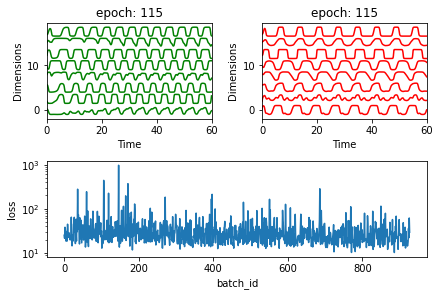

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.33274002  0.59343985  0.99394123  0.72170275 -0.09990173  0.67312238
   0.92839356  0.5242514 ]
 [ 0.5272829   0.44290182 -0.02139916  0.22365924 -0.32573138 -0.06392746
  -0.10999456 -0.76655628]
 [-0.2729789   0.68354474  0.97943472  1.53044335  0.67114505  2.64224475
   1.3668567   1.46678887]
 [-2.37291259 -0.25280423 -1.68153404  2.13858264  2.26732363  1.15296338
  -0.74974108 -1.43548778]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.04it/s]

[[ 0.28441516 -0.04674908  0.41110342 -0.40192199 -0.42968043 -0.85917845
   0.29227473 -0.45812959]
 [ 0.18654333  0.35820445  0.40997427  0.46025779 -0.1826225   1.8798508
   0.78339204  0.3516622 ]
 [-2.60739825 -0.25827094 -0.62431642  2.33545953  2.64536442  0.84252871
   0.07292078 -0.32563219]
 [ 0.04672286  0.65740354  0.46011716  0.54060704 -0.06423092  1.00843796
   0.45364734  0.12714537]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[ 0.53632856 -0.24939657 -0.51506365 -0.46523704 -0.00890407 -1.30455051
  -0.38409251 -1.27519307]
 [-0.95877157 -0.04693377 -0.14737718  1.2921792   1.28445225  0.46093863
   0.18716163 -0.05448271]
 [-0.75985558 -0.42053805 -0.70939682  0.61290363  0.80004838 -0.30931027
  -0.21100653 -1.50834247]
 [ 1.35536308 -0.217013   -0.14035968 -0.99919208 -0.58938857 -1.68719411
  -0.27735978 -0.76304617]]


 38%|███▊      | 3/8 [00:02<00:04,  1.06it/s]

[[ 1.71256721  0.78349812  1.4097354  -0.12170749 -1.72094391 -0.3676169
   0.88044599  1.39918069]
 [-0.66312336  0.51366615  0.33434976  1.25814453  0.3308958   1.92295078
   0.73853276  0.2530669 ]
 [-0.32601111 -0.53073356 -1.93416785 -0.45507982  0.96043486 -1.55030814
  -1.63433334 -2.11093945]
 [-0.21663741  0.01789271 -0.64048606  0.33164285  0.20078563 -1.38325116
  -0.78874736 -1.0453386 ]]


 50%|█████     | 4/8 [00:03<00:03,  1.03it/s]

[[-0.816538   -0.42679669 -1.26735806  0.50138009  1.22254805 -1.61914499
  -1.0076287  -2.1390056 ]
 [-1.18975218 -0.43640019 -1.50473983  1.15760188  1.88858136  0.93537019
  -0.65490758 -1.27452476]
 [-0.09953803  0.45541941  0.27116166  1.00042575  0.14597441  1.57140845
   0.53681971  0.57648057]
 [-0.93335059  0.03030332 -0.44652222  1.14816616  1.11217763  1.147866
   0.08741807 -0.42792517]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.04it/s]

[[-0.10276386  0.37192372  0.79735481  0.81922263  0.16235113  0.63271949
   0.84867167  0.75650829]
 [-1.11529073 -0.09652922 -0.77850318  1.40743522  1.23313208  0.70748527
  -0.12529723 -0.39168045]
 [-0.43832346 -0.21512185 -0.76851251  0.57264181  0.74383488 -0.20908566
  -0.40223306 -1.0376809 ]
 [-0.37462268  0.542568   -0.69013513  1.18459049  0.81481493 -0.06896479
  -0.59719925 -0.42650219]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.05it/s]

[[ 0.73362912  0.56141563  1.38860897  0.81873173 -0.51140671  0.99288202
   1.29813148  1.38632352]
 [ 0.27126105  0.31719778  0.30758798  0.60341282 -0.35786161  0.25396515
   0.41693474  0.3116921 ]
 [-0.19600135 -0.37120847 -0.85474846 -0.2567296   0.4174043  -1.67047776
  -0.93774676 -1.64217663]
 [-0.47579883 -0.34736622 -0.69586269  0.05404899  0.41712798 -0.2931631
  -0.32658145 -1.24878338]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[ 0.55543799  0.08454944 -0.27048378 -0.31234559 -0.34471185 -2.0954258
  -0.68926359 -0.95041455]
 [ 0.26881945 -0.19003625 -1.10170142 -0.34718239  0.04122584 -1.19908989
  -0.93978471 -1.97081212]
 [-0.05446249  0.16831668  0.12366504  0.34474079  0.20766316 -0.21815577
   0.03976149 -0.27578136]
 [-1.49547228 -0.49186036 -1.15463117  1.07752869  1.53127918  0.04641618
  -0.21072563 -1.55311545]]


100%|██████████| 8/8 [00:02<00:00,  3.16it/s]


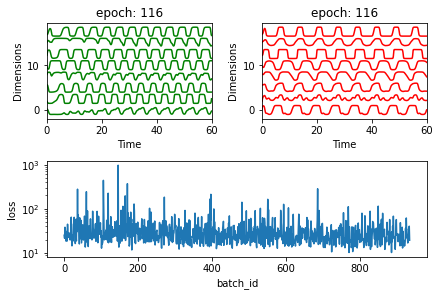

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.29830381  0.26173358  0.6988809  -0.60678356 -1.24860225 -0.15298591
   0.4826623  -0.2421593 ]
 [ 0.81436734  0.4553628   1.30422714  0.12655039 -0.56950381  0.5709607
   1.21415467  1.22724109]
 [ 0.67755012  0.38204645  0.8654908   0.06038935 -0.52155526  0.14658048
   0.74019441  0.74271527]
 [ 0.04082225  0.08882966  0.38097847  0.86818221  0.45569386  1.95981334
   1.10631521  0.34872489]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:01<00:07,  1.09s/it]

[[-0.26982899  0.88950586  0.88864122  1.71822307  0.40447948  1.38221472
   0.9778614   1.35236853]
 [-0.715156   -0.08179273 -1.02937422  0.7272949   0.81165187  0.34999538
  -0.54600212 -1.35516326]
 [ 0.66452615  0.24284827  0.50128156 -0.38409279 -0.48283367  0.25646905
   0.41624916  0.11767275]
 [ 0.72478731  1.01372861  1.04963702  1.37308457 -0.37327433  2.56531608
   1.16914525  1.29034397]]


 25%|██▌       | 2/8 [00:02<00:06,  1.04s/it]

[[-1.57731985 -0.31564572 -1.49568925  1.32077401  1.57426444 -0.06549667
  -0.72544819 -1.67214589]
 [-0.14872777 -0.31797722 -0.53685662  0.55393183  0.82569503  0.0494287
  -0.03677337 -0.3081489 ]
 [-1.917778   -0.06369699 -0.28275794  2.07055109  1.88482825  1.37346141
   0.28765864  0.36348529]
 [-0.63021794 -0.20334237 -0.18158829  0.79547245  1.13129998  0.17072712
   0.18874303 -0.59239322]]


 38%|███▊      | 3/8 [00:02<00:05,  1.02s/it]

[[-0.67665191  0.21256     0.58419829  1.41766132  0.68374752  1.35202009
   1.09971731  0.07441059]
 [-0.30501924  0.10217936 -0.47549804  0.30759643  0.26414046 -0.8254155
  -0.36057772 -1.32845024]
 [-0.18540194  0.57176065  0.53062089  1.06912185  0.30749677  2.02095468
   0.83704471  0.74300824]
 [ 0.09495787  0.11872978  0.48089758  0.72083551  0.4466946   0.80103989
   0.81479113  0.42602075]]


 50%|█████     | 4/8 [00:03<00:03,  1.01it/s]

[[ 1.09403494  0.69010696  0.78950263 -0.18326818 -1.17073287  0.30282109
   0.46327521  0.44396612]
 [ 0.85893371  0.42458374  1.13709575 -0.12465911 -0.76352455 -0.07871343
   0.90815474  0.68153615]
 [ 1.93582186  0.72687335  0.72014451 -0.77463437 -1.67488246 -0.42832402
   0.50568015 -0.34886384]
 [-0.72579571 -0.86262196 -0.85300673  0.21480695  0.9997319  -1.31667592
  -0.50390612 -0.93474428]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.02it/s]

[[-1.2761883  -0.28470654 -0.41009218  1.04348108  1.42988489  0.75980859
   0.5090574  -0.66136064]
 [-0.09521651 -0.39169778 -0.35475054 -0.10979536  0.1545559  -0.95492822
  -0.1442174  -1.20487825]
 [ 0.85004338 -0.59931321 -0.6865649  -1.0765552  -0.12310522 -2.99414685
  -0.96381736 -1.09843118]
 [-0.24070989 -0.33100783 -0.39665233  0.21782186  0.54121316 -0.75177179
  -0.04849999 -0.4823473 ]]


 75%|███████▌  | 6/8 [00:05<00:02,  1.00s/it]

[[ 3.61374276e-01  5.48739844e-01  6.04382212e-01  1.37084937e-01
  -6.58666557e-01 -1.97228849e-02  3.32626623e-01 -2.03782177e-01]
 [ 1.43799969e-01  2.20092136e-01  4.02467205e-01 -6.32087616e-04
   1.97485100e-01 -3.36400393e-01  2.93645222e-01 -3.99541895e-03]
 [ 6.38503169e-01  5.01730713e-01  1.26610903e-01  2.94126084e-01
  -3.46993362e-01  4.90004104e-01  1.70154522e-01 -1.60203266e-03]
 [ 4.38151701e-01  9.95667370e-02  3.24575572e-01 -2.65468111e-01
  -1.91412737e-01 -4.22720281e-01  3.00038011e-01 -3.10762593e-01]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.01it/s]

[[-1.72795447 -0.50517194 -1.64298932  1.51743348  2.29255581  0.76739895
  -0.70023362 -1.21612141]
 [ 1.77465738  1.29525797  2.51989402  0.32493394 -1.82075412  0.78280417
   1.81624646  2.91557162]
 [ 0.0116846   0.34437367 -0.04912488  0.34775921 -0.00351932  0.43116705
  -0.03431336 -0.20115929]
 [-0.51290586  0.1611849   0.08571195  0.82536223  0.29566287  0.26518838
   0.24563046  0.08056109]]


100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


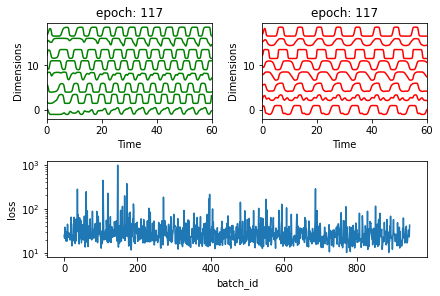

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 2.09556385  0.55331035  1.00699403 -1.0213997  -1.81108756 -0.64521423
   0.56130899  0.7321607 ]
 [ 0.39328149  0.19159792 -0.30946166  0.38050013  0.35771534 -0.09971796
  -0.22375433 -0.26098983]
 [ 1.93139036  0.30052577  0.55456495 -1.16820489 -1.52821998 -1.18245928
   0.14789369 -0.0444537 ]
 [ 0.00432419  0.40926132 -0.32555525  0.70273567  0.14075554 -0.03477246
  -0.13325859 -0.7451367 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.03it/s]

[[ 0.04085952 -0.09759892  0.33907884  0.07078745  0.03626613 -0.42213714
   0.30213826 -0.16651066]
 [ 0.05967763  0.10858593 -0.42782904  0.41155076  0.24001259 -0.29105849
  -0.30116293  0.15316599]
 [-0.41020205  0.22889013 -0.28687659  0.63896459  0.16755911  0.37032753
  -0.16078891 -1.06630036]
 [ 0.3235563  -0.10974116 -0.5512158  -0.55788672 -0.01858214 -0.91098243
  -0.43087078 -1.4230742 ]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 25%|██▌       | 2/8 [00:01<00:05,  1.04it/s]

[[-0.76019802 -0.11413782 -0.36271287  0.94525551  1.01013218  0.41712749
   0.07767377 -0.2584869 ]
 [ 1.63507603  0.63334846  0.11214153 -0.31316827 -0.76500337  0.21813423
   0.10261751 -0.01747862]
 [ 0.26112638 -0.67526204 -1.21657795 -0.5466361   0.40126728 -1.16740174
  -0.7643633  -1.85631117]
 [-0.98271461  0.024034   -0.79106239  1.31469617  1.28152533  0.59264774
  -0.32246484 -0.33954346]]


 38%|███▊      | 3/8 [00:02<00:04,  1.00it/s]

[[-1.02177982e+00  6.33880923e-01  2.87525634e-03  2.25953405e+00
   1.17574757e+00  1.21097478e+00  3.23515855e-01  1.05447446e-01]
 [-1.03635681e+00 -3.05665056e-01 -4.13704558e-01  6.33902639e-01
   9.63386125e-01  5.58875302e-01  8.76140515e-02 -6.63036413e-01]
 [-5.31529860e-01  7.06928586e-02  5.53321441e-01  1.13620351e+00
   8.37896520e-01  1.27064465e+00  8.68089182e-01  1.05557874e+00]
 [-8.00379272e-01  2.11359543e-03  1.38288463e-01  5.09993706e-01
   3.68199103e-01  2.58533643e-01  3.39498251e-01 -4.24542844e-01]]


 50%|█████     | 4/8 [00:03<00:03,  1.02it/s]

[[ 0.80962188  1.00396147  1.57324801  1.35121038 -0.51435181  3.16465294
   1.96609869  2.24380125]
 [-0.65911154  0.43672281  0.28391011  1.18337883  0.44504815  0.85413799
   0.40786929  0.16826952]
 [ 0.44011316 -0.03130511 -0.76894527 -0.46051392  0.13209573 -1.98801626
  -1.00513073 -0.96691121]
 [ 1.42530634  0.87164866  1.36101028 -0.68533909 -1.75035337 -0.54991009
   0.60731714  0.80546716]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.03it/s]

[[ 0.65526411  0.28439318  0.1498266  -0.04456153 -0.4522264   0.261435
   0.17956014 -0.45284203]
 [-0.05278927 -0.30250676 -0.15808471  0.18282537  0.64111189  0.16684938
   0.21703634 -0.56028019]
 [-0.47685813 -0.17791867 -0.49524957  0.05097169  0.62966351  0.23056028
  -0.0512445  -1.10861885]
 [-0.69600981 -0.15602181  0.10776331  0.6541002   0.79802193  0.02783413
   0.43175231  0.18689611]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[ 0.56498687  0.40801359  0.44710311 -0.41113438 -0.81415337 -0.25779159
   0.05520384 -0.45529613]
 [-0.9537163  -0.10132132 -0.58215993  1.01460153  1.37902332 -0.23689981
  -0.27271441 -0.78506412]
 [ 1.49679667 -0.00678925 -0.0443694  -0.64016576 -0.98263027 -1.60238665
  -0.13910483 -0.75864369]
 [-0.92450186 -0.28545272 -0.38539189  0.98806894  1.1049082   0.77983241
   0.26984973 -0.61848253]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.06it/s]

[[ 0.45960792  0.20796101  0.72099124 -0.23610146 -0.3818991  -0.24638248
   0.5612615   0.31539191]
 [ 1.67192357  0.60798685  1.23553174 -0.25005559 -1.06379743  0.49506553
   1.05574522  0.87173886]
 [ 1.6638668   0.52790619  0.34820111 -0.99345    -1.39790852 -1.15662035
  -0.16149638 -0.3379695 ]
 [ 1.18405645  0.17753572  0.39363049 -1.02415135 -0.98710782 -1.03539911
  -0.00292699 -0.26628285]]


100%|██████████| 8/8 [00:02<00:00,  3.07it/s]


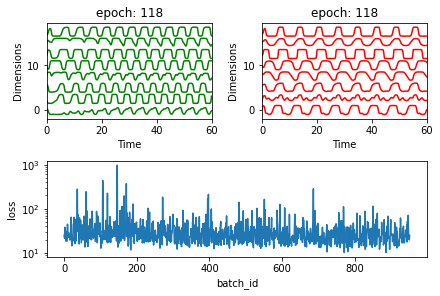

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 1.11994294  0.22222085  0.60240899 -0.60684936 -0.83537803 -0.41620268
   0.38077697  0.0028943 ]
 [ 0.8175667   0.50759231  0.91763632 -0.29309363 -1.12108325 -0.45854886
   0.56545326  0.07909947]
 [-0.26632131  0.03361353 -0.62113174  0.24451723  0.37835722 -0.01677592
  -0.23767293 -0.70005924]
 [ 0.65904993 -0.04823328 -0.23702267 -0.37526458 -0.48927345 -1.13504358
  -0.3185512  -0.90109059]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.04it/s]

[[ 0.85811275  0.6569491   0.55175653  0.44166065 -0.39615211  0.53069491
   0.44503227  0.12292333]
 [-0.40753437  0.36077108  1.03654266  0.84098897  0.25651807  0.58627316
   1.12501891  1.26939912]
 [ 1.40721664  0.47258936  1.15984312 -0.76840279 -1.36647595 -0.75790168
   0.59543776 -0.04577512]
 [ 0.33204236 -0.24756944 -0.49076547 -0.64477099 -0.10298    -2.14892215
  -0.7739042  -1.18229554]]


 25%|██▌       | 2/8 [00:01<00:05,  1.05it/s]

[[-0.91613765  0.2709272  -0.29256598  1.57483549  0.86525227  1.13636337
   0.14591127  0.44720225]
 [ 0.33578505 -0.1145131  -0.59644917 -0.29873999  0.07024985 -1.67837459
  -0.74378958 -1.05101059]
 [ 0.00264831  0.49000838  0.26805099  1.05380029  0.06987098  1.98827788
   0.80484565 -0.18633167]
 [-1.06977962 -0.32769377 -1.1620858   0.90109749  1.46629951 -0.49818048
  -0.62659809 -1.85540935]]


 38%|███▊      | 3/8 [00:02<00:04,  1.06it/s]

[[ 0.24272755  0.26631769 -0.08533415  0.02781694 -0.18823994 -0.55718452
  -0.21713714 -0.5039607 ]
 [ 0.8165651   0.60281712  0.82148194  0.20616709 -0.88248091  0.37390045
   0.54791935  0.33620117]
 [ 0.43556119 -0.25649117 -0.2807261  -0.68026802 -0.01786261 -0.55068062
  -0.29142415 -0.74952562]
 [-0.54517489 -0.12810425 -0.5476513   0.51700829  0.49933858 -0.42453746
  -0.22582478 -1.04755261]]


 50%|█████     | 4/8 [00:03<00:03,  1.07it/s]

[[ 0.86343998  0.46381653  1.03868777  0.14147088 -0.7493885   0.40904338
   1.00059367  0.57635468]
 [ 0.40910044  0.5188191   0.85779601  0.45167707 -0.19250997  0.43561133
   0.84270772  0.59403328]
 [-1.56771354 -0.66057352 -1.4852261   0.63191715  1.7152844  -0.21850456
  -0.74225418 -2.02613294]
 [-0.81747545 -0.34596226 -0.34016587  0.90115938  0.69320141  0.25390548
   0.23069972 -0.48523195]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.07it/s]

[[ 0.06864894 -0.41986635 -0.99212959 -0.70060117  0.20164878 -1.62399311
  -0.89607609 -1.99263472]
 [-0.49143697 -0.14996117 -0.54989896  0.35497483  0.44633149 -0.96901463
  -0.64925396 -0.65938725]
 [-0.71856483 -0.37576706 -0.71520259  0.51859458  0.97639342 -0.87562287
  -0.51193935 -0.87638688]
 [ 1.78526036  0.66669822  1.66612383 -0.25405917 -1.55475688  0.637713
   1.47522954  0.86412586]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.04it/s]

[[ 0.2510962  -0.35900608 -0.10850542 -0.88087672  0.11356252 -1.57287015
  -0.30529432 -0.61074598]
 [ 0.47433998  0.10153795 -0.48089327  0.25697981  0.10923136  0.49185478
  -0.10925013 -0.83523851]
 [-2.25956428 -0.94714876 -2.1744643   1.13859581  2.49723032 -0.84092607
  -1.38389235 -2.79509833]
 [ 0.06217796 -0.43585031 -1.00123362 -0.89589479 -0.06099008 -1.68281932
  -0.96732109 -2.26344405]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.05it/s]

[[ 0.56907483 -0.35309418 -0.06113508 -0.88059328 -0.32995082 -2.233034
  -0.2727569  -0.946281  ]
 [-0.02531227 -0.05248939 -0.30226846  0.38524572  0.50894557 -0.29686977
  -0.11866946 -0.5487801 ]
 [-0.12742061 -0.22438528 -0.48627862  0.59432854  0.67627174 -0.34642324
  -0.03138661 -0.66651891]
 [ 0.49819249  0.41060286  0.48851067  0.19353678 -0.25063257  0.66075818
   0.65445602  0.25634417]]


100%|██████████| 8/8 [00:02<00:00,  3.19it/s]


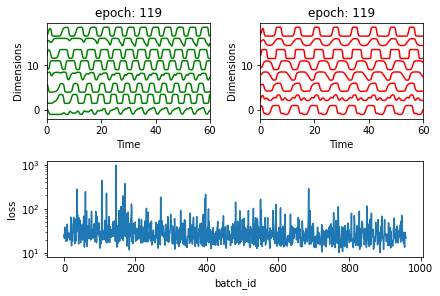

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.


[[ 0.86008377  0.33655852  0.75136629  0.08053089 -0.43898739  0.71471274
   0.78567188  0.5349539 ]
 [ 0.85779393  0.49278608  0.83636785  0.00910722 -0.61179229  0.34888242
   0.64621422  0.37708312]
 [ 0.01274116 -0.65445647 -0.80693291 -0.82907917  0.28952489 -1.79187728
  -0.67697891 -2.18317538]
 [ 1.84656748  0.3390821   1.02297623 -1.20216041 -2.0090669  -1.80796179
   0.45284045 -0.25205198]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
 12%|█▎        | 1/8 [00:00<00:06,  1.05it/s]

[[-0.35215822  0.12193084  0.03393989  0.53286789  0.44534183  0.06155391
   0.27821098 -0.13739035]
 [-0.43695263  0.05989625 -0.89048431  0.74501768  1.14200961  0.26765067
  -0.54622341 -0.70561519]
 [-0.51990664  0.28563125 -0.4783915   0.88641623  0.53574514  0.07665038
  -0.25608087 -1.11194998]
 [ 1.02087067  0.57115849  0.39317898 -0.61618657 -1.13543158  0.15746532
   0.33740704 -0.67069044]]


 25%|██▌       | 2/8 [00:01<00:05,  1.06it/s]

[[ 0.49980867  0.54496501  0.87922805  0.79668822 -0.28892753  1.68316833
   1.07172614  0.95384549]
 [-0.00844222  0.86251472  1.23684281  1.61003586  0.46457904  3.11224338
   1.53318089  1.725084  ]
 [-0.59534813 -0.09601928 -0.36646917  1.04106363  0.93667909  0.55662859
  -0.01242472 -0.04428272]
 [ 0.84283956  0.38266129  0.29637205  0.46161181 -0.29120598  0.31347025
   0.41045478  0.3346019 ]]


 38%|███▊      | 3/8 [00:02<00:04,  1.03it/s]

[[-1.28402372 -0.5175612  -1.46168137  0.48010576  1.08778651 -1.30120962
  -1.04558254 -2.04024745]
 [ 1.20201984  0.60718533  1.2849487  -0.11031388 -1.02386294  0.96266254
   1.28672295  0.60267554]
 [ 1.28329412  0.3805783   0.78002048 -0.36363191 -0.76820051 -0.11143639
   0.60030232  0.14445427]
 [ 0.56532419  0.23799325  0.22024269  0.10886756 -0.3633635  -0.78637834
   0.13714062  0.28799753]]


/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
 50%|█████     | 4/8 [00:03<00:03,  1.05it/s]

[[-0.36468043  0.26361549 -0.01997521  0.45967435  0.11336253 -0.12262694
   0.03260815 -0.61926086]
 [ 0.64610837 -0.29342435 -0.88762564 -0.85894804 -0.24676517 -1.59266835
  -0.9777375  -1.3014591 ]
 [-2.48575171 -0.35250189 -2.19011531  2.16057227  2.36460241  1.50107344
  -0.91256892 -2.21530021]
 [ 0.49570491  0.27735487  0.76953322 -0.01993599 -0.29917664  0.2671712
   0.80691455  0.51997222]]


 62%|██████▎   | 5/8 [00:04<00:02,  1.06it/s]

[[ 0.49682624  0.44840813  1.08558807  0.55063879 -0.24075092  1.76803809
   1.31695188  1.48137102]
 [ 0.31354318  0.65705054  1.31892264  1.15646523 -0.10213024  1.38527489
   1.40465739  1.44801897]
 [-0.16818928 -0.16763634 -0.7517348   0.49739286  0.83584666  0.2238669
  -0.120144   -0.97653547]
 [ 0.29942609  0.00311131 -0.08441087  0.13396479  0.03645303 -0.03665171
   0.04307006 -0.55030497]]


 75%|███████▌  | 6/8 [00:05<00:01,  1.06it/s]

[[-0.90561422  0.36379989 -0.72076565  1.68643002  1.272366    1.05719982
  -0.29341277 -0.18334133]
 [-1.07340165  0.00773682 -0.71170866  0.90402084  0.9537684   0.45062373
  -0.30337231 -1.05410037]
 [ 1.57141325  0.8546586   0.96063698 -0.06399156 -1.64234341  1.32346311
   0.98845418  0.61363558]
 [ 0.7892078   0.16163204  0.40225944 -0.2191545  -0.21315771  0.29118511
   0.50610911  0.20414822]]


 88%|████████▊ | 7/8 [00:06<00:00,  1.07it/s]

[[ 0.69727889  0.24713696  0.25848756 -0.00554575 -0.24056679  0.43769616
   0.43838115  0.13093989]
 [ 0.88674687  0.81764853  1.36876432  0.76304772 -0.8171961   1.27472971
   1.2867411   1.43834269]
 [-0.24818649 -0.32039805 -1.08505763 -0.15562759  0.41877703 -1.53043564
  -0.99393563 -1.62260422]
 [ 0.56012212  0.57799906  0.5172851   0.97637227 -0.05057755  1.2336346
   0.90627974  0.74782   ]]


100%|██████████| 8/8 [00:02<00:00,  3.13it/s]


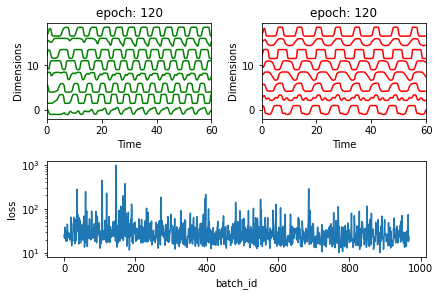

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.41it/s]


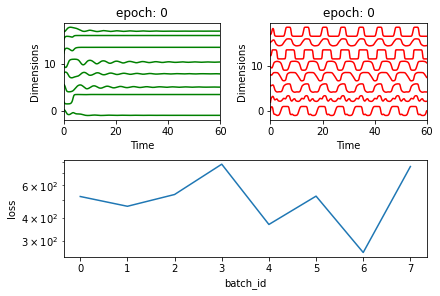

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.46it/s]


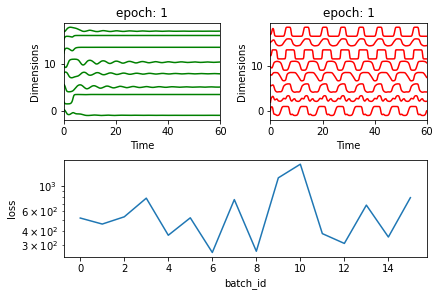

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.47it/s]


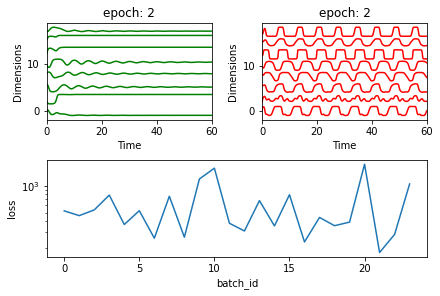

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


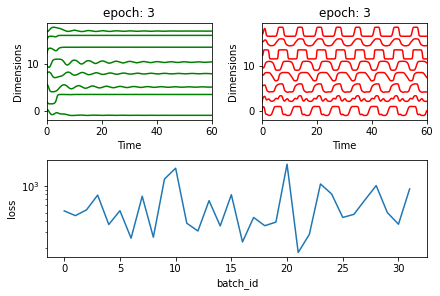

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


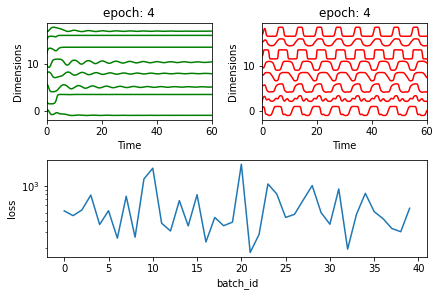

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


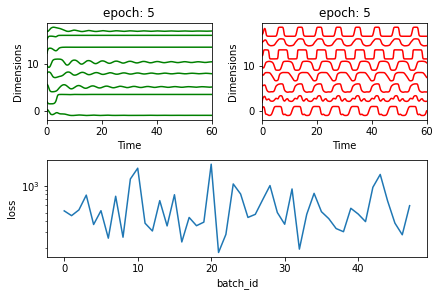

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


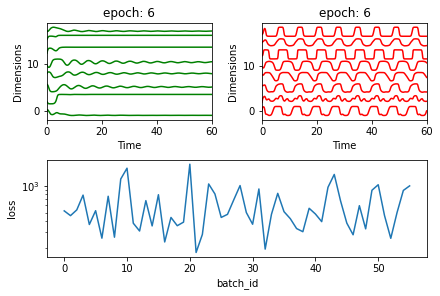

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


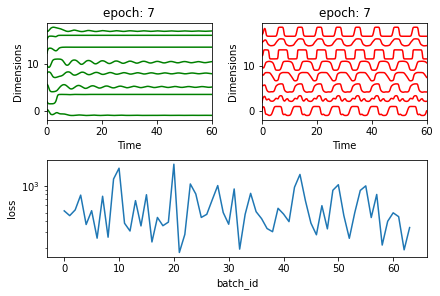

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


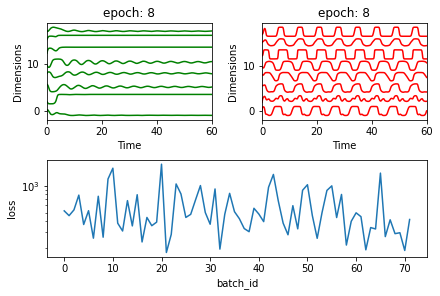

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.42it/s]


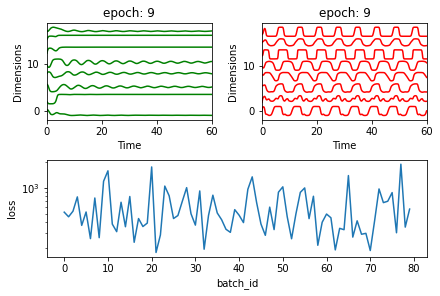

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.43it/s]


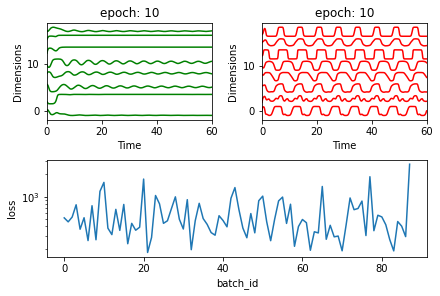

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.44it/s]


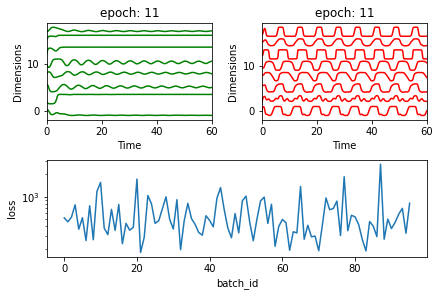

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.43it/s]


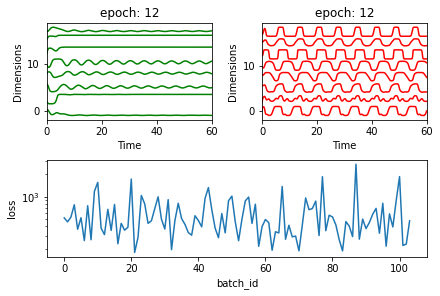

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


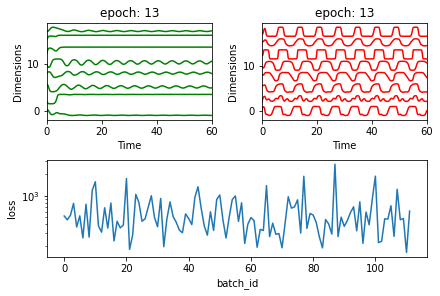

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.41it/s]


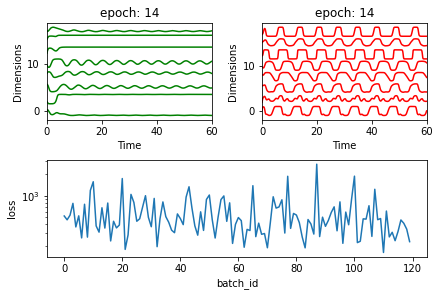

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


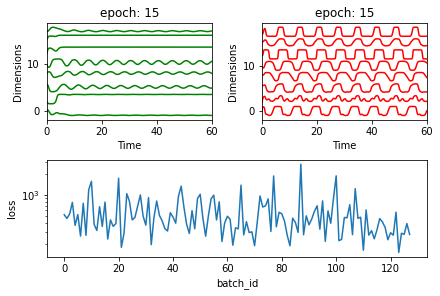

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.40it/s]


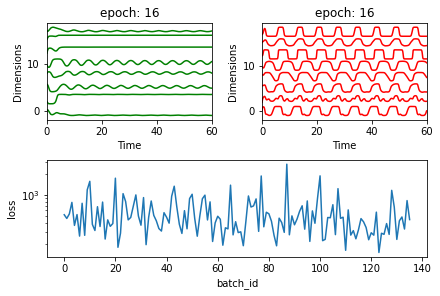

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


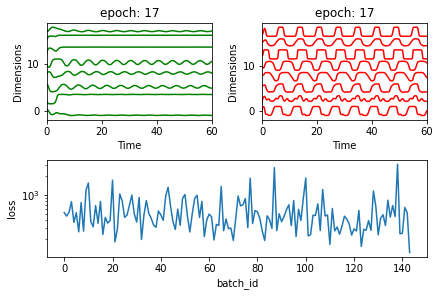

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.09it/s]


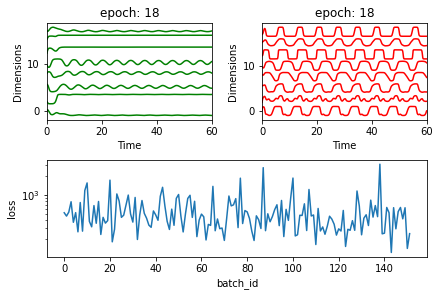

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


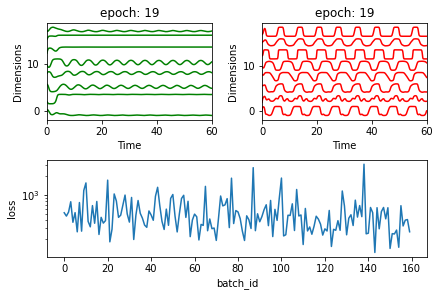

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


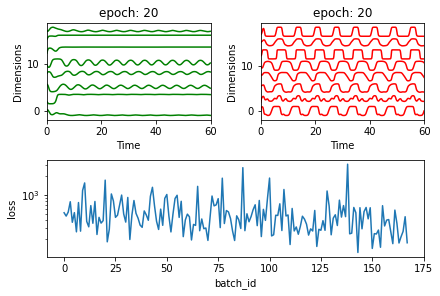

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


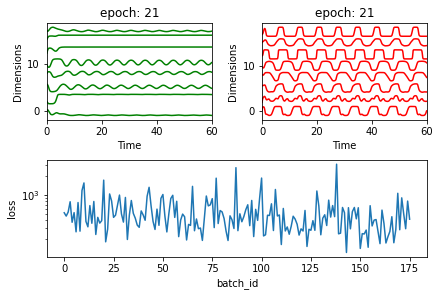

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.42it/s]


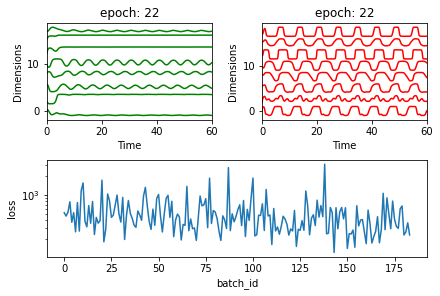

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.38it/s]


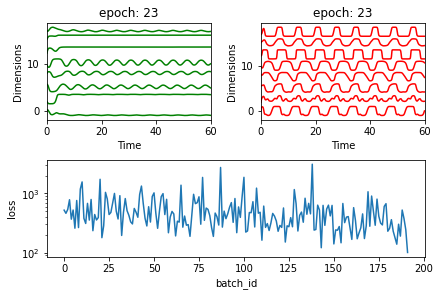

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.39it/s]


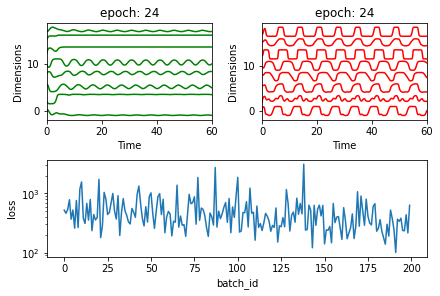

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


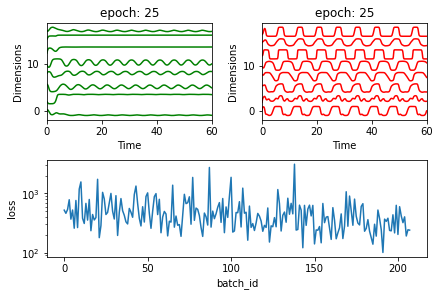

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


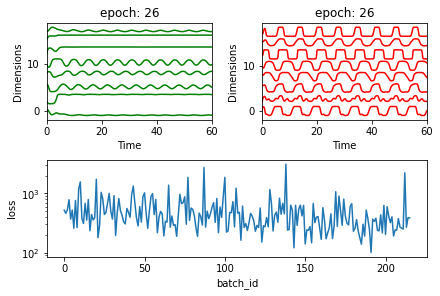

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


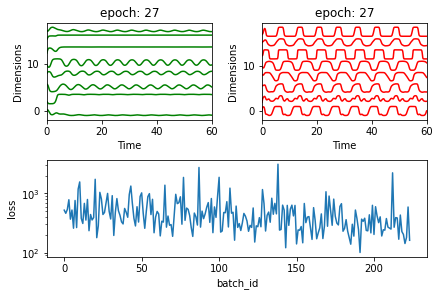

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.37it/s]


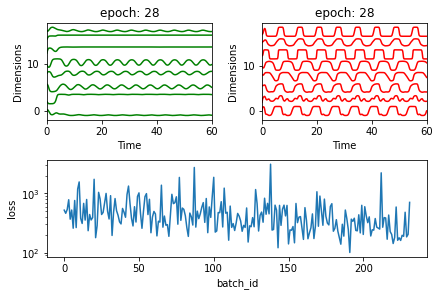

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


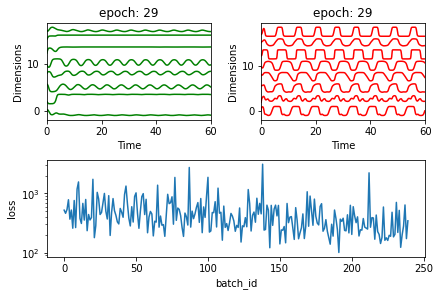

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


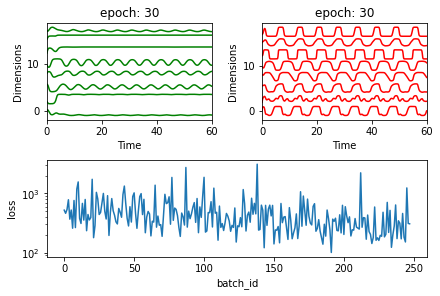

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


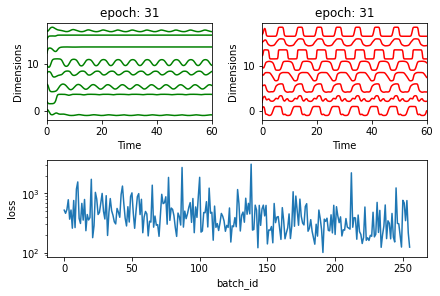

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


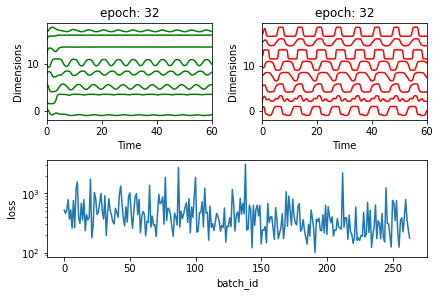

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


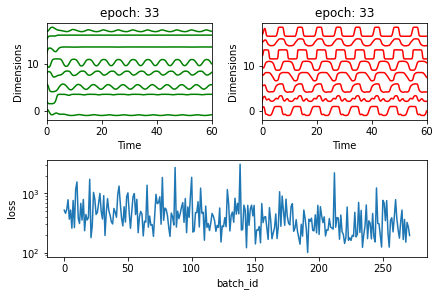

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.34it/s]


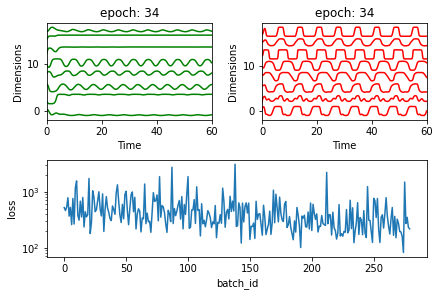

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


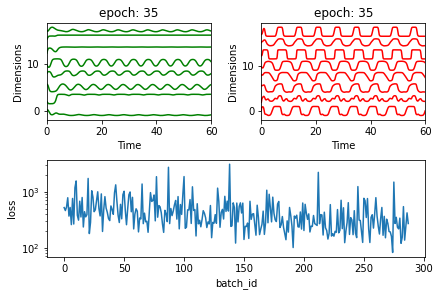

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.36it/s]


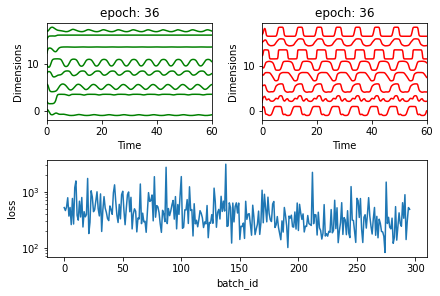

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


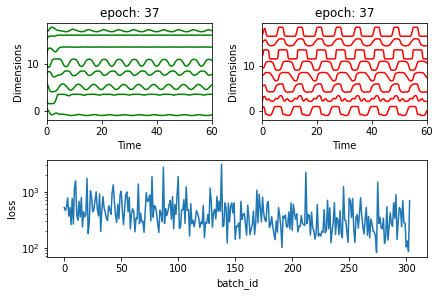

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


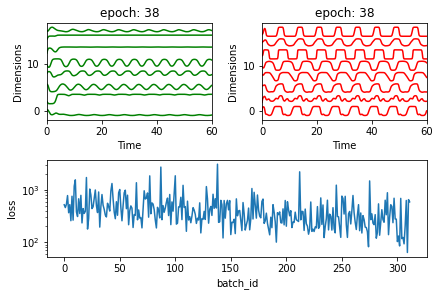

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


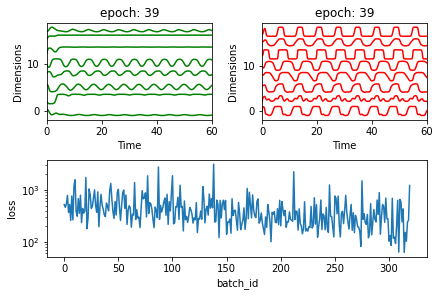

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


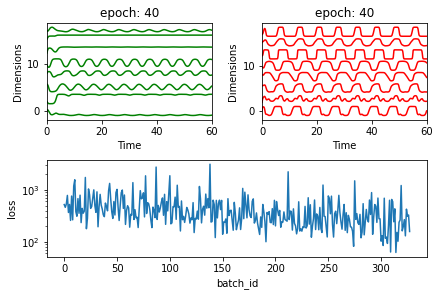

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


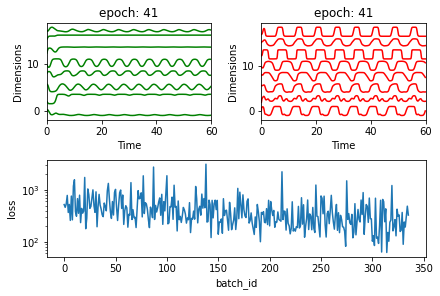

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


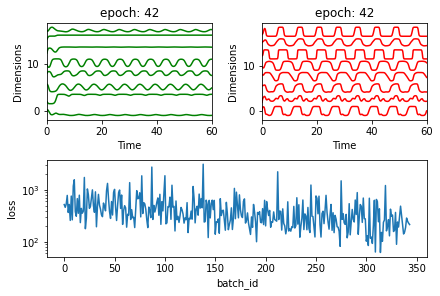

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


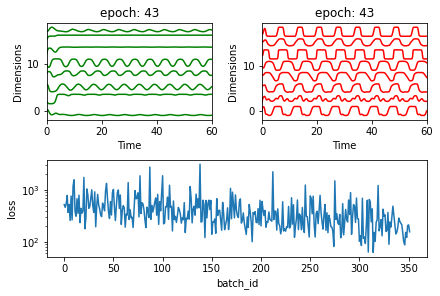

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


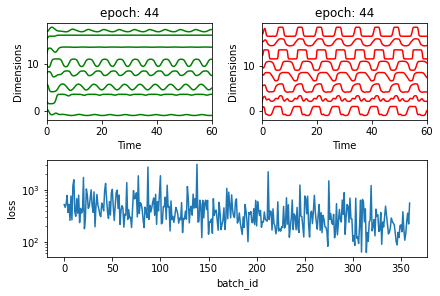

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.35it/s]


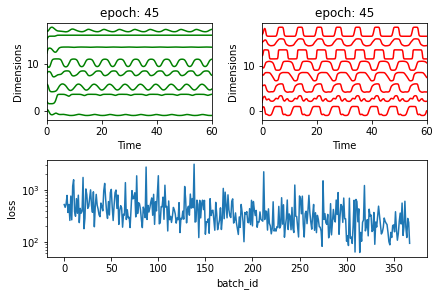

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


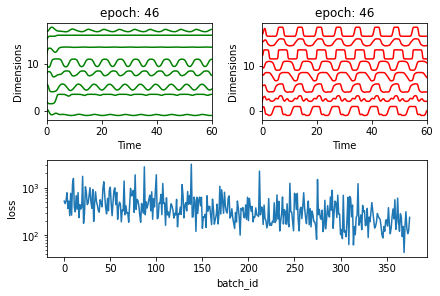

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


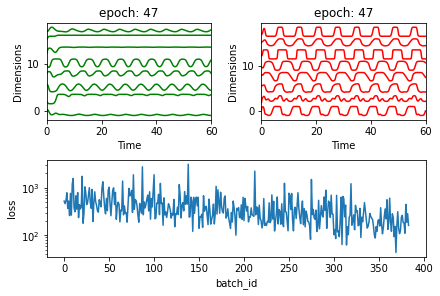

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


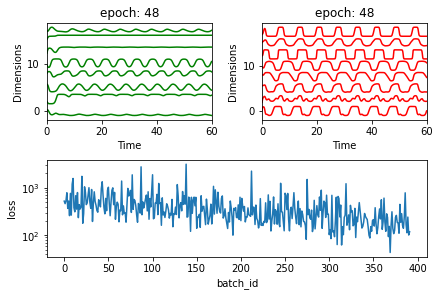

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.19it/s]


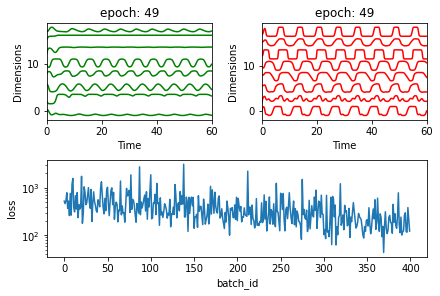

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


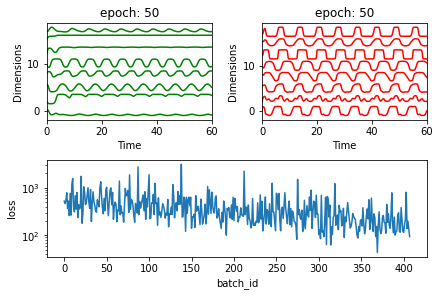

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


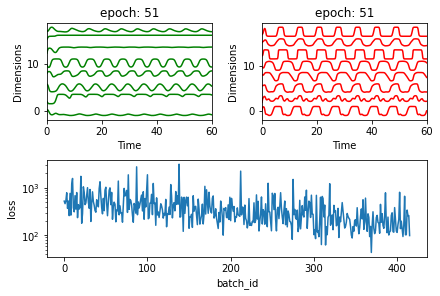

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


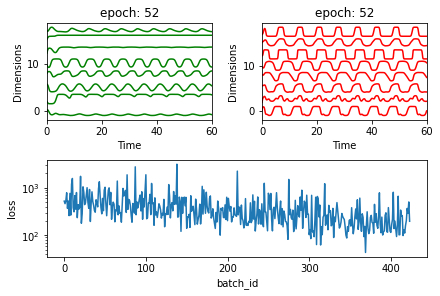

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


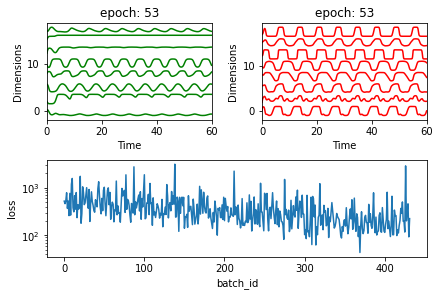

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


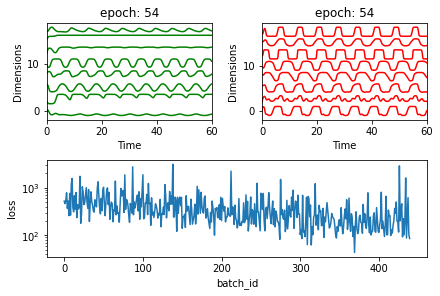

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


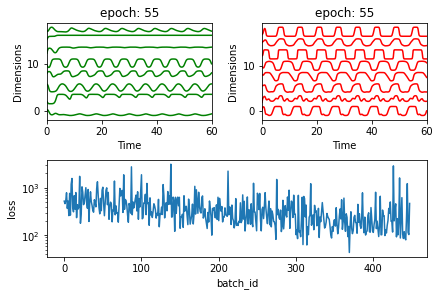

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


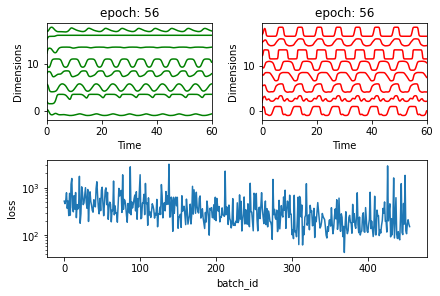

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


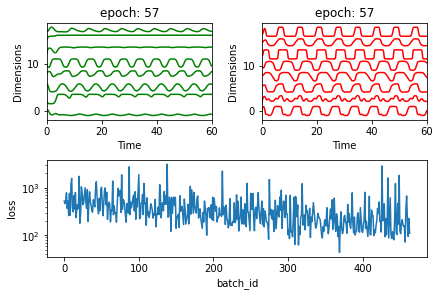

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.31it/s]


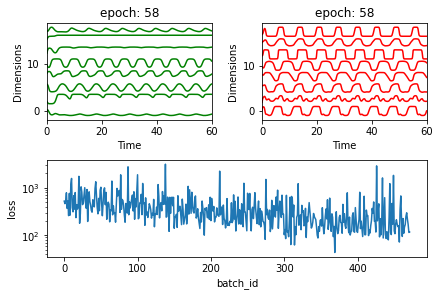

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


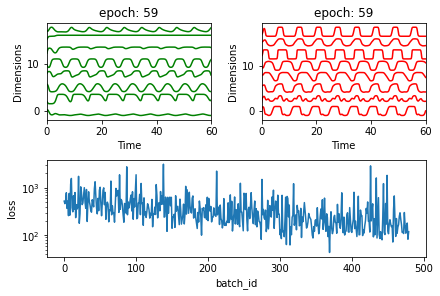

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


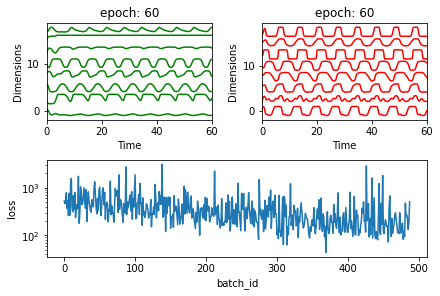

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.16it/s]


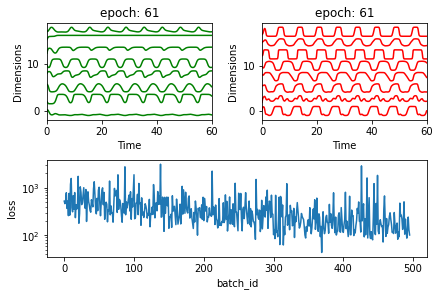

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


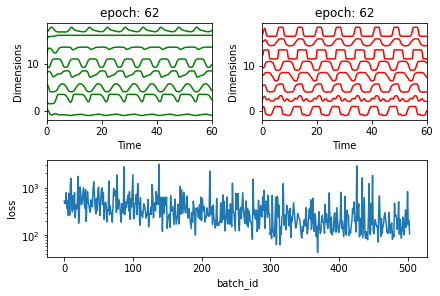

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


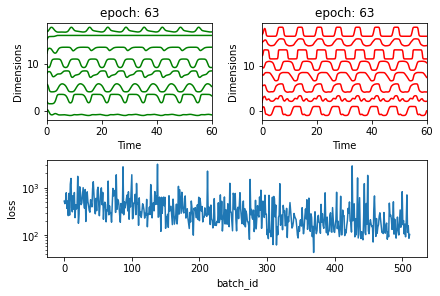

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


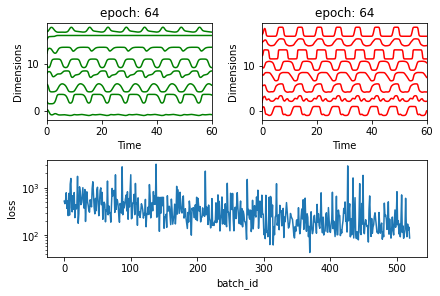

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


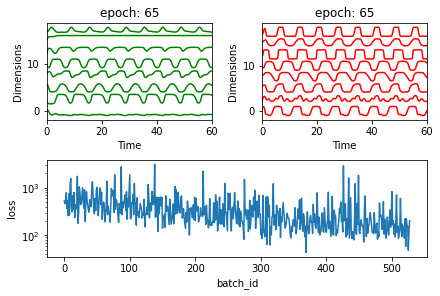

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


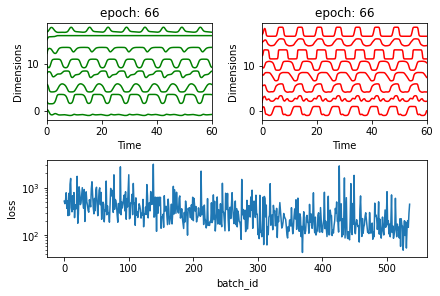

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.24it/s]


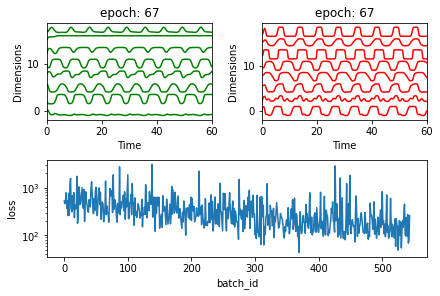

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.22it/s]


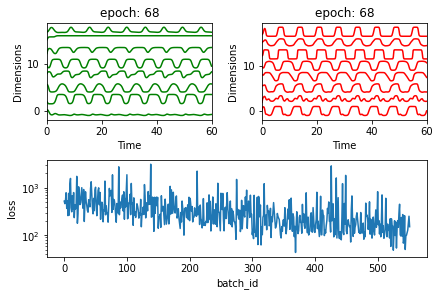

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.23it/s]


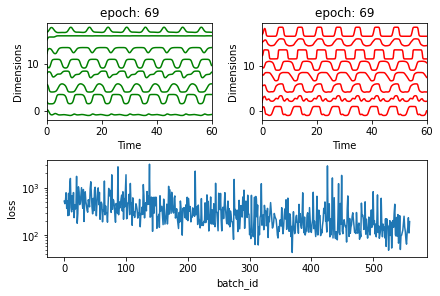

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


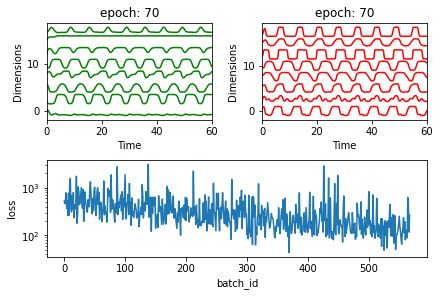

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


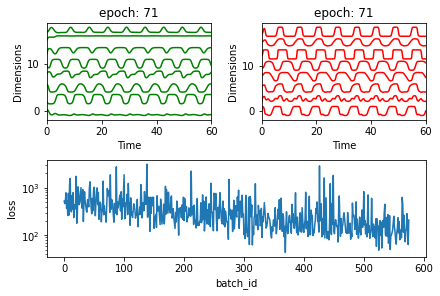

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.17it/s]


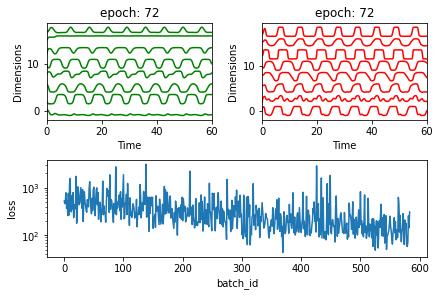

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


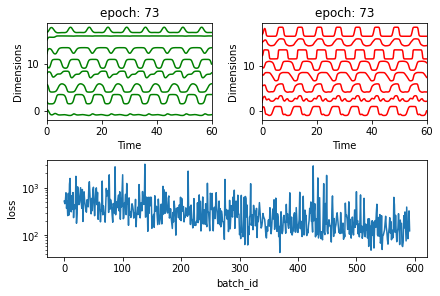

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


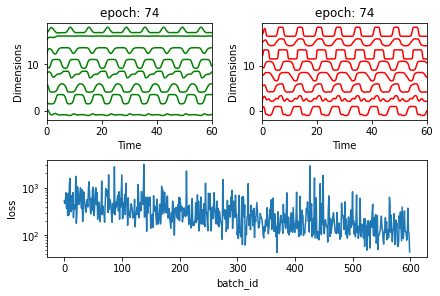

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


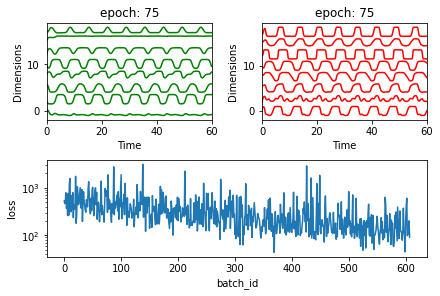

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


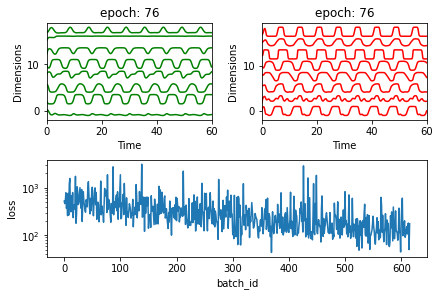

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


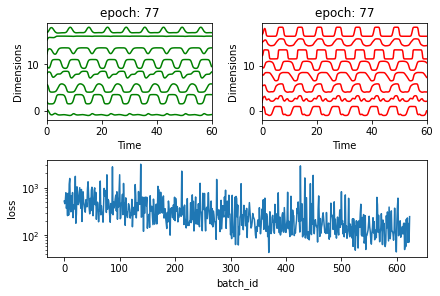

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


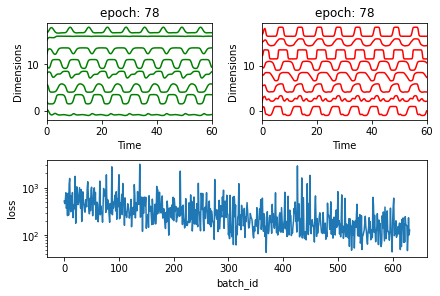

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.30it/s]


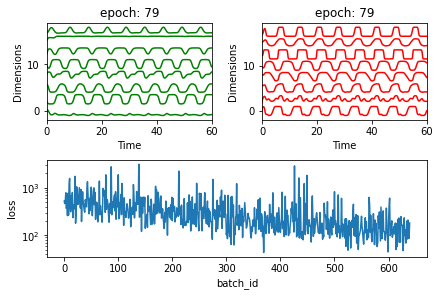

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.21it/s]


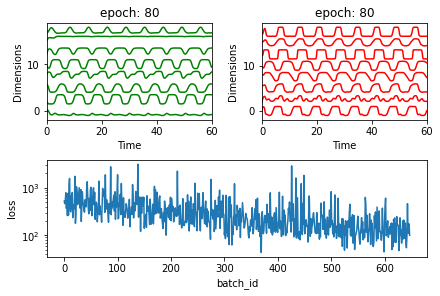

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.22it/s]


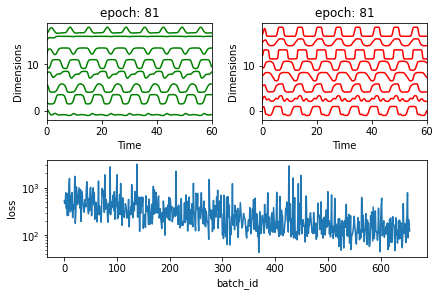

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


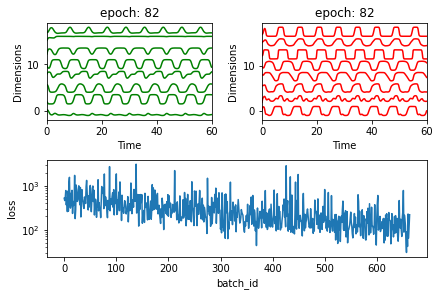

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


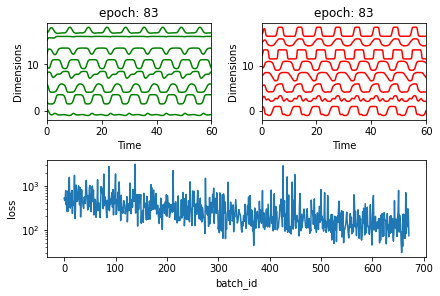

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


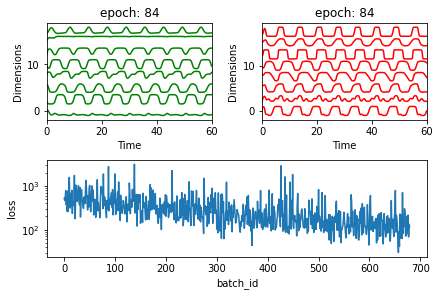

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


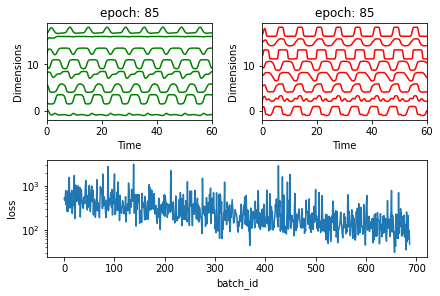

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


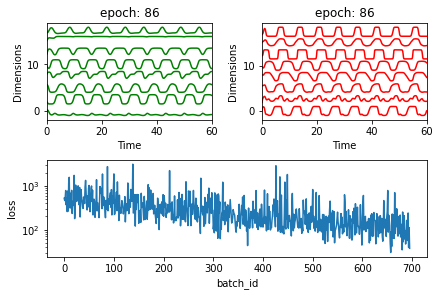

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


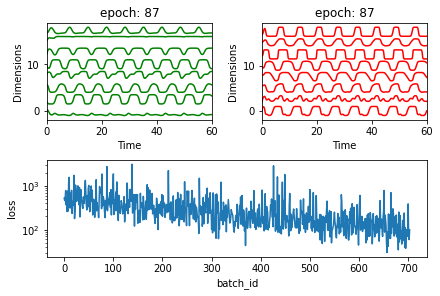

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


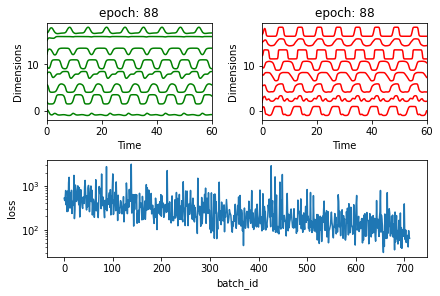

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


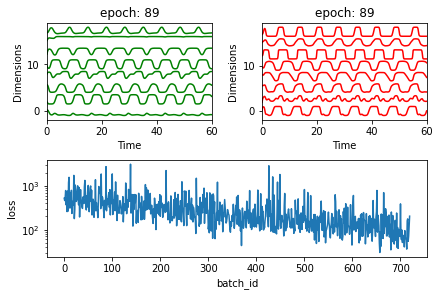

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.29it/s]


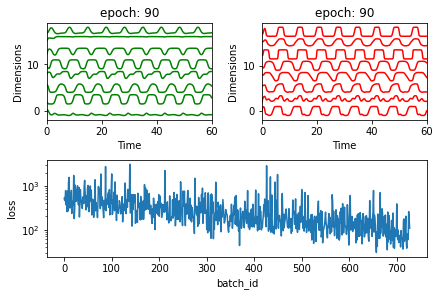

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


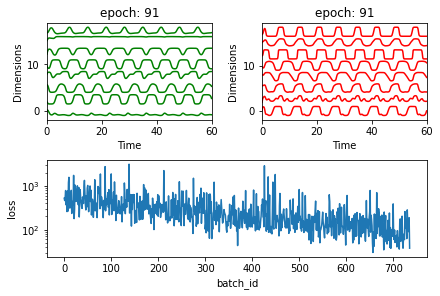

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.22it/s]


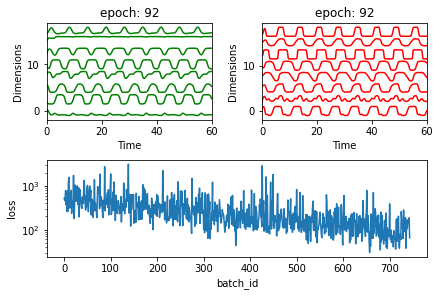

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


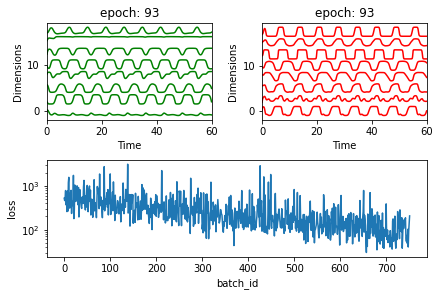

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


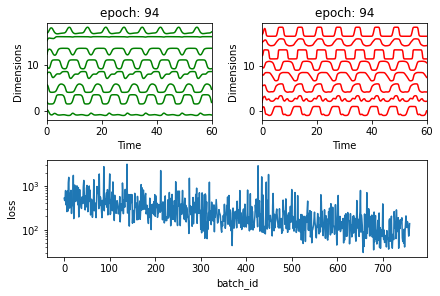

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


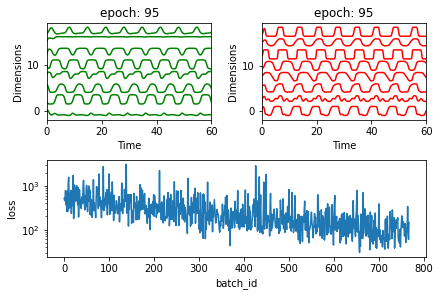

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


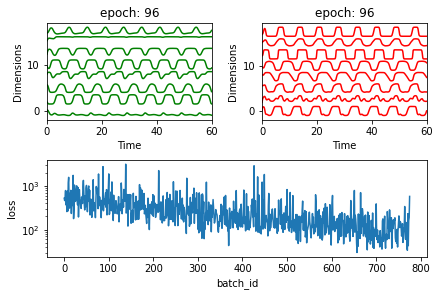

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


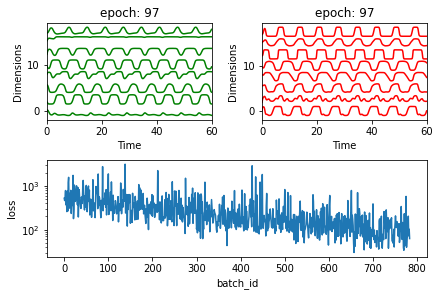

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


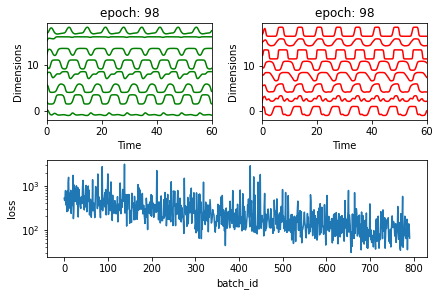

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.28it/s]


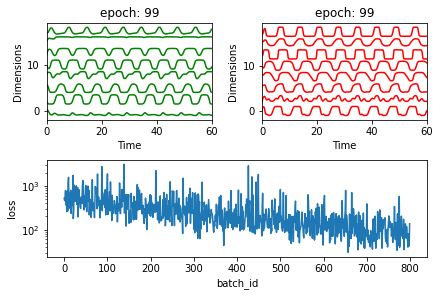

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


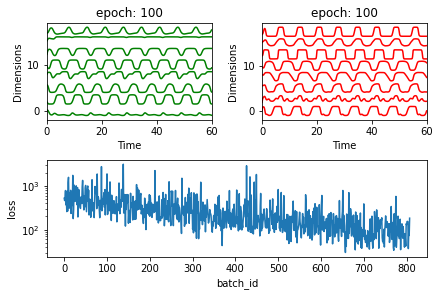

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.26it/s]


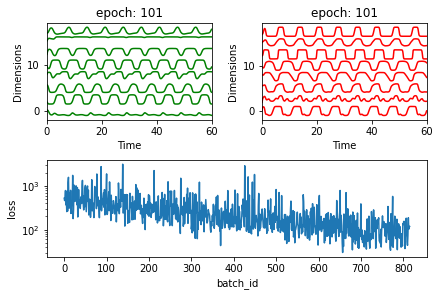

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


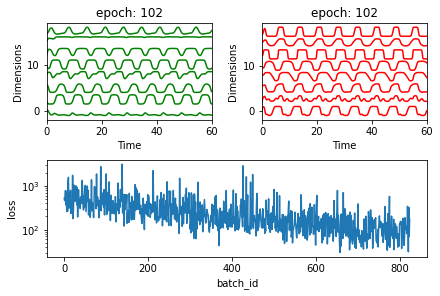

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.24it/s]


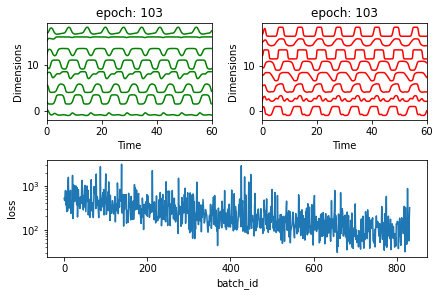

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.05it/s]


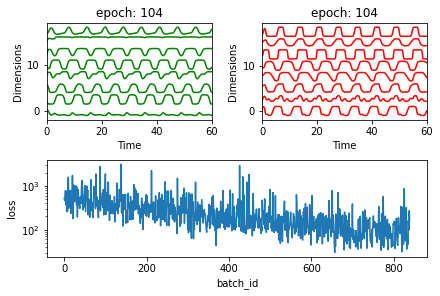

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


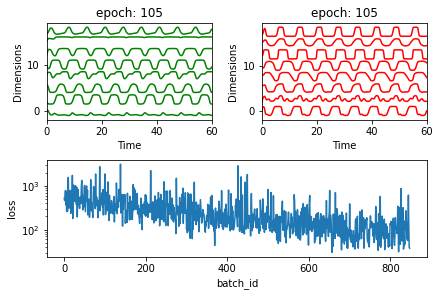

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.12it/s]


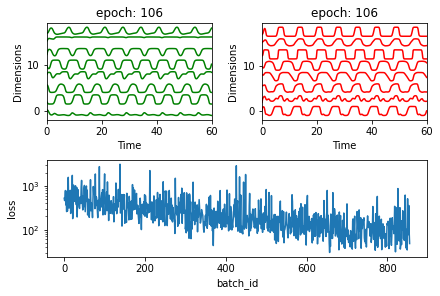

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


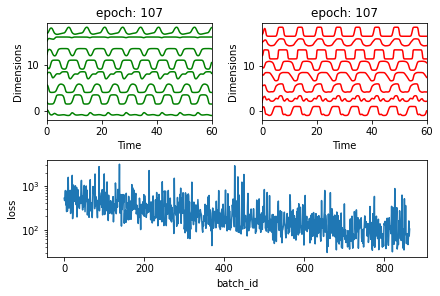

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


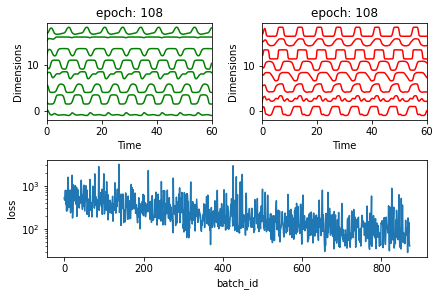

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.25it/s]


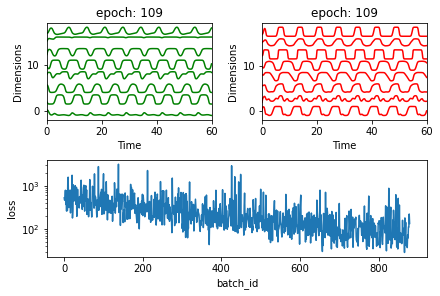

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.27it/s]


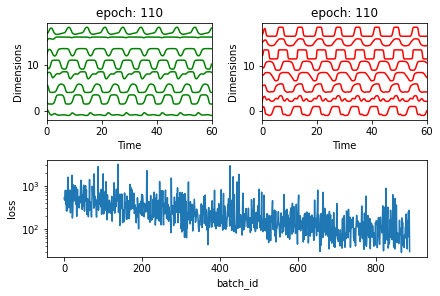

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.23it/s]


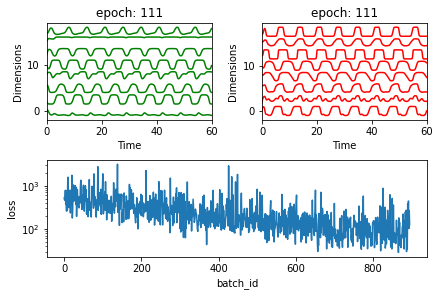

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


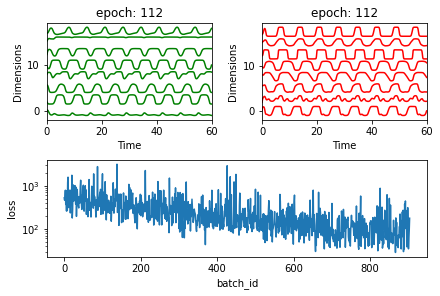

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.33it/s]


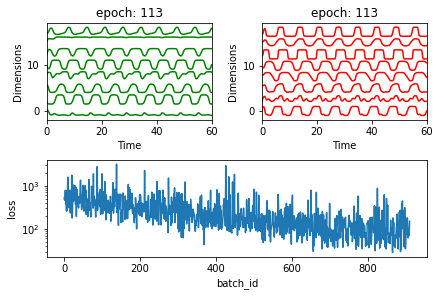

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.54it/s]


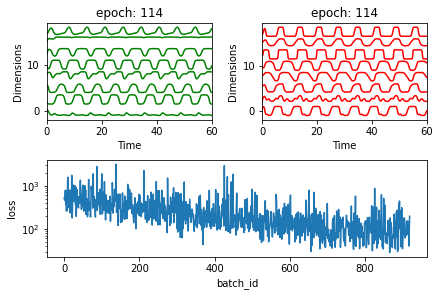

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.67it/s]


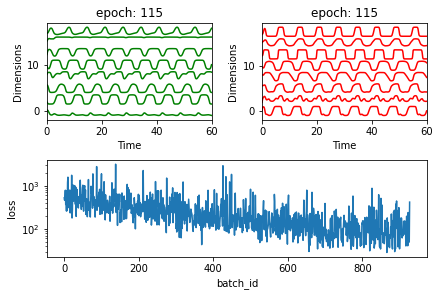

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.61it/s]


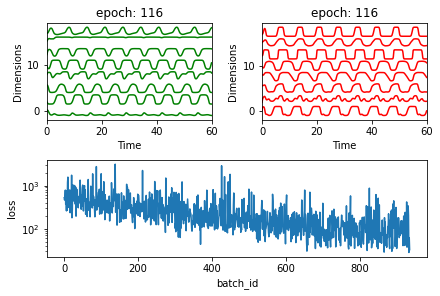

/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.95it/s]


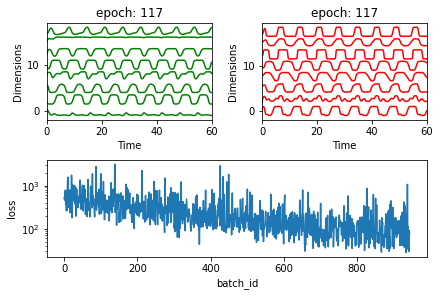

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.77it/s]


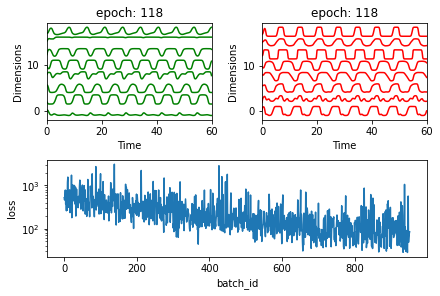

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.95it/s]


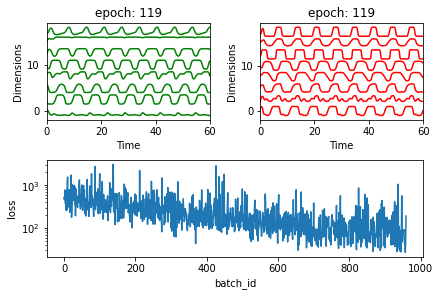

  0%|          | 0/8 [00:00<?, ?it/s]/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:54: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:78: RuntimeWarning: covariance is not positive-semidefinite.
/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:80: RuntimeWarning: covariance is not positive-semidefinite.
100%|██████████| 8/8 [00:02<00:00,  3.94it/s]


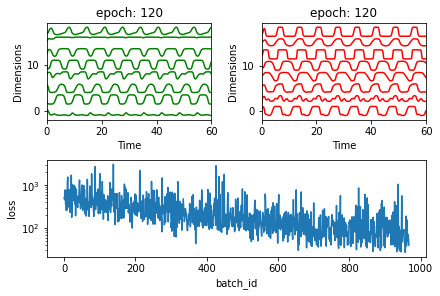

In [53]:
print(TRAIN_TIMESTEP)

60


In [108]:
train_data_params

{'a0': DeviceArray([-0.38374475,  0.18340287, -0.02732962, -0.04440609], dtype=float32),
 'wI': DeviceArray([[-0.6909145],
              [ 0.8123747],
              [ 0.4416679],
              [ 0.3946888]], dtype=float32),
 'wR': DeviceArray([[ 1.1870385 ,  6.3992777 , -0.15671027, -0.32988244],
              [-1.7615024 ,  4.6974363 ,  2.4131794 ,  3.4193983 ],
              [ 1.8527669 , -0.55973643, -3.9350245 ,  2.4603164 ],
              [-1.4444028 , -5.4561896 , -1.7363719 , -2.4047682 ]],            dtype=float32),
 'dt_over_tau': 0.1}

In [107]:
target_data_params

{'a0': DeviceArray([-0.38374475,  0.18340287, -0.02732962, -0.04440609], dtype=float32),
 'wI': DeviceArray([[-0.6909145],
              [ 0.8123747],
              [ 0.4416679],
              [ 0.3946888]], dtype=float32),
 'wR': DeviceArray([[-0.5224066 ,  5.068929  ,  3.9065452 , -1.363452  ],
              [-1.8772638 ,  2.5916672 , -1.7767487 ,  0.61471826],
              [-2.0865812 , -2.2409096 , -4.0954795 , -2.9560337 ],
              [-1.5466683 , -4.8618097 , -0.2688964 , -2.9668553 ]],            dtype=float32),
 'dt_over_tau': 0.1}

In [151]:
onp.corrcoef(target_data_params['wR'].flatten(), train_data_params['wR'].flatten())

array([[1.        , 0.20954378],
       [0.20954378, 1.        ]])

In [139]:
np.min(np.real(np.linalg.eigvals(target_cov)))

DeviceArray(0.00319419, dtype=float32)

In [138]:
onp.random.multivariate_normal(target_mean,target_cov + np., BATCHES_PER_GRADIENT)

/home/orsgaba/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: covariance is not positive-semidefinite.
  """Entry point for launching an IPython kernel.


array([[ 0.21270855,  0.15662901,  0.0506606 , -0.00132866,  0.02283637,
        -0.26540896,  0.00952221, -0.71302802],
       [-0.71872745, -0.11608766, -0.84858725,  0.66705774,  1.0572288 ,
        -0.18146779, -0.41604995, -1.05953278],
       [-0.53111447,  0.04880691, -0.07344457,  0.921785  ,  0.66659179,
         0.35021252,  0.1018732 , -0.06821953],
       [-0.08148391, -0.07001468,  0.11956117,  0.09356191, -0.15437887,
        -0.84657738,  0.03654685, -0.3442337 ]])

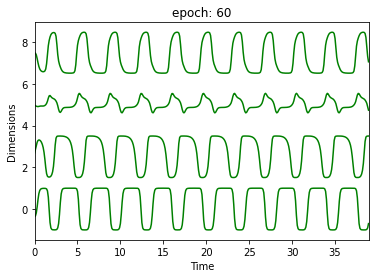

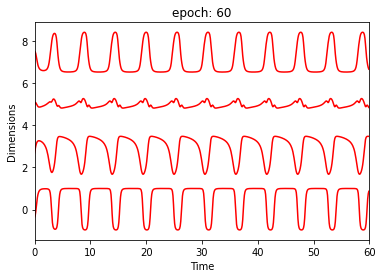

In [106]:
### plt.figure()
plt.plot(time, f_t + 2.5*onp.arange(0, m), 'g');
plt.xlim((0, T))
plt.ylabel('Dimensions')
plt.xlabel('Time');
plt.title("epoch: %d" % (train_idx))
plt.show()
plt.pause(0.1)
plt.figure()
plt.plot(time, target_h + 2.5*onp.arange(0, m), 'r');
plt.xlim((0, T))
plt.ylabel('Dimensions')
plt.xlabel('Time');
plt.title("epoch: %d" % (train_idx))
plt.show()
plt.pause(0.1)